In [2]:
import pandas as pd
import numpy as np

# text preprocessing
# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess

# spacy для лематизации
import spacy

# nltk
import nltk
# nltk.download('punkt')
# nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

from sklearn.feature_extraction.text import TfidfVectorizer
from sentence_transformers import SentenceTransformer

# clustering
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_samples, silhouette_score, \
    calinski_harabasz_score
from sklearn.cluster import KMeans, SpectralClustering

from umap import UMAP
import faiss

# visualization
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

# functions
from func_clustering.text_preprocess import preprocess_sentence, sent_to_words, \
    remove_stopwords, lemmatization
from func_clustering.dim_reduction import pca_optimal_comp, pca_embeddings, \
    umap_embeddings
from func_clustering.clust_charts import calculate_optimal_distance, \
    elbow_picture, silhouette_plot, metric_picture, plot_size, \
    clustering_analysis
from func_clustering.result_visualization import clusters_visual, \
    plot_object_features, plot_num_features, plot_text_features

from typing import *
import re

import warnings
warnings.filterwarnings('ignore')

RAND = 10

# Import data

In [7]:
df = pd.read_csv('data/df_res_data.csv')

In [8]:
df.head()

,name,prescription,type,price,form,use_for,temp,VEM,flg_foreign,pregnant,children,amount,group_PG,group_ATC_main,group_ATC_sub,route_kind
0,Никсар тб 20 мг №30,1,drug,1700.5,таблетки,- Аллергический (сезонный и круглогодичный) ри...,30.0,0.0,1,0.0,1.0,30.0,противоаллергическое средство - H1-гистаминовы...,Дыхательная система,Антигистаминные средства системного действия,внутрь
1,Фенисмарт капли внут 1мг/мл 12мл,0,drug,388.0,капли,"• Аллергические заболевания: крапивница, сенна...",25.0,0.0,1,1.0,1.0,12.0,антигистаминные средства системного действия; ...,Дыхательная система,Антигистаминные средства системного действия,внутрь
2,Димедрол р-р для в/в в/м введ 10мг/мл 5мл №10,1,drug,87.0,раствор,Анафилактические и анафилактоидные реакции (в ...,5.0,1.0,0,1.0,1.0,10.0,противоаллергическое средство - H1-гистаминовы...,Дыхательная система,Антигистаминные средства системного действия,инъекционно
3,Никсар тб 20 мг №10,1,drug,735.5,таблетки,- Аллергический (сезонный и круглогодичный) ри...,30.0,0.0,1,0.0,1.0,10.0,противоаллергическое средство - H1-гистаминовы...,Дыхательная система,Антигистаминные средства системного действия,внутрь
4,Аллегра тб п.п.о 180 мг №10,0,drug,924.0,таблетки,Фармакодинамика\n\nФексофенадин (фармакологиче...,25.0,0.0,1,0.0,1.0,10.0,противоаллергическое средство - H1-гистаминовы...,Дыхательная система,Антигистаминные средства системного действия,внутрь


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7877 entries, 0 to 7876
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            7877 non-null   object 
 1   prescription    7877 non-null   int64  
 2   type            7877 non-null   object 
 3   price           7877 non-null   float64
 4   form            7877 non-null   object 
 5   use_for         7877 non-null   object 
 6   temp            7877 non-null   float64
 7   VEM             7877 non-null   float64
 8   flg_foreign     7877 non-null   int64  
 9   pregnant        7877 non-null   float64
 10  children        7877 non-null   float64
 11  amount          7877 non-null   float64
 12  group_PG        7877 non-null   object 
 13  group_ATC_main  7877 non-null   object 
 14  group_ATC_sub   7877 non-null   object 
 15  route_kind      7877 non-null   object 
dtypes: float64(6), int64(2), object(8)
memory usage: 984.8+ KB


In [10]:
df.shape

(7877, 16)

In [11]:
df.describe()

,prescription,price,temp,VEM,flg_foreign,pregnant,children,amount
count,7877.000000,7877.000000,7877.000000,7877.000000,7877.000000,7877.000000,7877.000000,7877.000000
mean,0.441031,775.545830,24.830773,0.265076,0.469087,0.313317,0.722610,37.378824
std,0.496542,1488.150911,4.459362,0.441401,0.499075,0.463872,0.447739,48.148890
min,0.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,152.500000,25.000000,0.000000,0.000000,0.000000,0.000000,10.000000
50%,0.000000,414.500000,25.000000,0.000000,0.000000,0.000000,1.000000,28.000000
75%,1.000000,849.000000,25.000000,1.000000,1.000000,1.000000,1.000000,50.000000
max,1.000000,38500.000000,75.000000,1.000000,1.000000,1.000000,1.000000,1000.000000


In [12]:
df.describe(include=object)

,name,type,form,use_for,group_PG,group_ATC_main,group_ATC_sub,route_kind
count,7877,7877,7877,7877,7877,7877,7877,7877
unique,7162,3,37,4897,558,15,85,8
top,Пустырника настойка 25 мл,drug,таблетки,Артериальная гипертензия.,БАД,информация отсутствует,информация отсутствует,внутрь
freq,9,6374,3285,51,1207,2149,2149,5412


**Выводы:**

- есть колонки с данными типа object (name, type, form, use_for, group_PG, group_ATC_main, group_ATC_sub, route_kind), бинаризованными (prescription, VEM, flg_foreign, pregnant, children) и числовыми (price, temp, amount) данными;
- колонка use_for содержит текстовые данные, которые необходимо предобработать и векторизовать перед подачей в модель;
- колонки с данными типа object необходимо бинаризовать, числовые признаки стандартизировать;
- в свяи с большим количеством признаков будем использовать методы снижения размерности признаков (PCA, UMAP).

# Text preprocessing

In [76]:
# определим стоп-слова
stop_words = stopwords.words('russian')
stop_words.extend([
    'терапия', 'лечение', 'профилактика', 'заболевание', 'качество', 'пациент',
    'состав', 'болезнь', 'комплексной', 'средство', 'препарат', 'применение'
])

In [77]:
# токенизируем слова
df['preprocess_text'] = df['use_for'].apply(preprocess_sentence)
data = df['preprocess_text'].values.tolist()
data_words = list(sent_to_words(data))

In [78]:
data_words[0]

['аллергическии',
 'сезонныи',
 'круглогодичныи',
 'риноконъюнктивит',
 'устранение',
 'или',
 'облегчение',
 'симптомов',
 'чихание',
 'ощущение',
 'заложенности',
 'носа',
 'зуд',
 'слизистои',
 'оболочки',
 'носа',
 'ринорея',
 'ощущение',
 'жжения',
 'зуда',
 'глазах',
 'покраснение',
 'глаз',
 'слезотечение',
 'крапивница',
 'устранение',
 'или',
 'уменьшение',
 'кожного',
 'зуда',
 'сыпи']

In [79]:
# удалим стоп-слова
data_words_nostops = remove_stopwords(texts=data_words, stop_words=stop_words)

nlp = spacy.load('ru_core_news_sm', disable=['parser', 'ner'])
# проведем лемматизацию
data_lemmatized = lemmatization(nlp=nlp,
                                stop_words=stop_words,
                                data_words_nostops,
                                allowed_postags=['NOUN', 'ADJ', 'PROPN'])

In [80]:
# добавим в датафрейм
data_prep = [' '.join(sent) for sent in data_lemmatized]

In [81]:
data_prep[0]

'аллергическии сезонныи круглогодичныи устранение облегчение симптом чихание ощущение заложенность нос зуд слизистои оболочка нос ринорея ощущение жжение зуд глаз покраснение глаз слезотечение крапивница уменьшение кожный зуд сыпь'

In [82]:
df['lemm_text'] = data_prep

# Векторизация текста

## TF IDF

In [83]:
# уберем часть признаков
df_tf = df.drop(
    ['name', 'group_PG', 'group_ATC_main', 'group_ATC_sub', 'type', 'price'],
    axis=1)

In [92]:
# сгенерируем векторы с помощью Tfidf
vectorizer = TfidfVectorizer(min_df=7, max_df=0.3)
vectors = vectorizer.fit_transform(df_tf['lemm_text'])

# сохраним в переменные слова и их количество
feature_names = vectorizer.get_feature_names_out()
num_words = vectors.shape[1]

# преобразуем векторы и извлечем признаки
df_tfidf = pd.DataFrame(vectors.toarray(),
                        columns=[col for col in feature_names])

In [93]:
df_tfidf.shape

(7877, 3432)

In [94]:
# удалим лишние колонки
df_tf = df_tf.drop(['use_for', 'preprocess_text', 'lemm_text'], axis=1)

In [95]:
# бинаризуем категориальные данные
df_labels = pd.get_dummies(df_tf)

In [96]:
df_labels.shape

(7877, 52)

In [97]:
# добавим векторы в датасет
df_tfidf_labels = pd.concat([df_tfidf, df_labels], axis=1)

## BERT

In [98]:
df_bert = df.drop(['preprocess_text', 'lemm_text', 'price'], axis=1)

In [99]:
# создадим новую колонку с объединенной текстовой информацией
object_cols = [
    'name', 'type', 'form', 'use_for', 'group_PG', 'group_ATC_main',
    'group_ATC_sub', 'route_kind'
]

df_bert['full_descr'] = ''
for col in object_cols:
    df_bert['full_descr'] += df_bert[col]
    df_bert['full_descr'] += ' '

In [29]:
# загрузим предобученную модель TinyBERT
model = SentenceTransformer('sentence-transformers/paraphrase-TinyBERT-L6-v2')

In [30]:
# векторизуем текст с помощью модели TinyBERT
embeddings = model.encode(df_bert['full_descr'].tolist())

In [100]:
# удалим лишние колонки
df_bert = df_bert.drop(object_cols, axis=1)
df_bert = df_bert.drop(['full_descr'], axis=1)

In [101]:
df_bert_text = pd.DataFrame()

In [102]:
# добавим вектора в датасет
for i in range(embeddings.shape[1]):
    df_bert_text[f'vector_{i}'] = embeddings[:, i]

In [103]:
df_bert_text.shape

(7877, 768)

In [104]:
df_bert_labels = pd.concat([df_bert, df_bert_text], axis=1)

In [105]:
df_bert_labels.shape

(7877, 775)

# Нормализация данных

In [106]:
scaler = StandardScaler()

In [107]:
# числовые признаки для стандартизации
numeric_features = ['temp', 'amount']

In [108]:
# Стандартизация числовых признаков для TF IDF
df_scaled_tf = df_tfidf_labels.copy()

df_scaled_tf[numeric_features] = scaler.fit_transform(
    df_scaled_tf[numeric_features])

In [109]:
# Стандартизация числовых признаков для BERT
df_scaled_bert = df_bert_labels.copy()

df_scaled_bert[numeric_features] = scaler.fit_transform(
    df_scaled_bert[numeric_features])

# Visualization

## PCA

### TF IDF

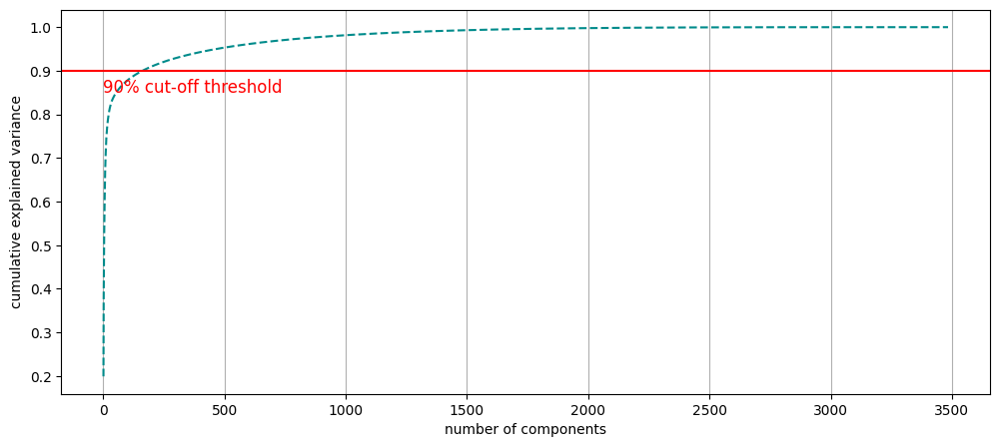

In [110]:
# посмотрим оптимальное количество компонент
pca_optimal_comp(df_scaled_tf)

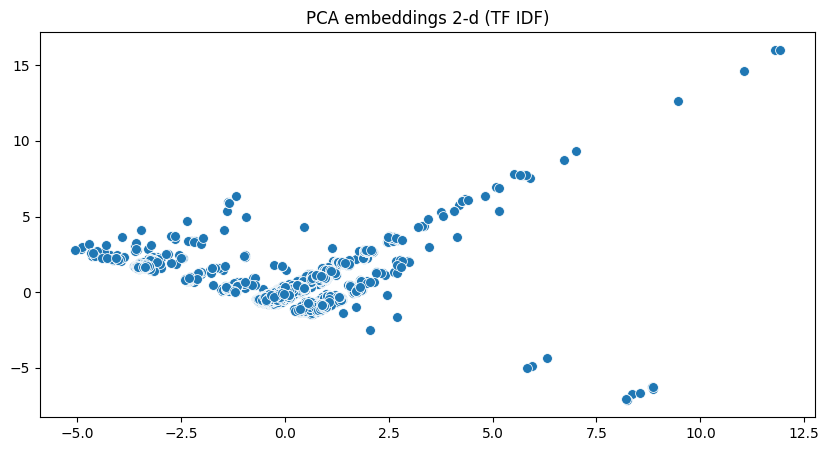

In [111]:
# сохраним и визуализируем эмбеддинги
X_embedding_pca_tf = pca_embeddings(df_scaled_tf, RAND, 'TF IDF')

### BERT

#### С числовыми данными

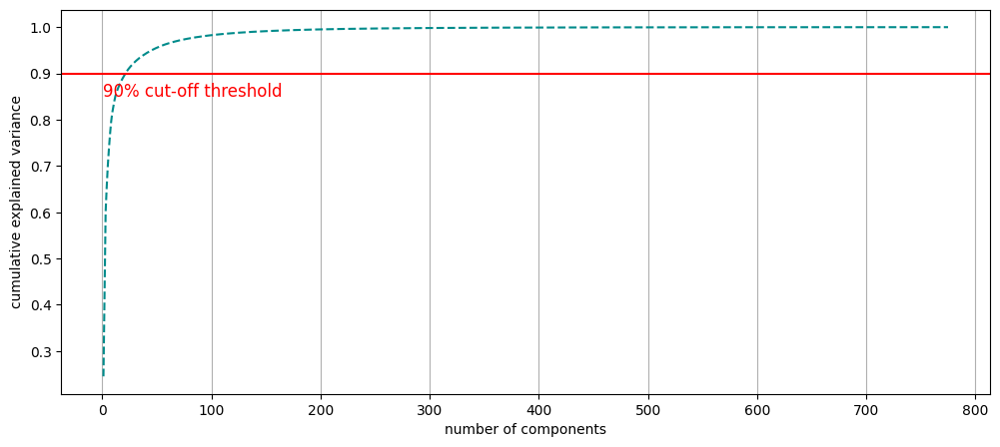

In [112]:
# посмотрим оптимальное количество компонент
pca_optimal_comp(df_scaled_bert)

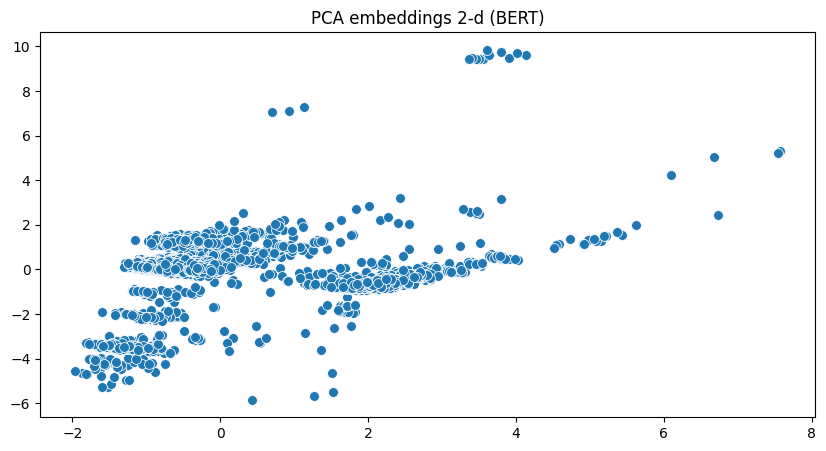

In [113]:
# сохраним и визуализируем эмбеддинги
X_embedding_pca_bert = pca_embeddings(df_scaled_bert, RAND, 'BERT')

#### Без числовых данных

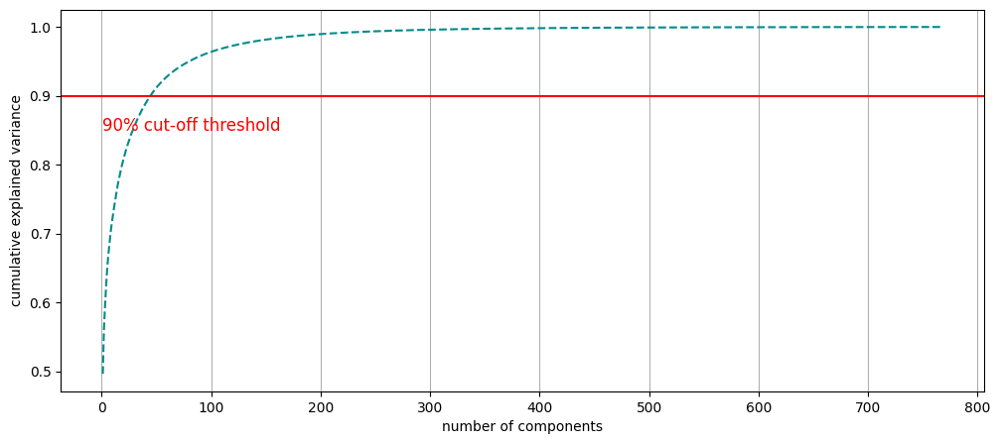

In [114]:
# посмотрим оптимальное количество компонент
pca_optimal_comp(embeddings)

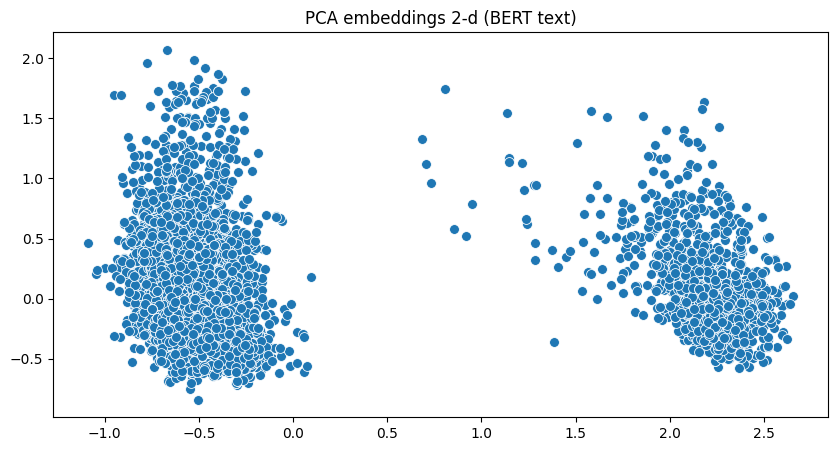

In [115]:
# сохраним и визуализируем эмбеддинги
X_embedding_pca_bert_text = pca_embeddings(embeddings, RAND, 'BERT text')

## UMAP

### TF IDF

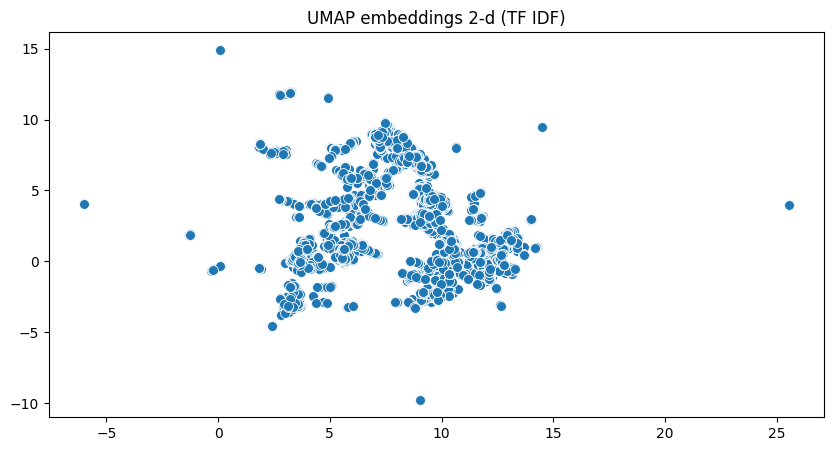

In [116]:
X_embedding_umap_tf = umap_embeddings(df_scaled_tf, RAND, 'TF IDF')

### BERT

#### С числовыми данными

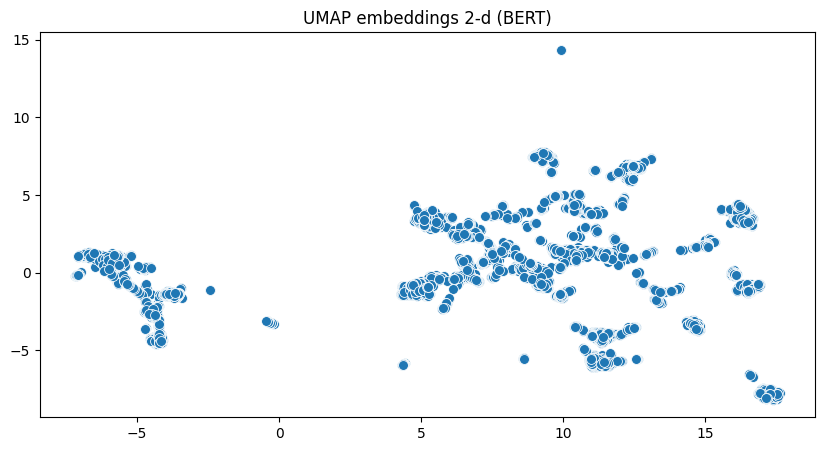

In [117]:
X_embedding_umap_bert = umap_embeddings(df_scaled_bert, RAND, 'BERT')

#### Без числовых данных

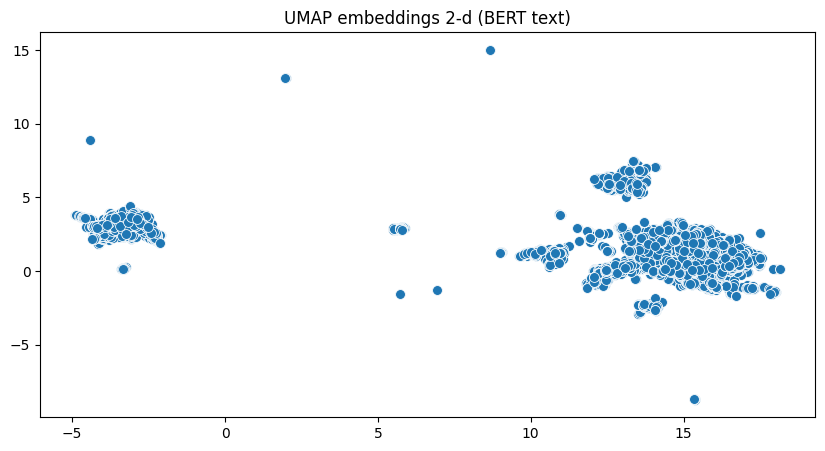

In [118]:
X_embedding_umap_bert_text = umap_embeddings(embeddings, RAND, 'BERT text')

# Clustering

In [119]:
# определим колонки для дальнейшео анализа кластеров
obj_and_bin_cols = [
    'form', 'route_kind', 'prescription', 
    'VEM', 'flg_foreign', 'pregnant', 'children', 
    'type', 'group_ATC_main', 'group_ATC_sub', 'group_PG'
]

num_cols = ['temp', 'amount', 'price']

tfidf_cols = list(df_tfidf.columns)

In [120]:
# определим параметры алгоритмов кластеризации
params_cluster = {
    'KMeans': {
        'random_state': RAND,
    },
    'SpectralClustering': {
        'random_state': RAND,
        'affinity': 'nearest_neighbors',
        'n_neighbors': 25,
        'n_jobs': -1
    },
    'IndexFlatL2': {
        'seed': RAND
    }
}

## PCA + KMeans

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


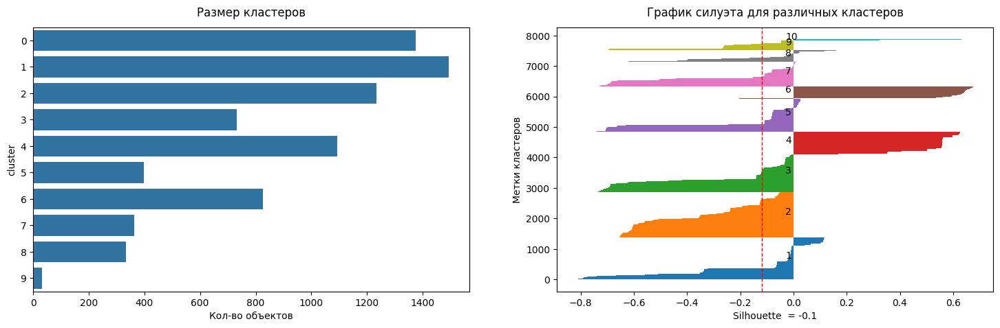

11 clusters
----------------------------------------------------------------------------------------------------


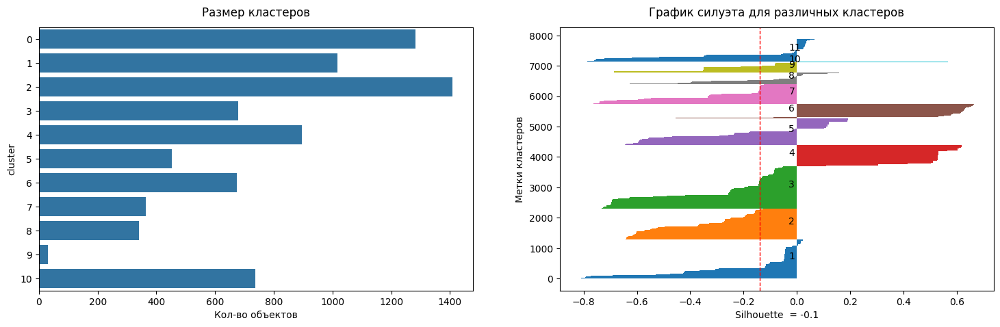

12 clusters
----------------------------------------------------------------------------------------------------


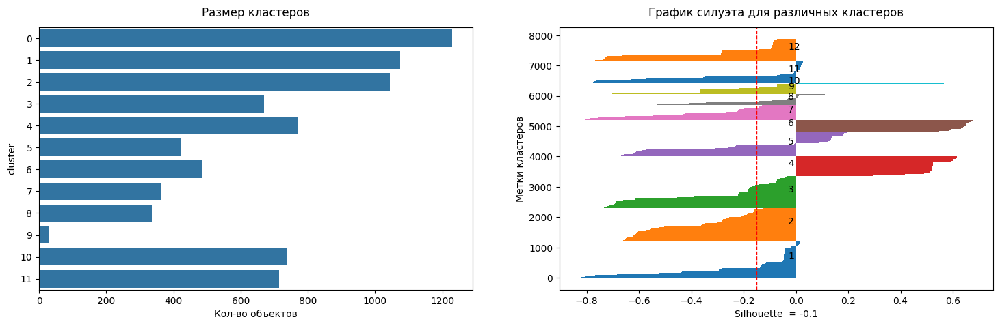

13 clusters
----------------------------------------------------------------------------------------------------


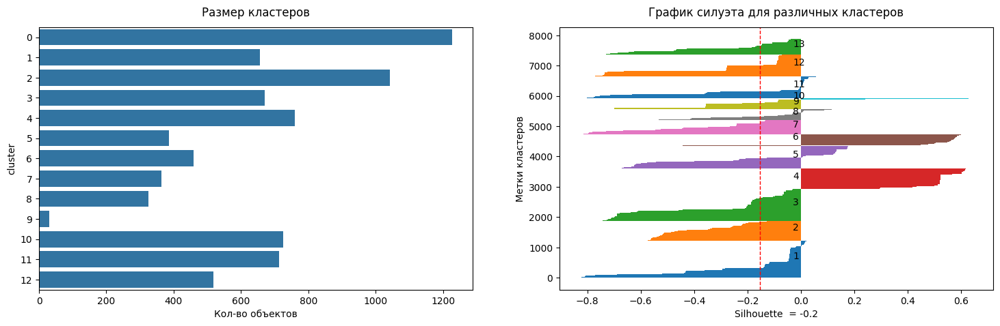

14 clusters
----------------------------------------------------------------------------------------------------


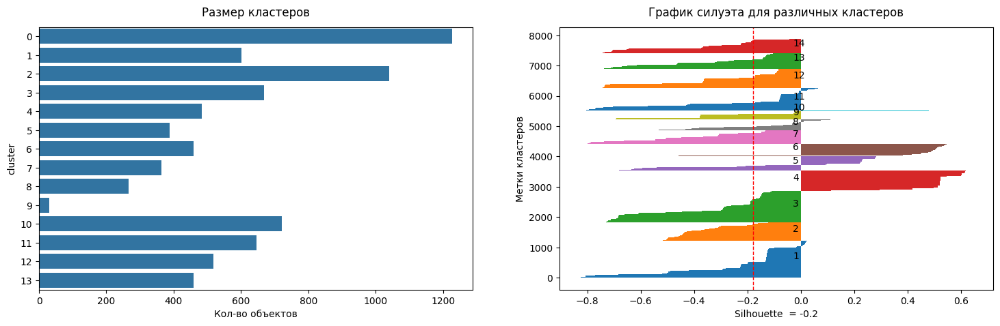

15 clusters
----------------------------------------------------------------------------------------------------


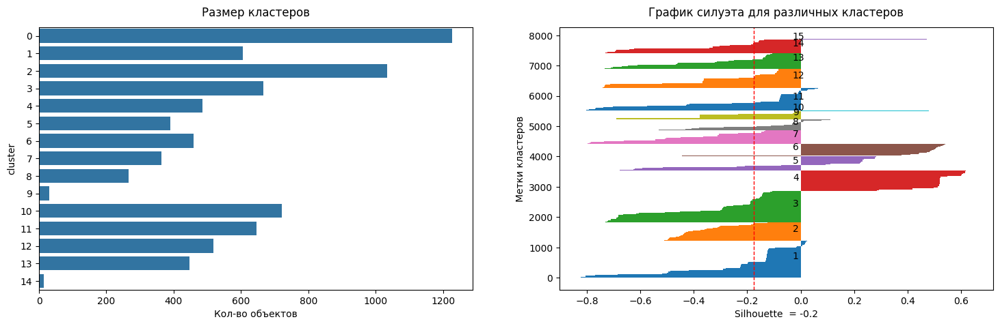

16 clusters
----------------------------------------------------------------------------------------------------


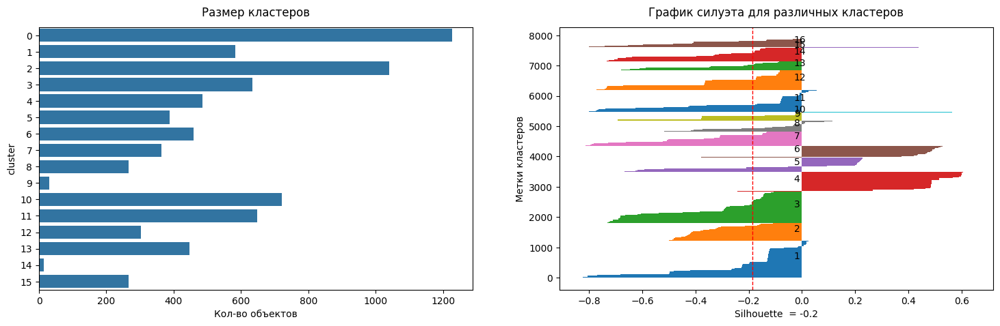

17 clusters
----------------------------------------------------------------------------------------------------


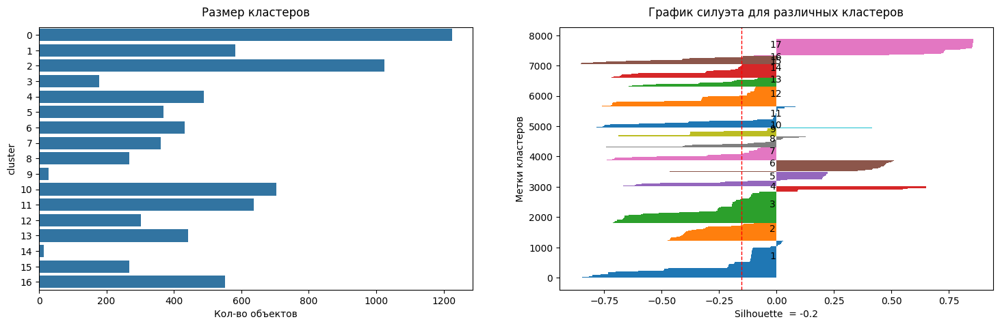

18 clusters
----------------------------------------------------------------------------------------------------


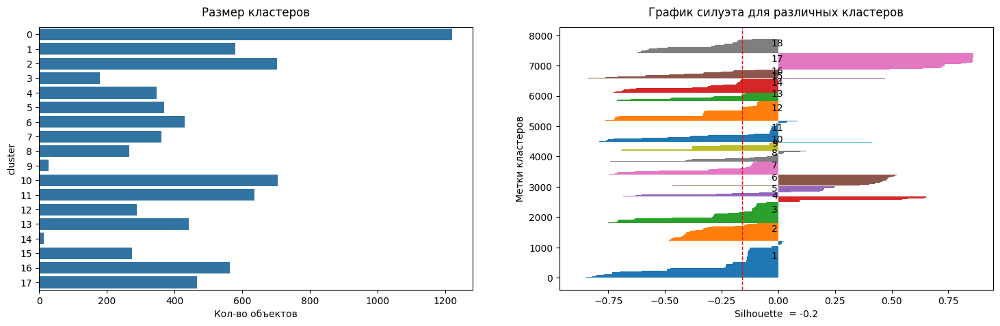

19 clusters
----------------------------------------------------------------------------------------------------


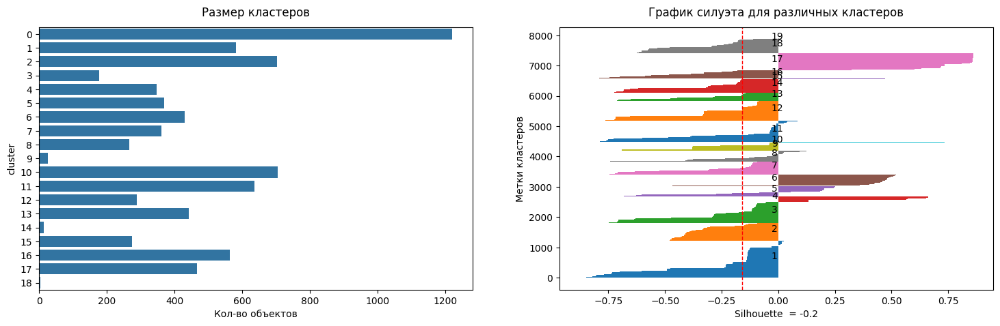

20 clusters
----------------------------------------------------------------------------------------------------


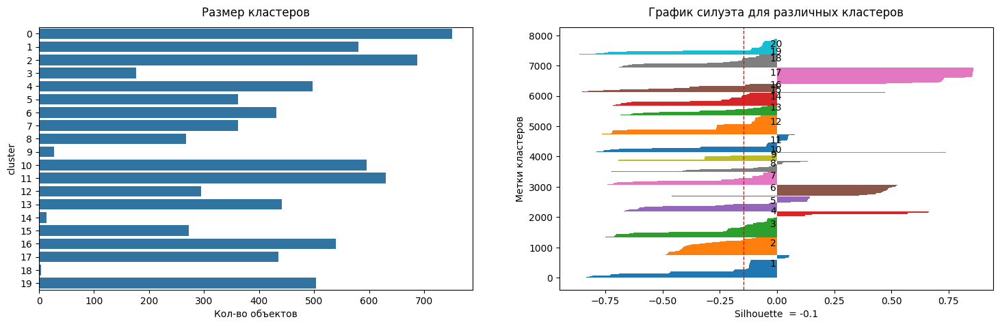

21 clusters
----------------------------------------------------------------------------------------------------


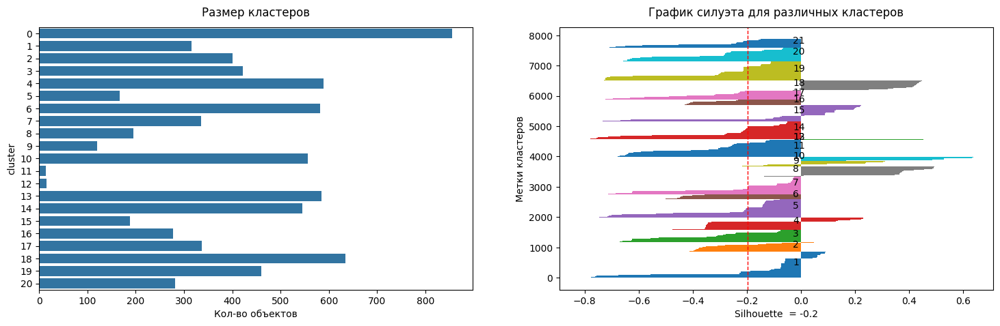

22 clusters
----------------------------------------------------------------------------------------------------


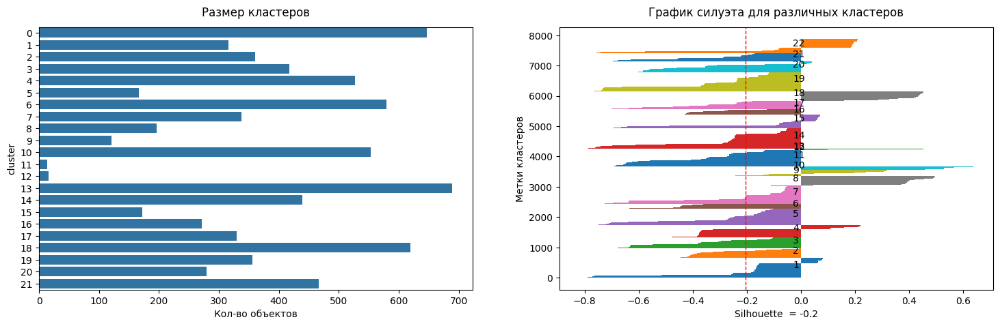

23 clusters
----------------------------------------------------------------------------------------------------


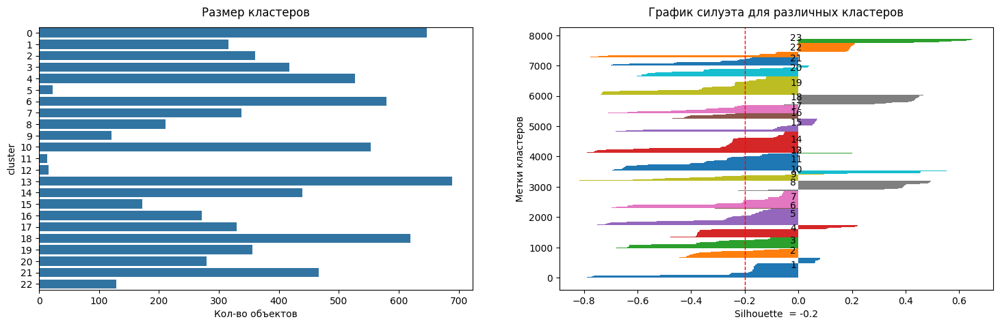

24 clusters
----------------------------------------------------------------------------------------------------


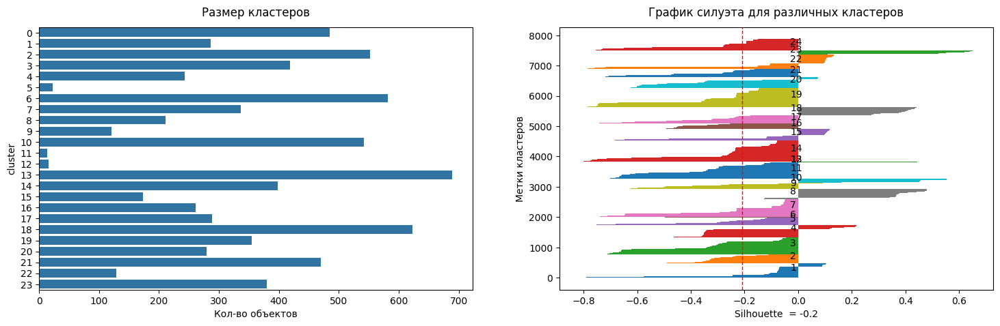

25 clusters
----------------------------------------------------------------------------------------------------


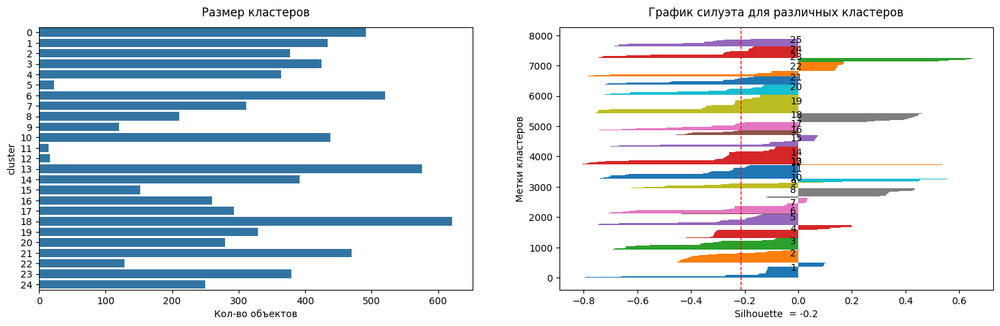

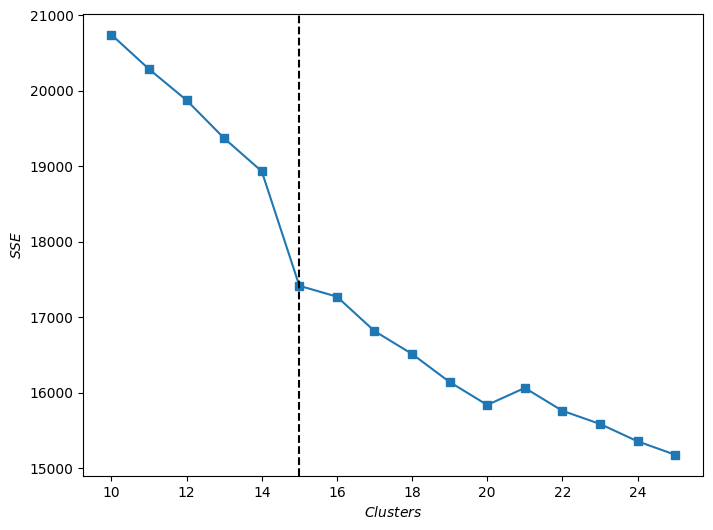

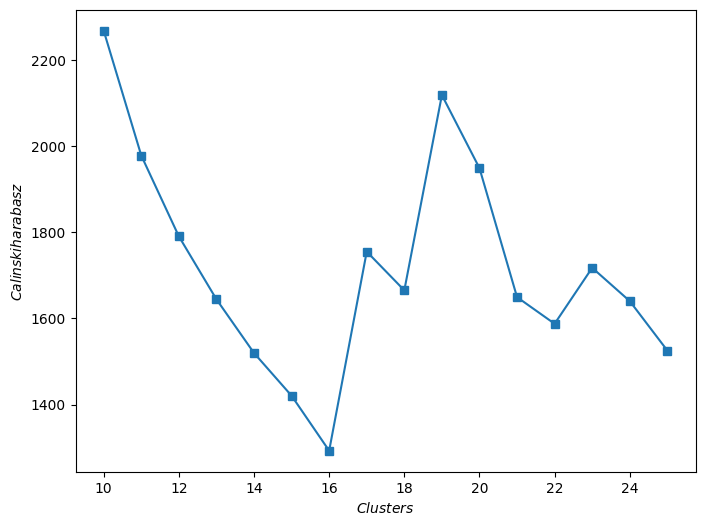

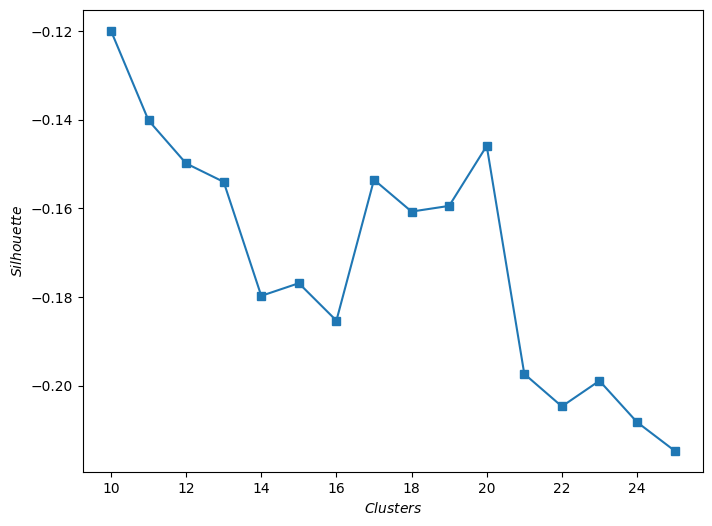

In [124]:
# подберем оптимальное количество кластеров
clust_km_pca_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=df_scaled_tf,
                                           embedding=X_embedding_pca_tf,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


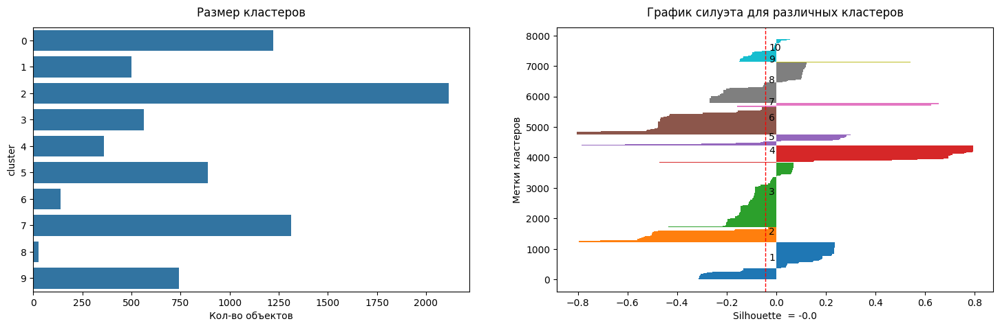

11 clusters
----------------------------------------------------------------------------------------------------


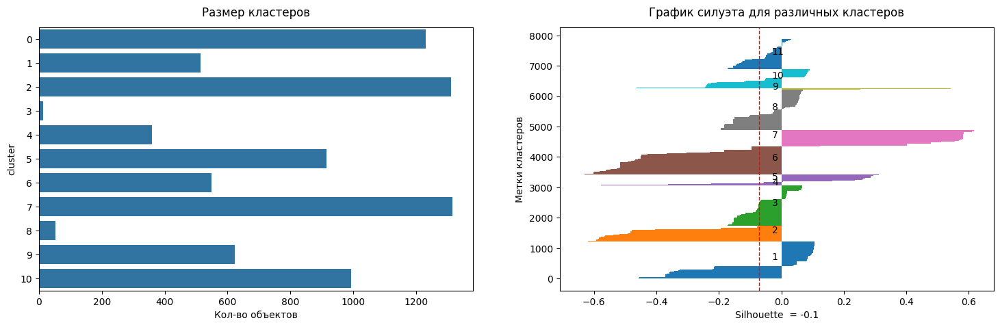

12 clusters
----------------------------------------------------------------------------------------------------


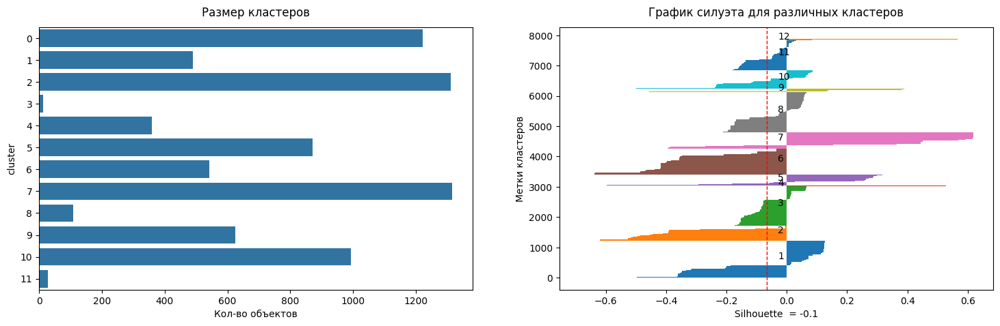

13 clusters
----------------------------------------------------------------------------------------------------


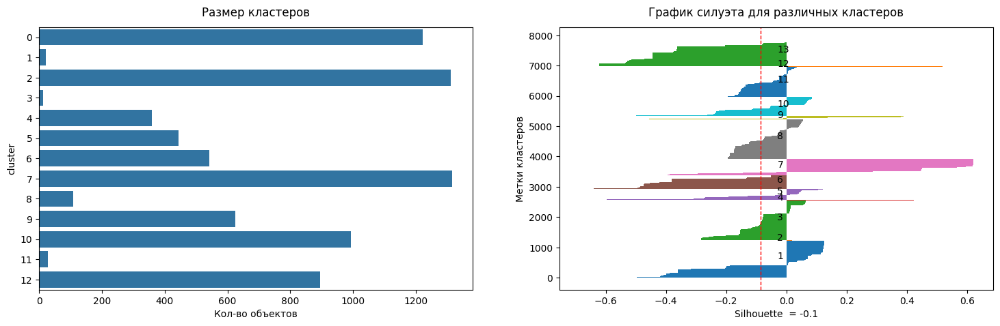

14 clusters
----------------------------------------------------------------------------------------------------


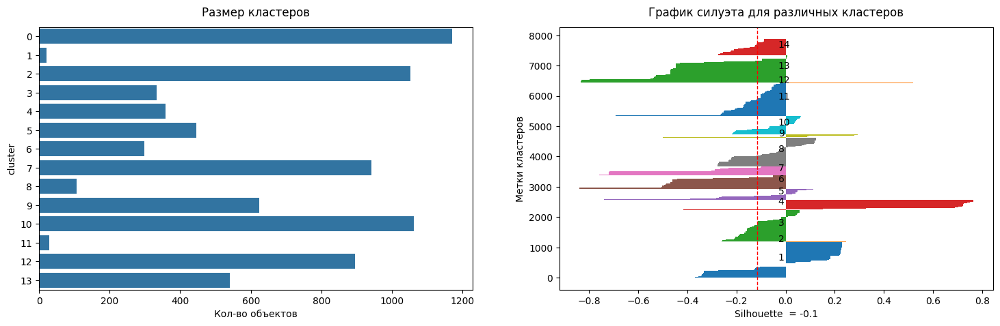

15 clusters
----------------------------------------------------------------------------------------------------


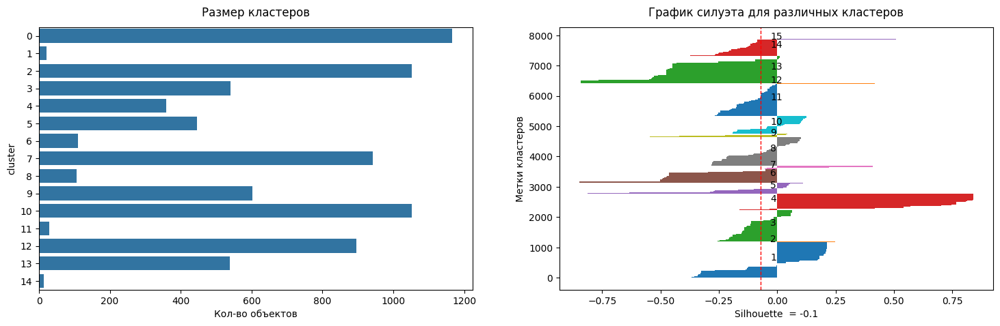

16 clusters
----------------------------------------------------------------------------------------------------


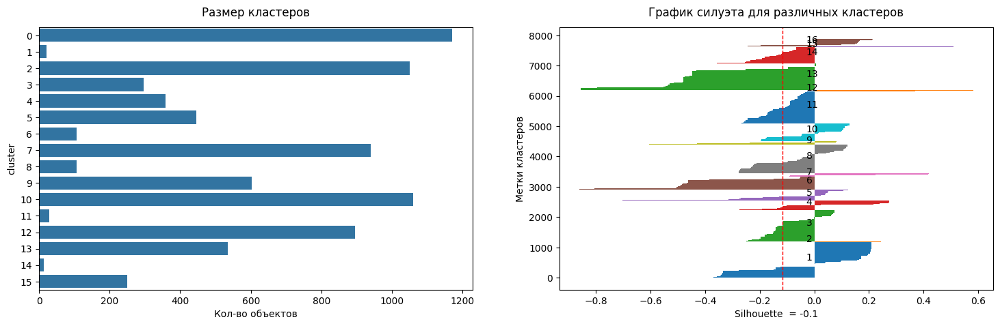

17 clusters
----------------------------------------------------------------------------------------------------


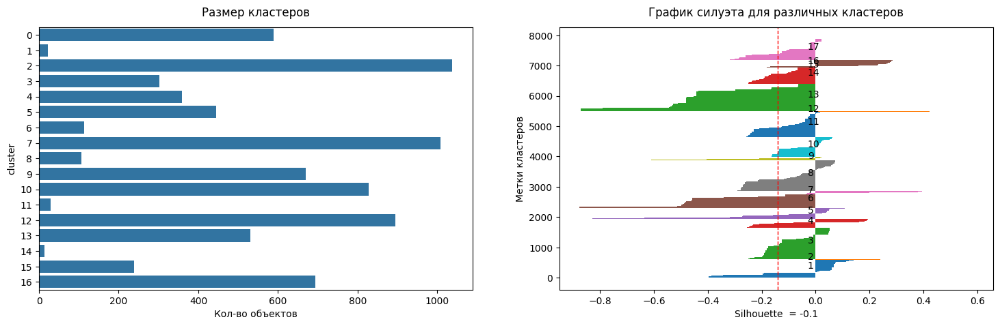

18 clusters
----------------------------------------------------------------------------------------------------


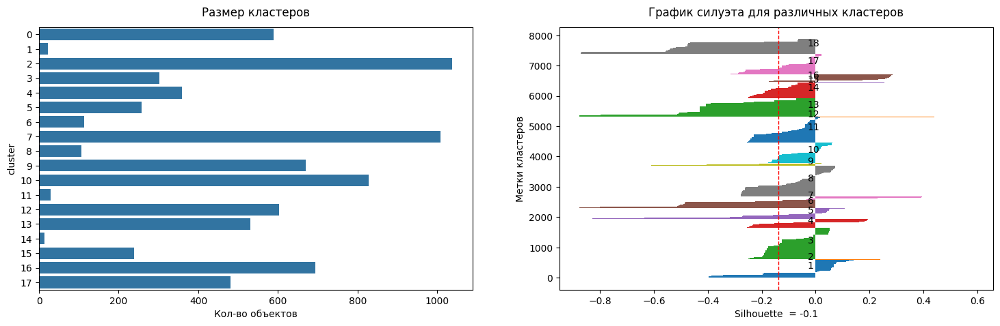

19 clusters
----------------------------------------------------------------------------------------------------


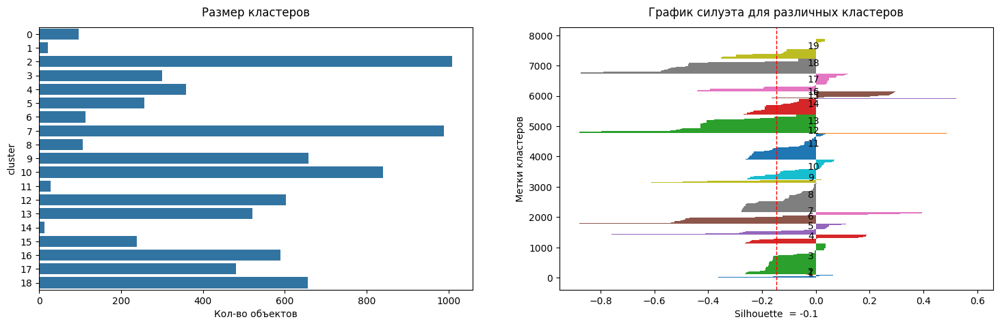

20 clusters
----------------------------------------------------------------------------------------------------


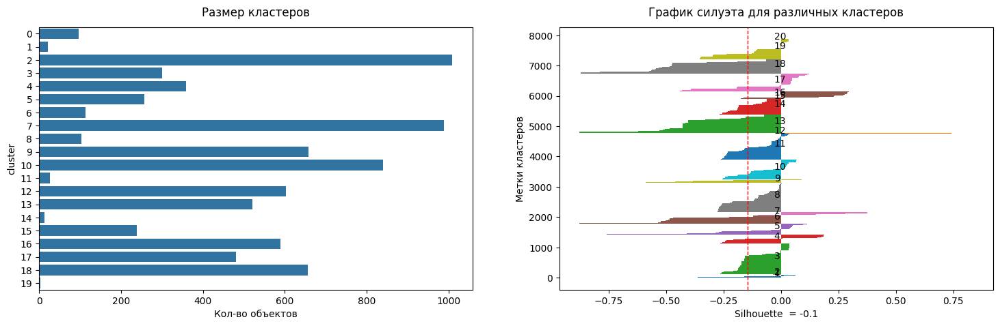

21 clusters
----------------------------------------------------------------------------------------------------


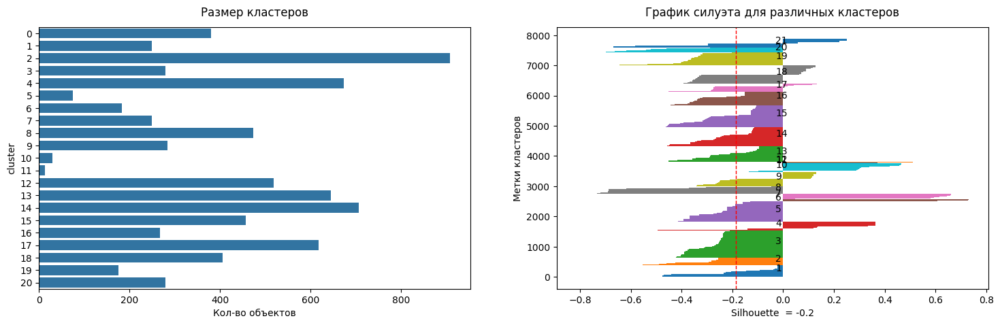

22 clusters
----------------------------------------------------------------------------------------------------


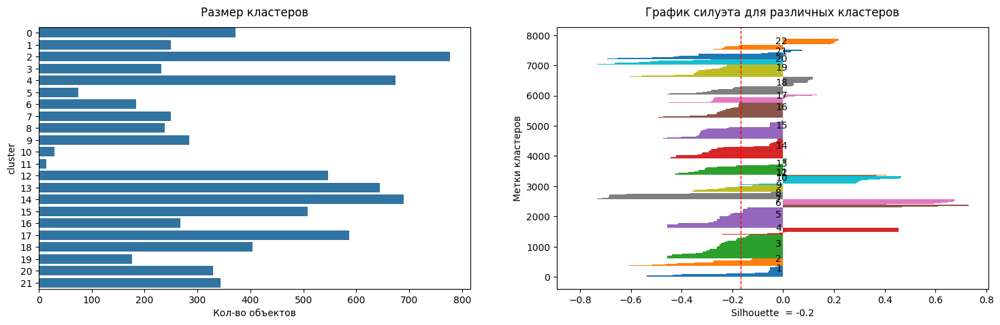

23 clusters
----------------------------------------------------------------------------------------------------


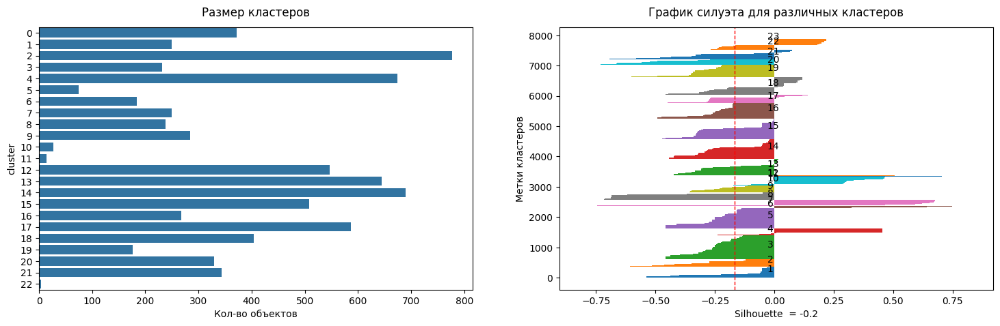

24 clusters
----------------------------------------------------------------------------------------------------


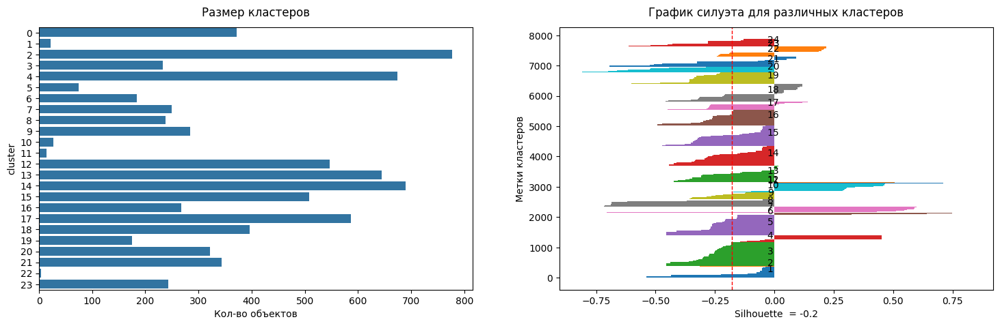

25 clusters
----------------------------------------------------------------------------------------------------


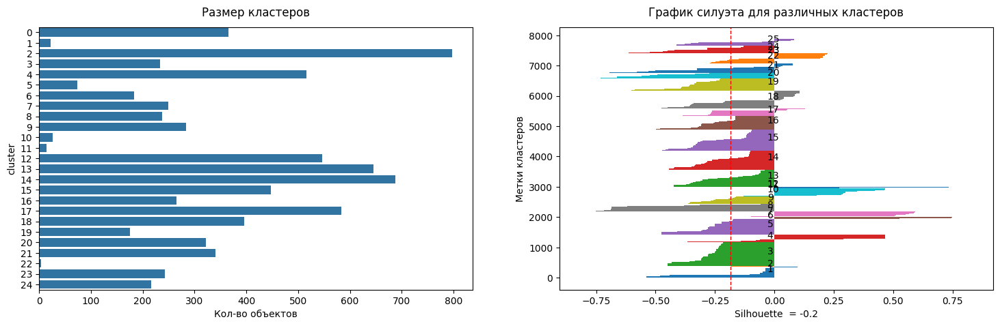

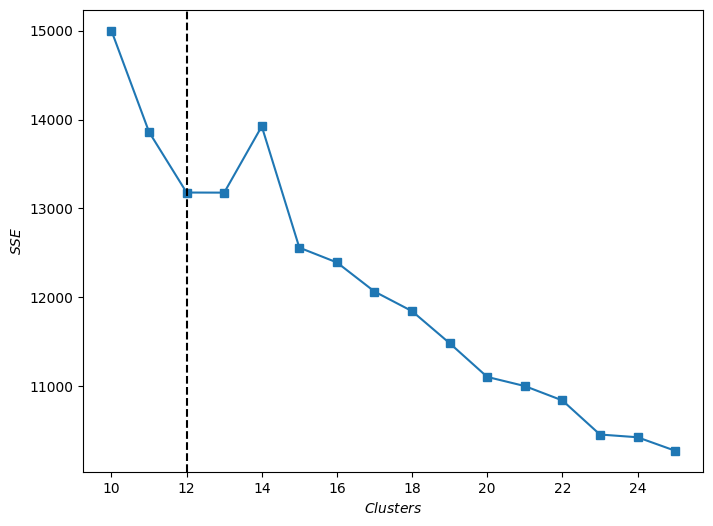

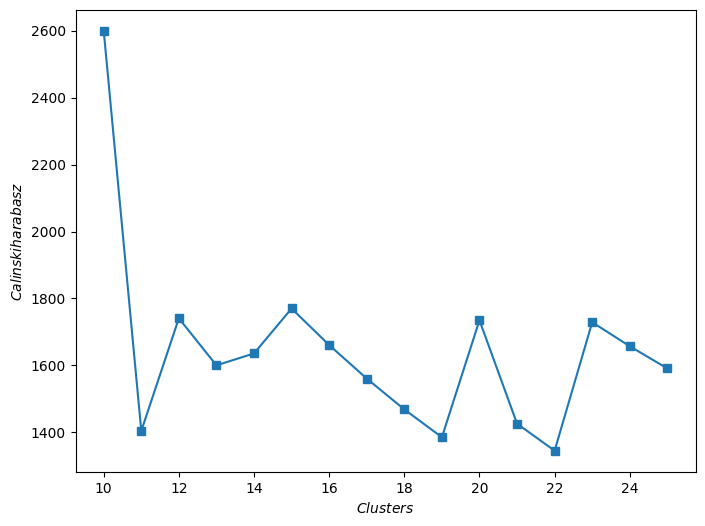

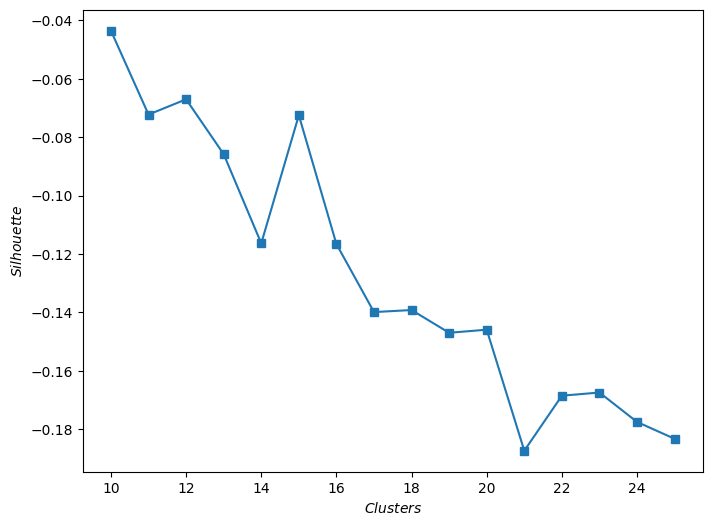

In [125]:
# подберем оптимальное количество кластеров
clust_km_pca_bert = clustering_analysis(data=df_bert,
                                           data_scale=df_scaled_bert,
                                           embedding=X_embedding_pca_bert,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

#### Без числовых данных

10 clusters
----------------------------------------------------------------------------------------------------


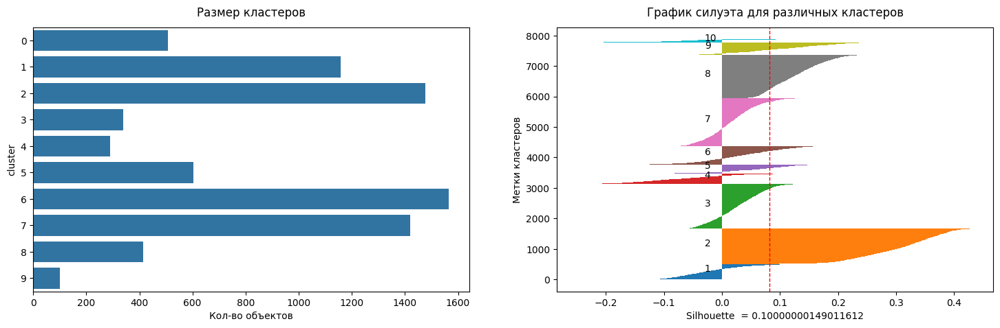

11 clusters
----------------------------------------------------------------------------------------------------


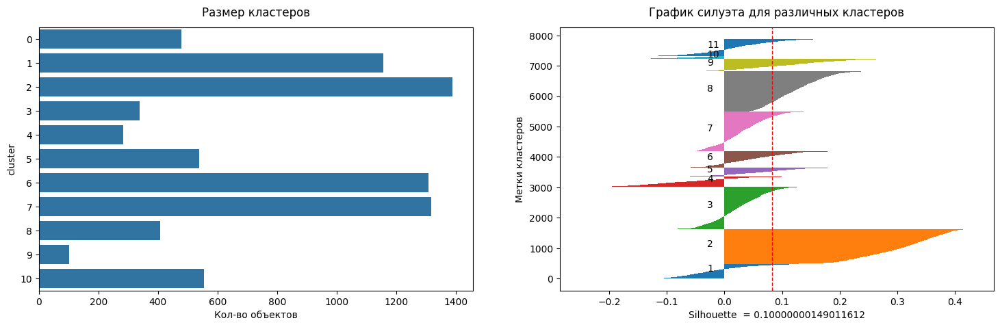

12 clusters
----------------------------------------------------------------------------------------------------


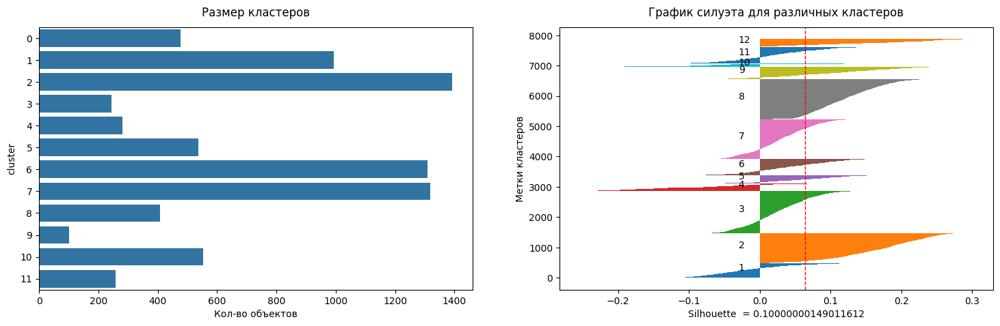

13 clusters
----------------------------------------------------------------------------------------------------


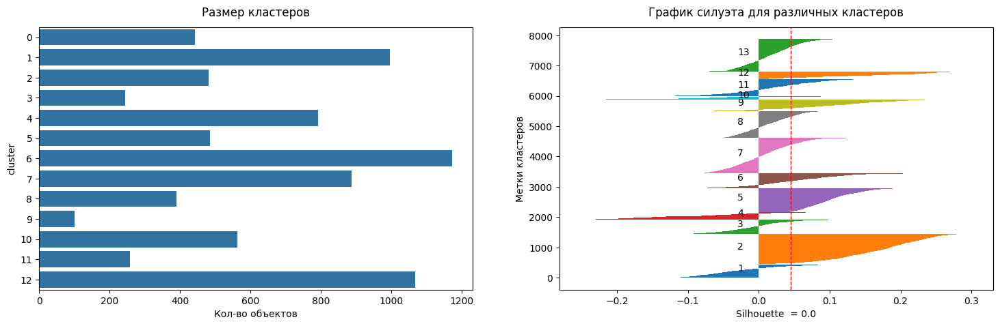

14 clusters
----------------------------------------------------------------------------------------------------


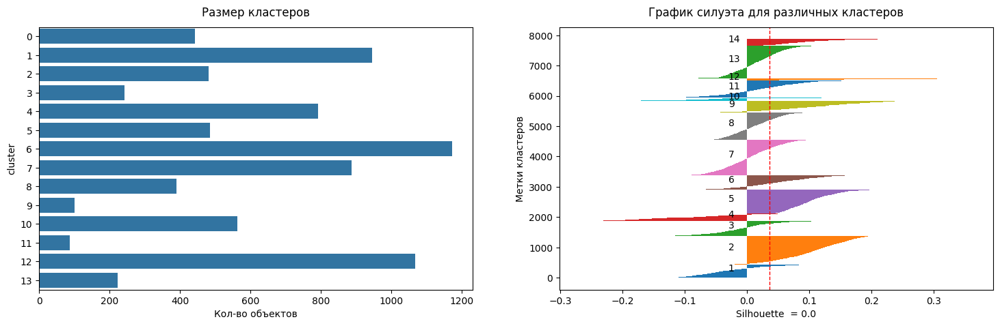

15 clusters
----------------------------------------------------------------------------------------------------


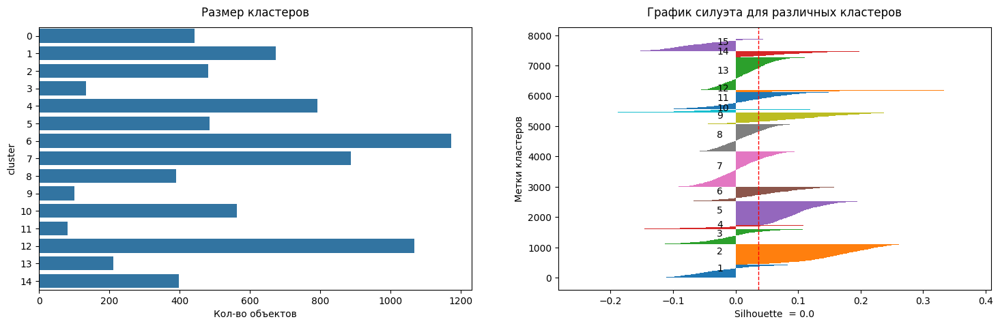

16 clusters
----------------------------------------------------------------------------------------------------


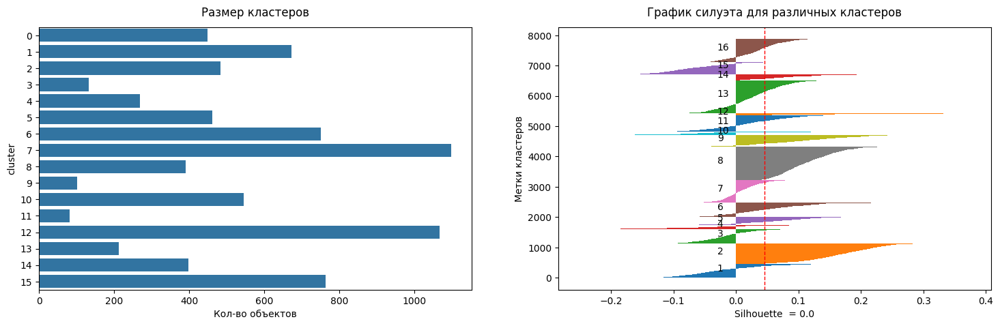

17 clusters
----------------------------------------------------------------------------------------------------


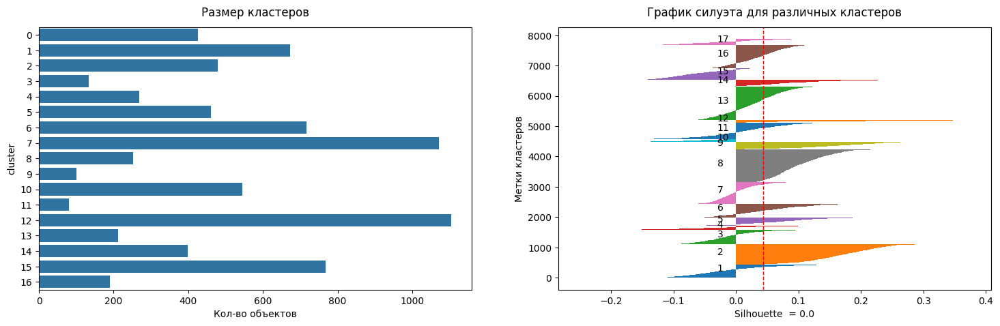

18 clusters
----------------------------------------------------------------------------------------------------


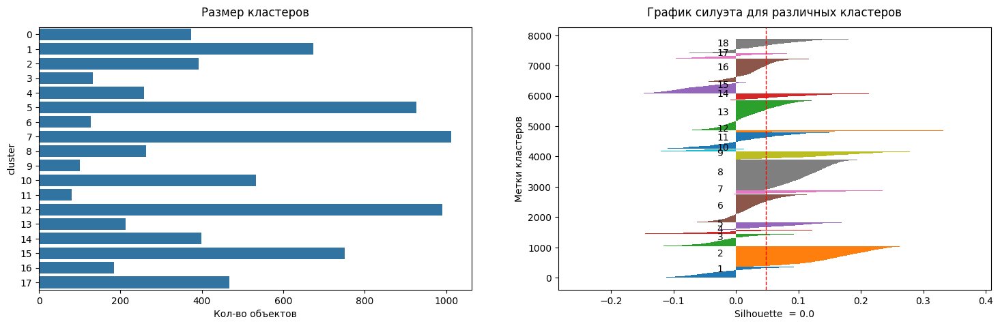

19 clusters
----------------------------------------------------------------------------------------------------


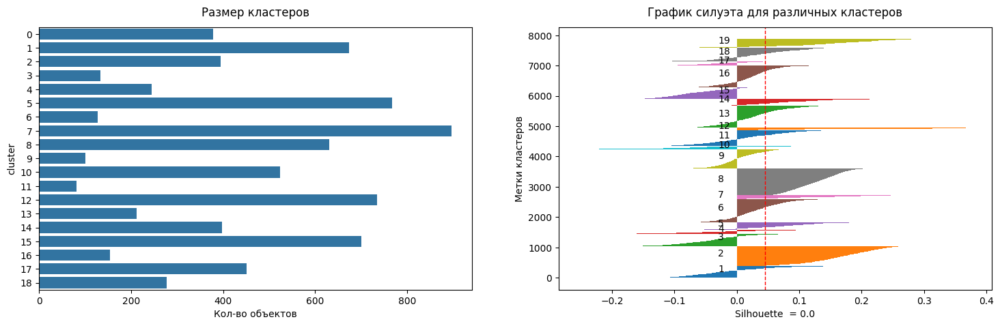

20 clusters
----------------------------------------------------------------------------------------------------


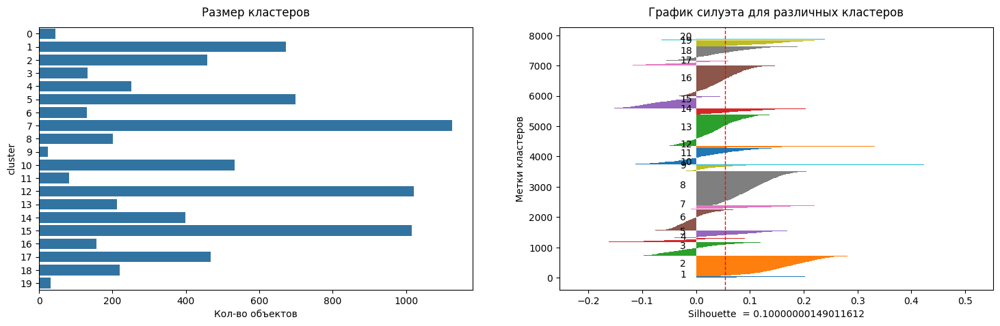

21 clusters
----------------------------------------------------------------------------------------------------


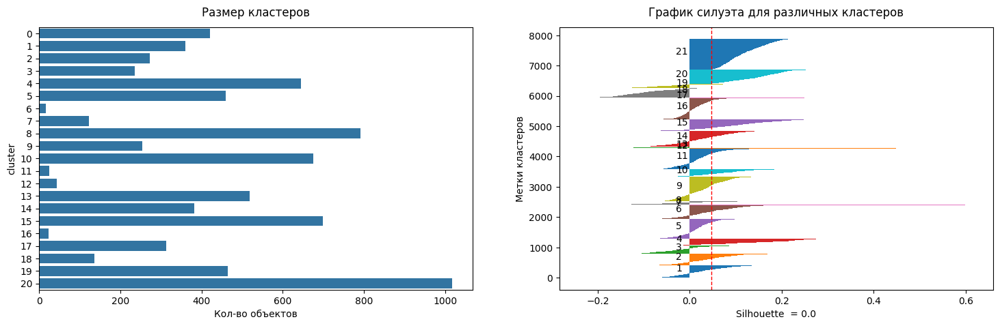

22 clusters
----------------------------------------------------------------------------------------------------


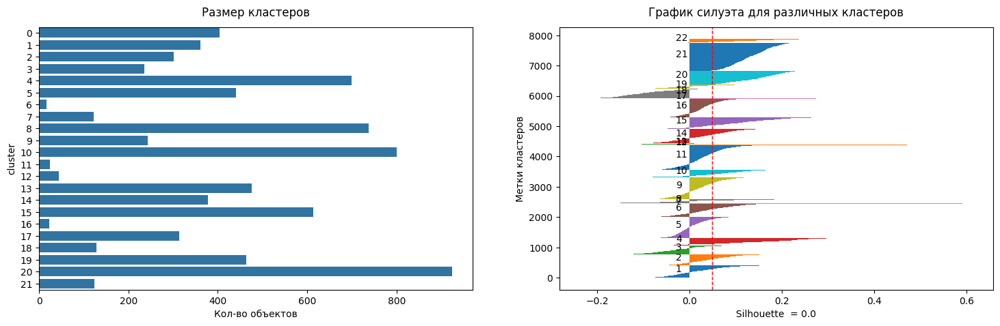

23 clusters
----------------------------------------------------------------------------------------------------


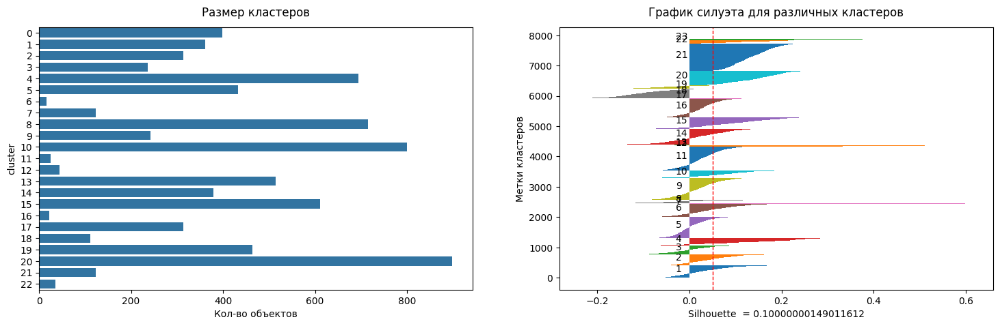

24 clusters
----------------------------------------------------------------------------------------------------


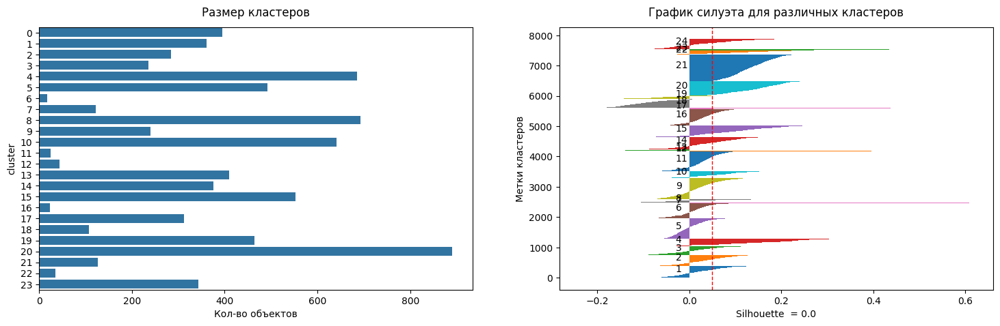

25 clusters
----------------------------------------------------------------------------------------------------


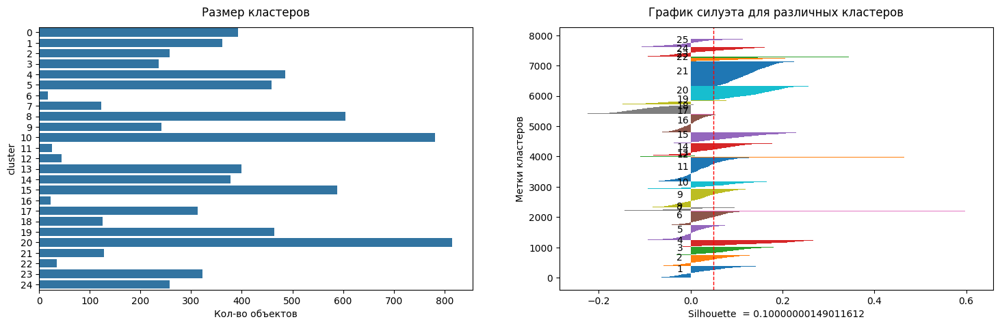

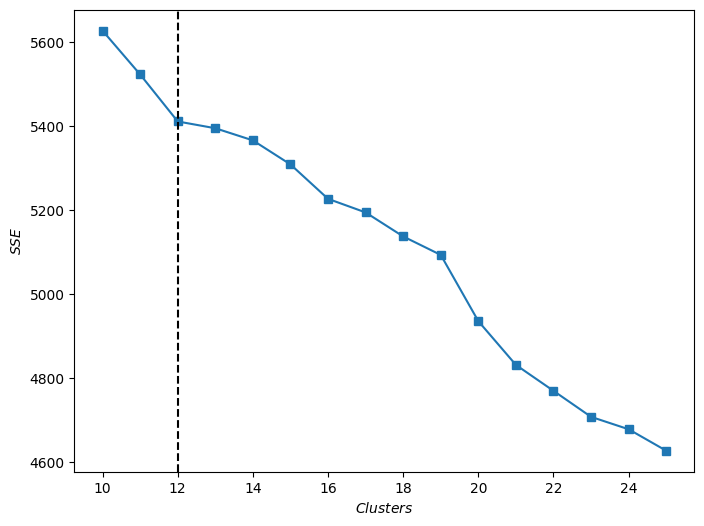

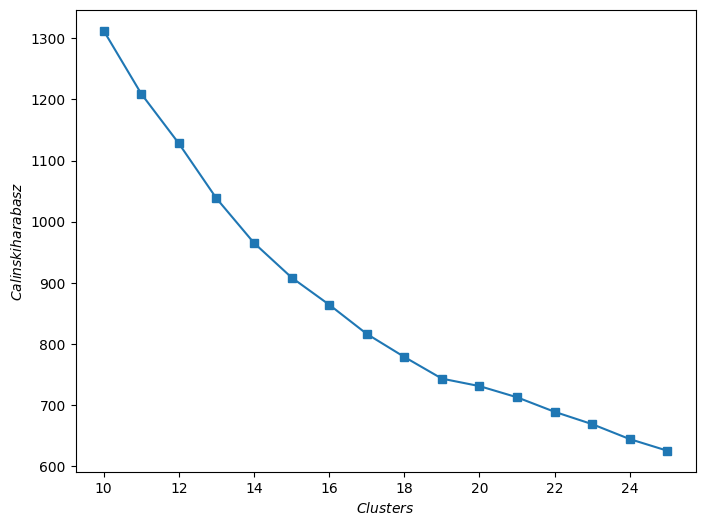

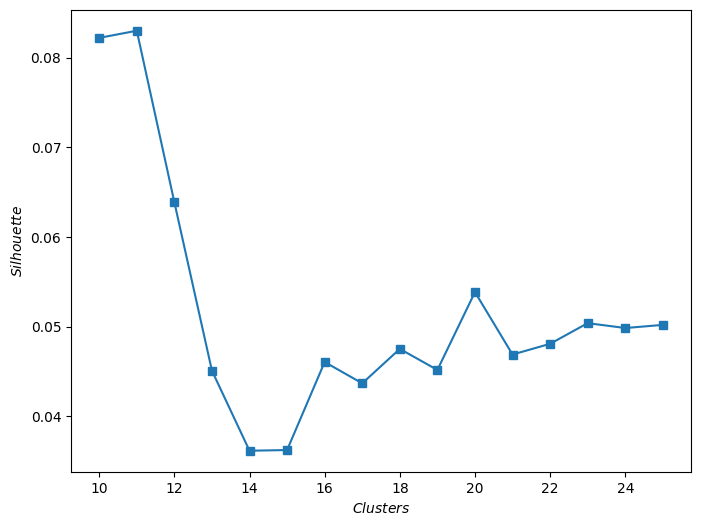

In [126]:
# подберем оптимальное количество кластеров
clust_km_pca_bert_text = clustering_analysis(data=df_bert_text,
                                           data_scale=df_bert_text,
                                           embedding=X_embedding_pca_bert_text,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

**Выводы:**

- алгоритм PCA+KMeans на всех данных не может выделить кластеры;
- при использовании bert без числовых данных алгоритм ведет себя лучше всего, но делает большие ошибки на кластерах

## UMAP + KMeans

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


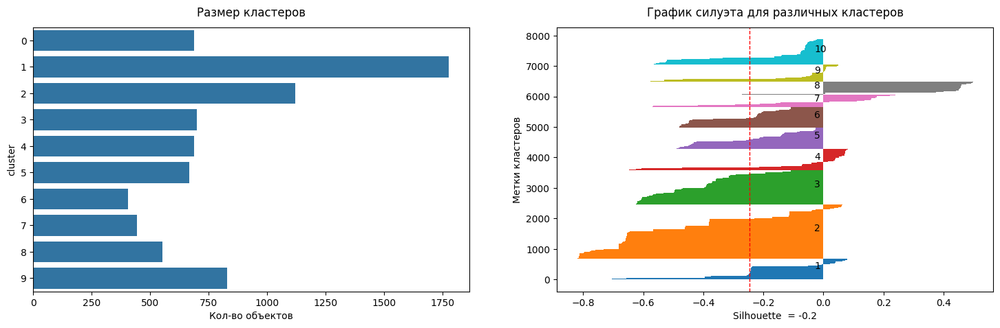

11 clusters
----------------------------------------------------------------------------------------------------


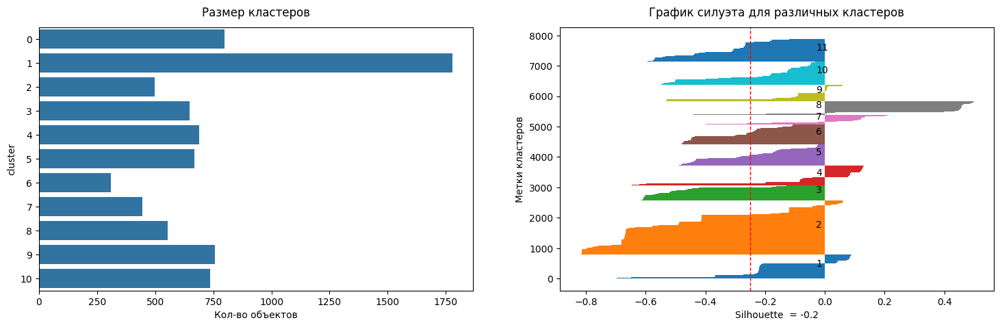

12 clusters
----------------------------------------------------------------------------------------------------


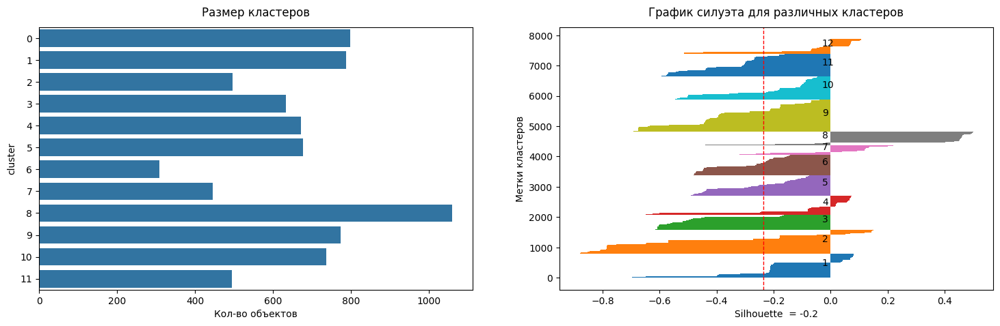

13 clusters
----------------------------------------------------------------------------------------------------


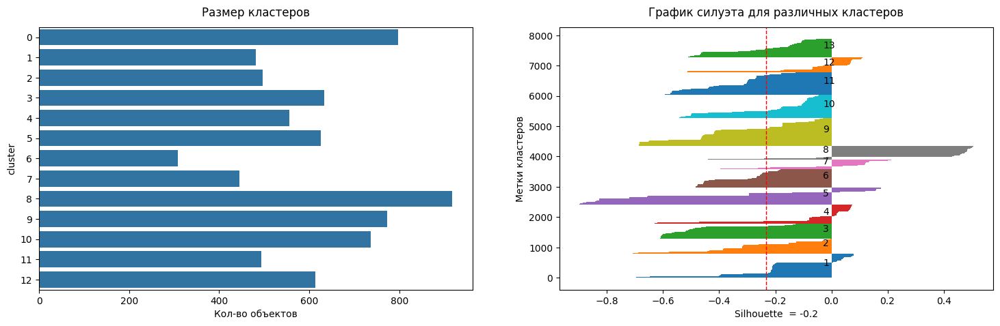

14 clusters
----------------------------------------------------------------------------------------------------


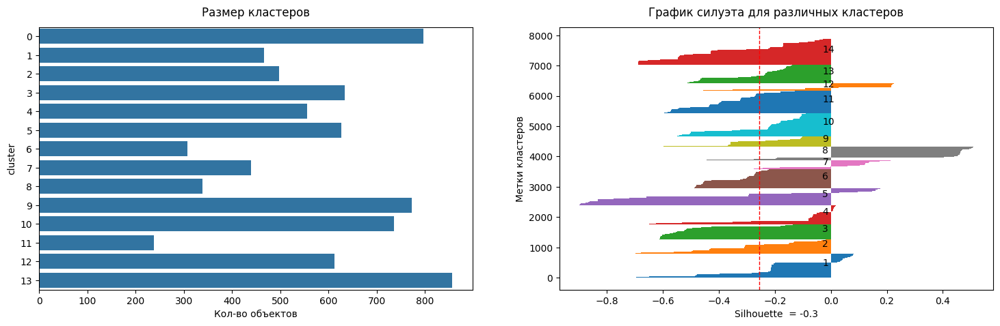

15 clusters
----------------------------------------------------------------------------------------------------


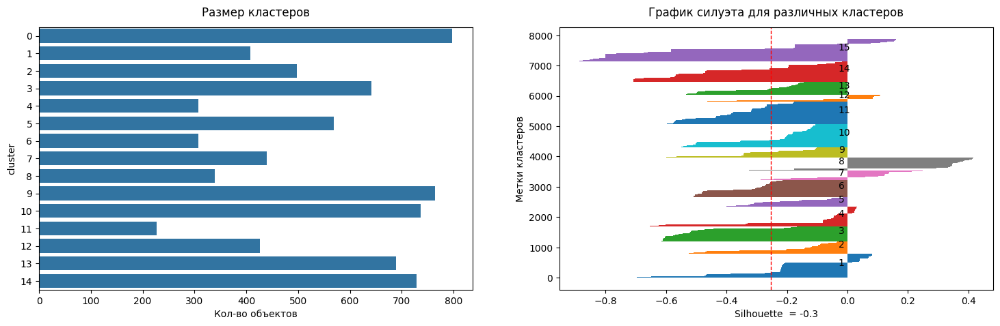

16 clusters
----------------------------------------------------------------------------------------------------


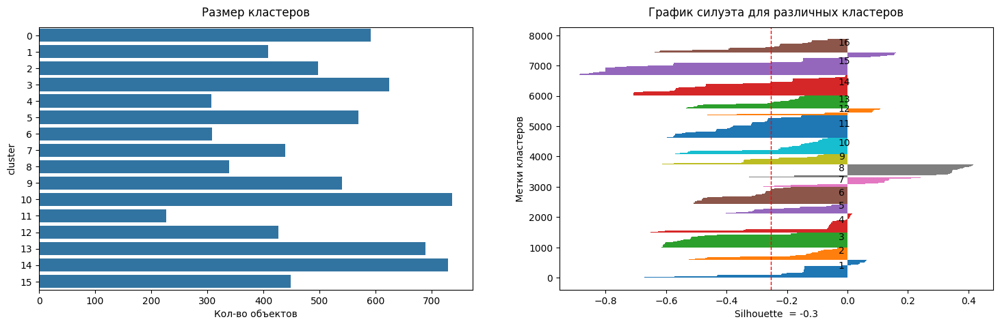

17 clusters
----------------------------------------------------------------------------------------------------


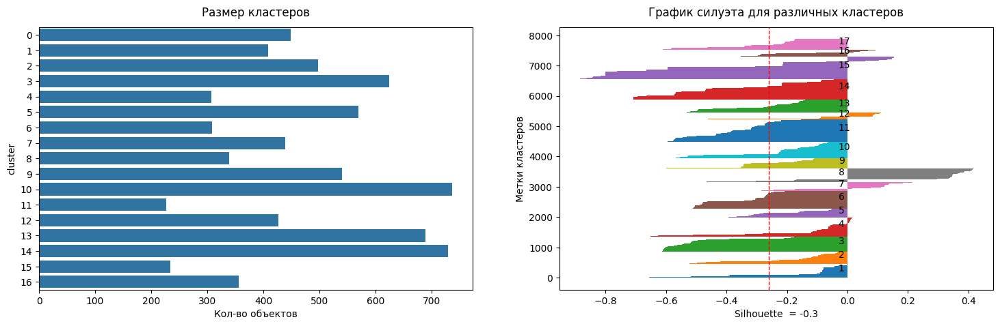

18 clusters
----------------------------------------------------------------------------------------------------


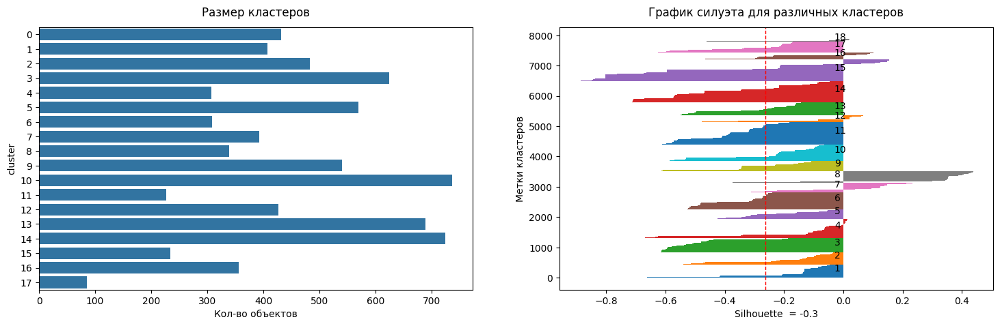

19 clusters
----------------------------------------------------------------------------------------------------


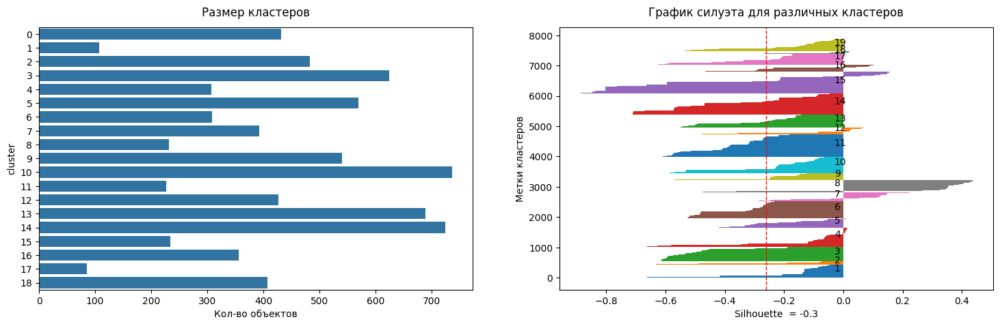

20 clusters
----------------------------------------------------------------------------------------------------


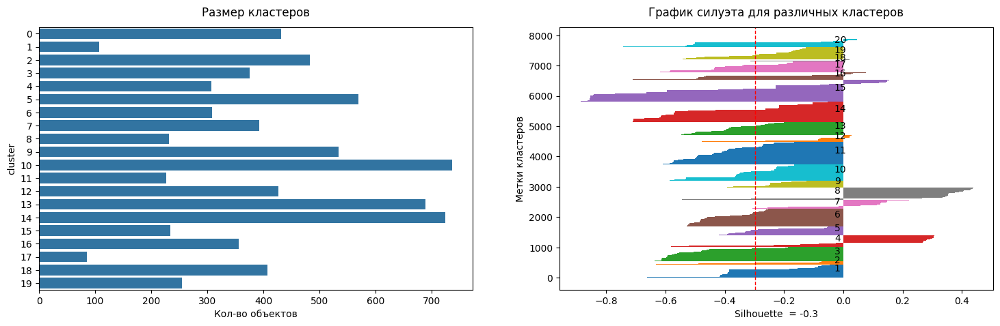

21 clusters
----------------------------------------------------------------------------------------------------


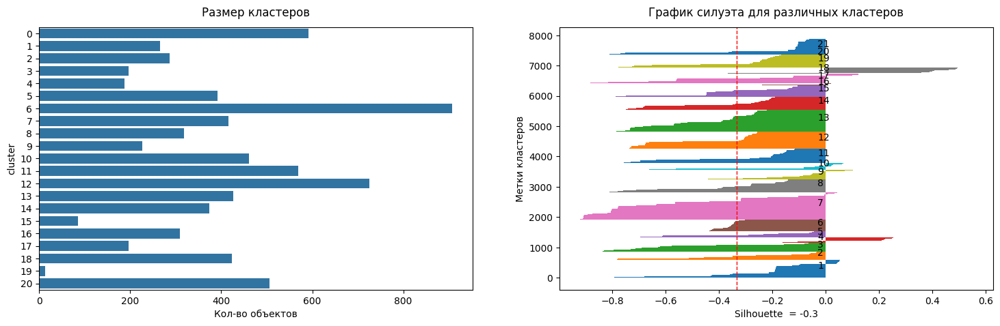

22 clusters
----------------------------------------------------------------------------------------------------


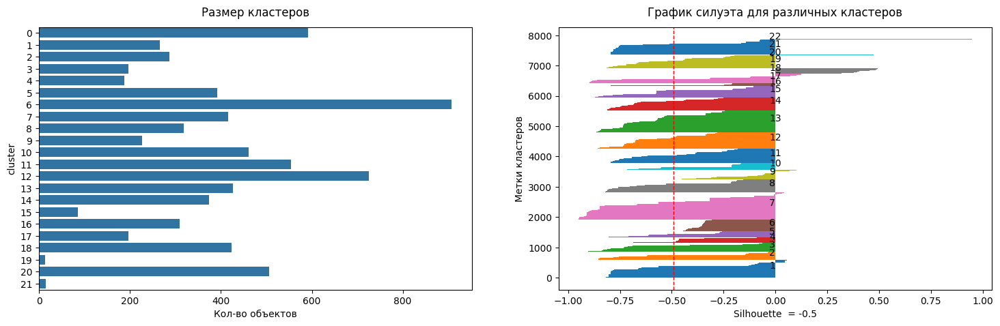

23 clusters
----------------------------------------------------------------------------------------------------


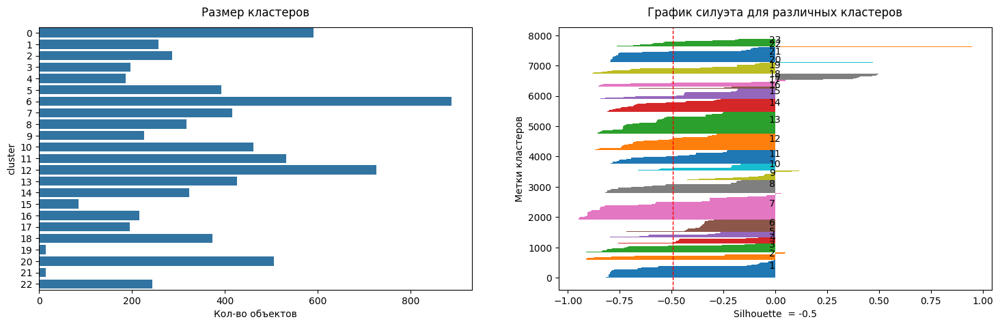

24 clusters
----------------------------------------------------------------------------------------------------


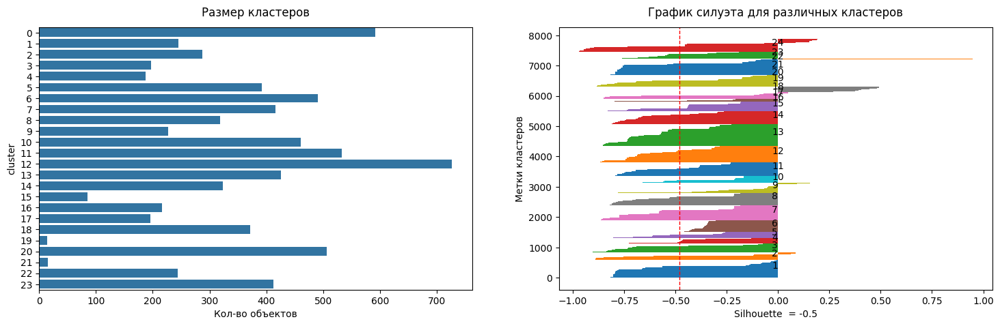

25 clusters
----------------------------------------------------------------------------------------------------


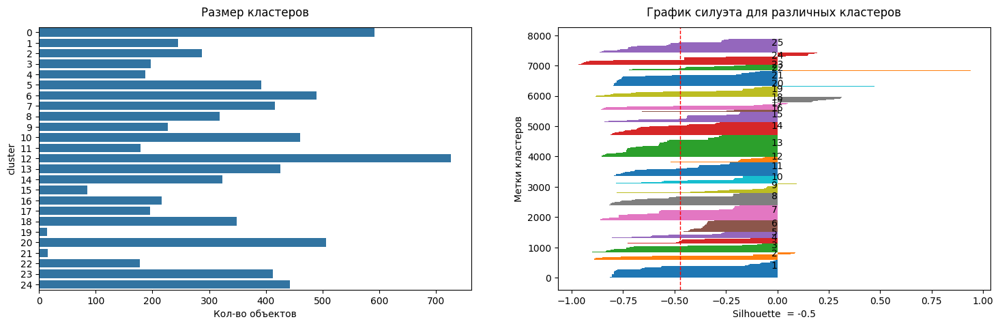

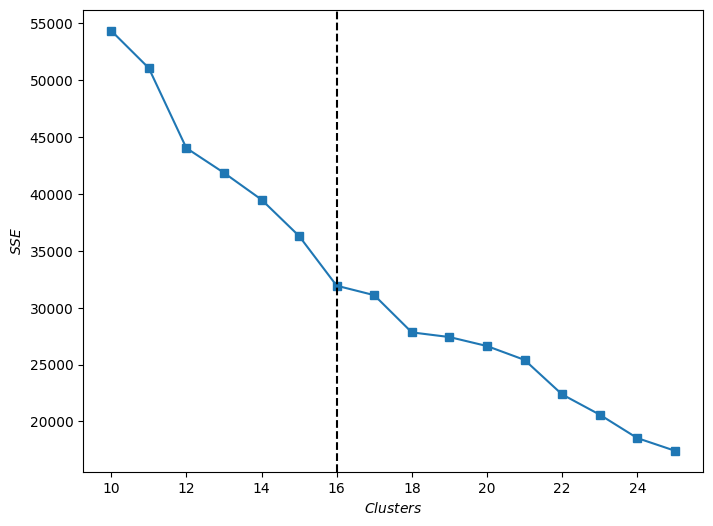

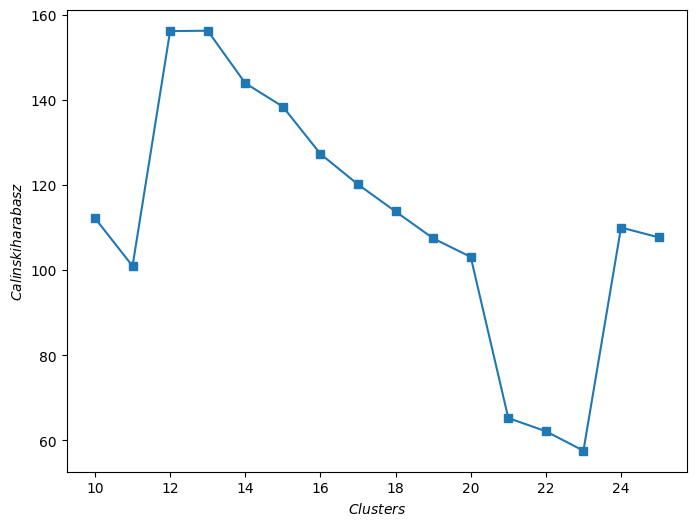

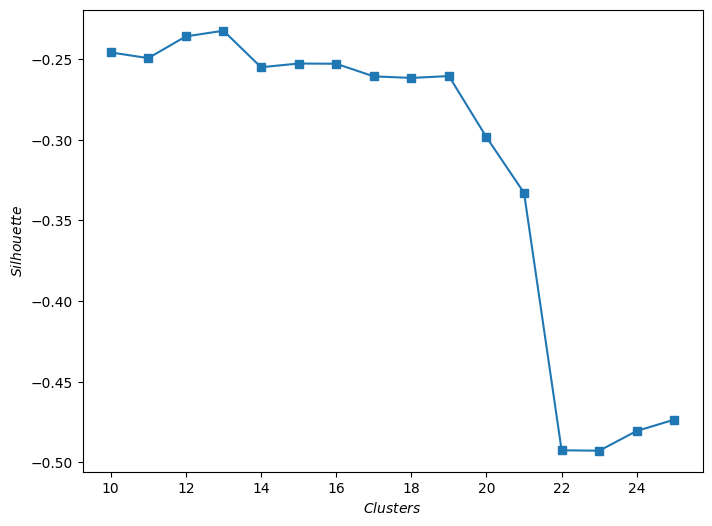

In [127]:
# подберем оптимальное количество кластеров
clust_km_umap_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=df_scaled_tf,
                                           embedding=X_embedding_umap_tf,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


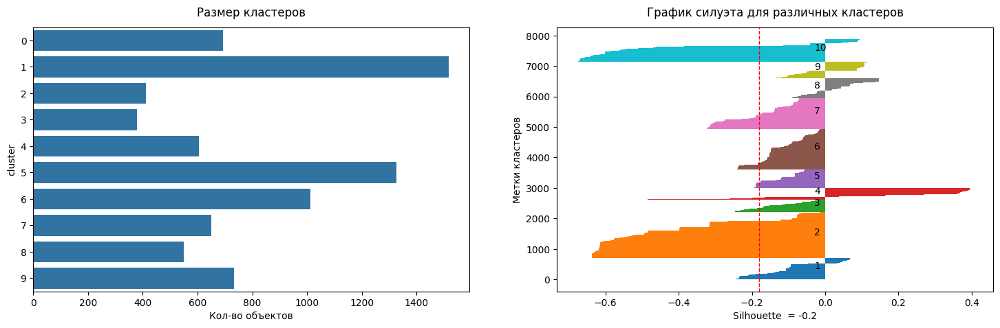

11 clusters
----------------------------------------------------------------------------------------------------


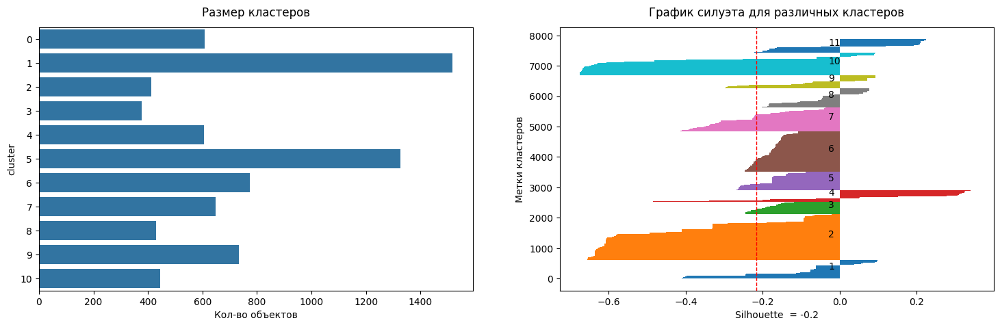

12 clusters
----------------------------------------------------------------------------------------------------


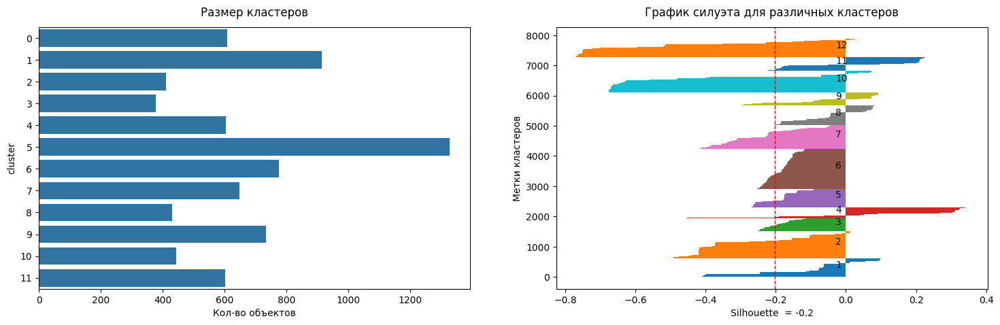

13 clusters
----------------------------------------------------------------------------------------------------


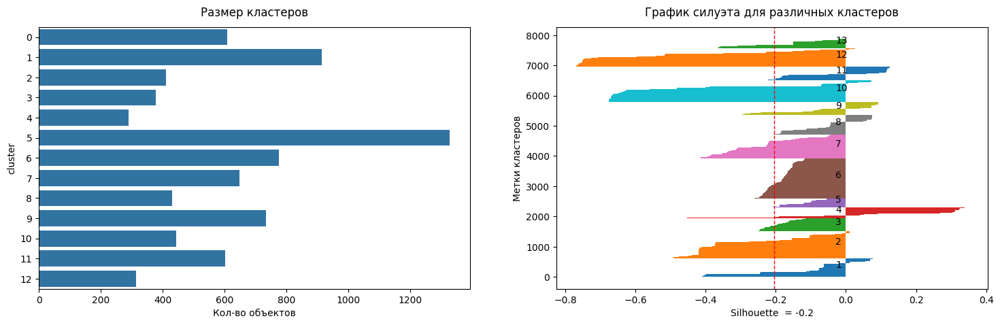

14 clusters
----------------------------------------------------------------------------------------------------


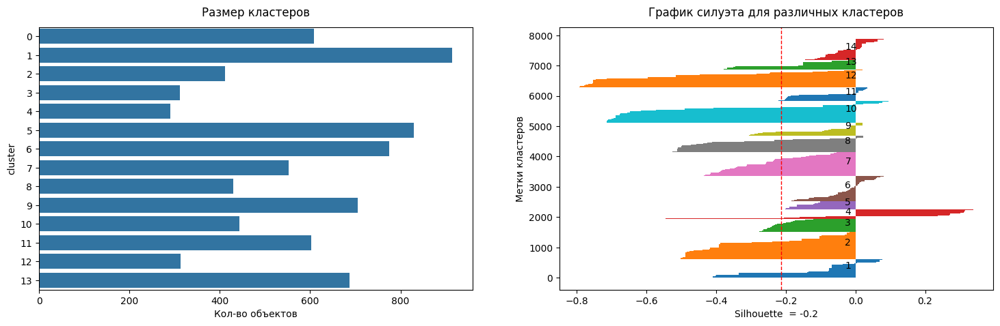

15 clusters
----------------------------------------------------------------------------------------------------


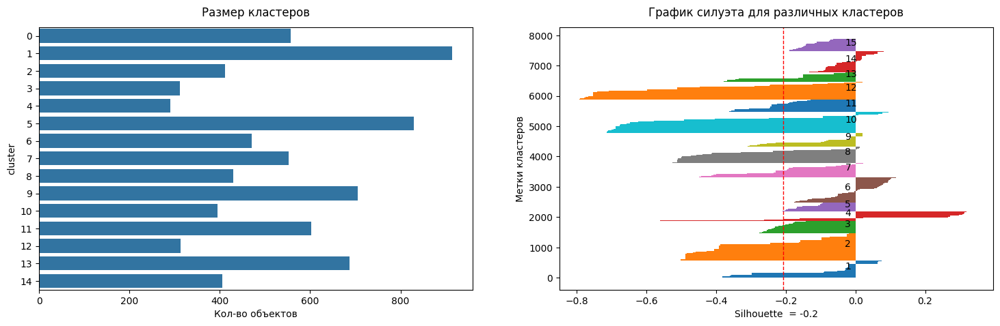

16 clusters
----------------------------------------------------------------------------------------------------


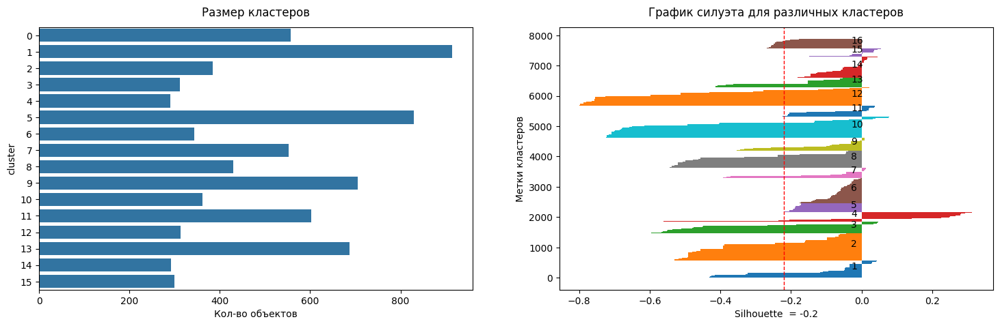

17 clusters
----------------------------------------------------------------------------------------------------


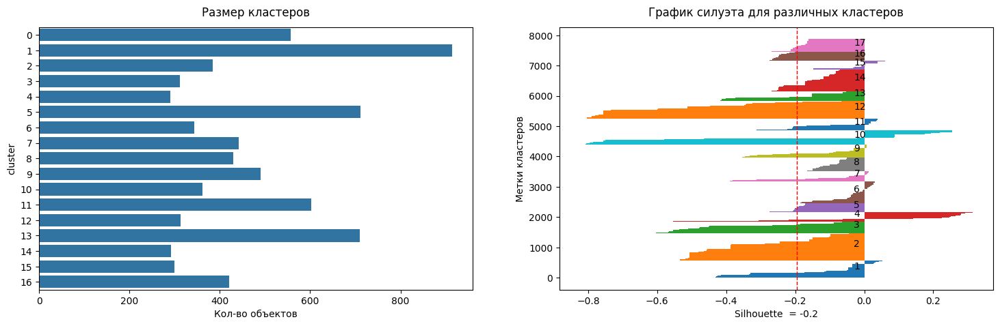

18 clusters
----------------------------------------------------------------------------------------------------


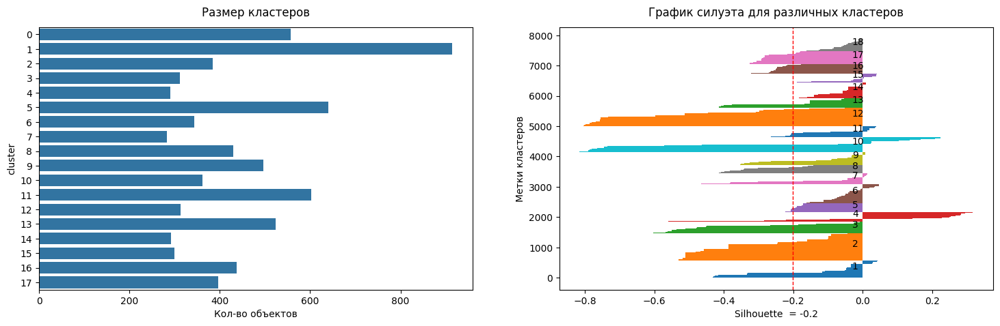

19 clusters
----------------------------------------------------------------------------------------------------


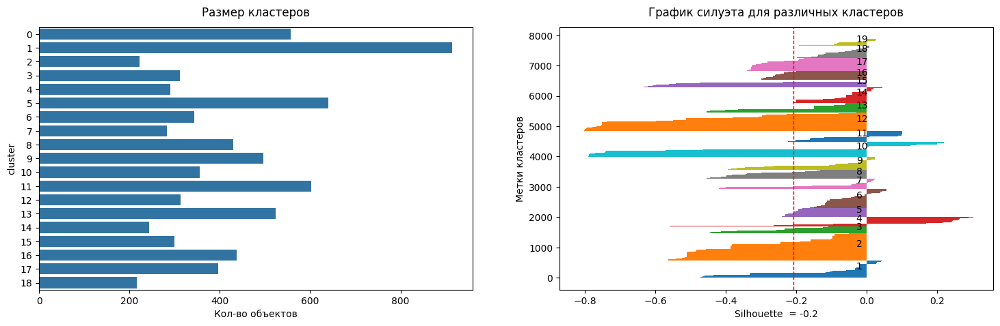

20 clusters
----------------------------------------------------------------------------------------------------


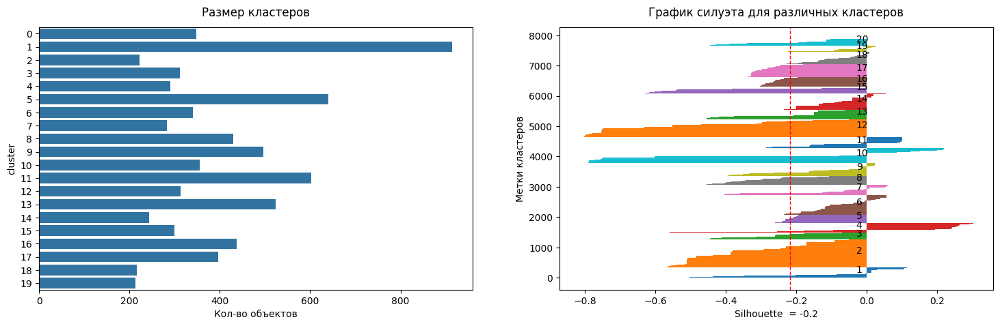

21 clusters
----------------------------------------------------------------------------------------------------


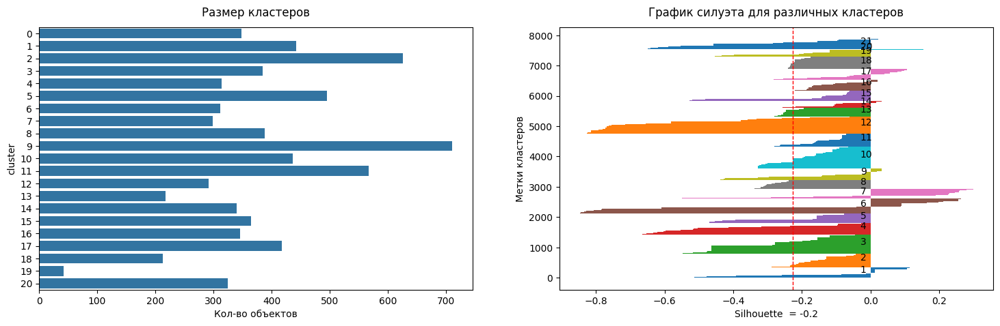

22 clusters
----------------------------------------------------------------------------------------------------


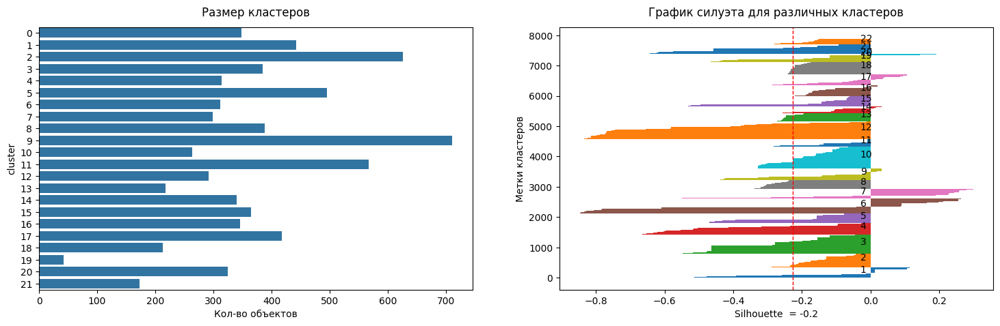

23 clusters
----------------------------------------------------------------------------------------------------


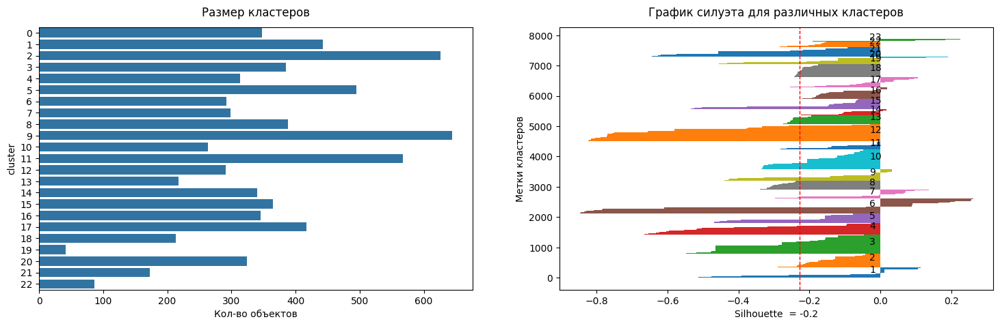

24 clusters
----------------------------------------------------------------------------------------------------


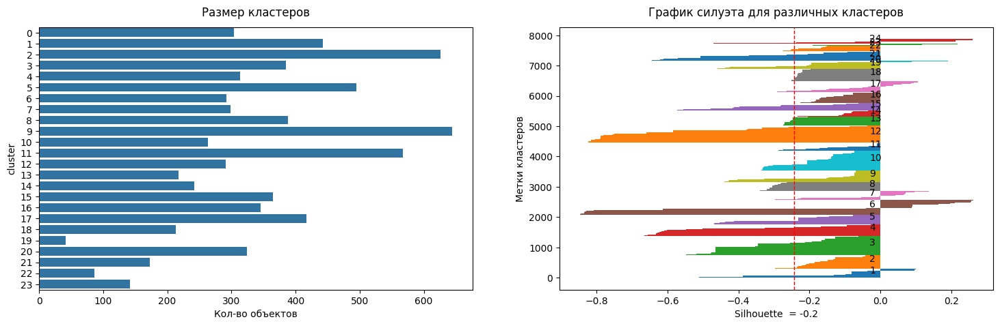

25 clusters
----------------------------------------------------------------------------------------------------


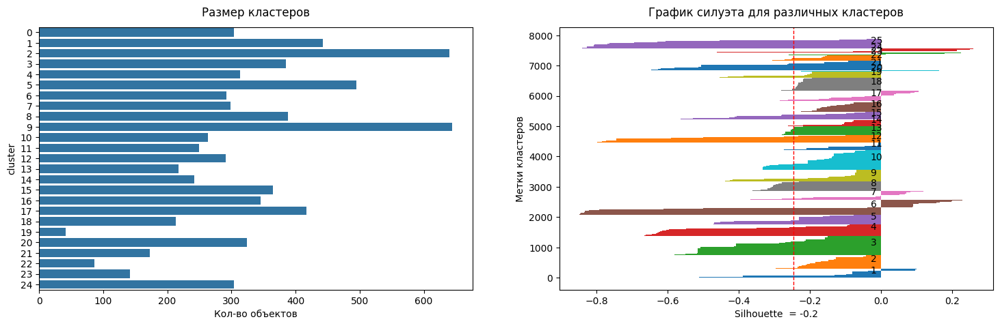

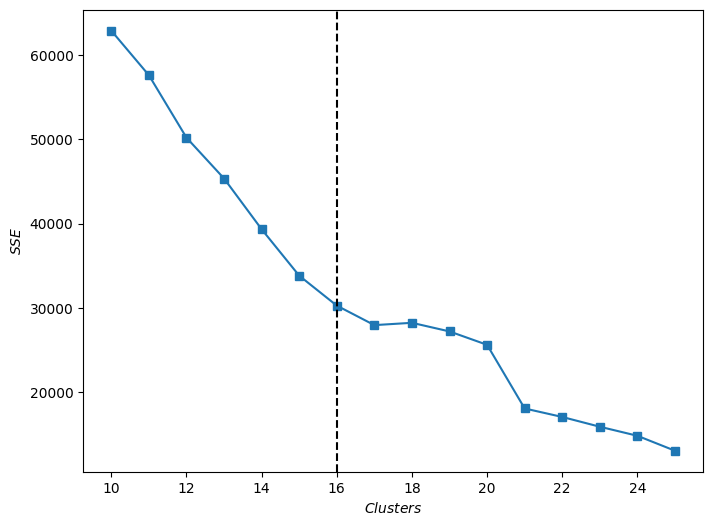

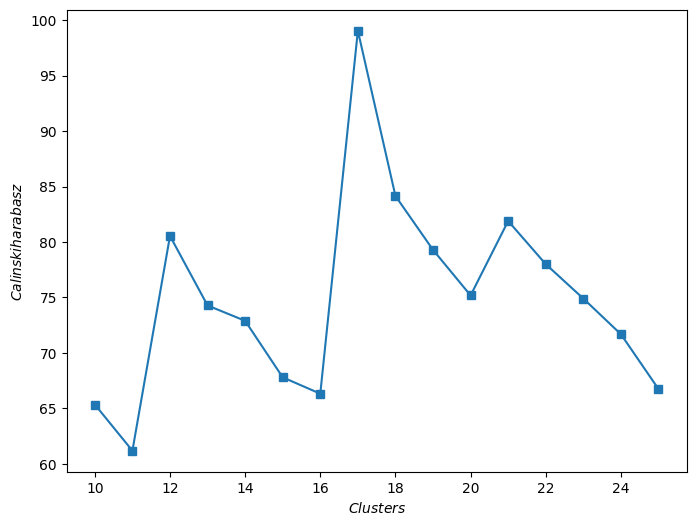

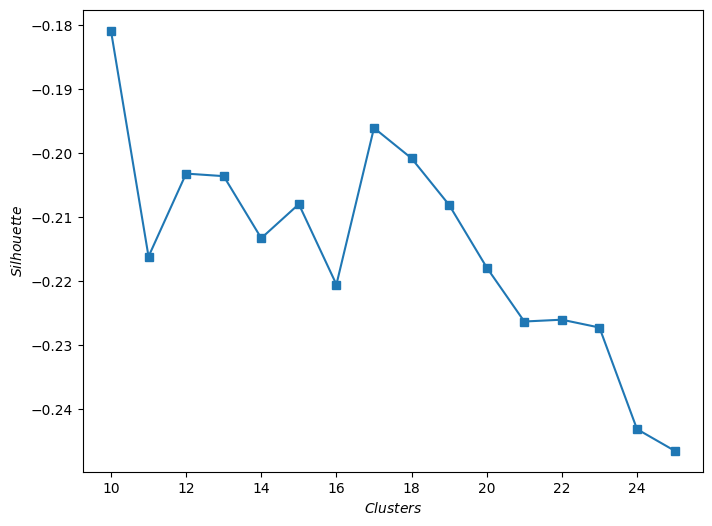

In [128]:
# подберем оптимальное количество кластеров
clust_km_umap_bert = clustering_analysis(data=df_bert,
                                           data_scale=df_scaled_bert,
                                           embedding=X_embedding_umap_bert,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

#### Без числовых данных

10 clusters
----------------------------------------------------------------------------------------------------


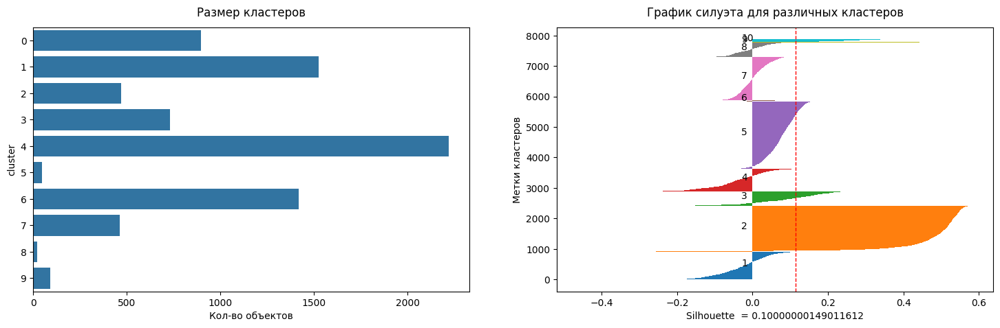

11 clusters
----------------------------------------------------------------------------------------------------


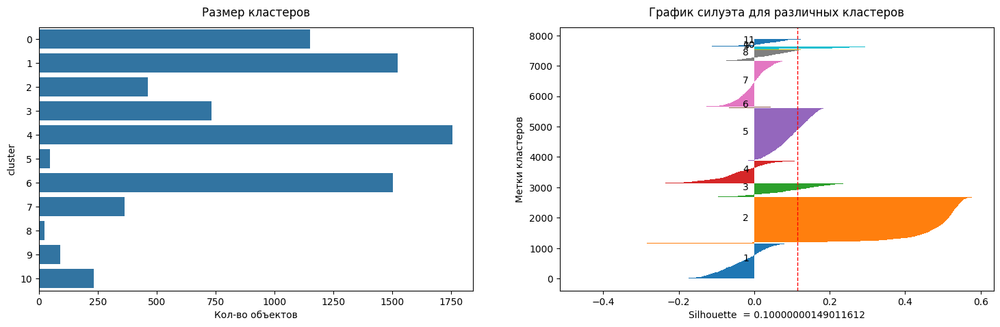

12 clusters
----------------------------------------------------------------------------------------------------


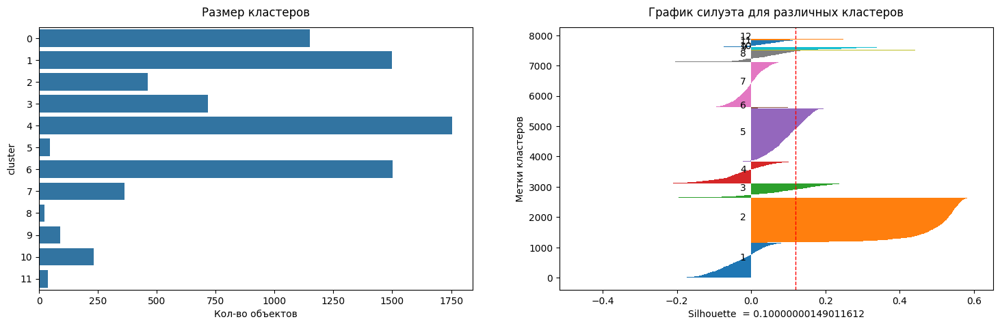

13 clusters
----------------------------------------------------------------------------------------------------


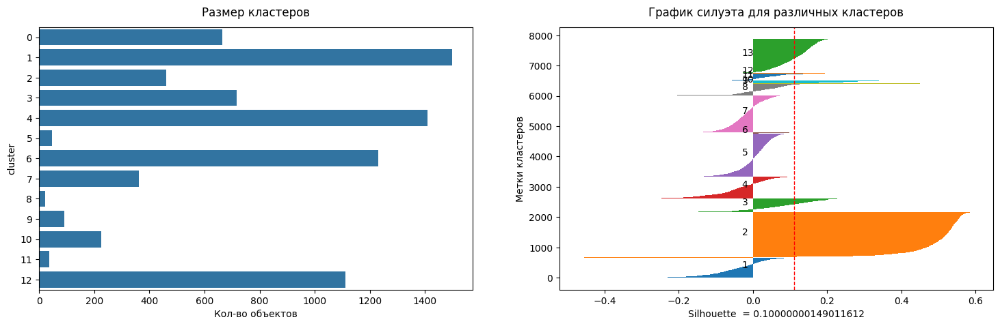

14 clusters
----------------------------------------------------------------------------------------------------


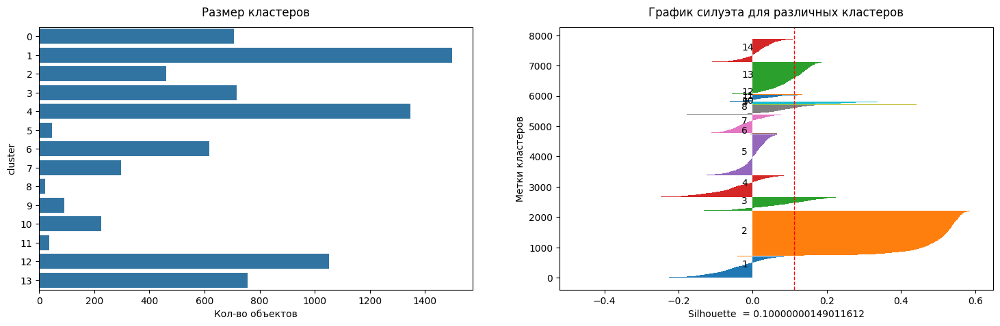

15 clusters
----------------------------------------------------------------------------------------------------


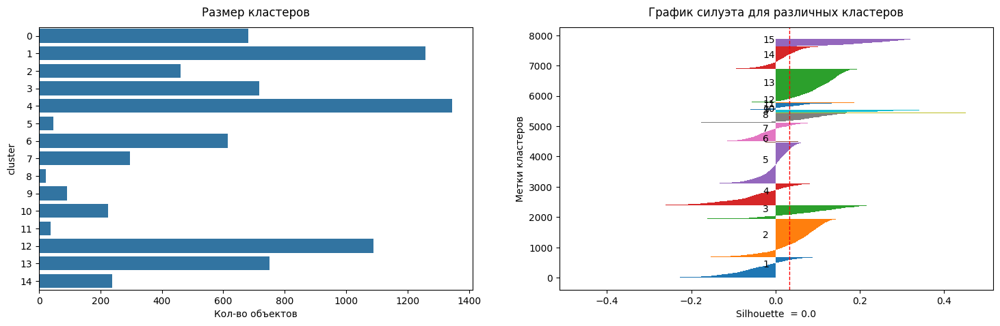

16 clusters
----------------------------------------------------------------------------------------------------


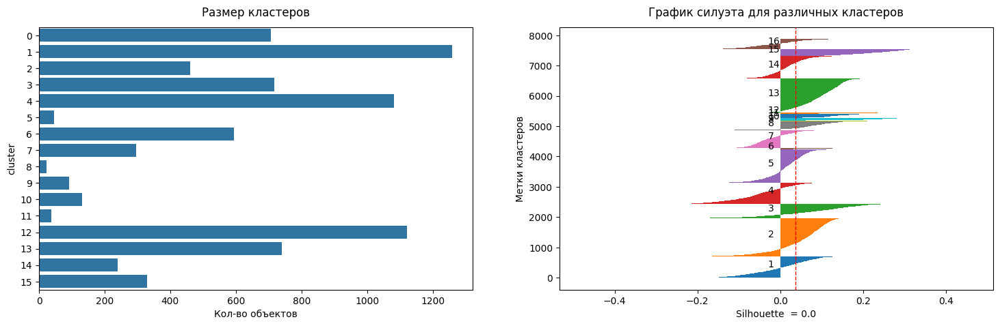

17 clusters
----------------------------------------------------------------------------------------------------


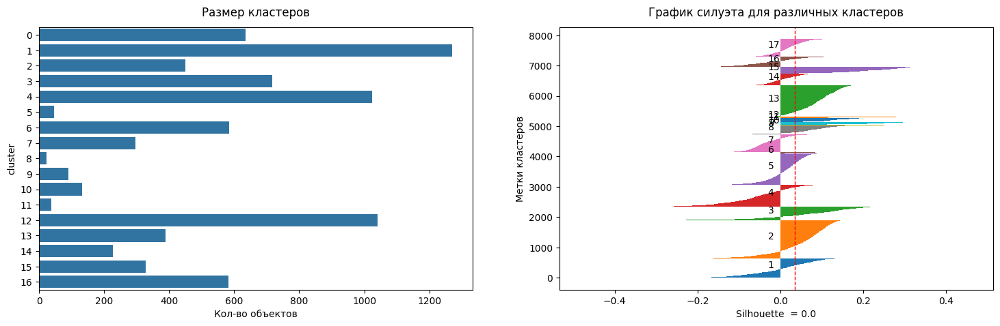

18 clusters
----------------------------------------------------------------------------------------------------


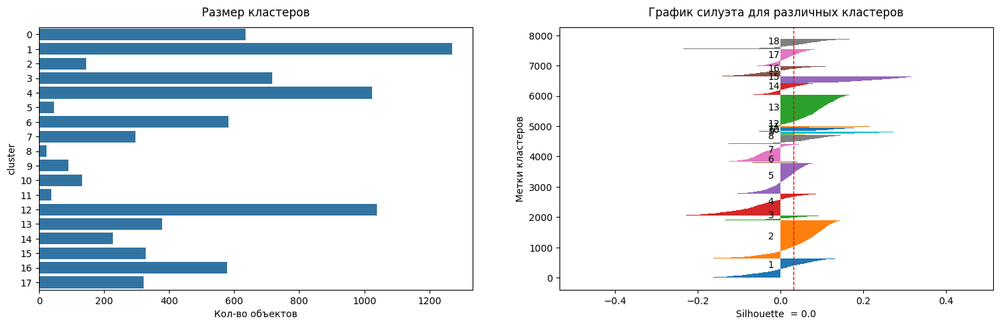

19 clusters
----------------------------------------------------------------------------------------------------


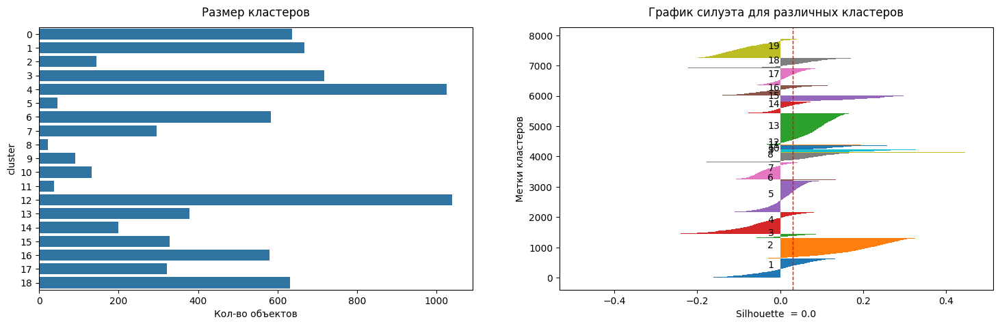

20 clusters
----------------------------------------------------------------------------------------------------


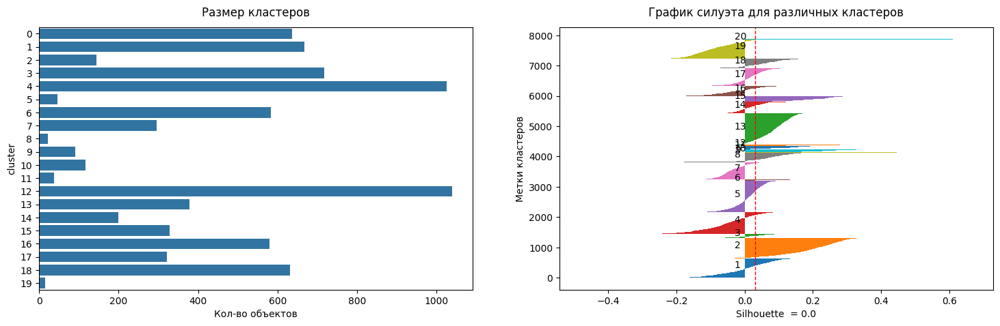

21 clusters
----------------------------------------------------------------------------------------------------


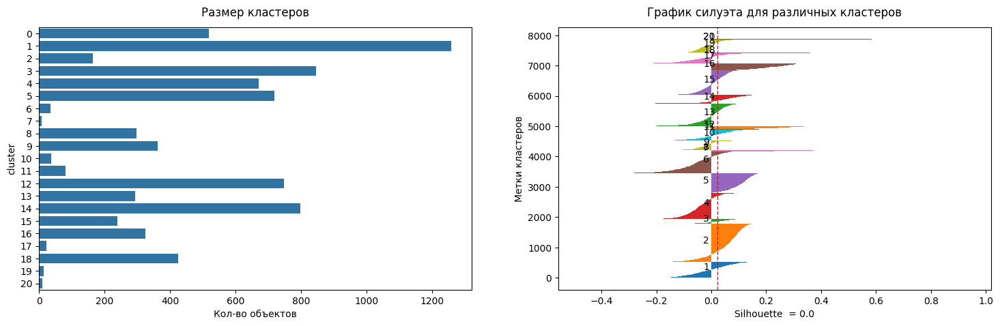

22 clusters
----------------------------------------------------------------------------------------------------


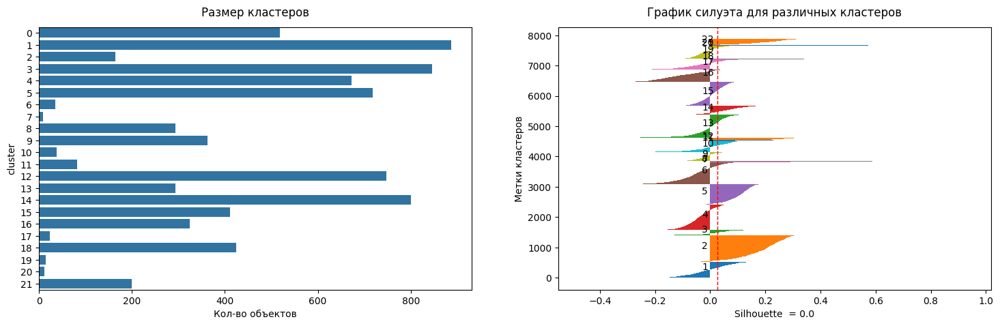

23 clusters
----------------------------------------------------------------------------------------------------


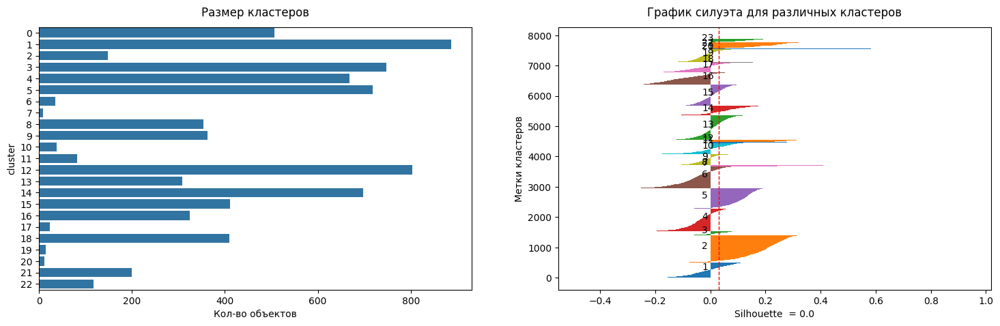

24 clusters
----------------------------------------------------------------------------------------------------


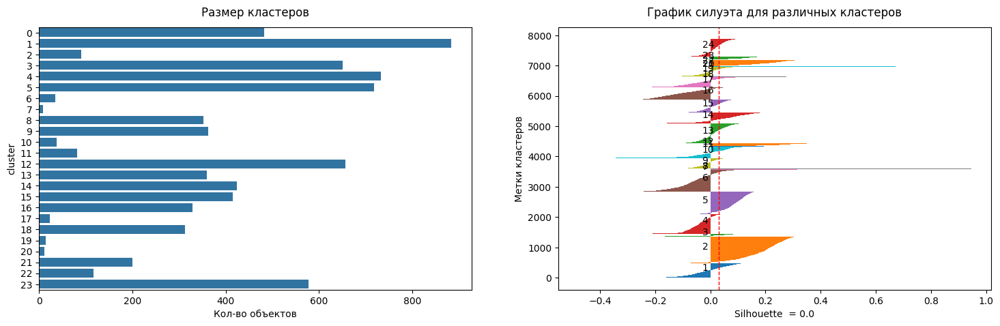

25 clusters
----------------------------------------------------------------------------------------------------


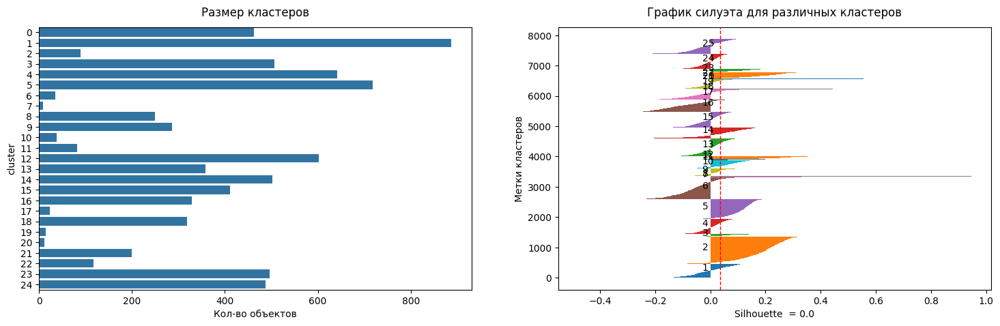

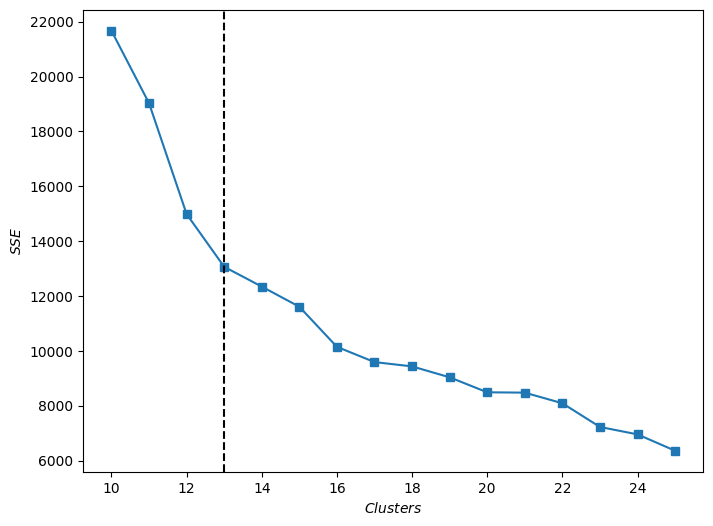

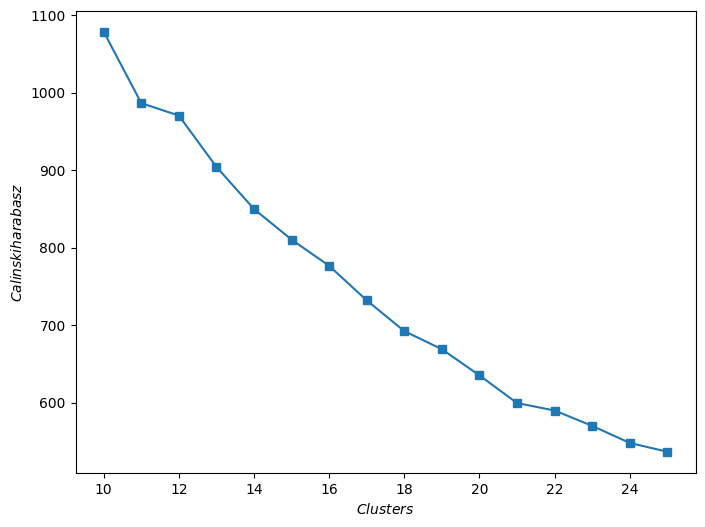

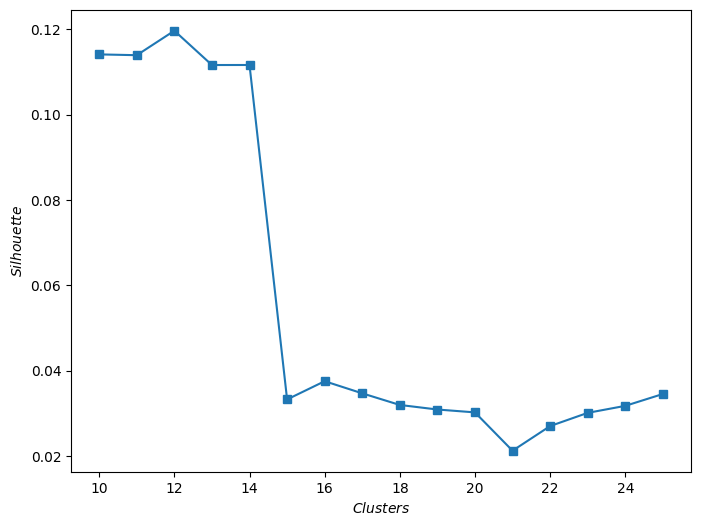

In [129]:
# подберем оптимальное количество кластеров
clust_km_umap_bert_text = clustering_analysis(data=df_bert_text,
                                           data_scale=df_bert_text,
                                           embedding=X_embedding_umap_bert_text,
                                           model=KMeans,
                                           kwargs=params_cluster['KMeans'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

**Выводы:**

- алгоритм UMAP+KMeans на всех данных не может выделить кластеры;
- при использовании bert без числовых данных алгоритм ведет себя лучше всего, но делает большие ошибки на кластерах

## UMAP + Faiss

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


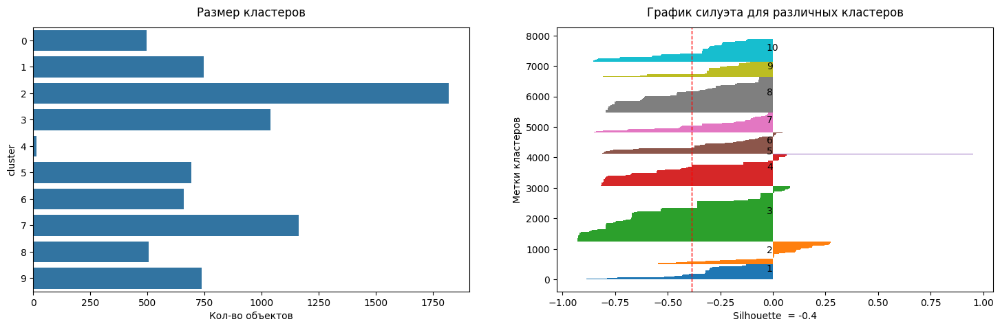

11 clusters
----------------------------------------------------------------------------------------------------


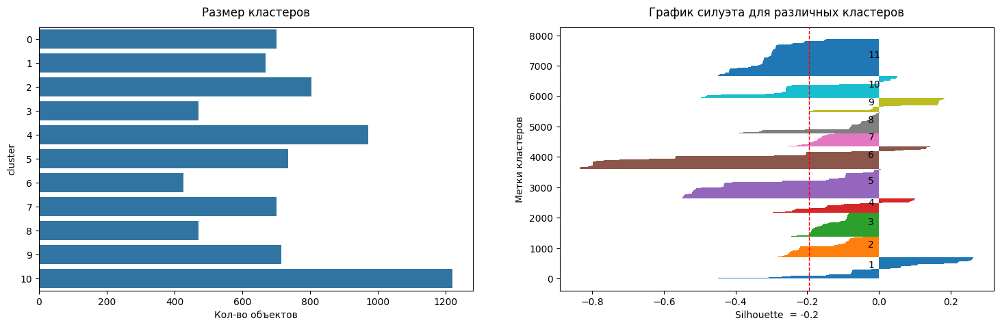

12 clusters
----------------------------------------------------------------------------------------------------


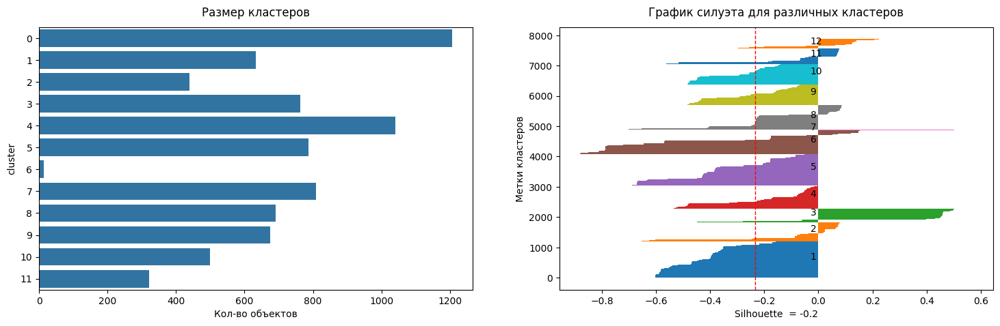

13 clusters
----------------------------------------------------------------------------------------------------


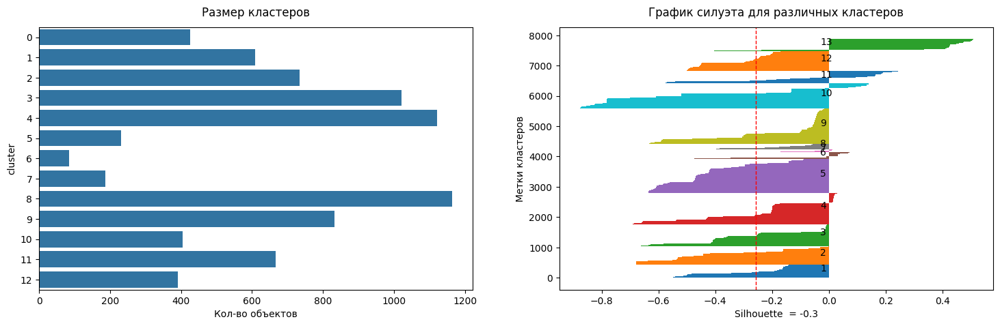

14 clusters
----------------------------------------------------------------------------------------------------


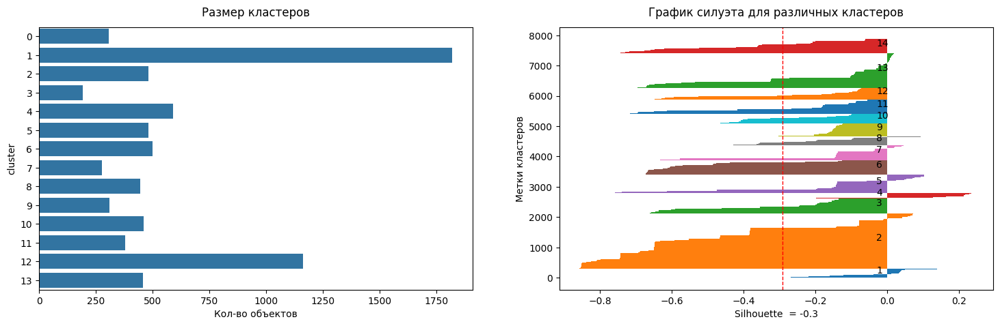

15 clusters
----------------------------------------------------------------------------------------------------


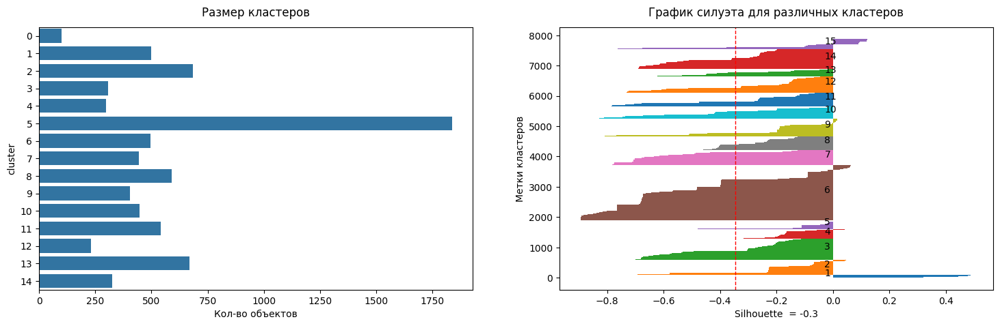

16 clusters
----------------------------------------------------------------------------------------------------


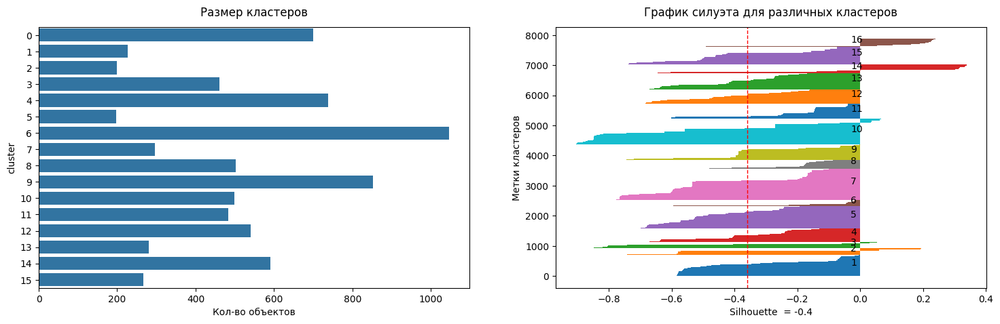

17 clusters
----------------------------------------------------------------------------------------------------


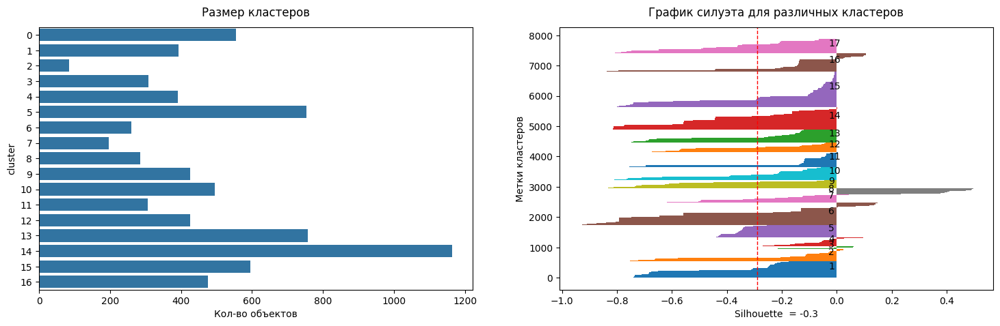

18 clusters
----------------------------------------------------------------------------------------------------


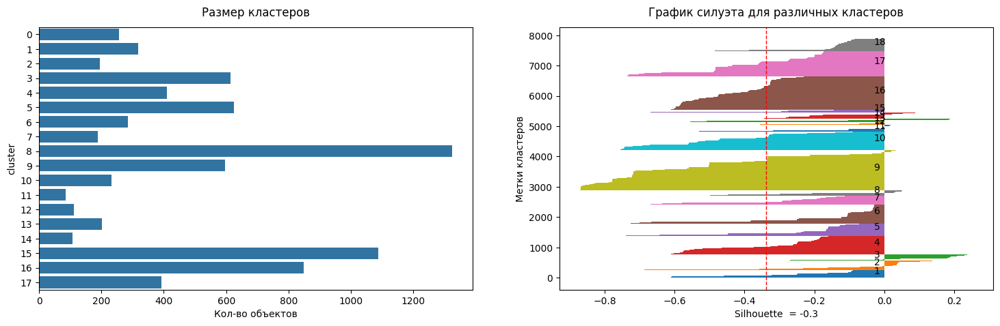

19 clusters
----------------------------------------------------------------------------------------------------


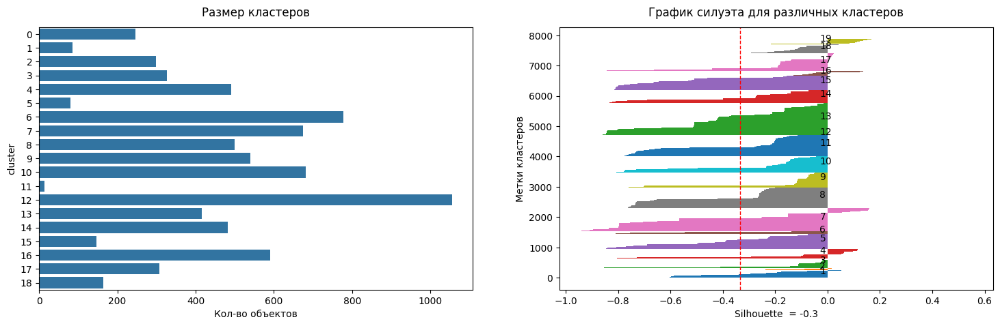

20 clusters
----------------------------------------------------------------------------------------------------


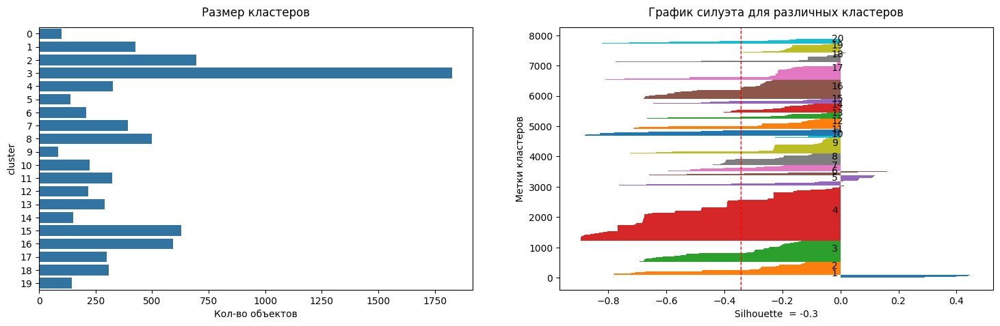

21 clusters
----------------------------------------------------------------------------------------------------


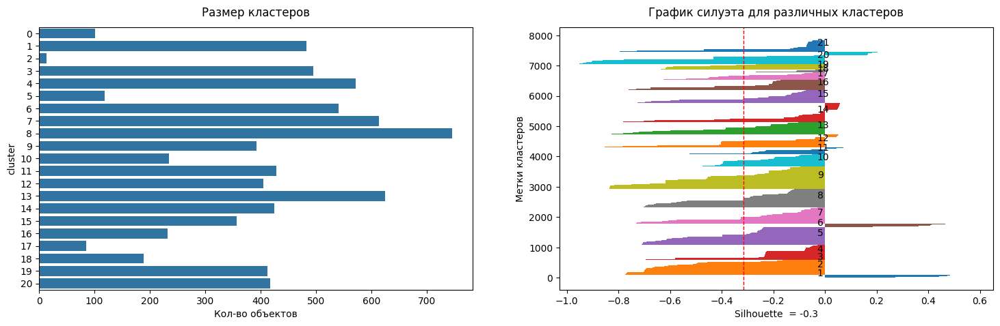

22 clusters
----------------------------------------------------------------------------------------------------


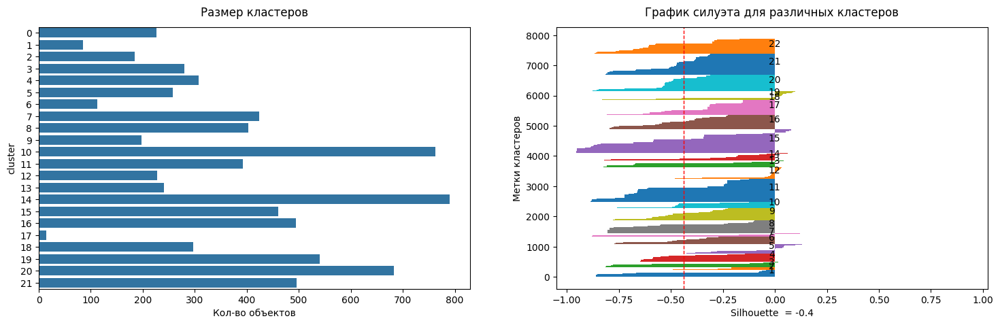

23 clusters
----------------------------------------------------------------------------------------------------


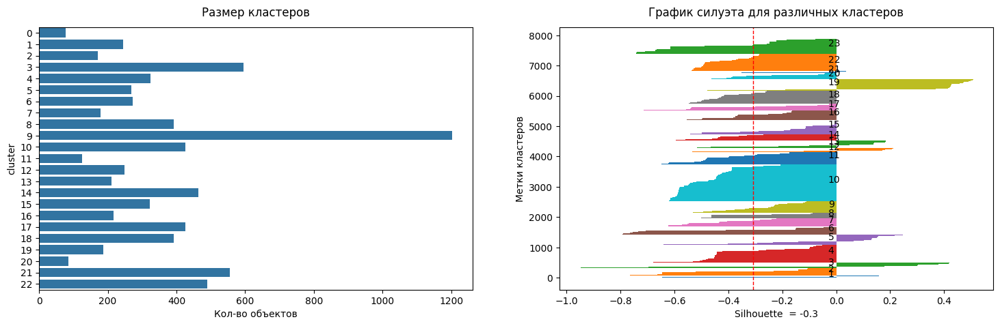

24 clusters
----------------------------------------------------------------------------------------------------


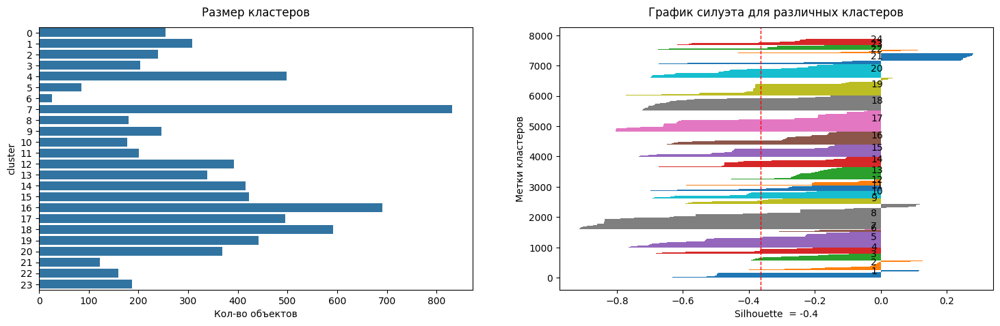

25 clusters
----------------------------------------------------------------------------------------------------


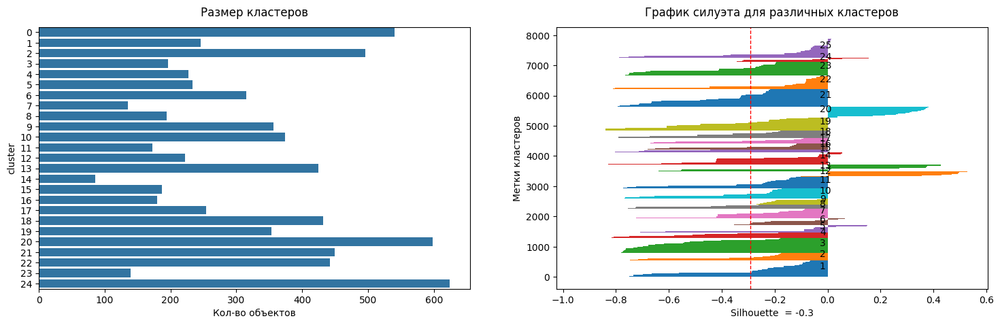

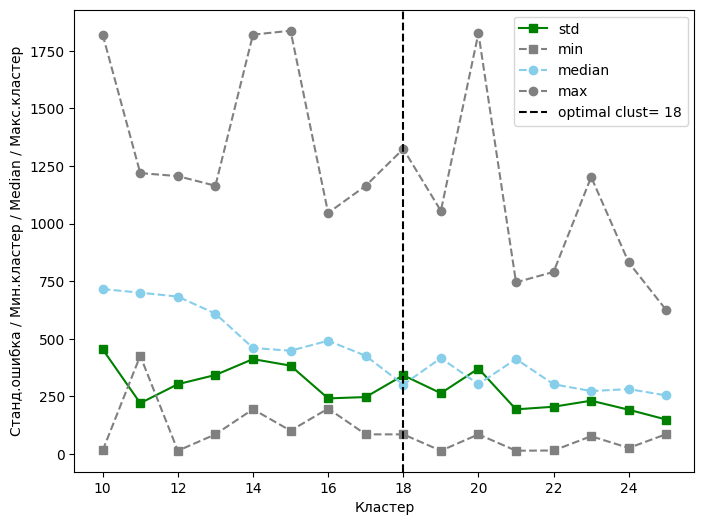

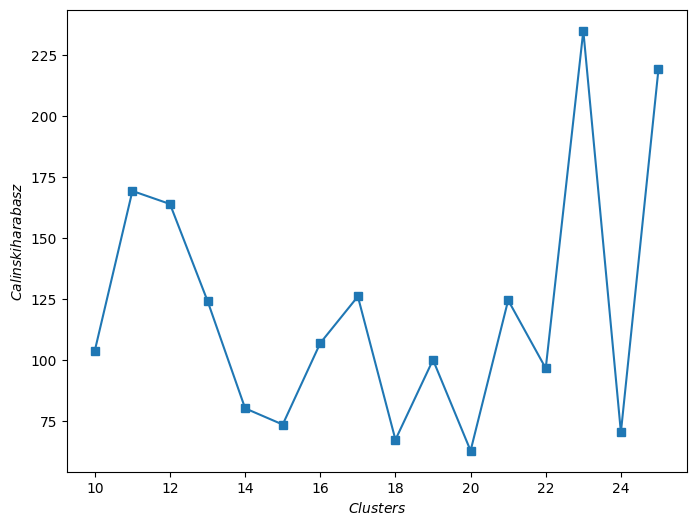

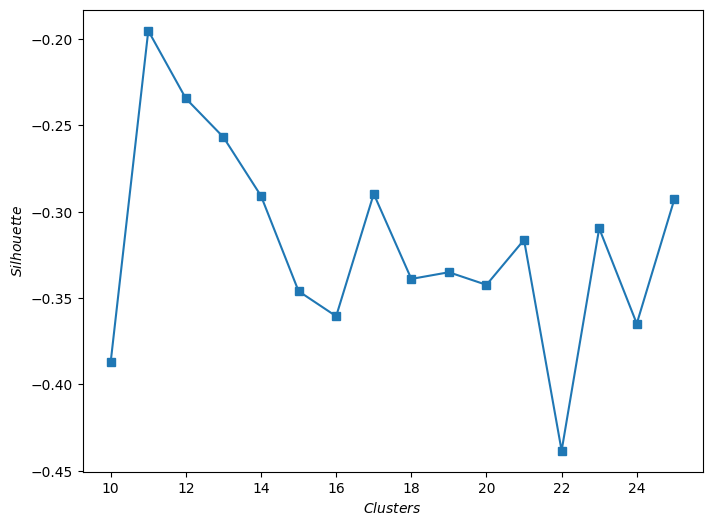

In [130]:
# подберем оптимальное количество кластеров
clust_faiss_umap_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=df_scaled_tf,
                                           embedding=X_embedding_umap_tf,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


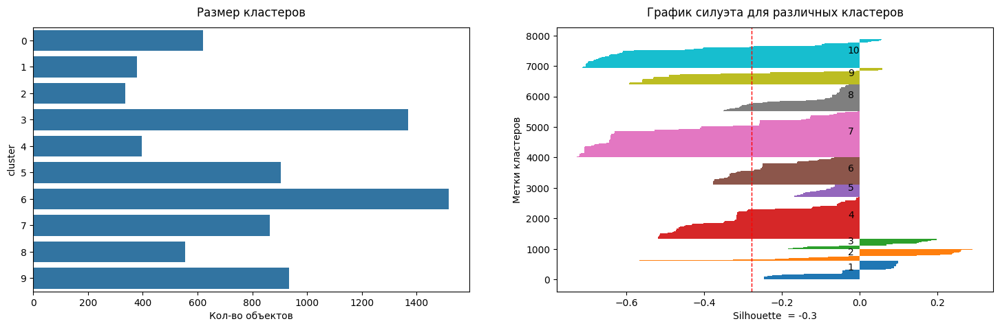

11 clusters
----------------------------------------------------------------------------------------------------


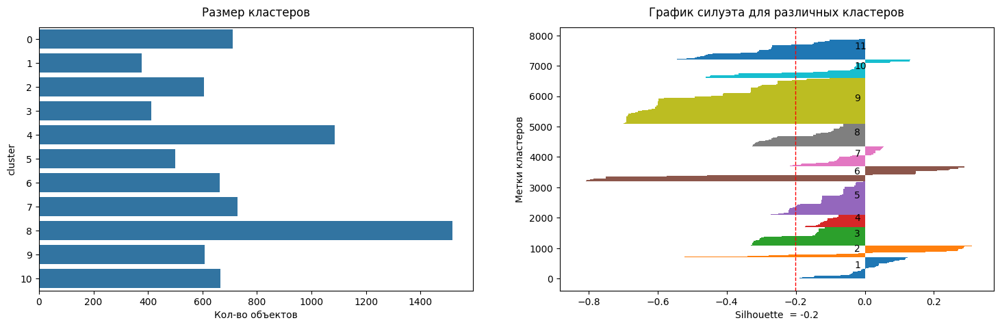

12 clusters
----------------------------------------------------------------------------------------------------


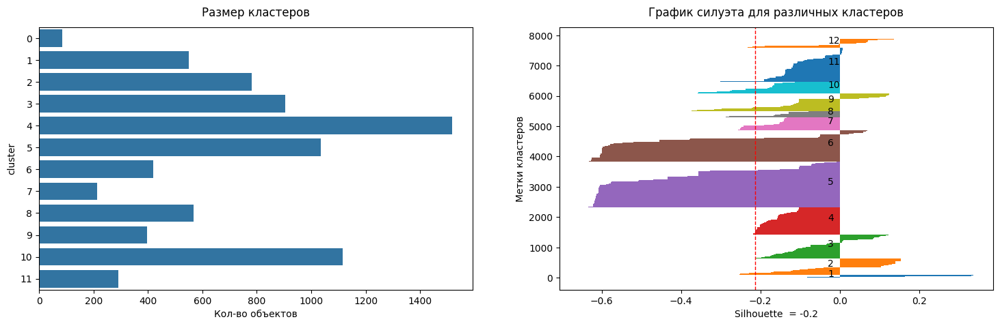

13 clusters
----------------------------------------------------------------------------------------------------


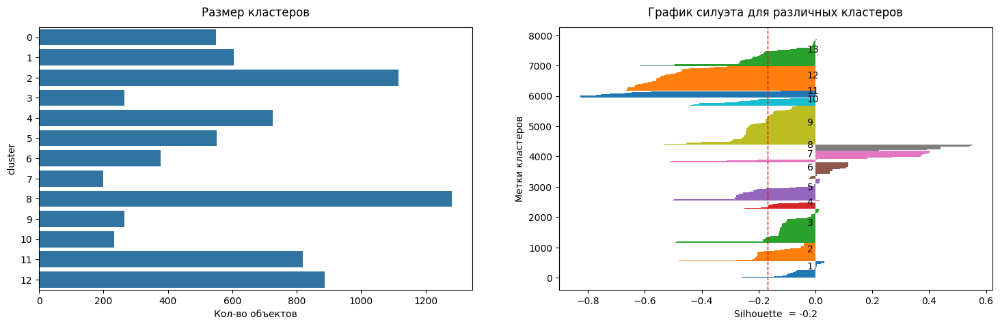

14 clusters
----------------------------------------------------------------------------------------------------


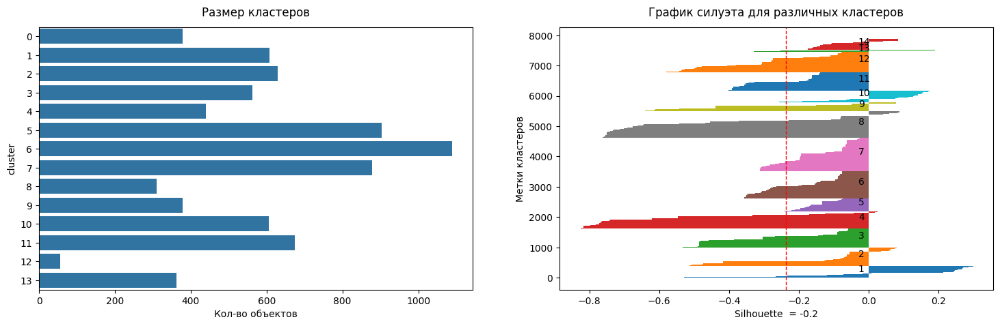

15 clusters
----------------------------------------------------------------------------------------------------


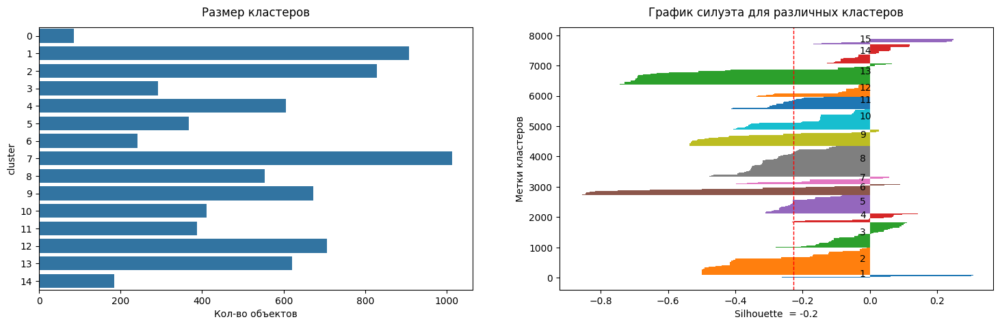

16 clusters
----------------------------------------------------------------------------------------------------


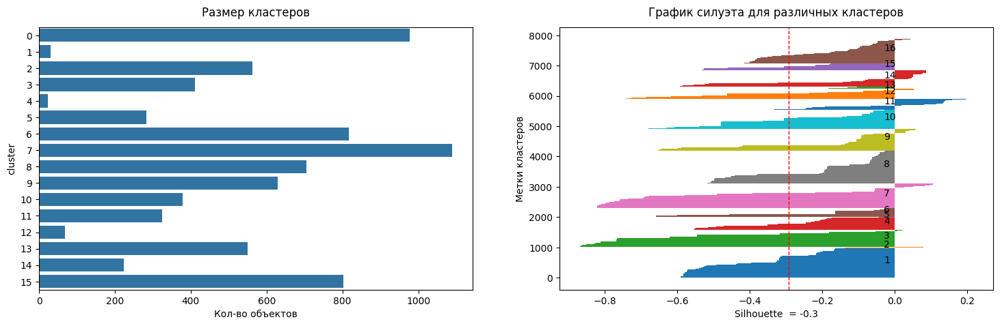

17 clusters
----------------------------------------------------------------------------------------------------


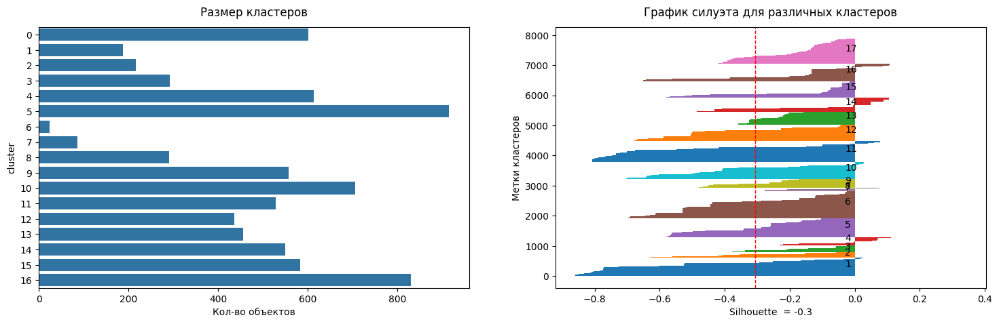

18 clusters
----------------------------------------------------------------------------------------------------


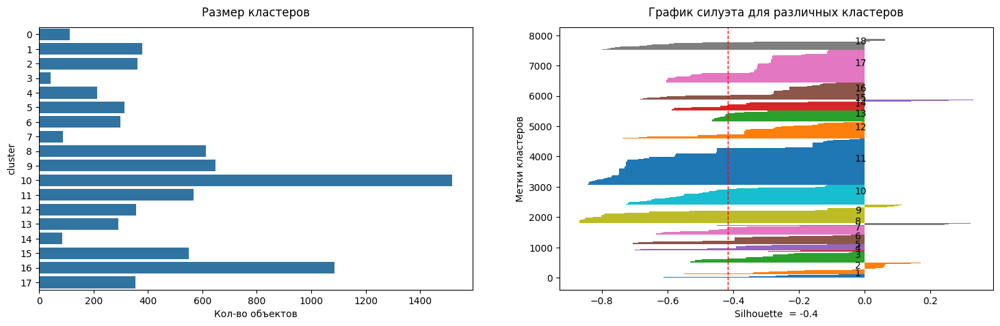

19 clusters
----------------------------------------------------------------------------------------------------


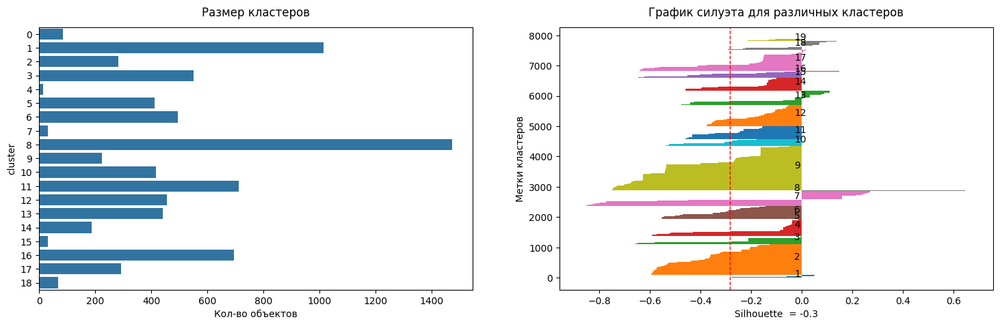

20 clusters
----------------------------------------------------------------------------------------------------


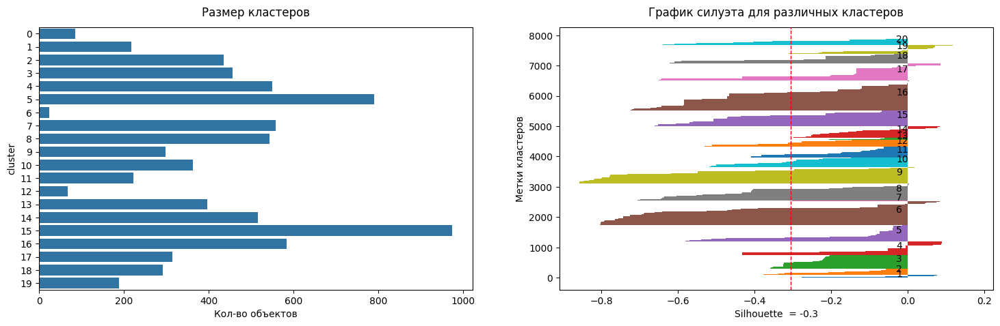

21 clusters
----------------------------------------------------------------------------------------------------


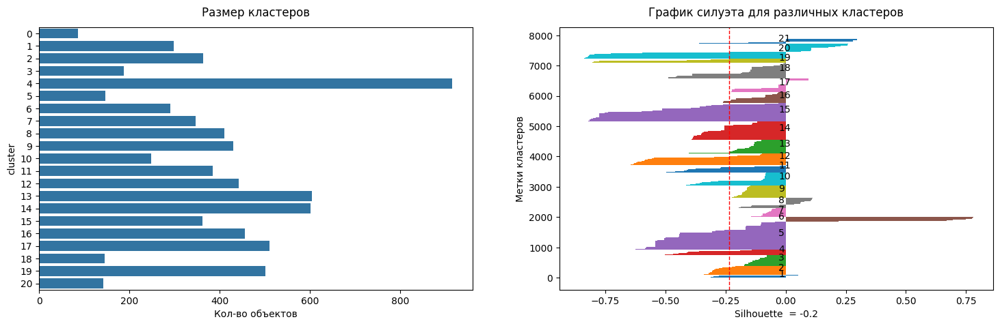

22 clusters
----------------------------------------------------------------------------------------------------


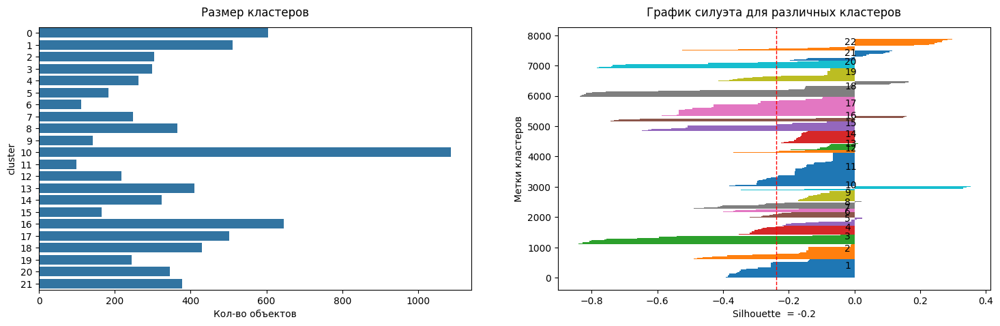

23 clusters
----------------------------------------------------------------------------------------------------


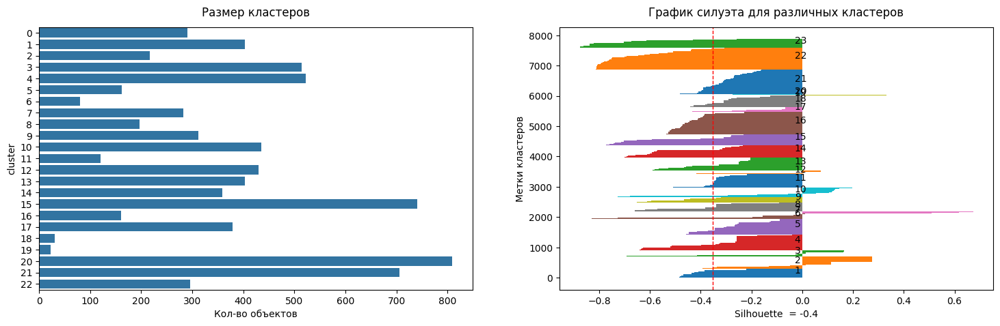

24 clusters
----------------------------------------------------------------------------------------------------


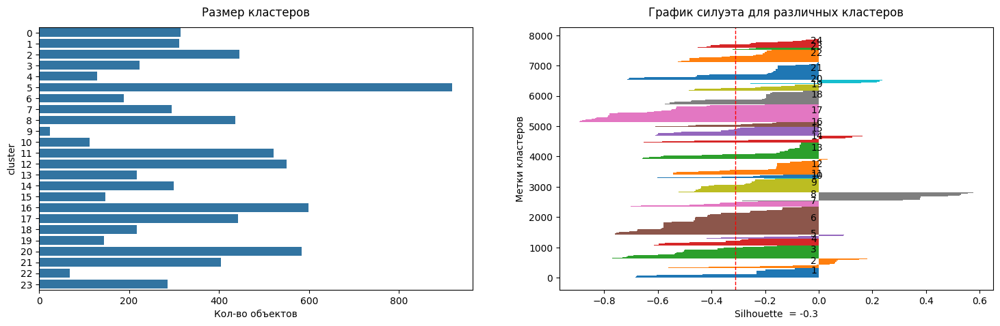

25 clusters
----------------------------------------------------------------------------------------------------


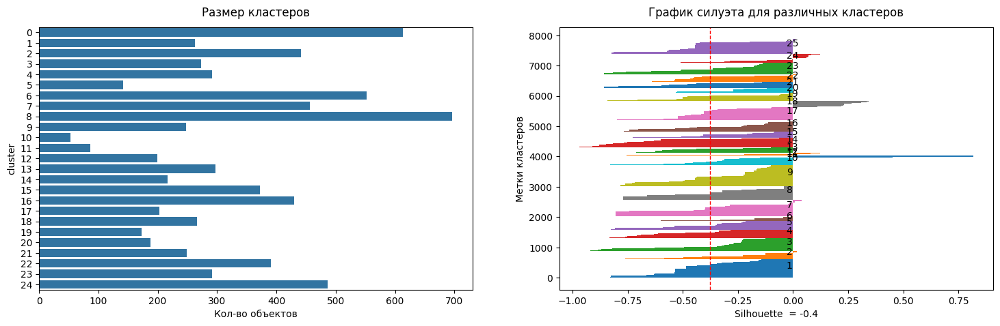

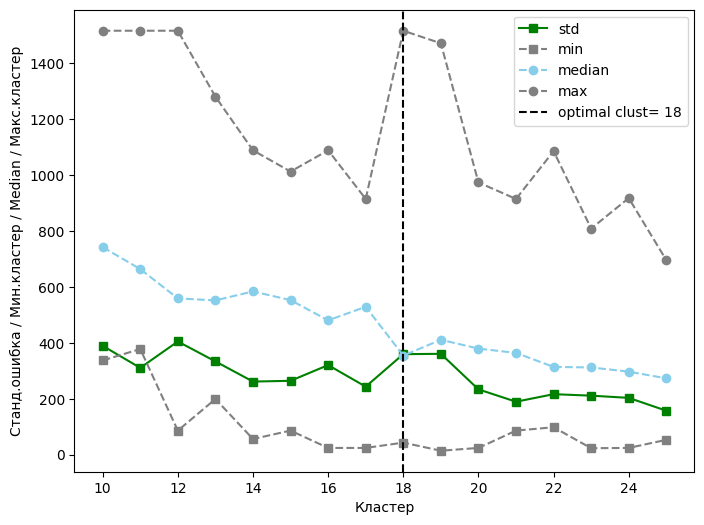

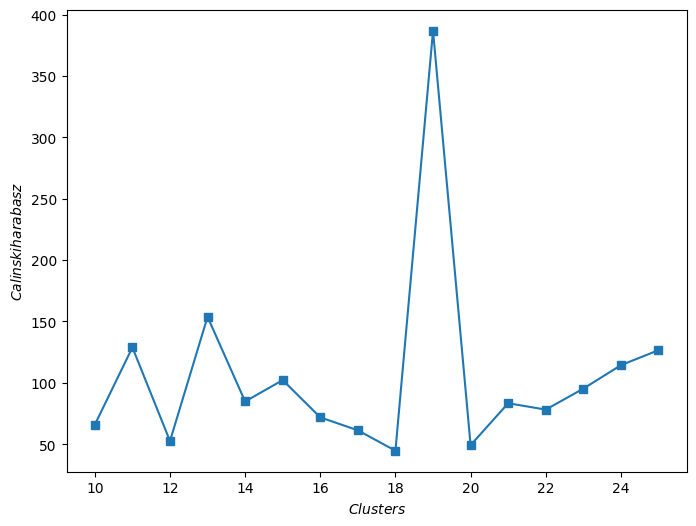

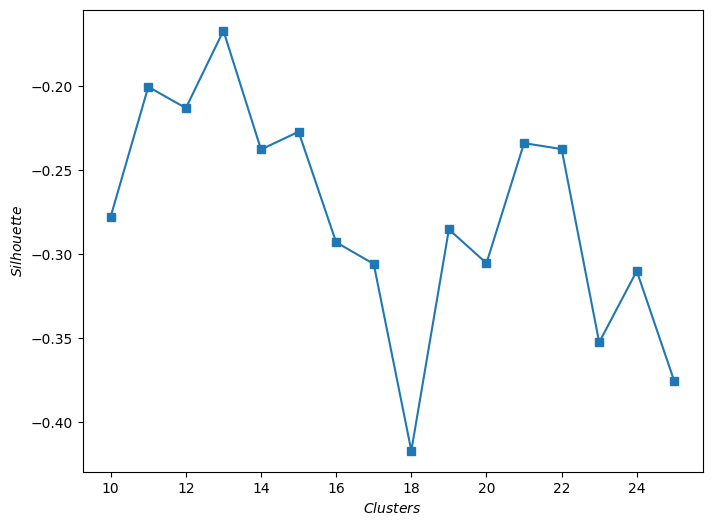

In [131]:
# подберем оптимальное количество кластеров
clust_faiss_umap_bert = clustering_analysis(data=df_bert,
                                           data_scale=df_scaled_bert,
                                           embedding=X_embedding_umap_bert,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

#### Без числовых данных

10 clusters
----------------------------------------------------------------------------------------------------


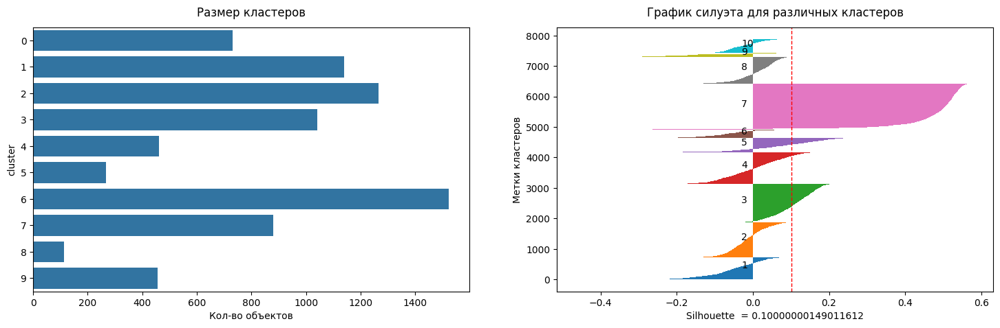

11 clusters
----------------------------------------------------------------------------------------------------


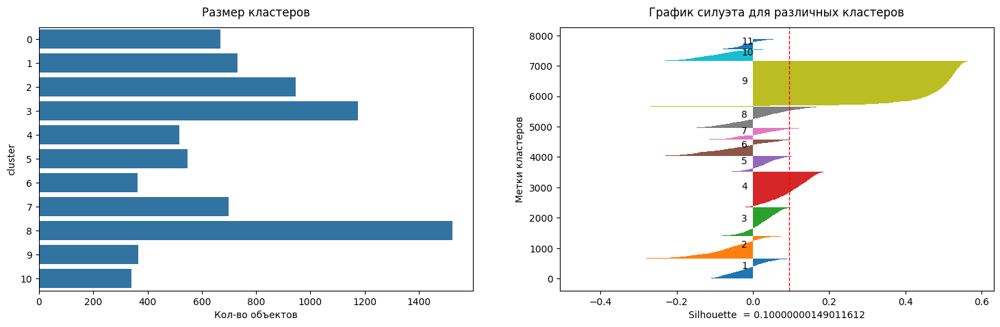

12 clusters
----------------------------------------------------------------------------------------------------


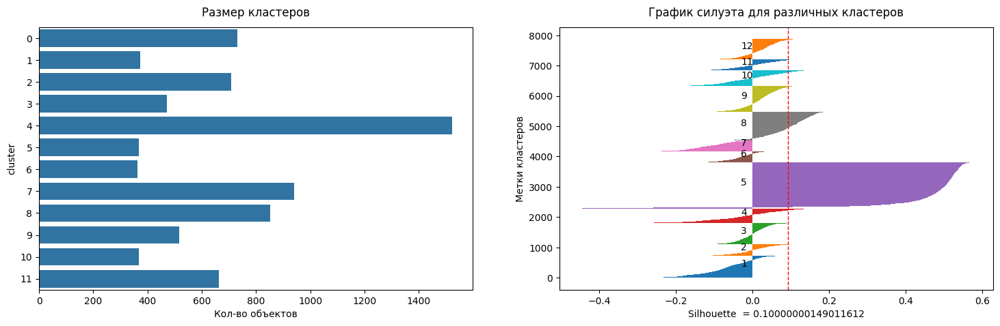

13 clusters
----------------------------------------------------------------------------------------------------


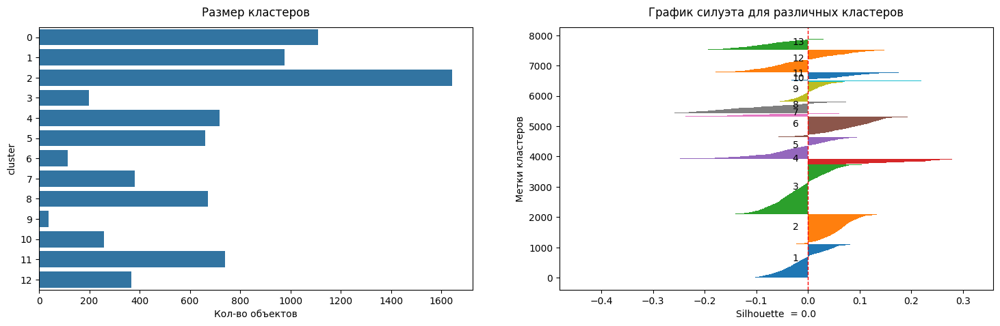

14 clusters
----------------------------------------------------------------------------------------------------


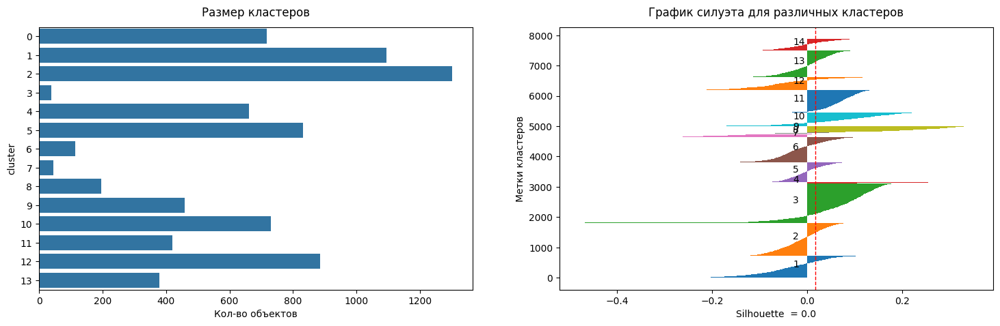

15 clusters
----------------------------------------------------------------------------------------------------


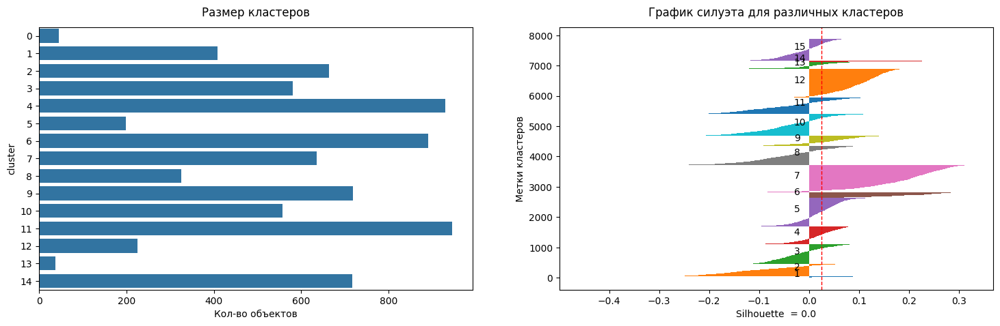

16 clusters
----------------------------------------------------------------------------------------------------


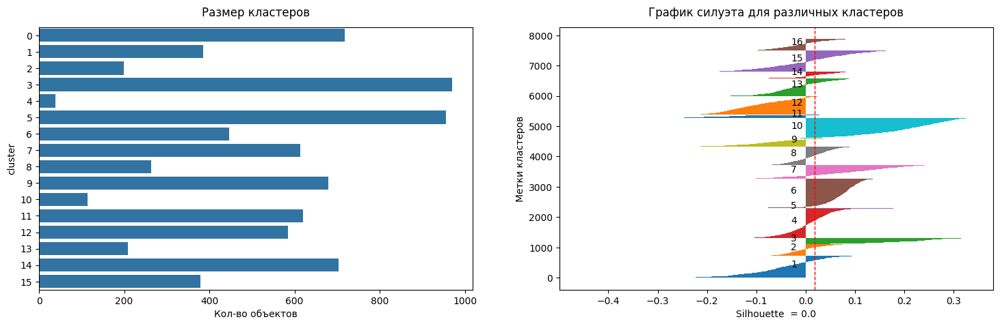

17 clusters
----------------------------------------------------------------------------------------------------


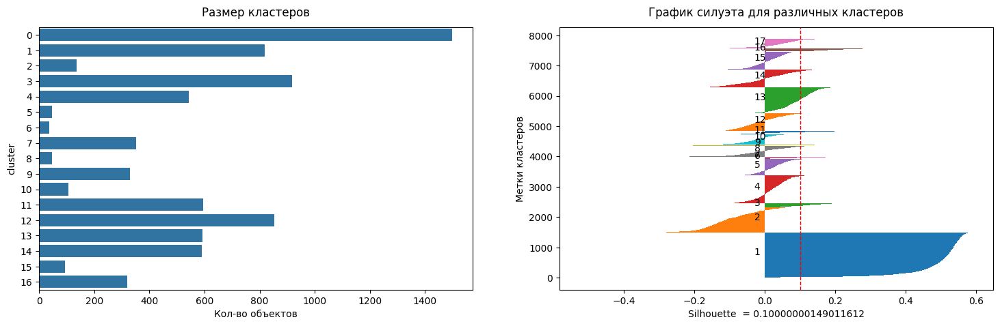

18 clusters
----------------------------------------------------------------------------------------------------


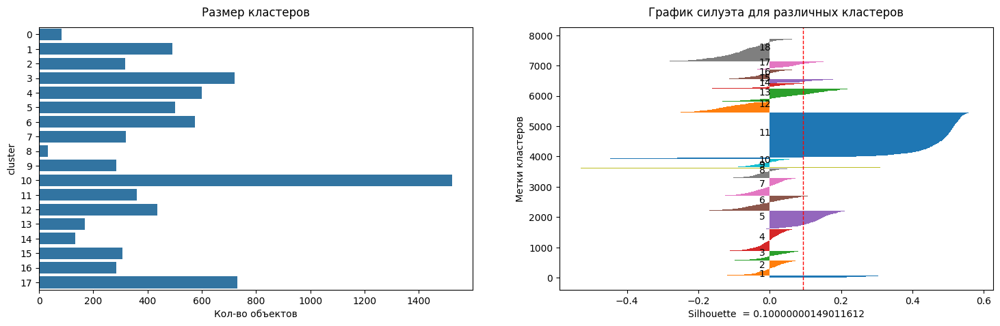

19 clusters
----------------------------------------------------------------------------------------------------


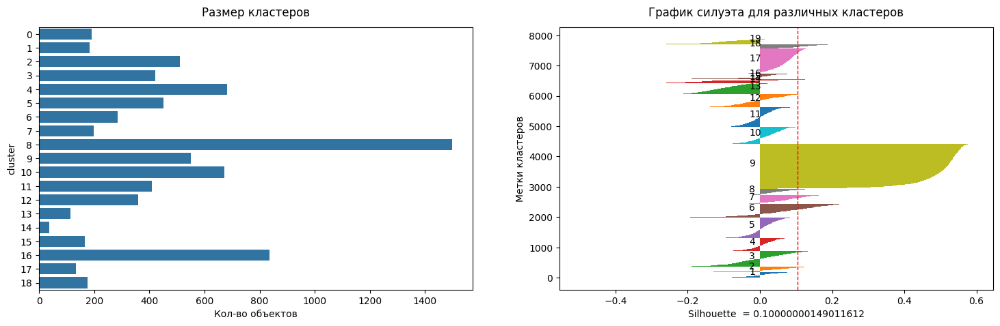

20 clusters
----------------------------------------------------------------------------------------------------


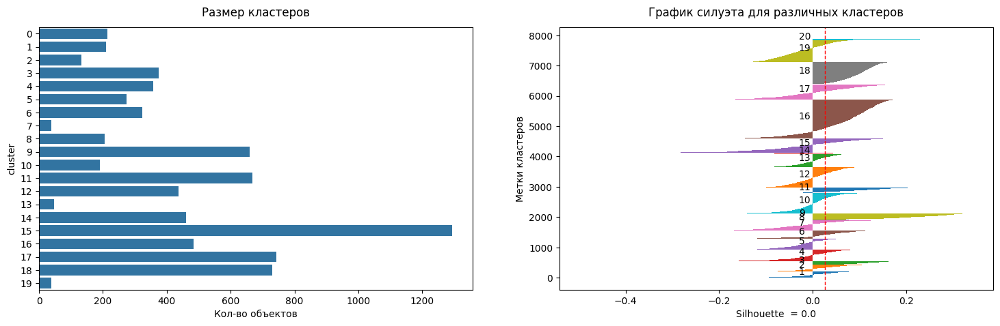

21 clusters
----------------------------------------------------------------------------------------------------


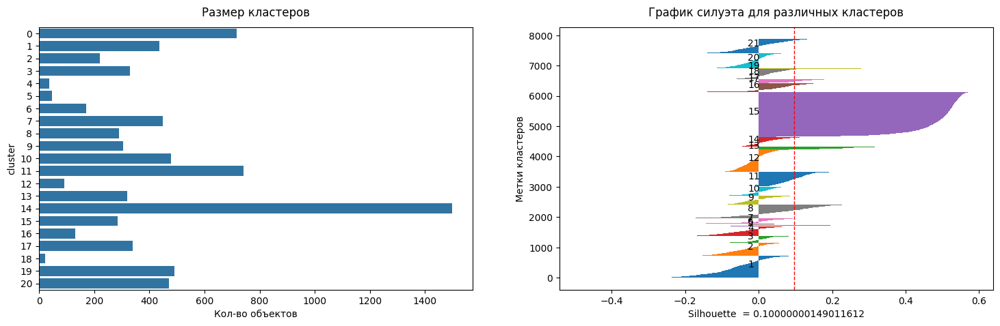

22 clusters
----------------------------------------------------------------------------------------------------


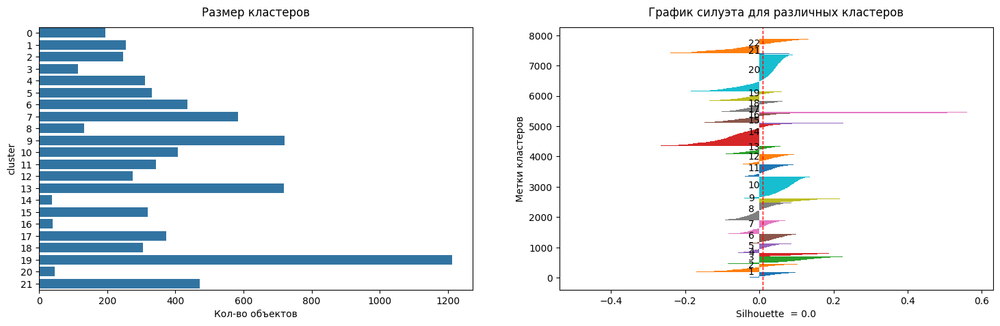

23 clusters
----------------------------------------------------------------------------------------------------


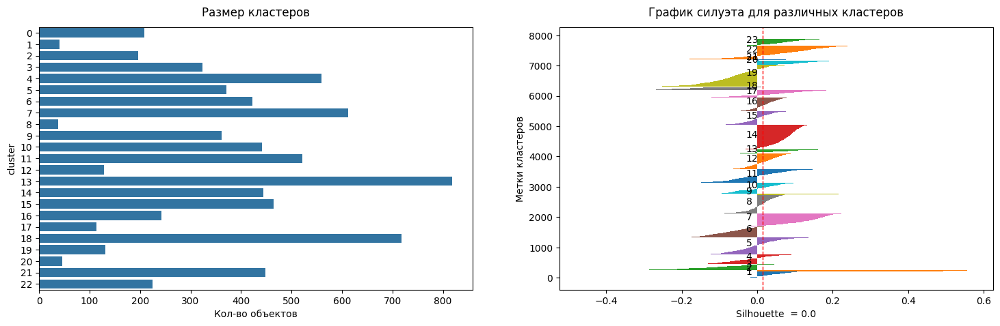

24 clusters
----------------------------------------------------------------------------------------------------


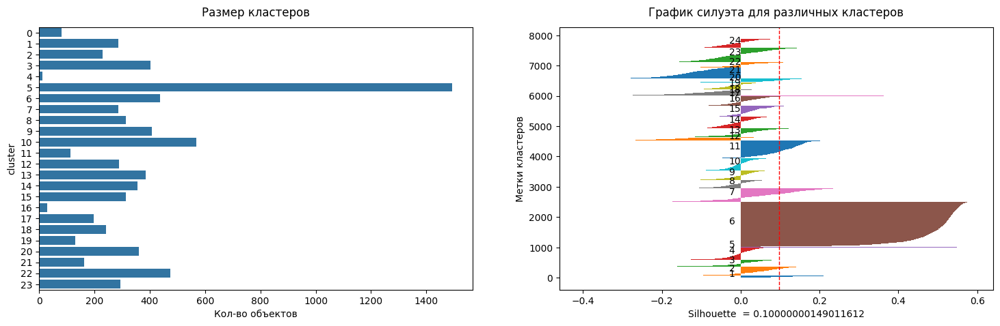

25 clusters
----------------------------------------------------------------------------------------------------


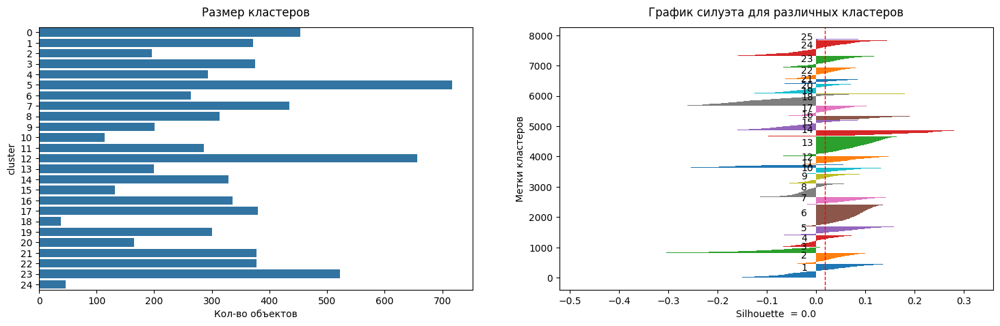

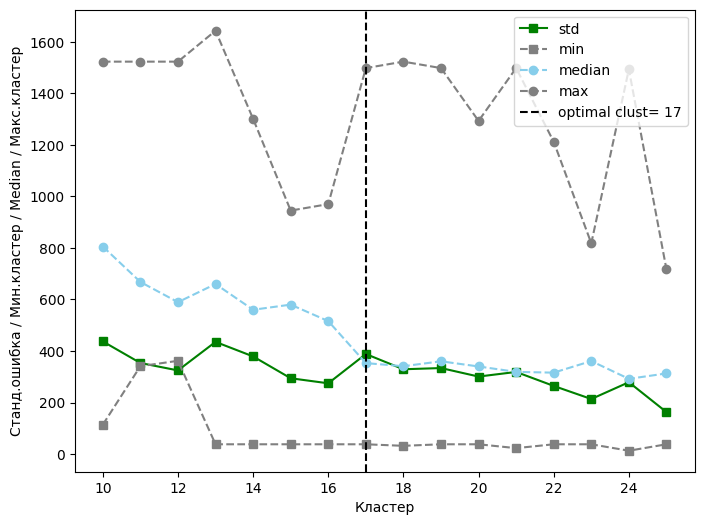

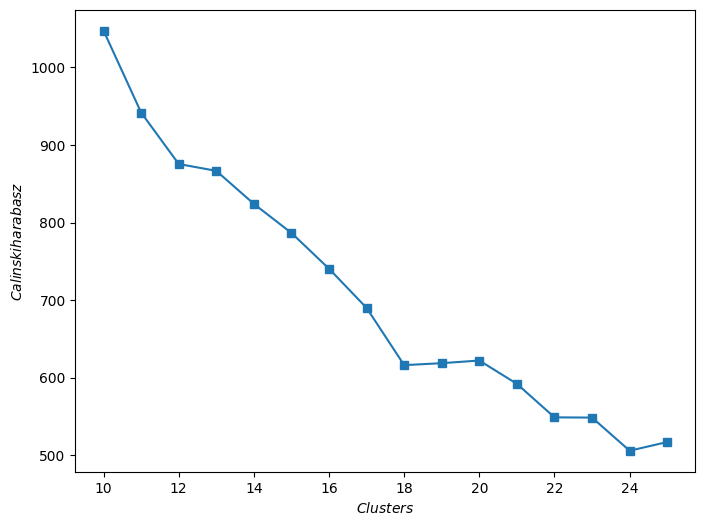

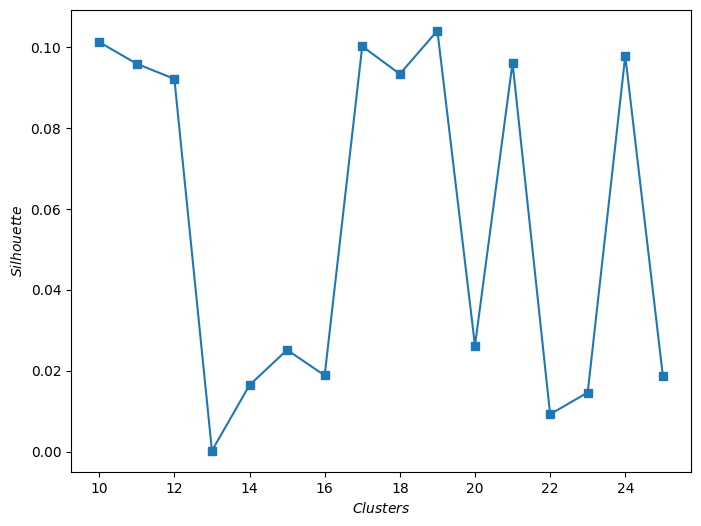

In [132]:
# подберем оптимальное количество кластеров
clust_faiss_umap_bert_text = clustering_analysis(data=df_bert_text,
                                           data_scale=df_bert_text,
                                           embedding=X_embedding_umap_bert_text,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

**Выводы:**

- алгоритм UMAP+Faiss на всех данных не может выделить кластеры;
- при использовании bert без числовых данных алгоритм ведет себя лучше всего, но делает большие ошибки на кластерах

## PCA + Faiss

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


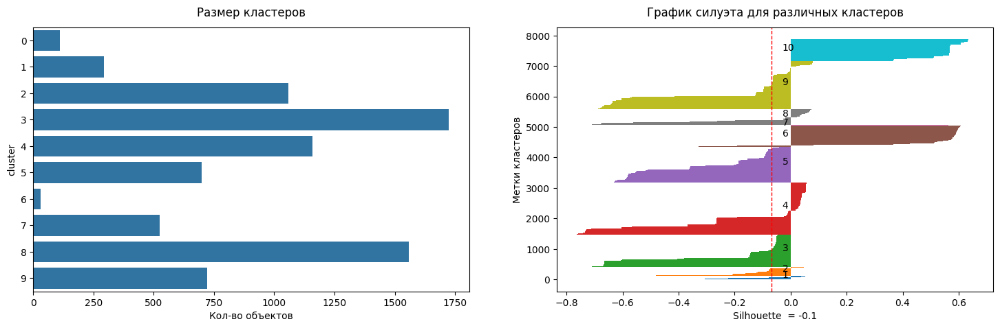

11 clusters
----------------------------------------------------------------------------------------------------


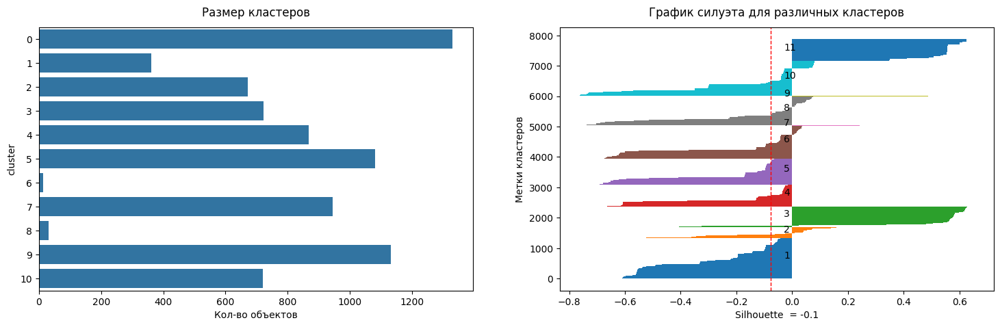

12 clusters
----------------------------------------------------------------------------------------------------


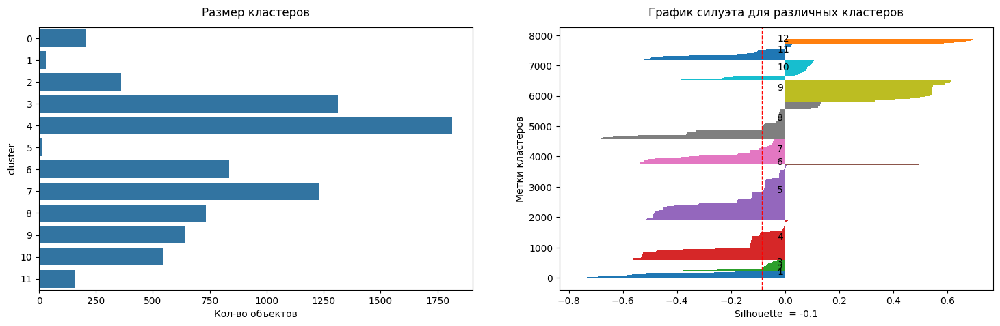

13 clusters
----------------------------------------------------------------------------------------------------


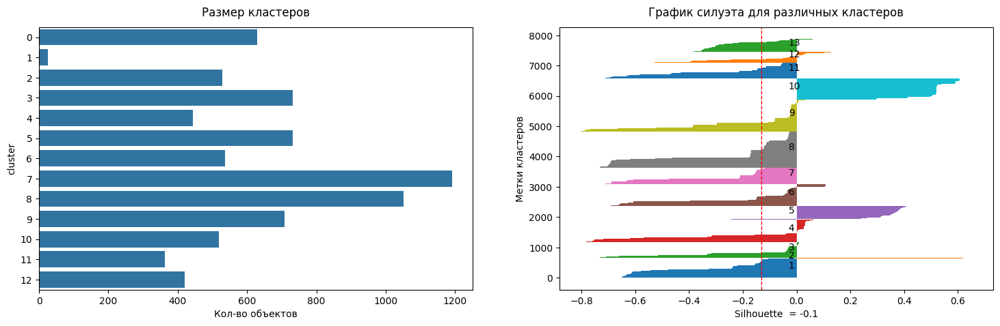

14 clusters
----------------------------------------------------------------------------------------------------


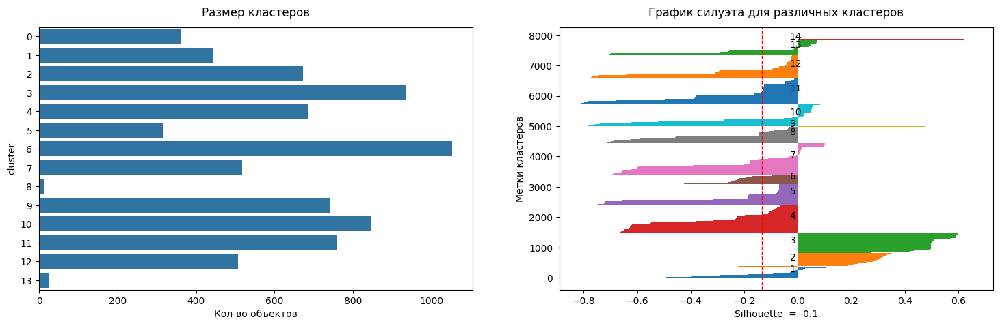

15 clusters
----------------------------------------------------------------------------------------------------


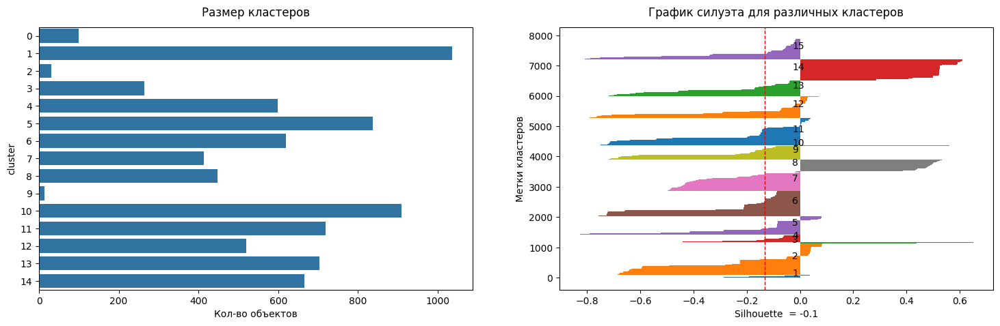

16 clusters
----------------------------------------------------------------------------------------------------


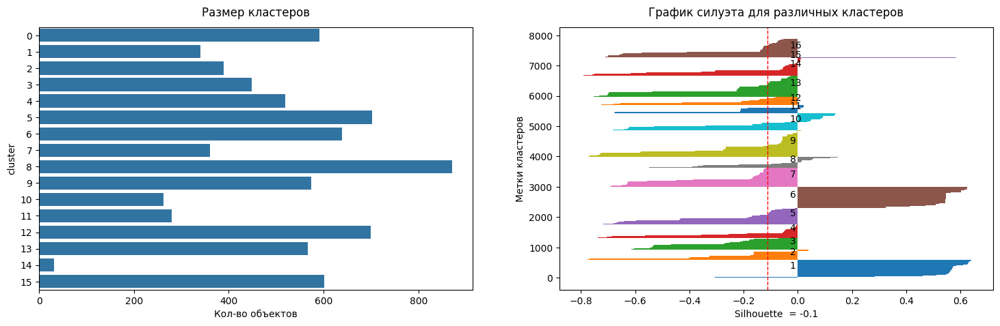

17 clusters
----------------------------------------------------------------------------------------------------


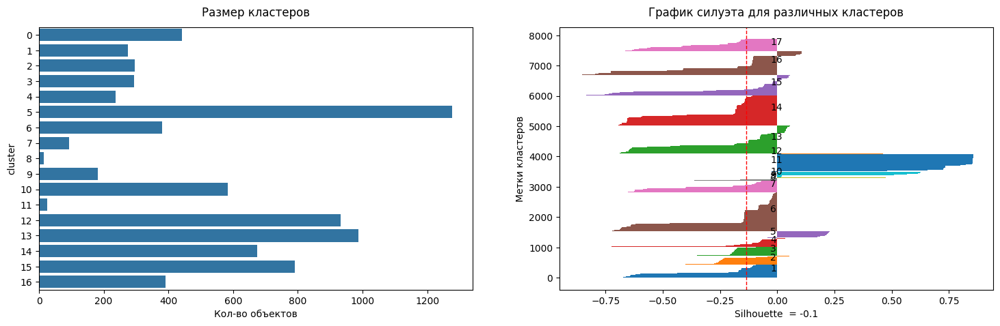

18 clusters
----------------------------------------------------------------------------------------------------


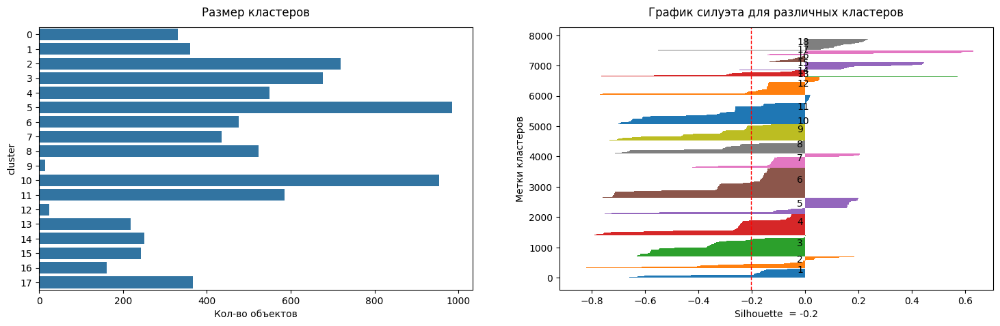

19 clusters
----------------------------------------------------------------------------------------------------


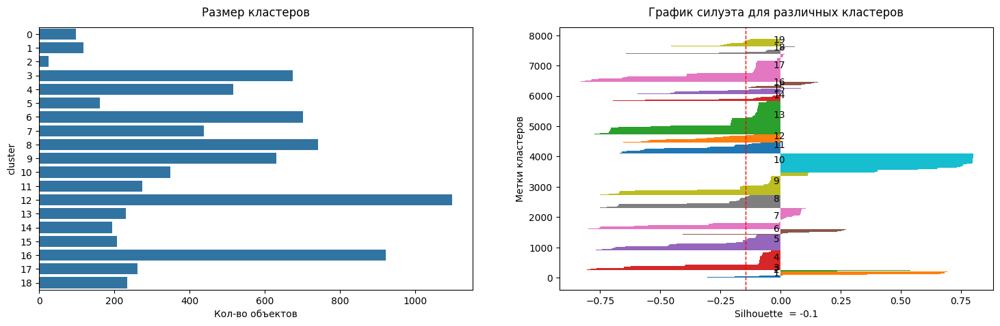

20 clusters
----------------------------------------------------------------------------------------------------


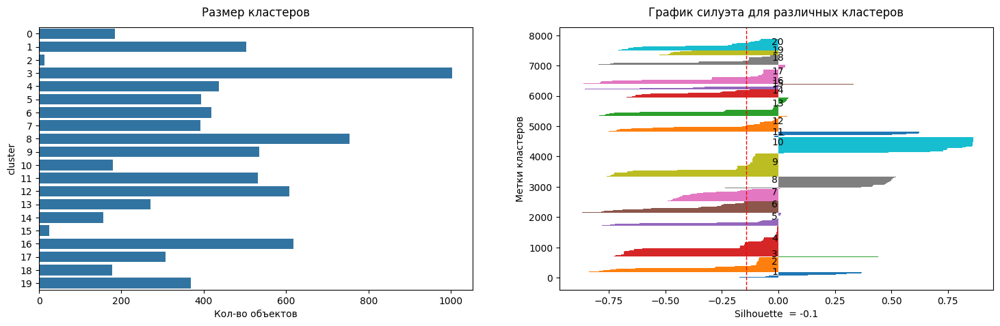

21 clusters
----------------------------------------------------------------------------------------------------


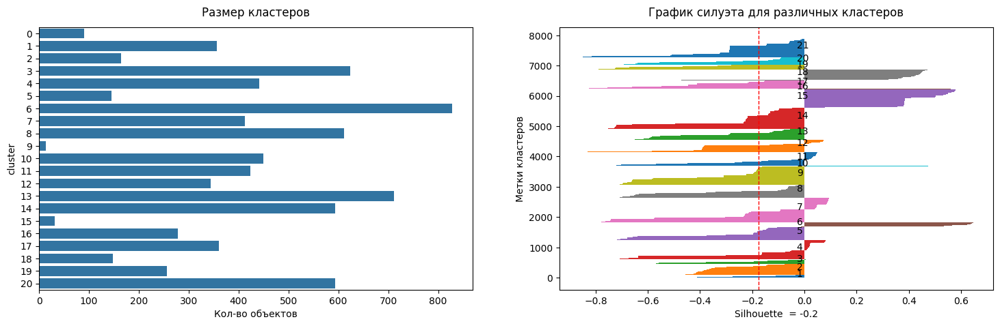

22 clusters
----------------------------------------------------------------------------------------------------


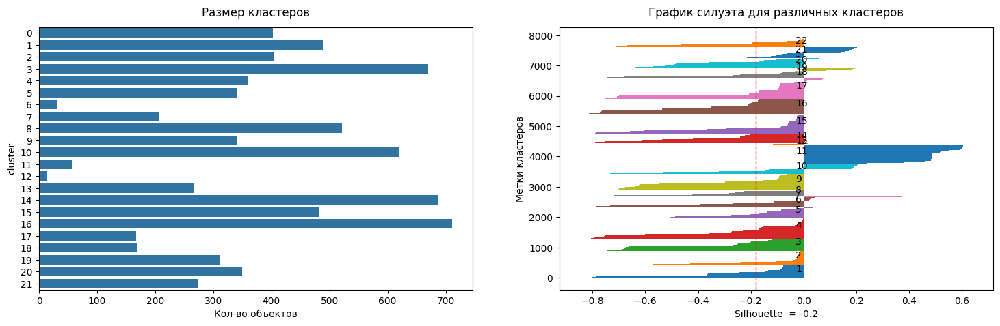

23 clusters
----------------------------------------------------------------------------------------------------


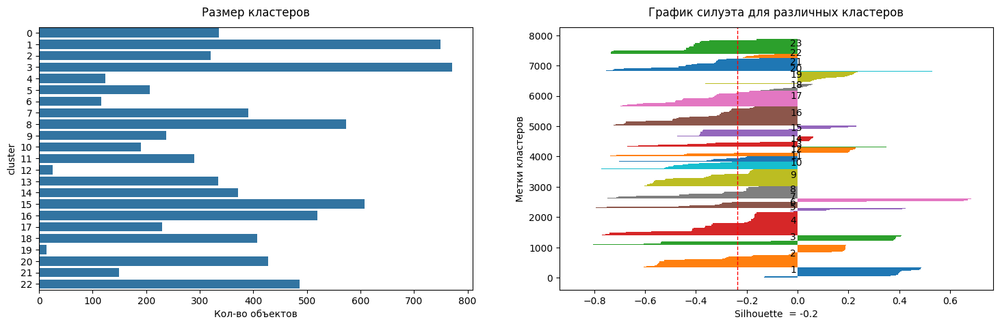

24 clusters
----------------------------------------------------------------------------------------------------


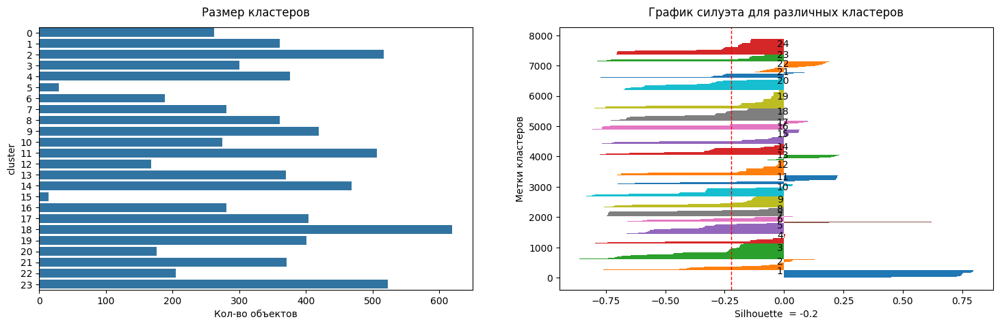

25 clusters
----------------------------------------------------------------------------------------------------


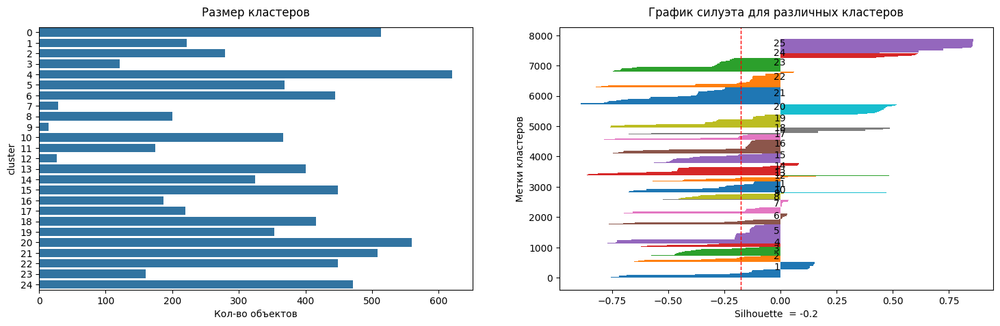

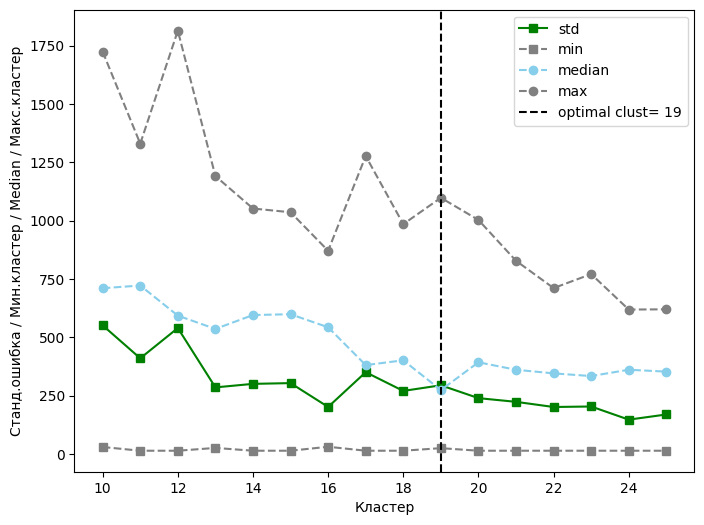

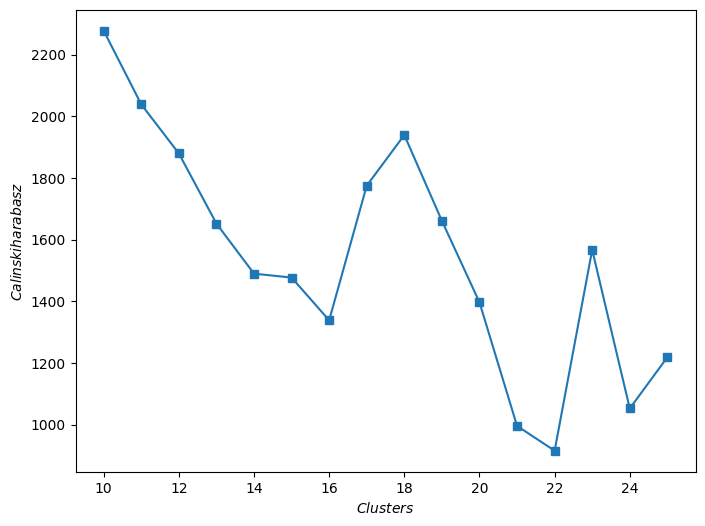

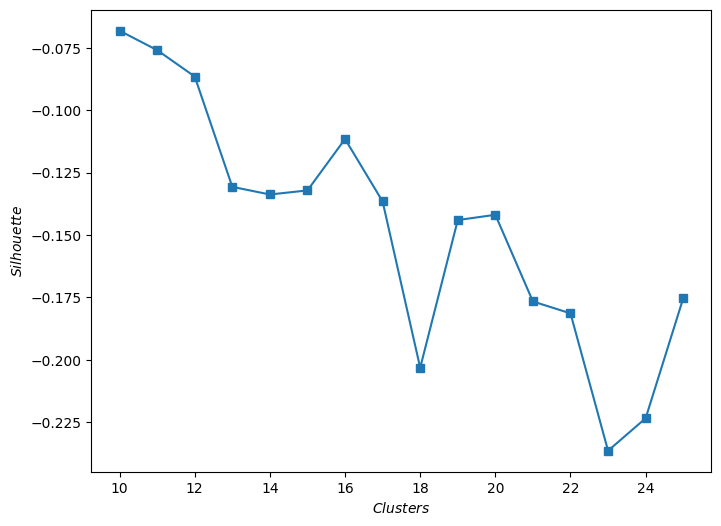

In [133]:
# подберем оптимальное количество кластеров
clust_faiss_pca_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=df_scaled_tf,
                                           embedding=X_embedding_pca_tf,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


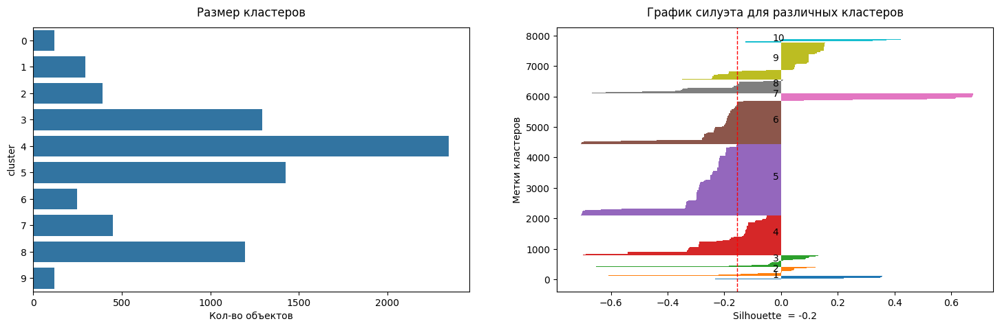

11 clusters
----------------------------------------------------------------------------------------------------


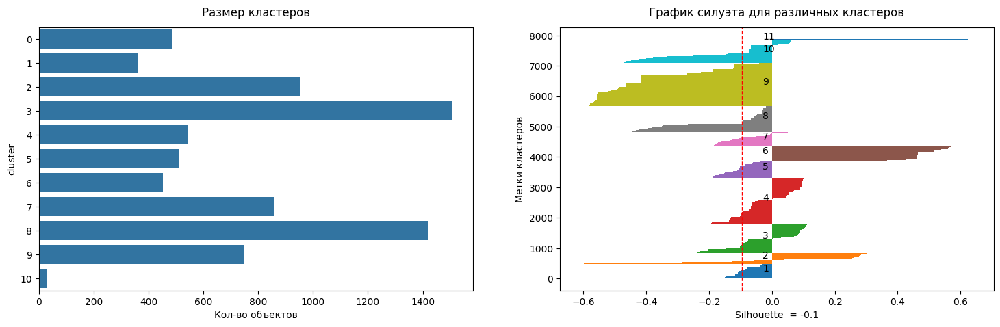

12 clusters
----------------------------------------------------------------------------------------------------


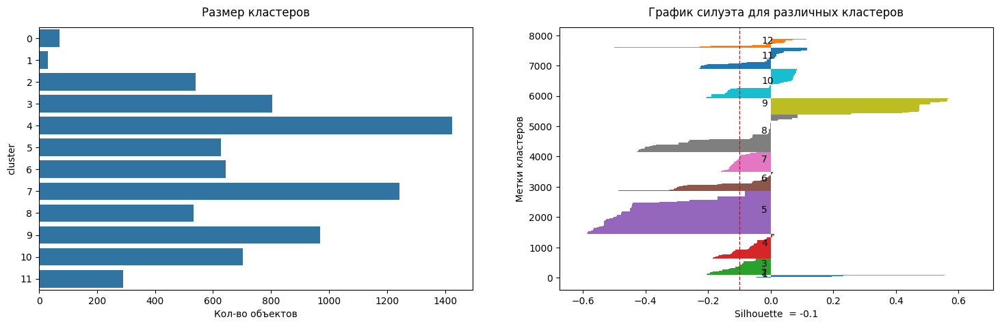

13 clusters
----------------------------------------------------------------------------------------------------


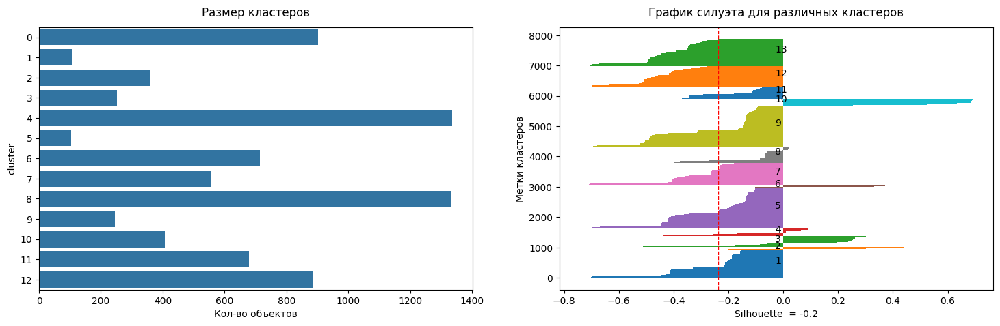

14 clusters
----------------------------------------------------------------------------------------------------


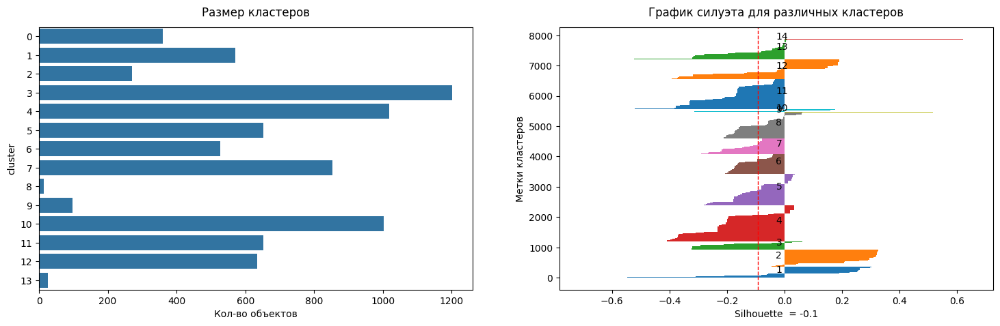

15 clusters
----------------------------------------------------------------------------------------------------


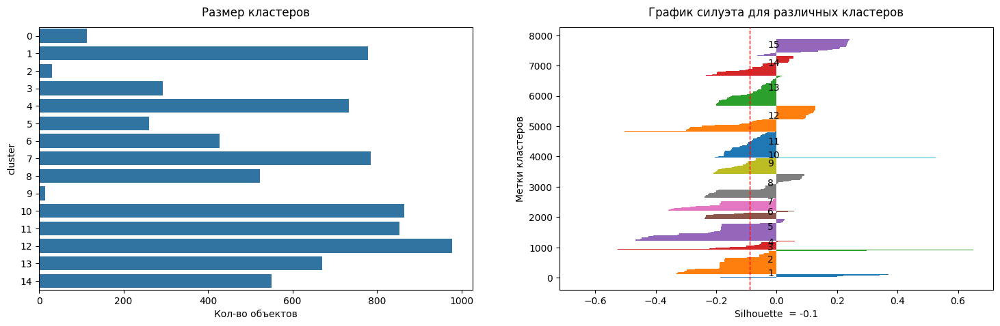

16 clusters
----------------------------------------------------------------------------------------------------


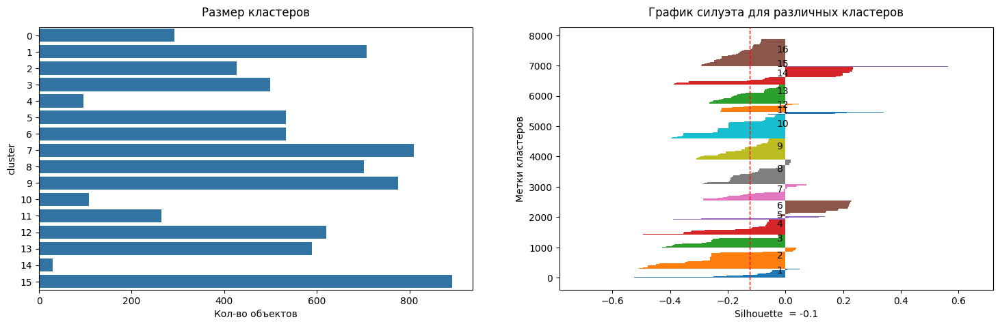

17 clusters
----------------------------------------------------------------------------------------------------


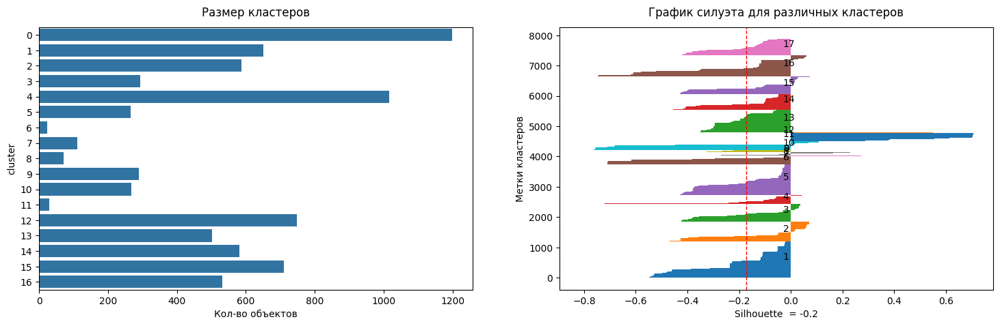

18 clusters
----------------------------------------------------------------------------------------------------


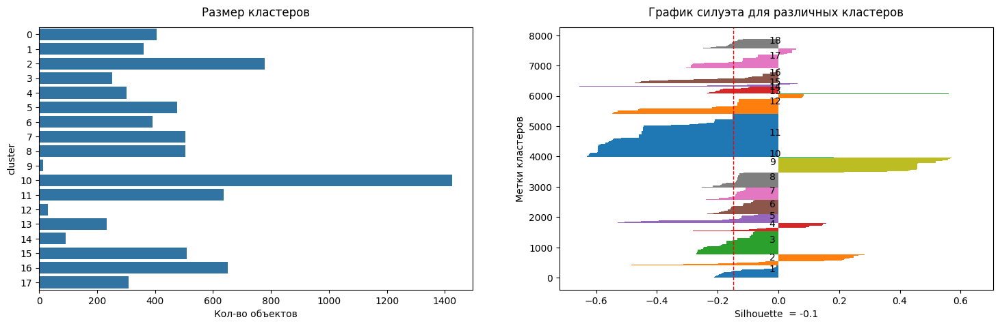

19 clusters
----------------------------------------------------------------------------------------------------


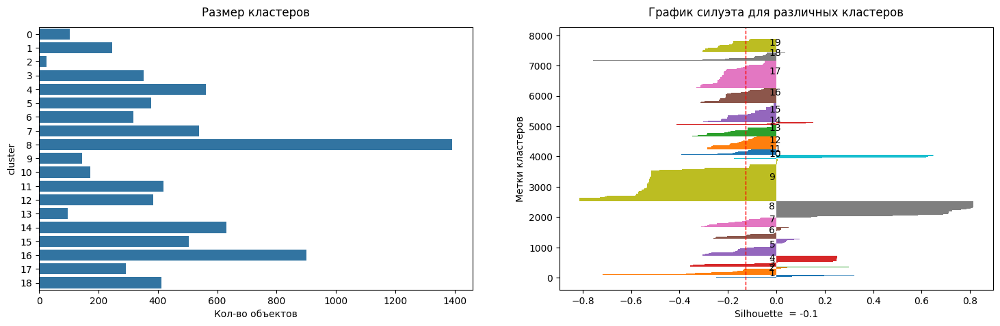

20 clusters
----------------------------------------------------------------------------------------------------


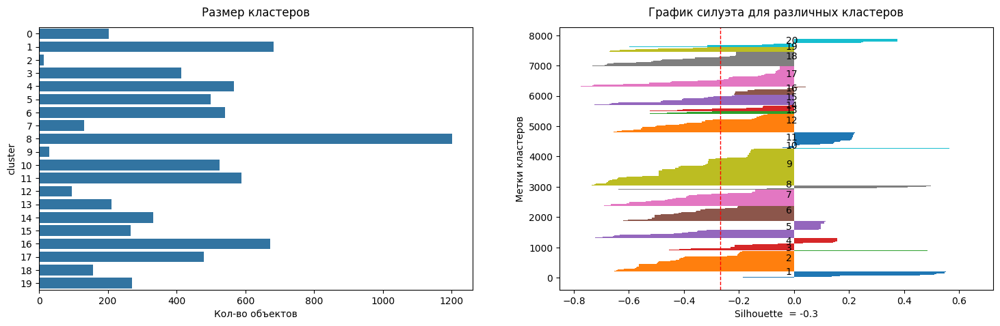

21 clusters
----------------------------------------------------------------------------------------------------


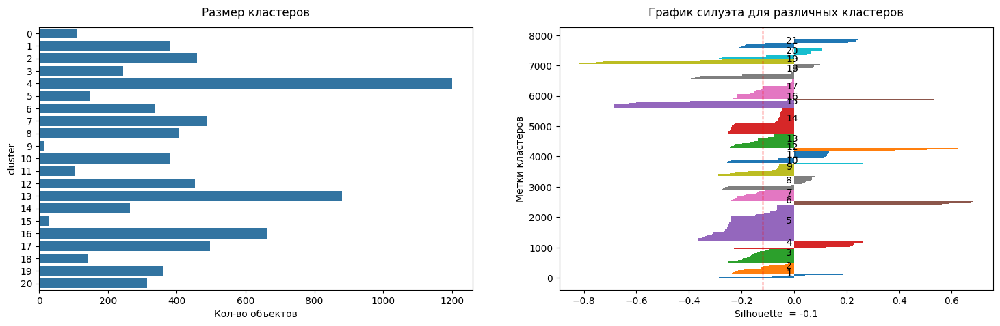

22 clusters
----------------------------------------------------------------------------------------------------


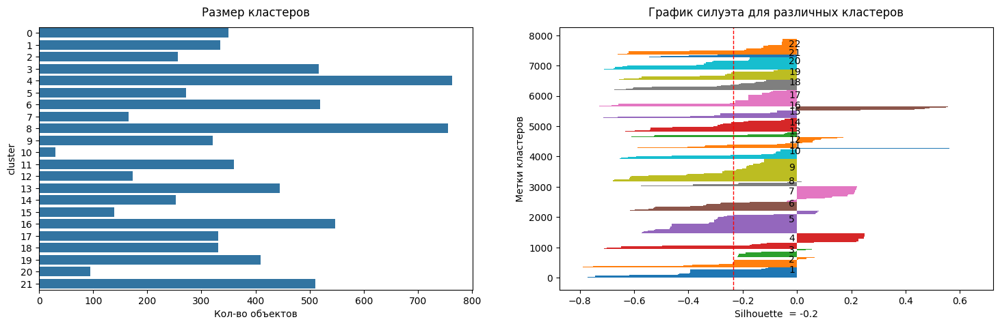

23 clusters
----------------------------------------------------------------------------------------------------


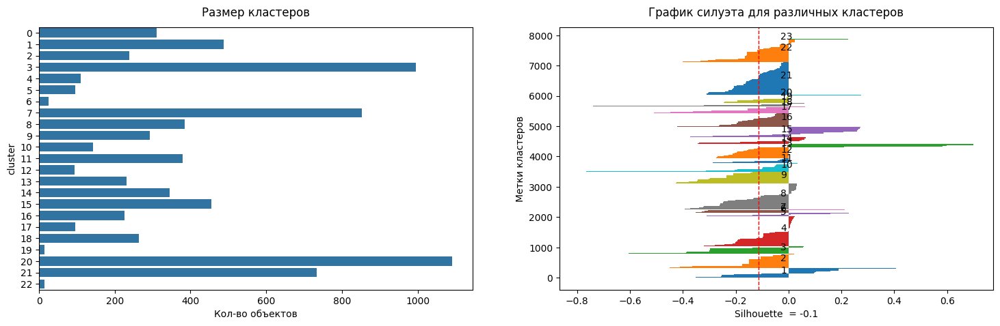

24 clusters
----------------------------------------------------------------------------------------------------


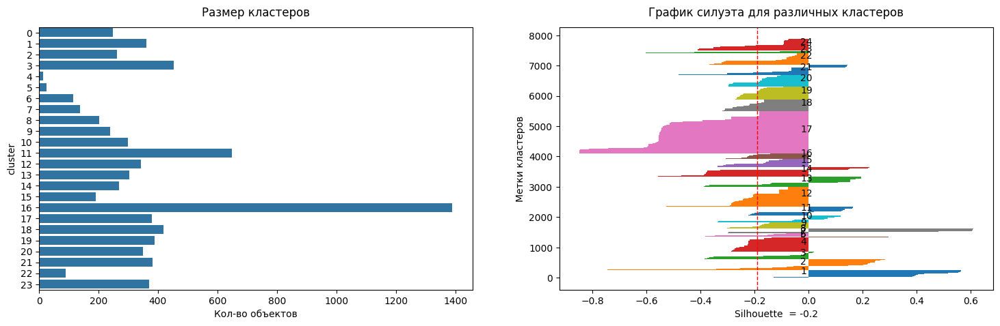

25 clusters
----------------------------------------------------------------------------------------------------


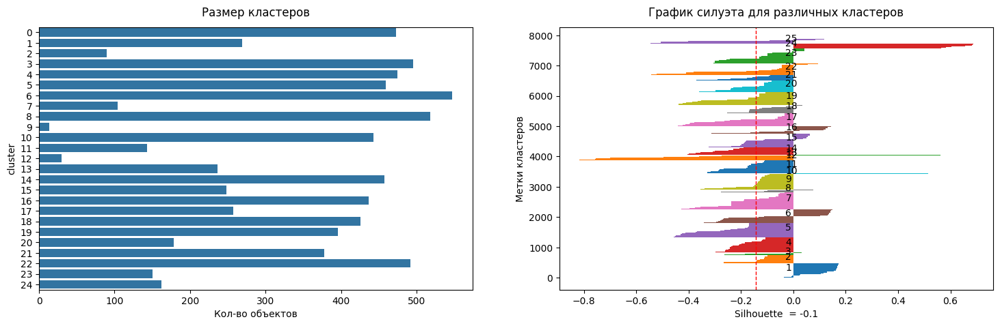

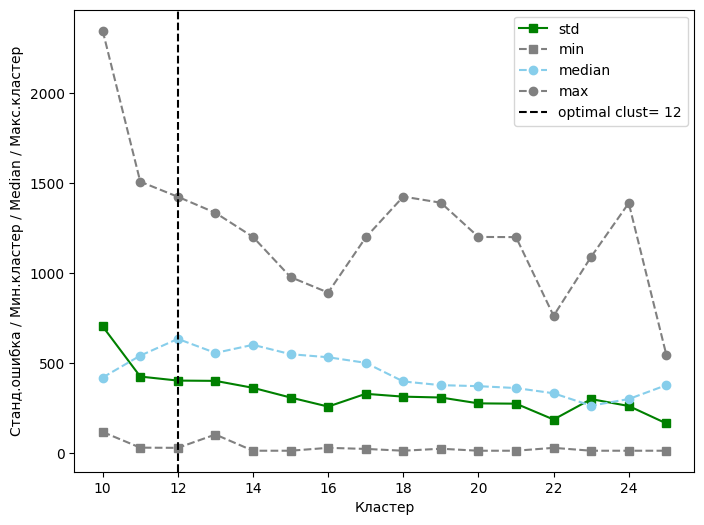

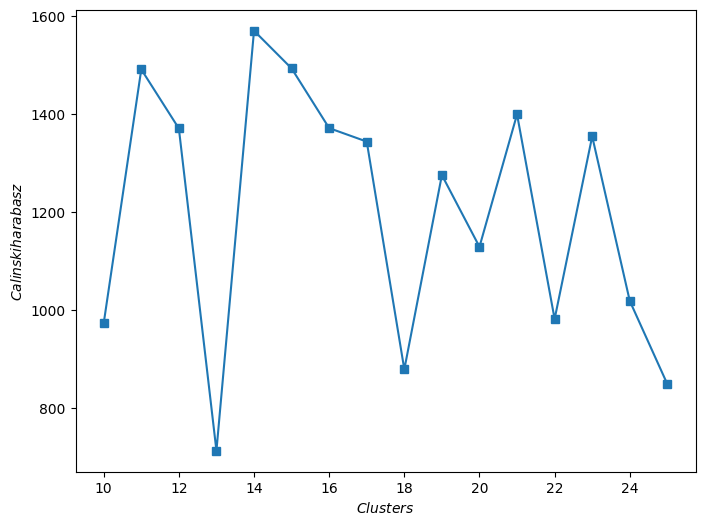

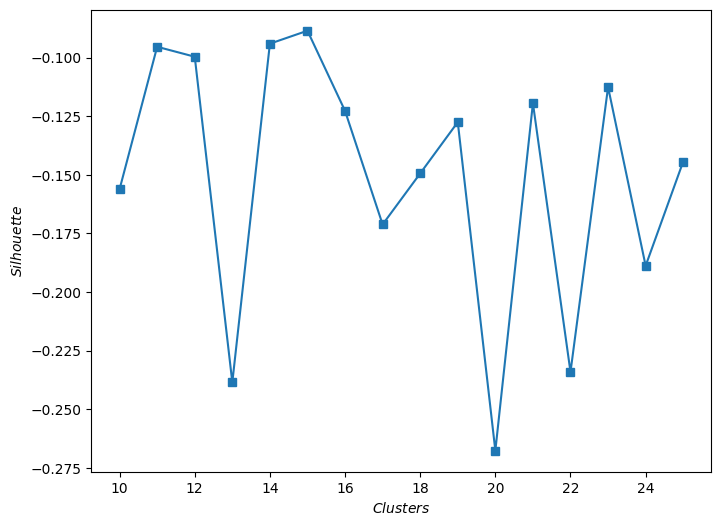

In [134]:
# подберем оптимальное количество кластеров
clust_faiss_pca_bert = clustering_analysis(data=df_bert,
                                           data_scale=df_scaled_bert,
                                           embedding=X_embedding_pca_bert,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

#### Без числовых данных

10 clusters
----------------------------------------------------------------------------------------------------


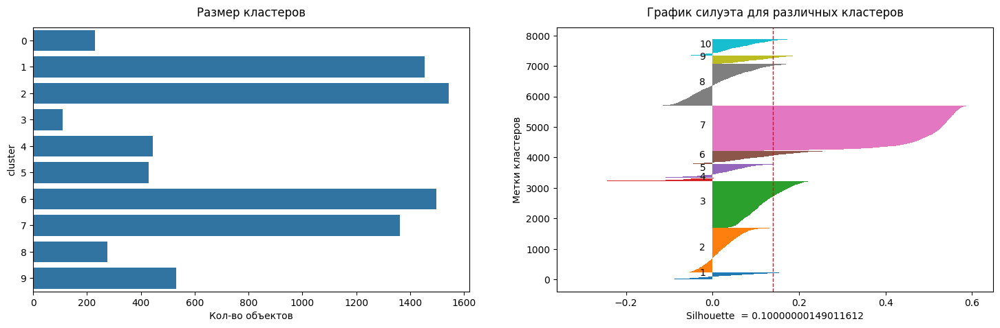

11 clusters
----------------------------------------------------------------------------------------------------


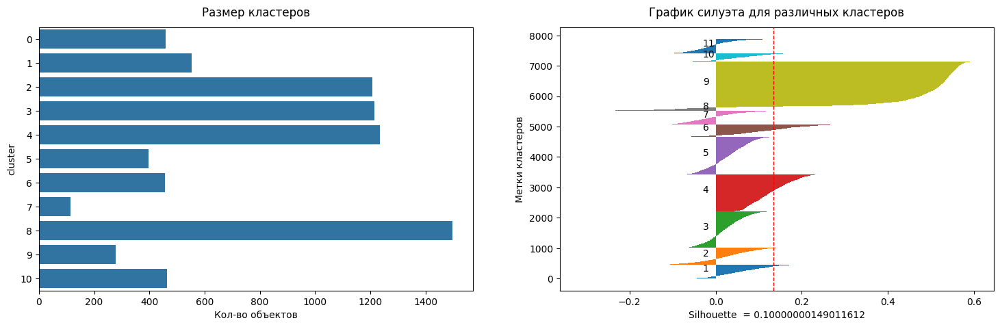

12 clusters
----------------------------------------------------------------------------------------------------


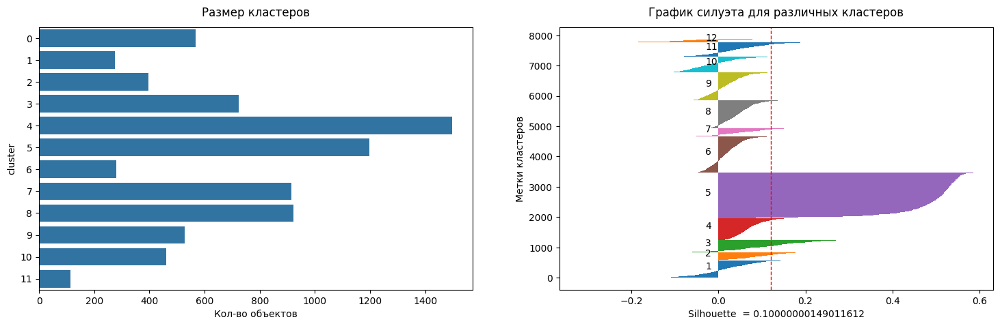

13 clusters
----------------------------------------------------------------------------------------------------


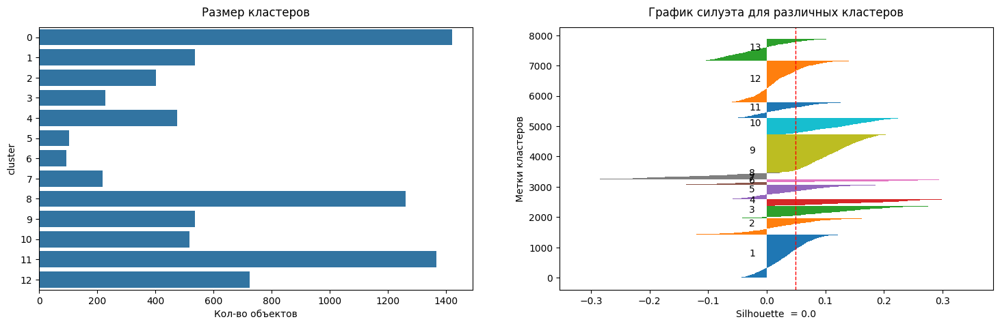

14 clusters
----------------------------------------------------------------------------------------------------


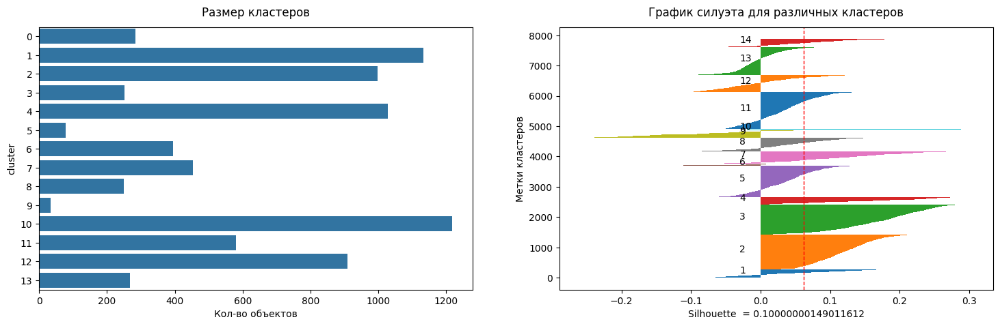

15 clusters
----------------------------------------------------------------------------------------------------


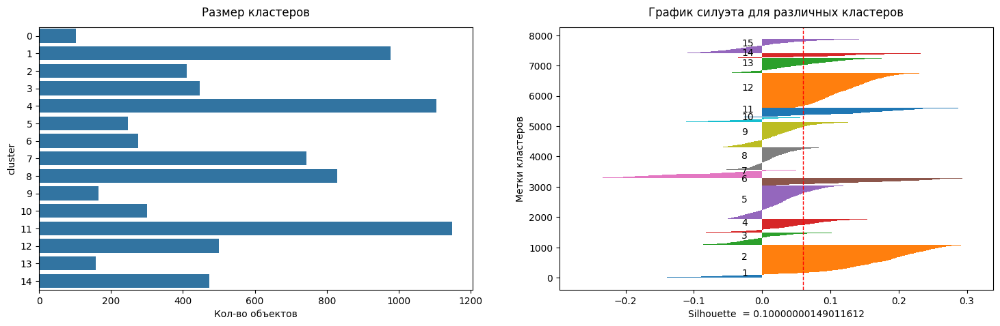

16 clusters
----------------------------------------------------------------------------------------------------


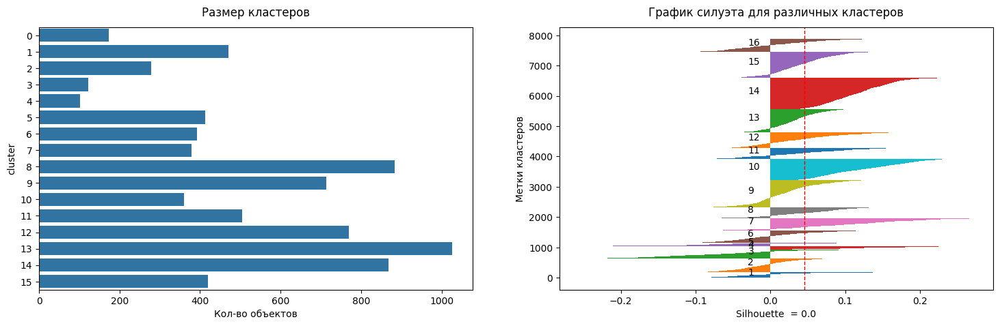

17 clusters
----------------------------------------------------------------------------------------------------


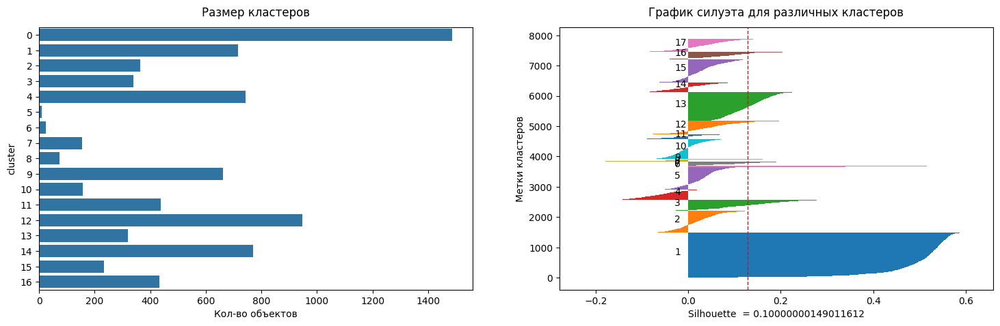

18 clusters
----------------------------------------------------------------------------------------------------


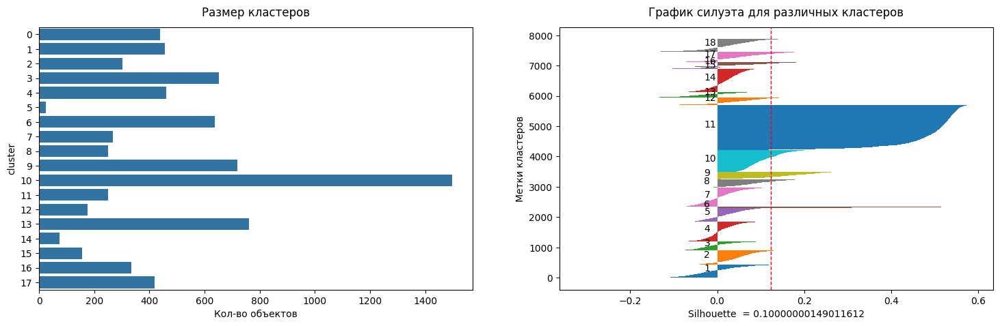

19 clusters
----------------------------------------------------------------------------------------------------


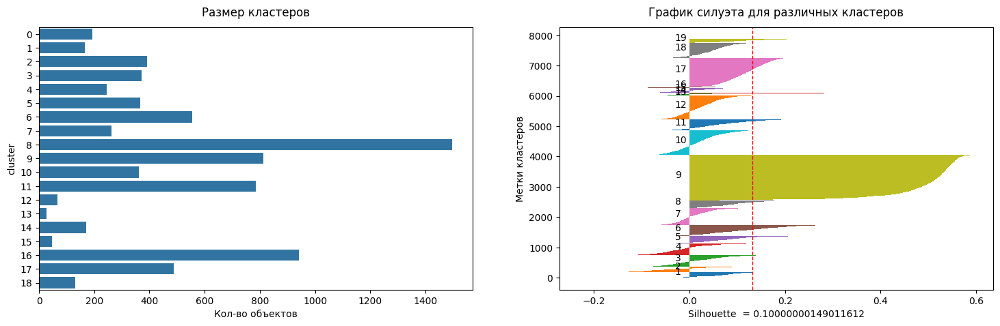

20 clusters
----------------------------------------------------------------------------------------------------


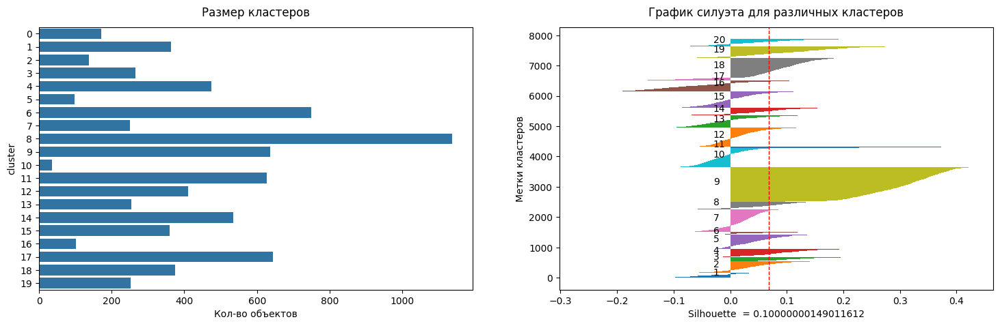

21 clusters
----------------------------------------------------------------------------------------------------


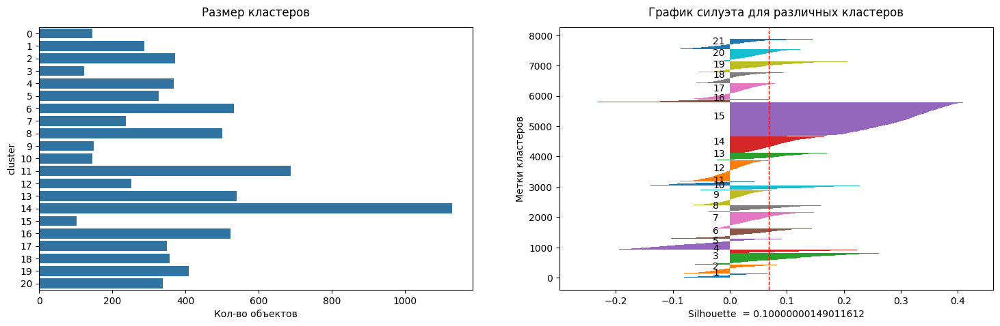

22 clusters
----------------------------------------------------------------------------------------------------


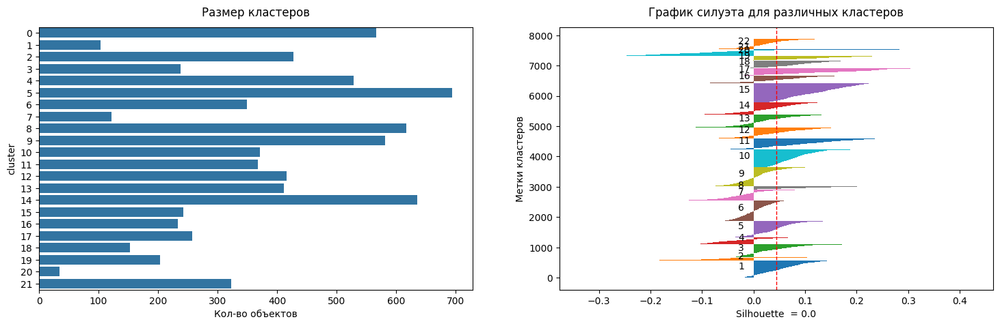

23 clusters
----------------------------------------------------------------------------------------------------


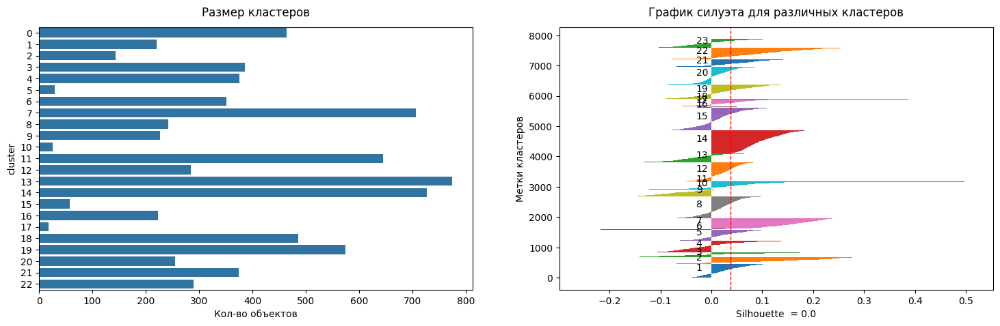

24 clusters
----------------------------------------------------------------------------------------------------


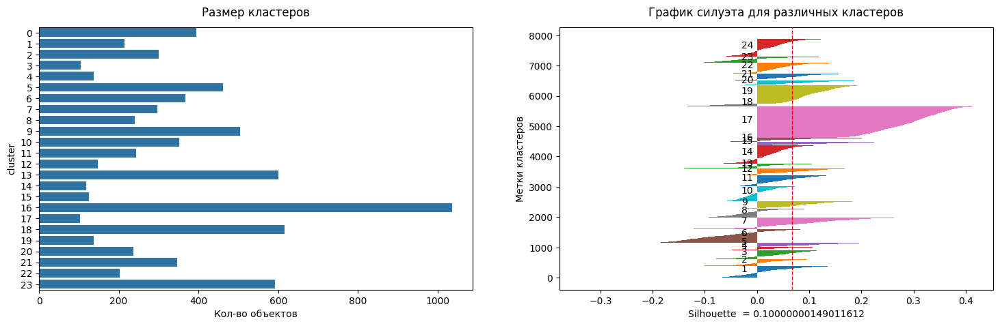

25 clusters
----------------------------------------------------------------------------------------------------


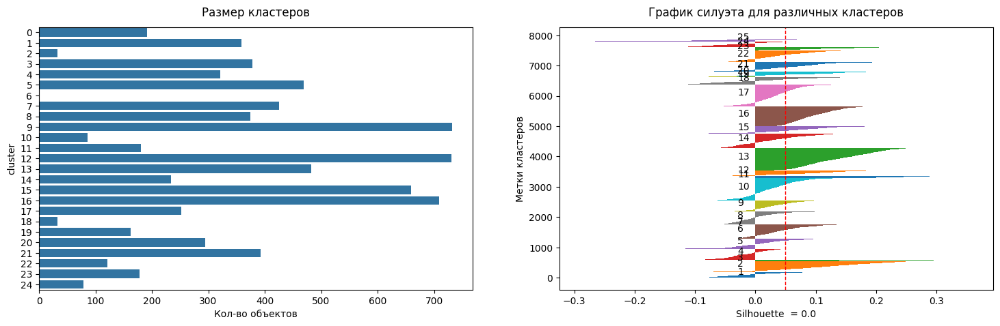

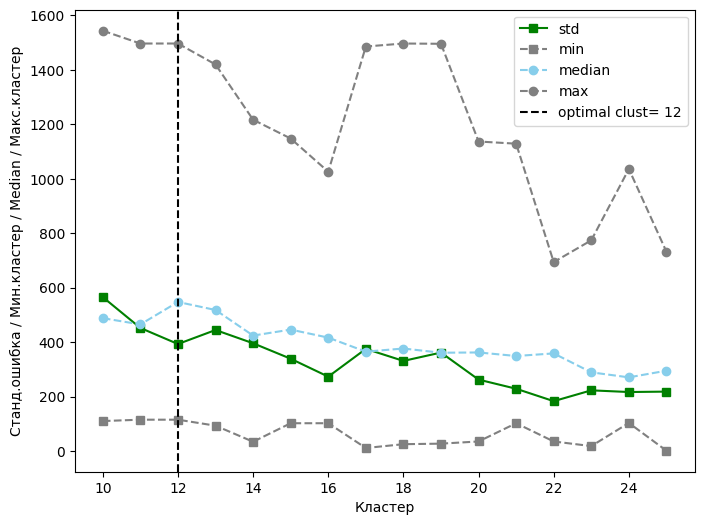

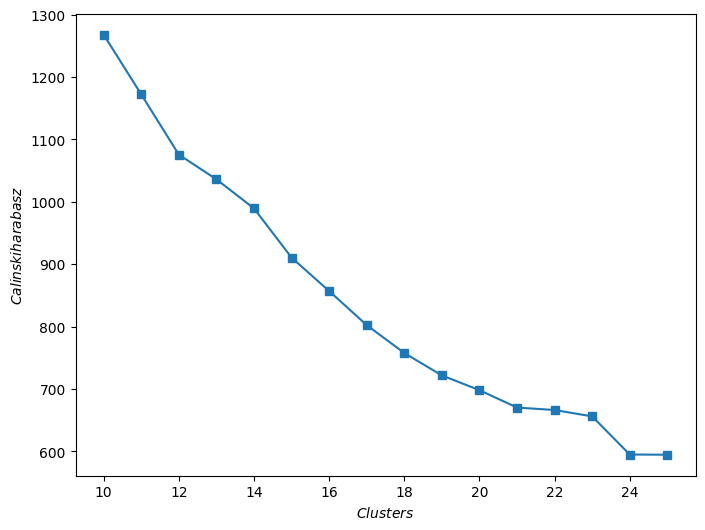

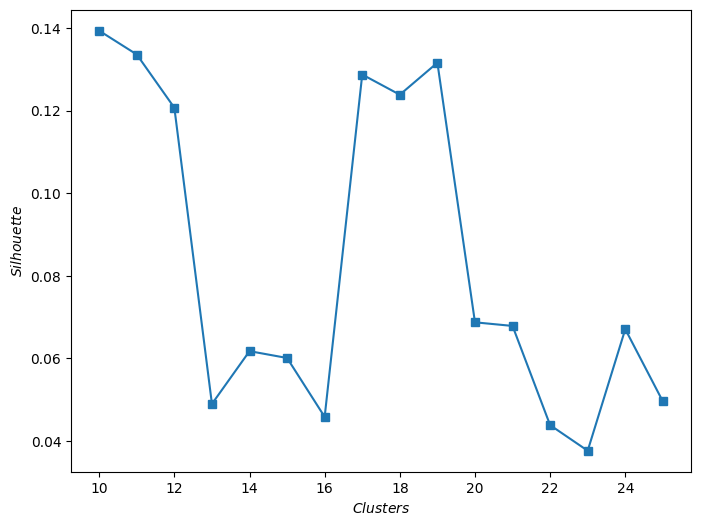

In [135]:
# подберем оптимальное количество кластеров
clust_faiss_pca_bert_text = clustering_analysis(data=df_bert_text,
                                           data_scale=df_bert_text,
                                           embedding=X_embedding_pca_bert_text,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=25,
                                           type_train='embedding')

**Выводы:**

- алгоритм PCA+Faiss на всех данных не может выделить кластеры;
- при использовании bert без числовых данных алгоритм ведет себя лучше всего, но делает большие ошибки на кластерах

## Spectral Clustering

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


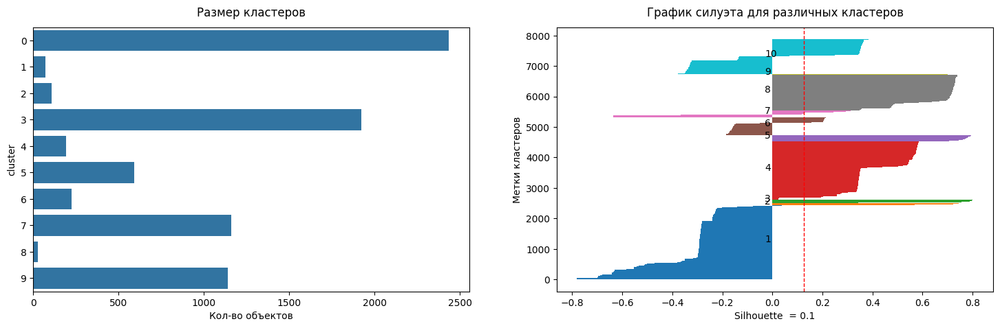

11 clusters
----------------------------------------------------------------------------------------------------


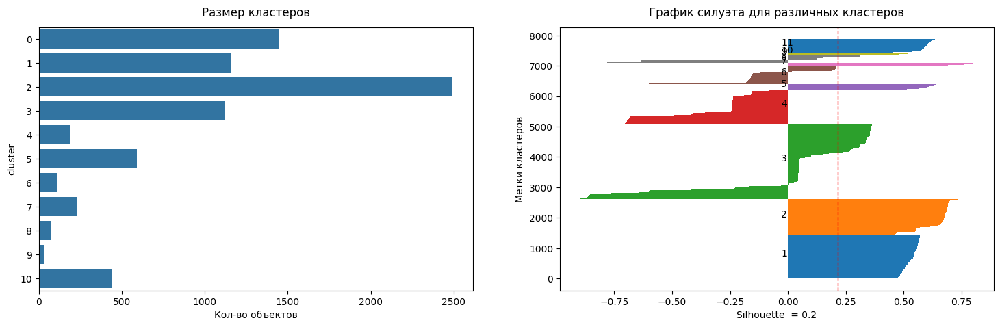

12 clusters
----------------------------------------------------------------------------------------------------


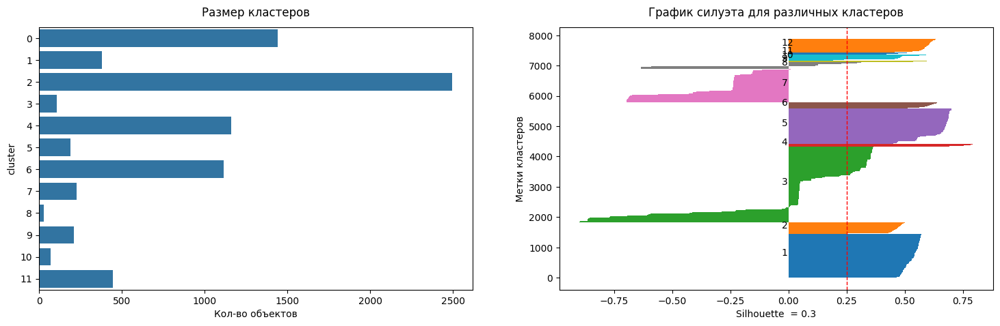

13 clusters
----------------------------------------------------------------------------------------------------


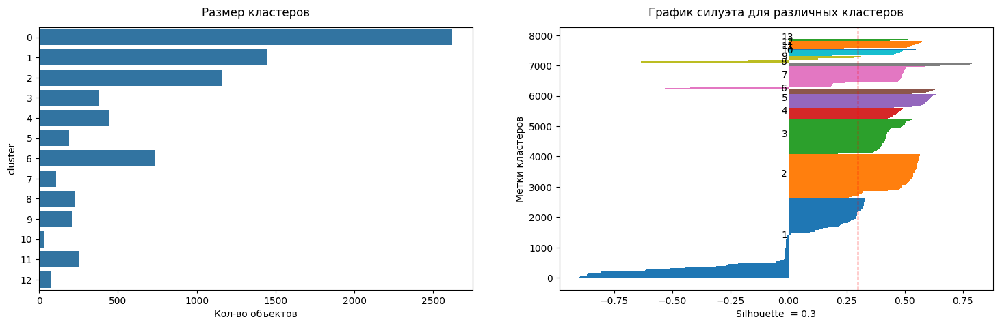

14 clusters
----------------------------------------------------------------------------------------------------


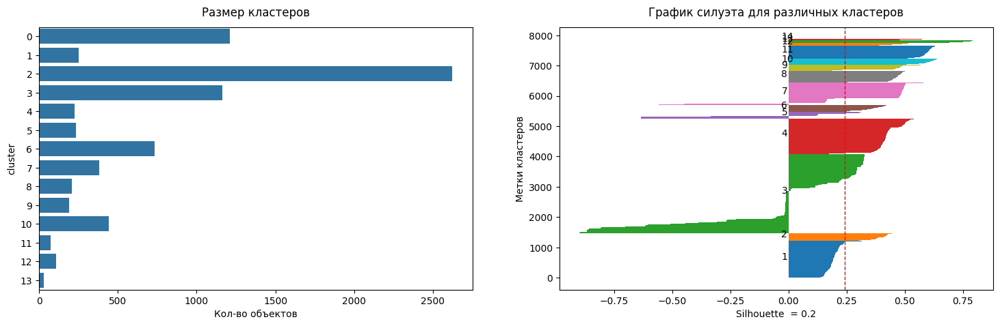

15 clusters
----------------------------------------------------------------------------------------------------


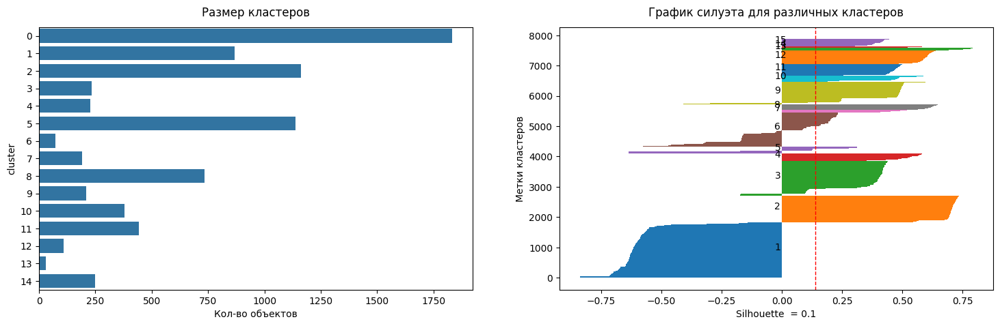

16 clusters
----------------------------------------------------------------------------------------------------


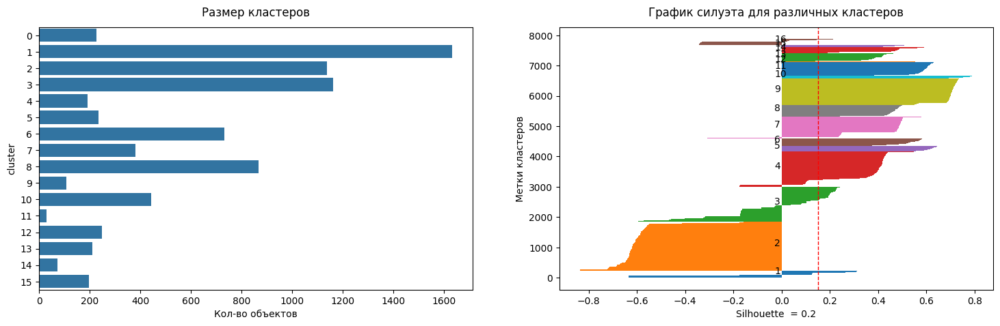

17 clusters
----------------------------------------------------------------------------------------------------


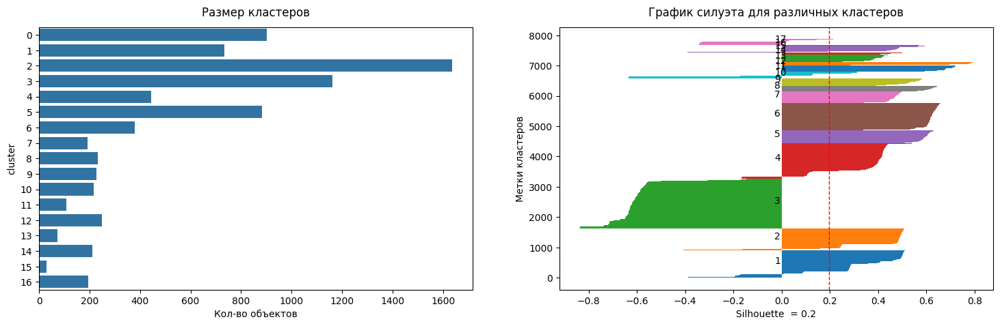

18 clusters
----------------------------------------------------------------------------------------------------


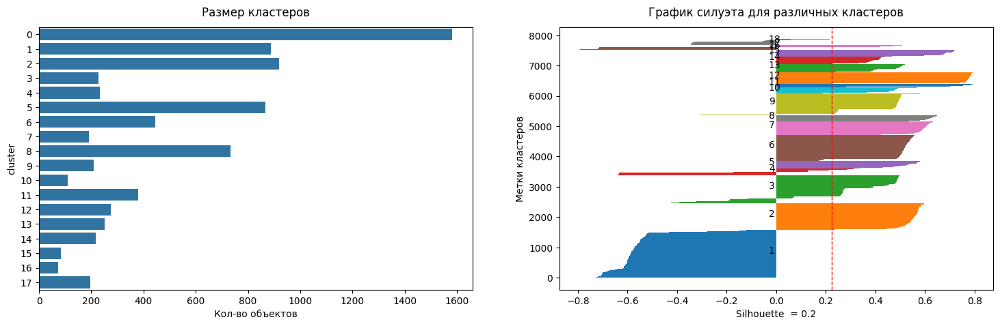

19 clusters
----------------------------------------------------------------------------------------------------


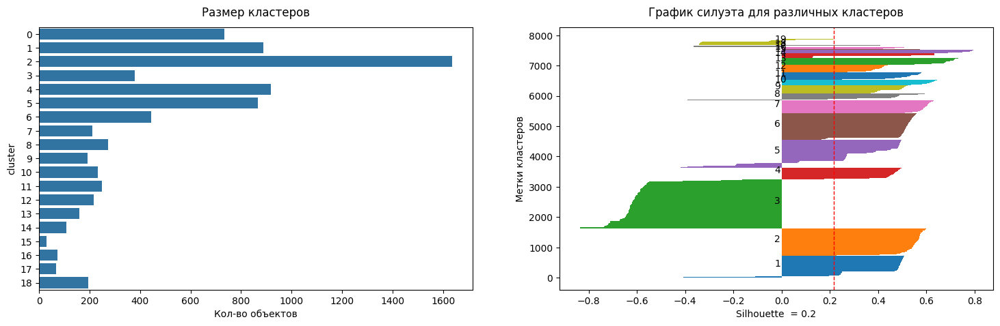

20 clusters
----------------------------------------------------------------------------------------------------


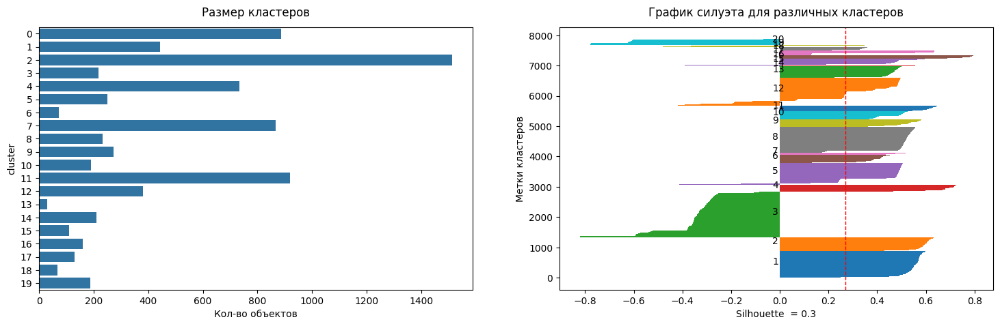

21 clusters
----------------------------------------------------------------------------------------------------


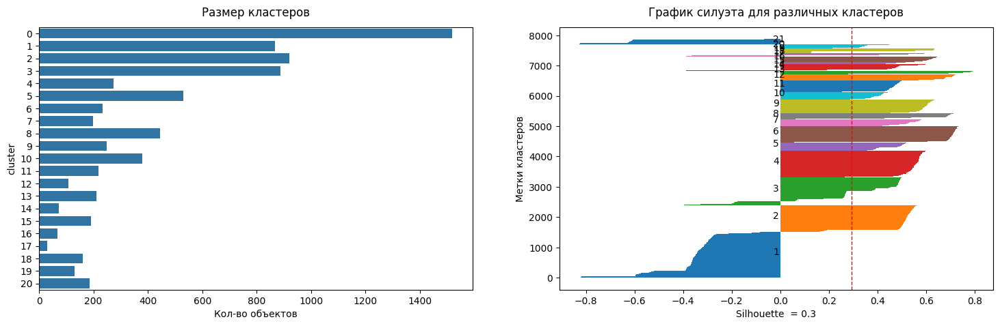

22 clusters
----------------------------------------------------------------------------------------------------


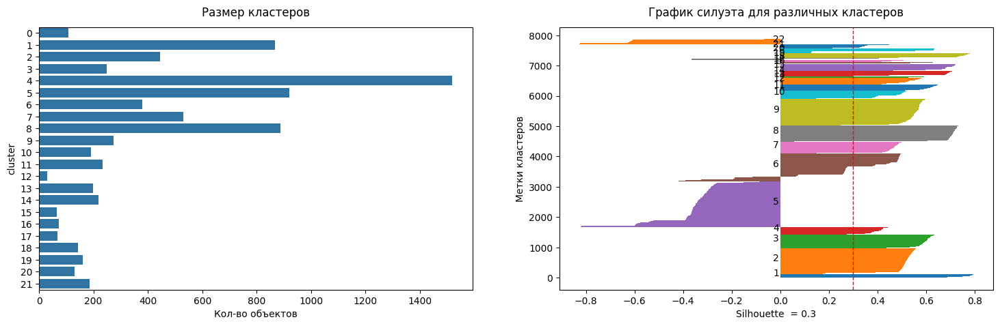

23 clusters
----------------------------------------------------------------------------------------------------


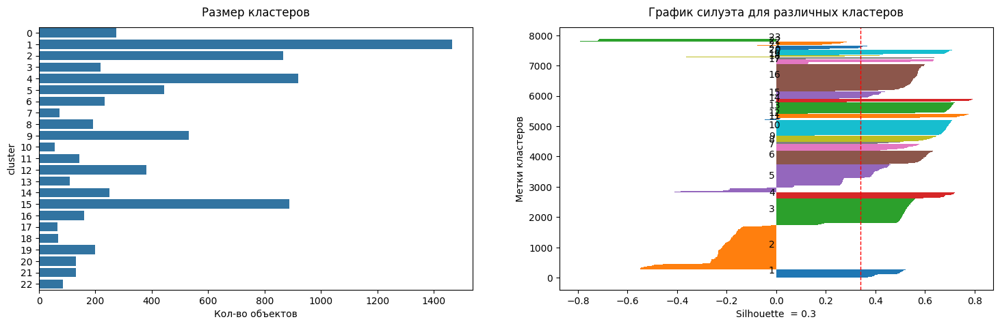

24 clusters
----------------------------------------------------------------------------------------------------


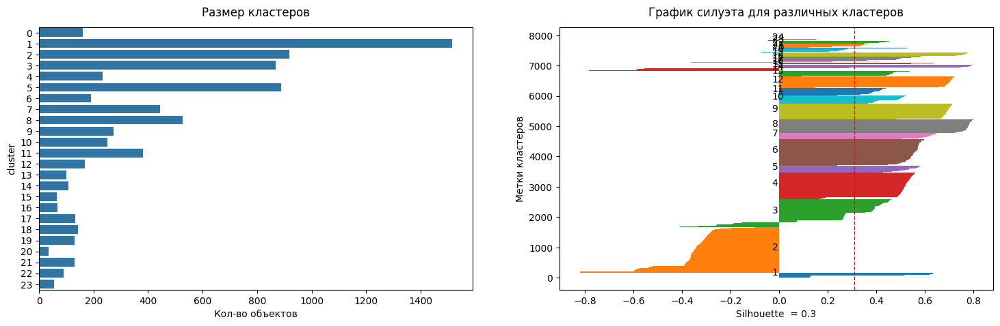

25 clusters
----------------------------------------------------------------------------------------------------


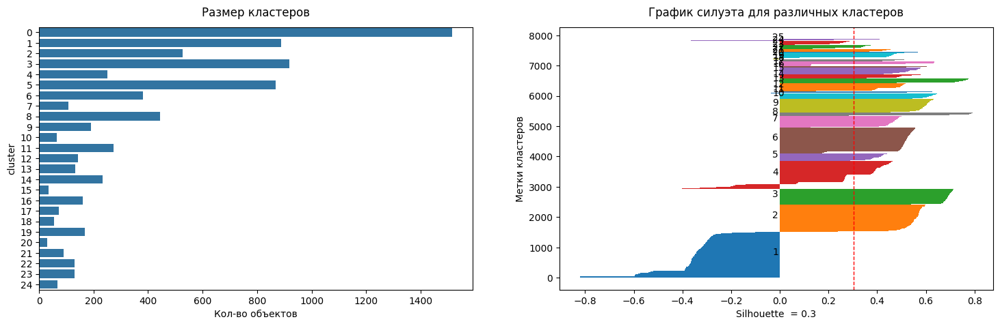

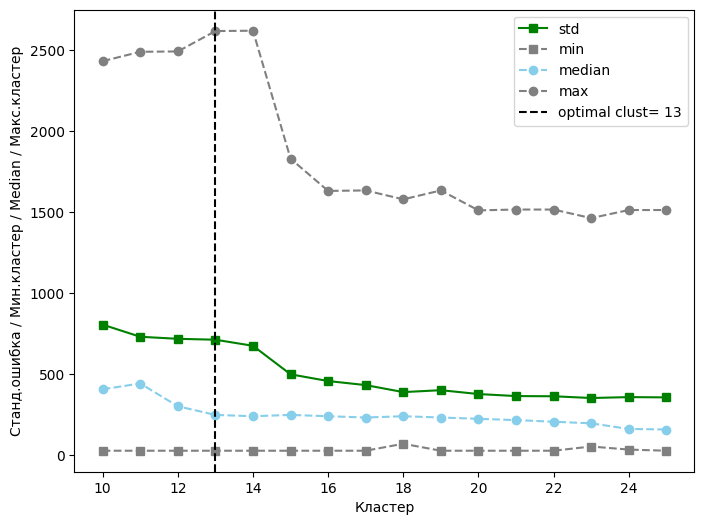

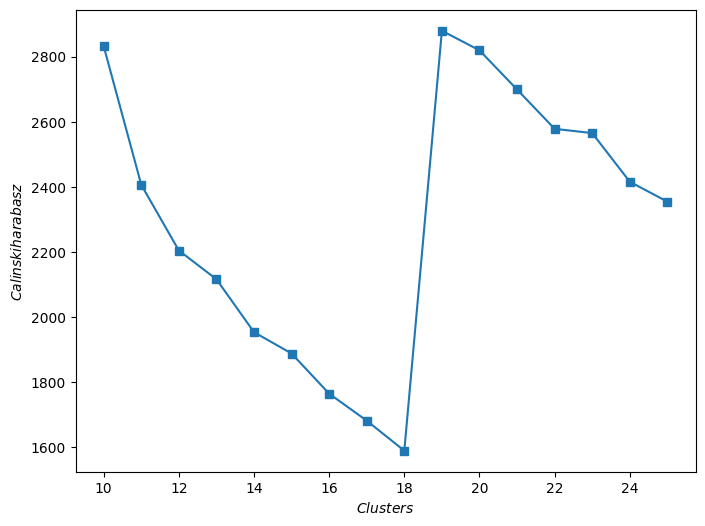

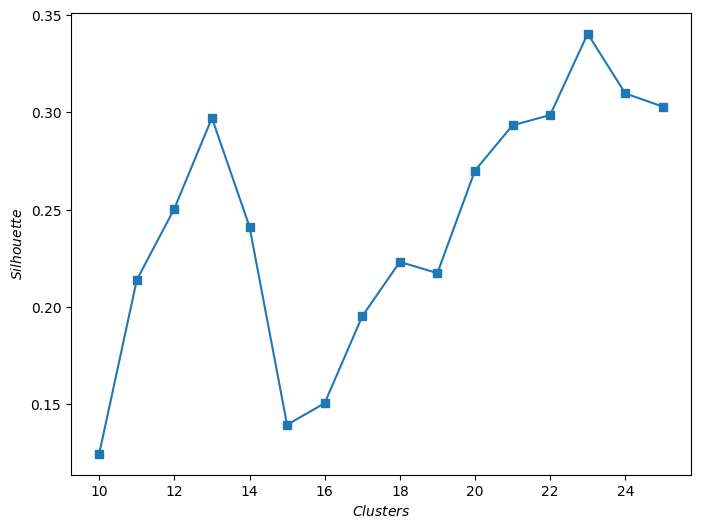

In [136]:
# подберем оптимальное количество кластеров
clust_spec_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=None,
                                           embedding=X_embedding_umap_tf,
                                           model=SpectralClustering,
                                           kwargs=params_cluster['SpectralClustering'],
                                           min_size=10,
                                           max_size=25,
                                           type_train=None)

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


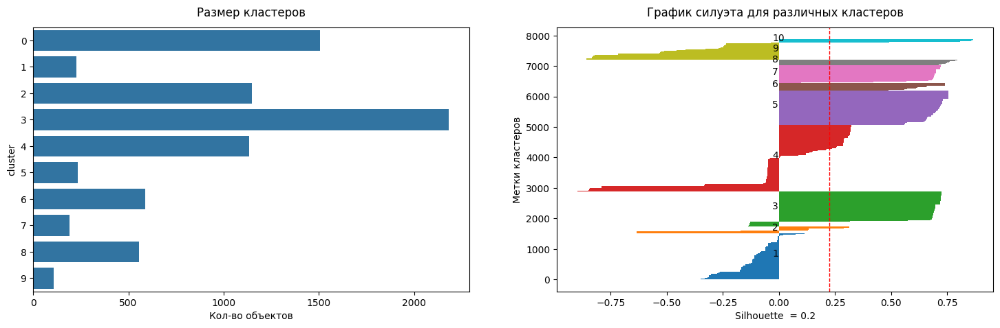

11 clusters
----------------------------------------------------------------------------------------------------


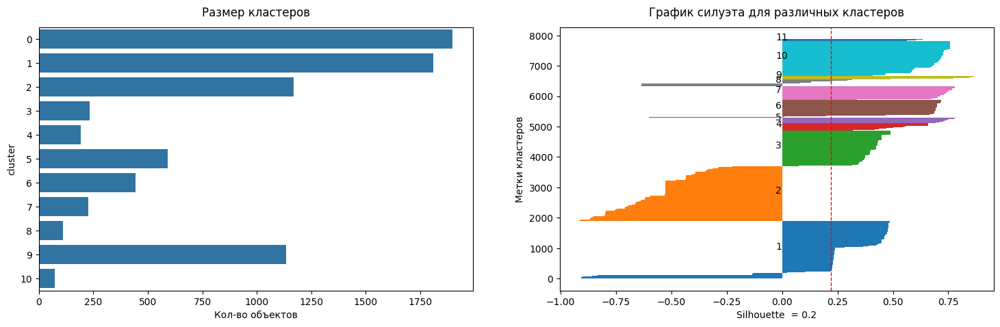

12 clusters
----------------------------------------------------------------------------------------------------


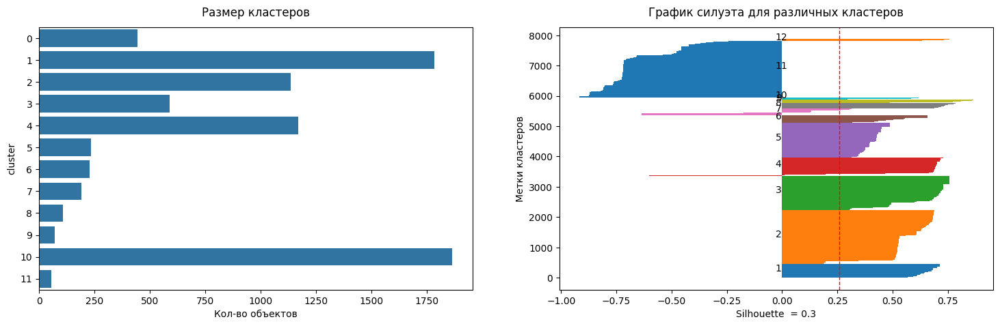

13 clusters
----------------------------------------------------------------------------------------------------


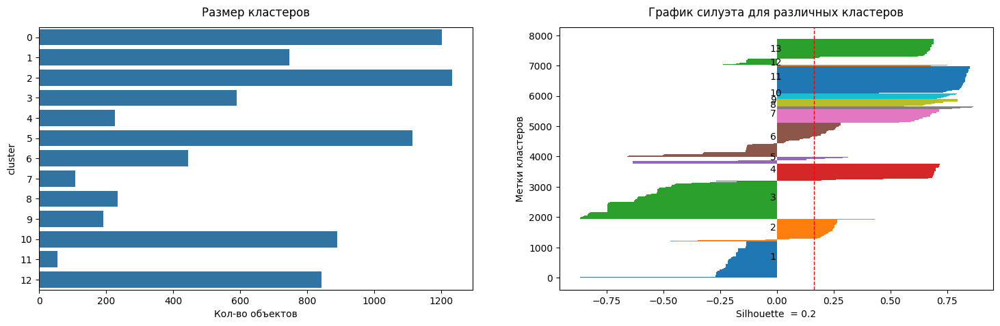

14 clusters
----------------------------------------------------------------------------------------------------


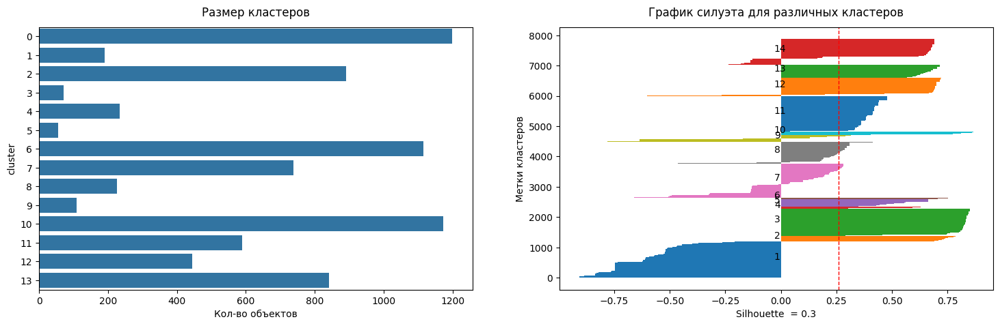

15 clusters
----------------------------------------------------------------------------------------------------


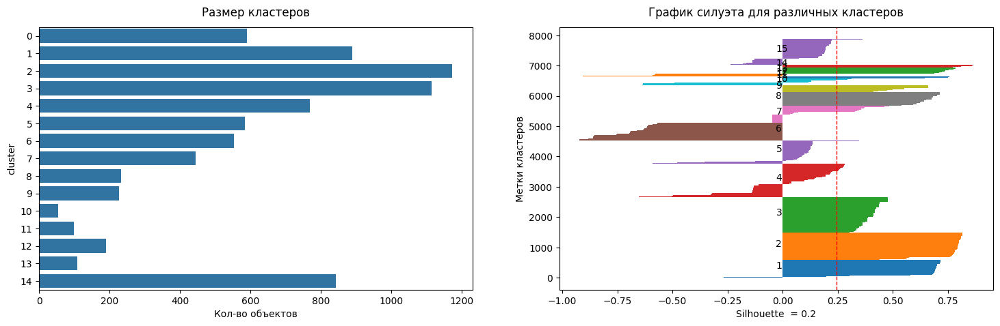

16 clusters
----------------------------------------------------------------------------------------------------


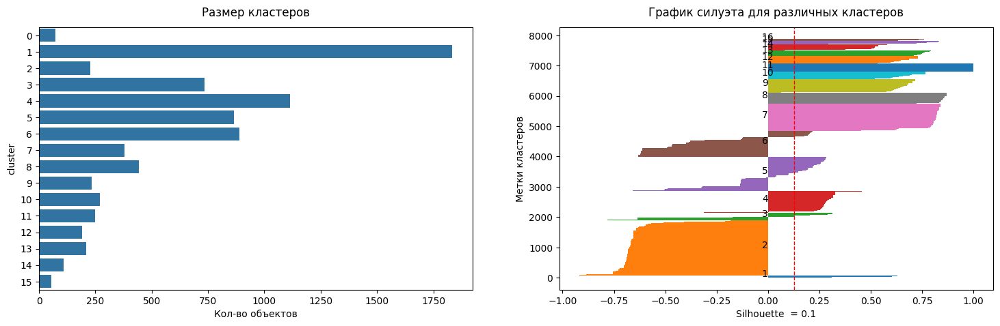

17 clusters
----------------------------------------------------------------------------------------------------


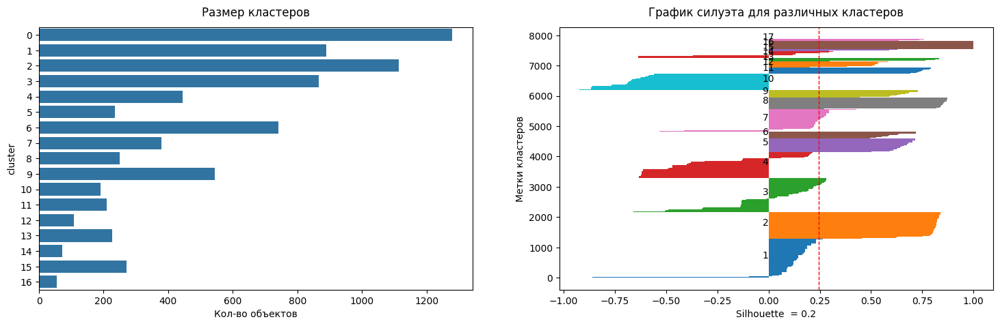

18 clusters
----------------------------------------------------------------------------------------------------


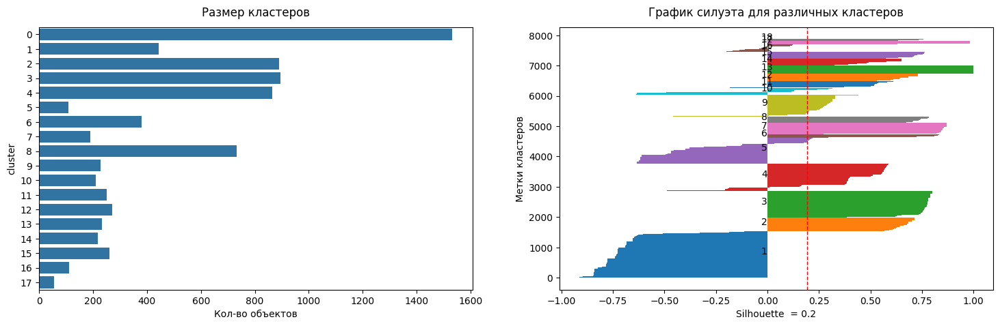

19 clusters
----------------------------------------------------------------------------------------------------


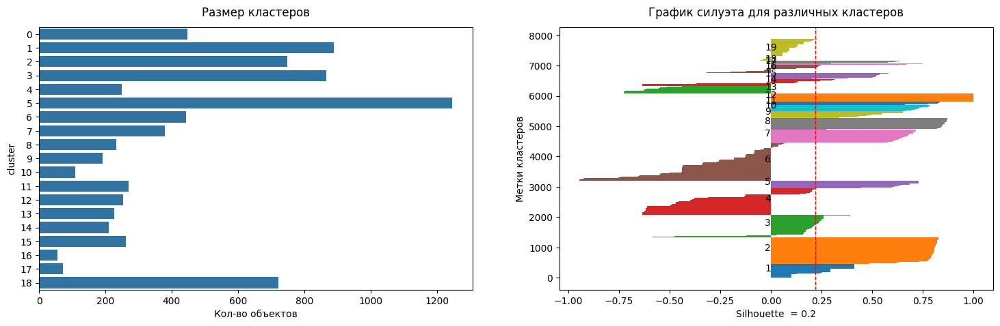

20 clusters
----------------------------------------------------------------------------------------------------


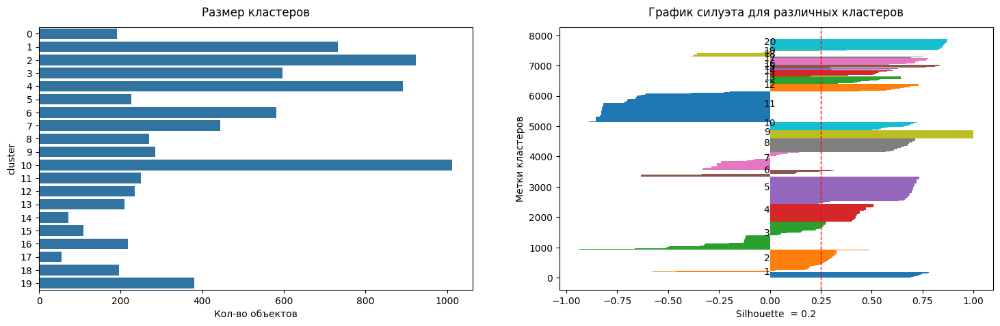

21 clusters
----------------------------------------------------------------------------------------------------


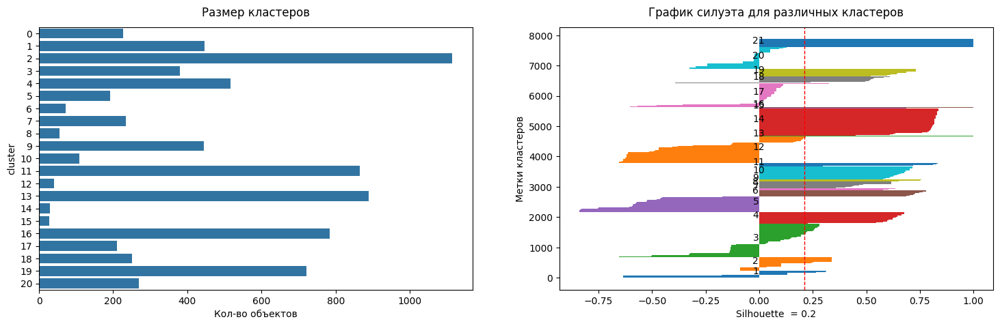

22 clusters
----------------------------------------------------------------------------------------------------


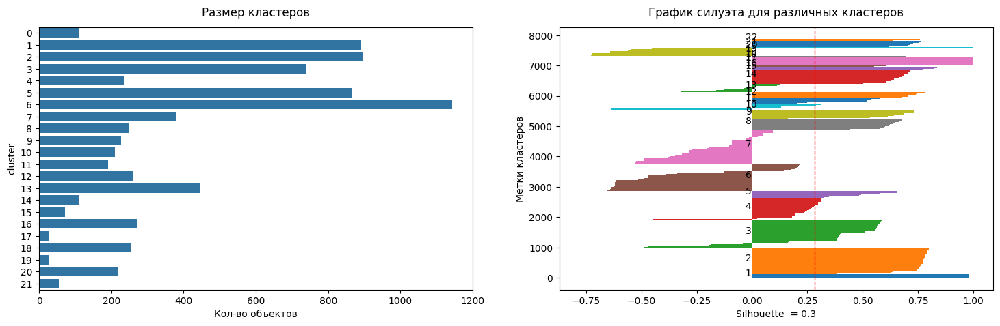

23 clusters
----------------------------------------------------------------------------------------------------


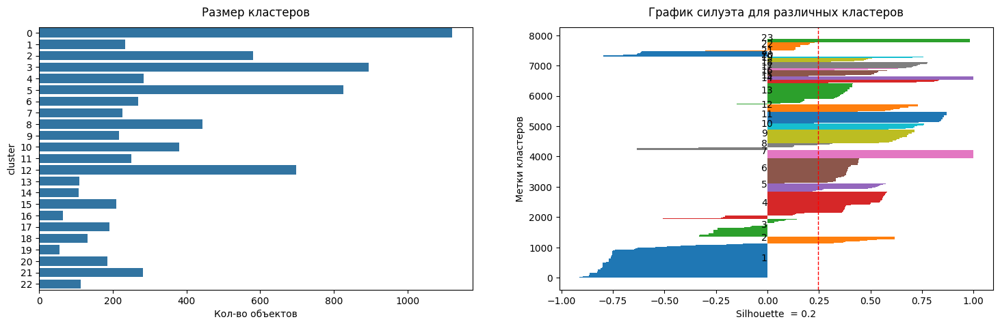

24 clusters
----------------------------------------------------------------------------------------------------


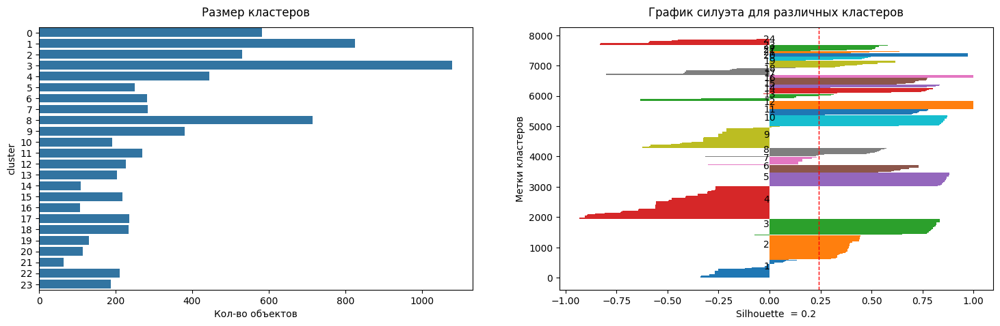

25 clusters
----------------------------------------------------------------------------------------------------


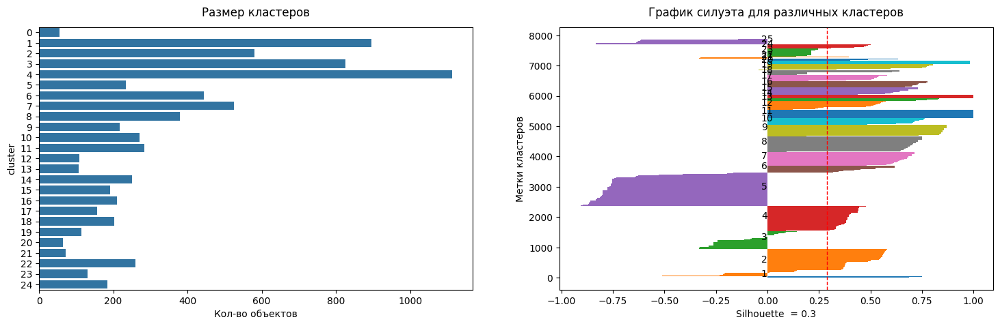

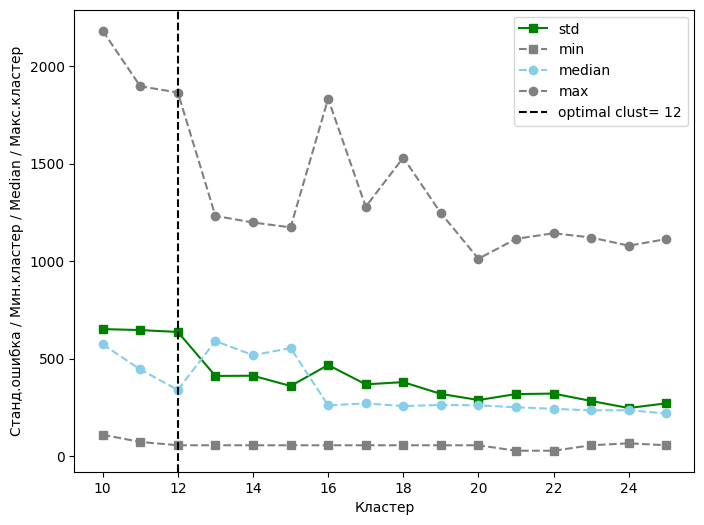

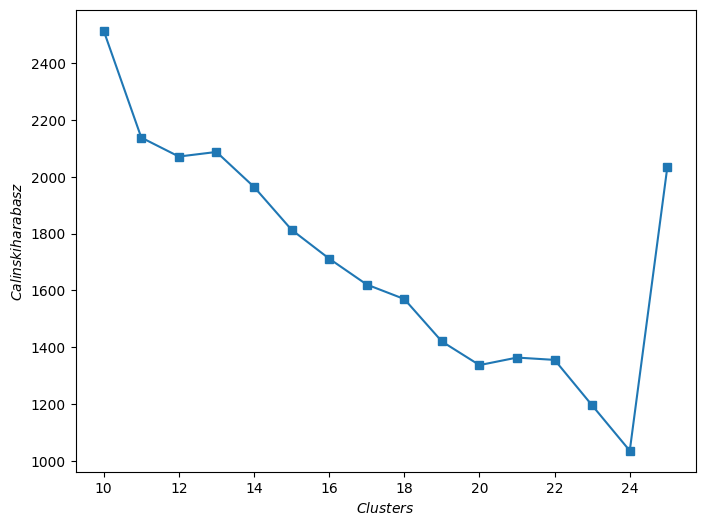

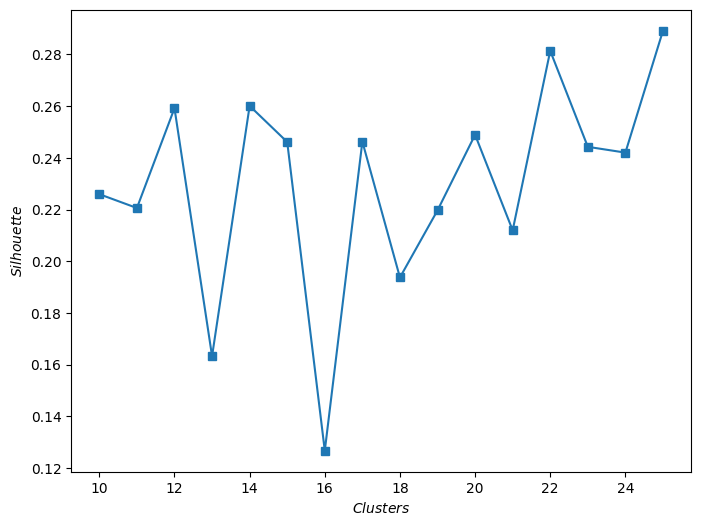

In [137]:
# подберем оптимальное количество кластеров
clust_spec_bert = clustering_analysis(data=df_bert,
                                           data_scale=None,
                                           embedding=X_embedding_umap_bert,
                                           model=SpectralClustering,
                                           kwargs=params_cluster['SpectralClustering'],
                                           min_size=10,
                                           max_size=25,
                                           type_train=None)

#### Без числовых данных

10 clusters
----------------------------------------------------------------------------------------------------


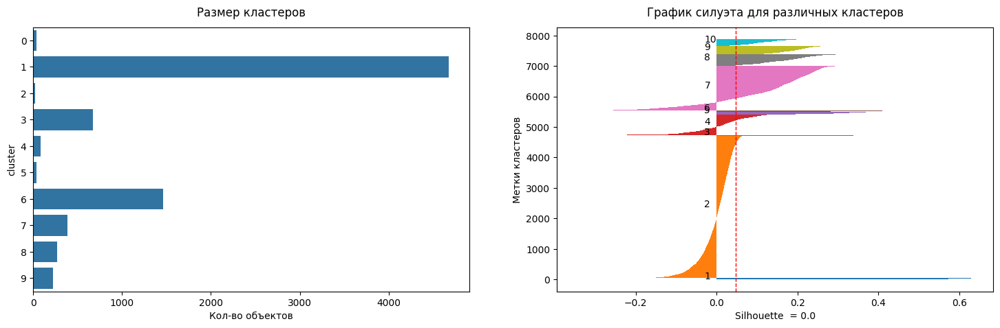

11 clusters
----------------------------------------------------------------------------------------------------


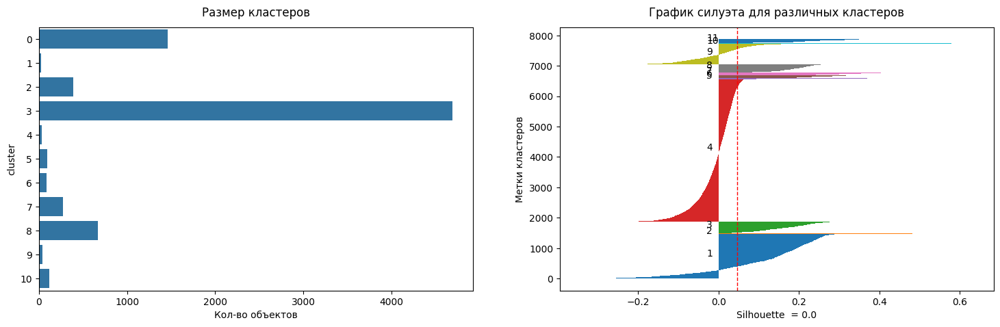

12 clusters
----------------------------------------------------------------------------------------------------


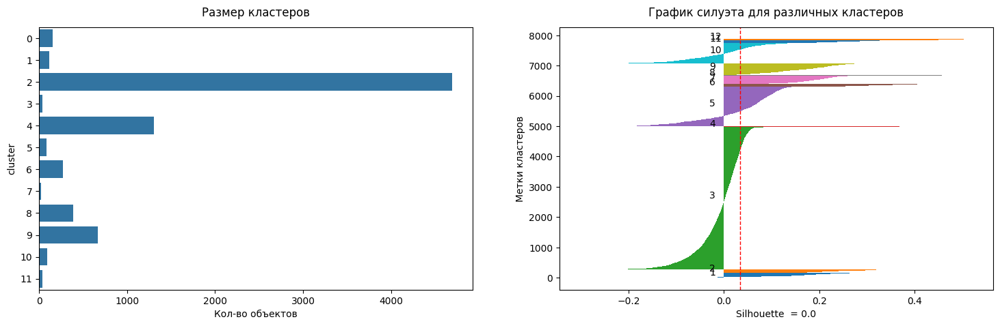

13 clusters
----------------------------------------------------------------------------------------------------


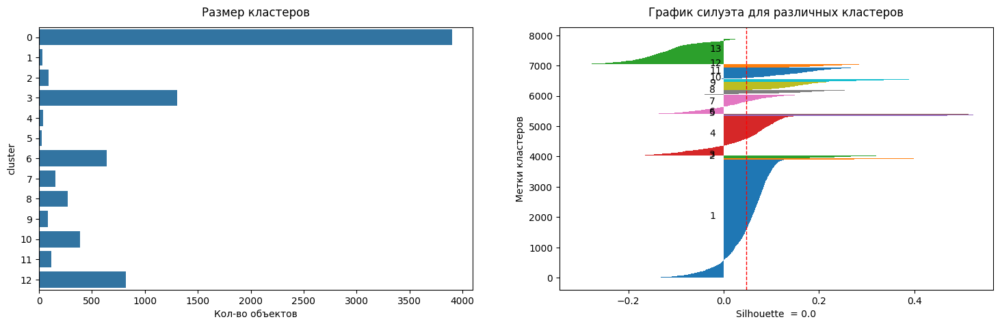

14 clusters
----------------------------------------------------------------------------------------------------


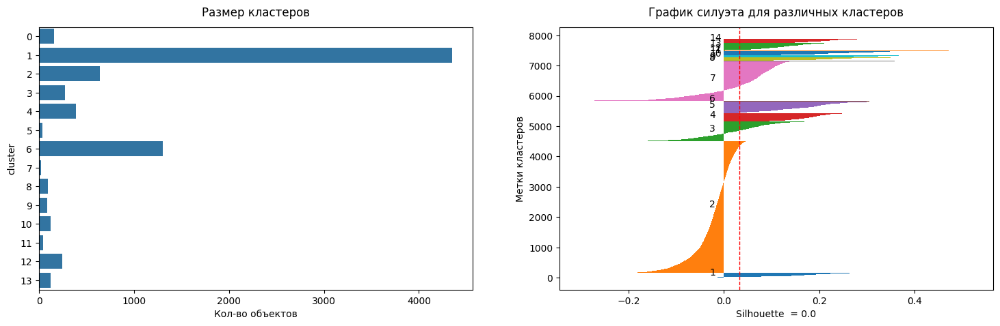

15 clusters
----------------------------------------------------------------------------------------------------


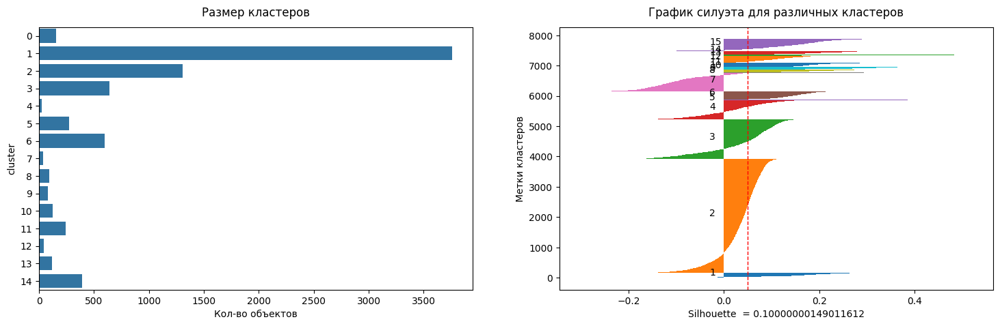

16 clusters
----------------------------------------------------------------------------------------------------


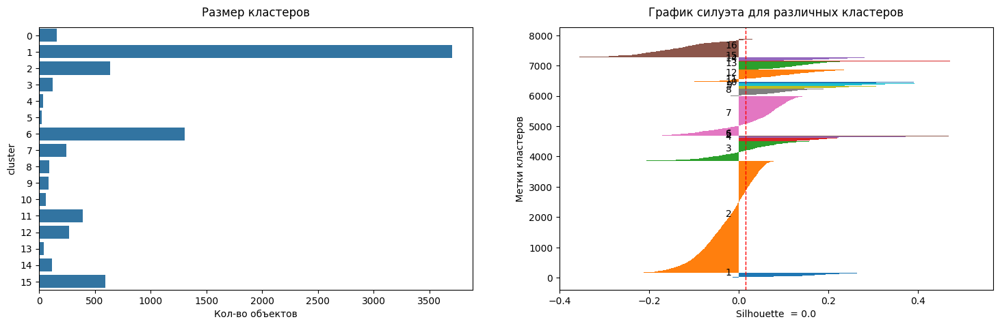

17 clusters
----------------------------------------------------------------------------------------------------


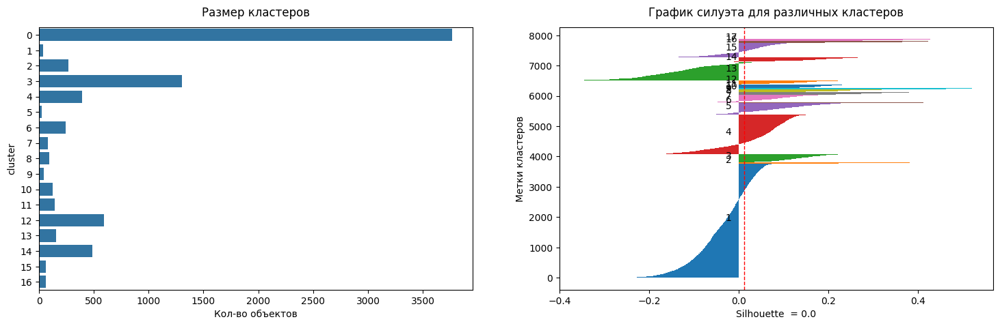

18 clusters
----------------------------------------------------------------------------------------------------


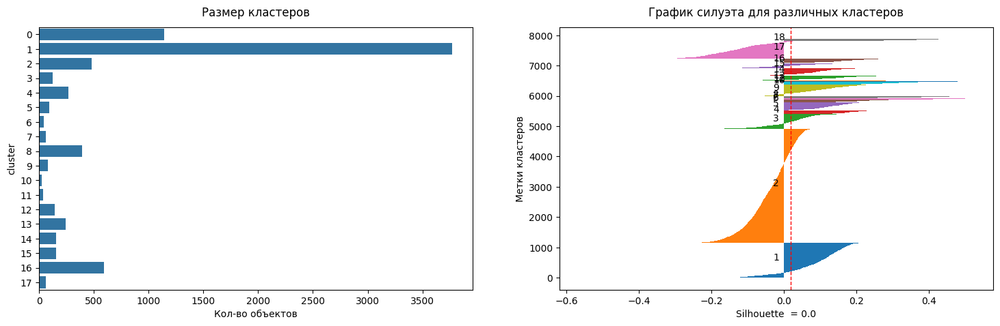

19 clusters
----------------------------------------------------------------------------------------------------


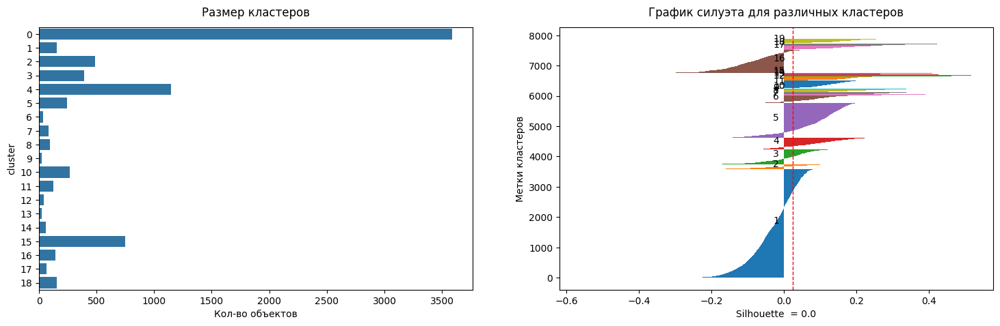

20 clusters
----------------------------------------------------------------------------------------------------


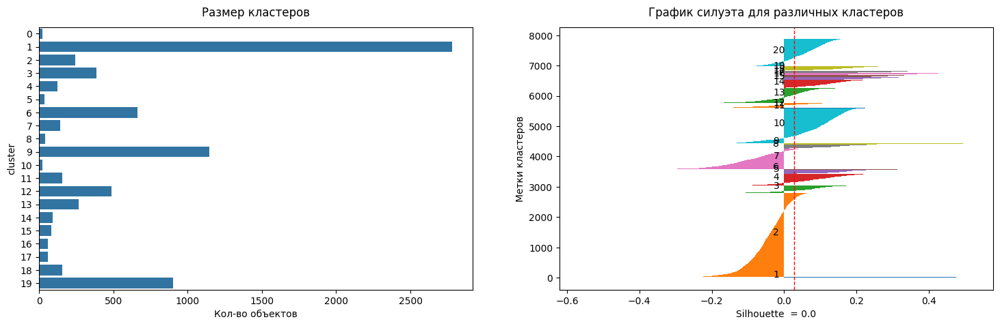

21 clusters
----------------------------------------------------------------------------------------------------


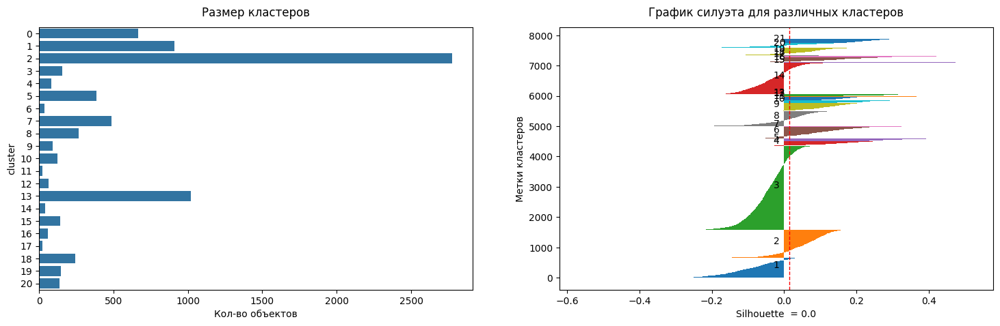

22 clusters
----------------------------------------------------------------------------------------------------


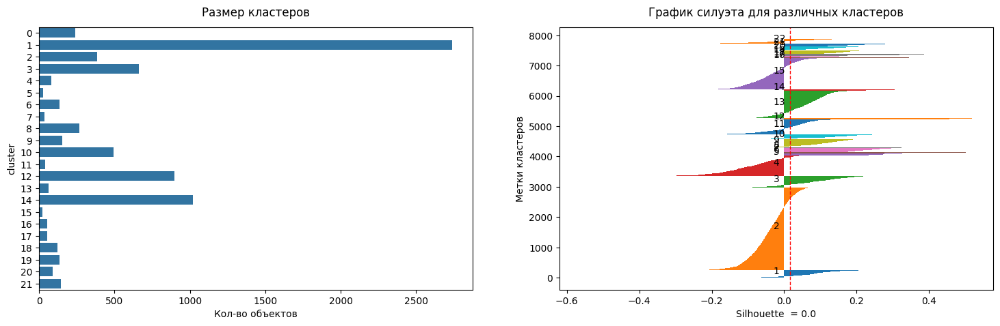

23 clusters
----------------------------------------------------------------------------------------------------


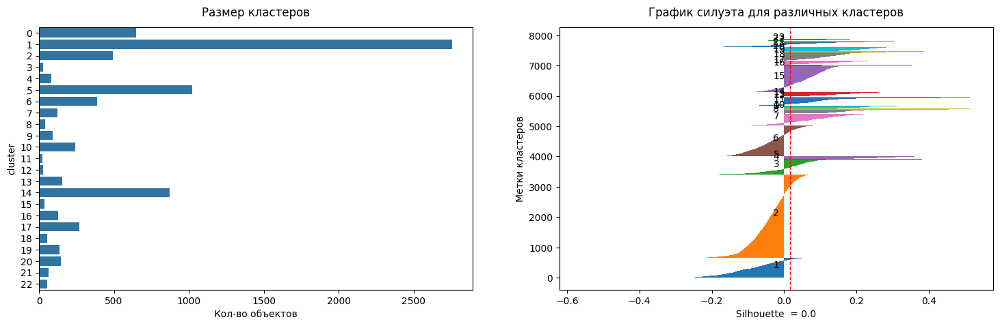

24 clusters
----------------------------------------------------------------------------------------------------


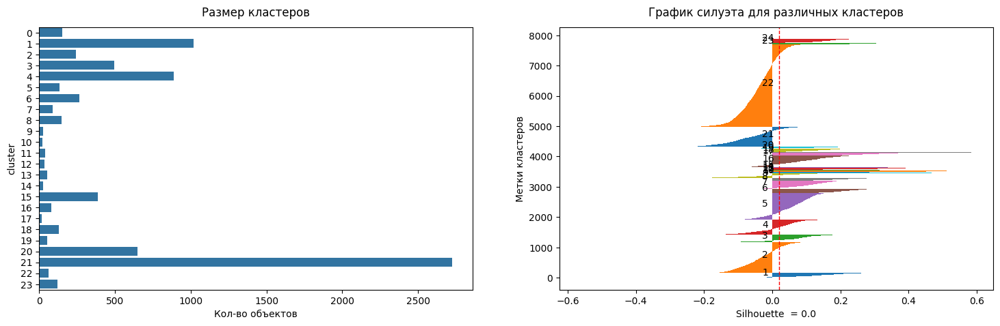

25 clusters
----------------------------------------------------------------------------------------------------


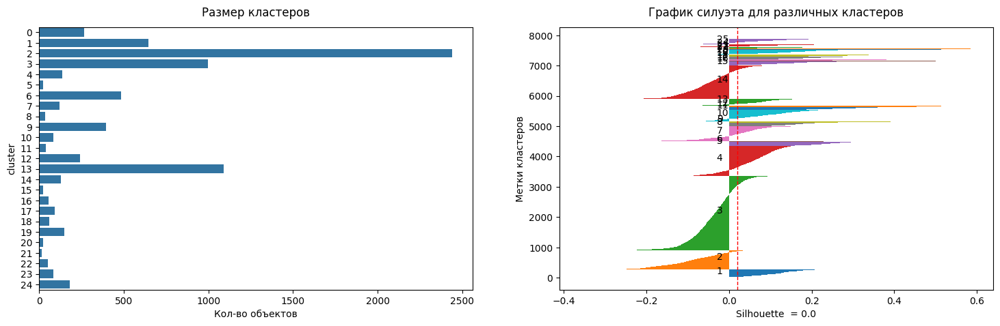

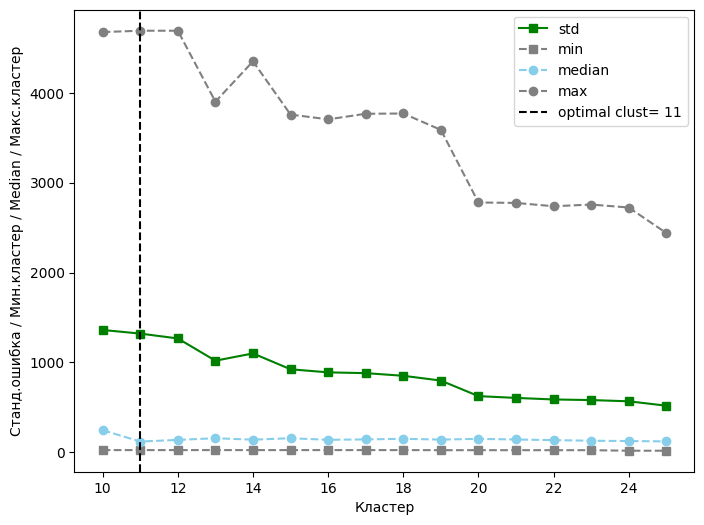

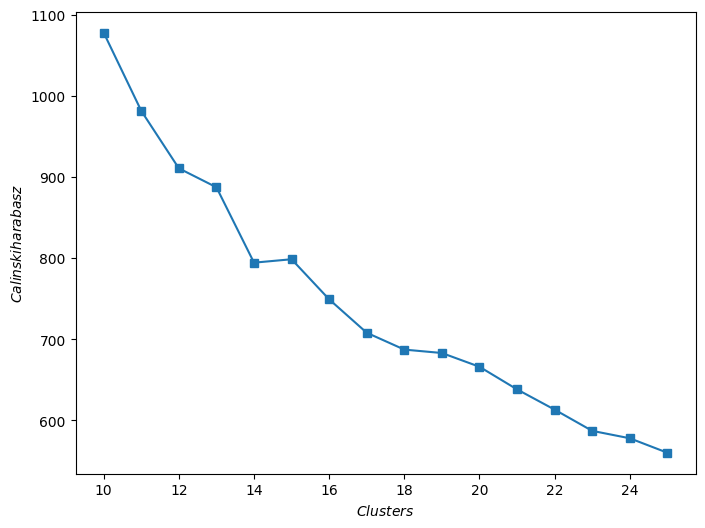

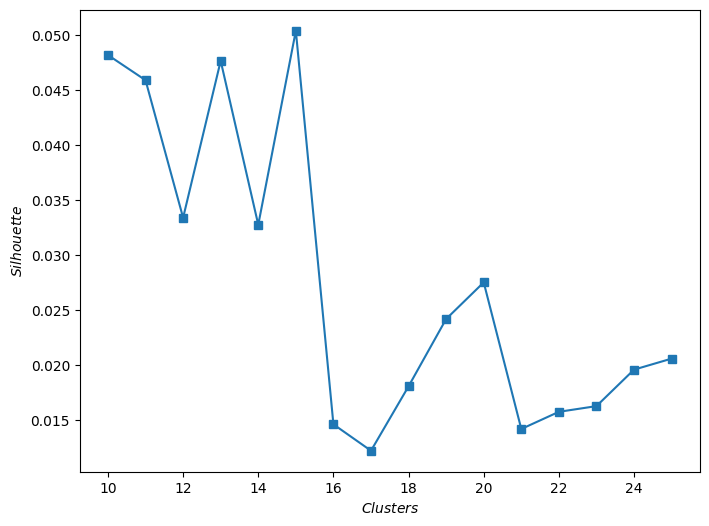

In [138]:
# подберем оптимальное количество кластеров
clust_spec_bert_text = clustering_analysis(data=df_bert_text,
                                           data_scale=None,
                                           embedding=X_embedding_umap_bert_text,
                                           model=SpectralClustering,
                                           kwargs=params_cluster['SpectralClustering'],
                                           min_size=10,
                                           max_size=25,
                                           type_train=None)

**Выводы:**

- алгоритм Spectral clustering разделяет кластеры, но наблюдаются ошибки в определении 2-4 кластеров;
- при использовании bert без числовых данных алгоритм ведет себя хуже всего;
- необходимо рассмотреть другой алгоритм

## Faiss

### TF IDF

10 clusters
----------------------------------------------------------------------------------------------------


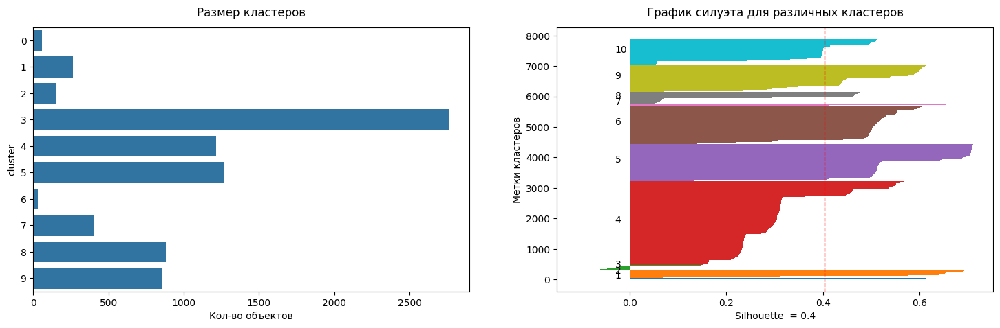

11 clusters
----------------------------------------------------------------------------------------------------


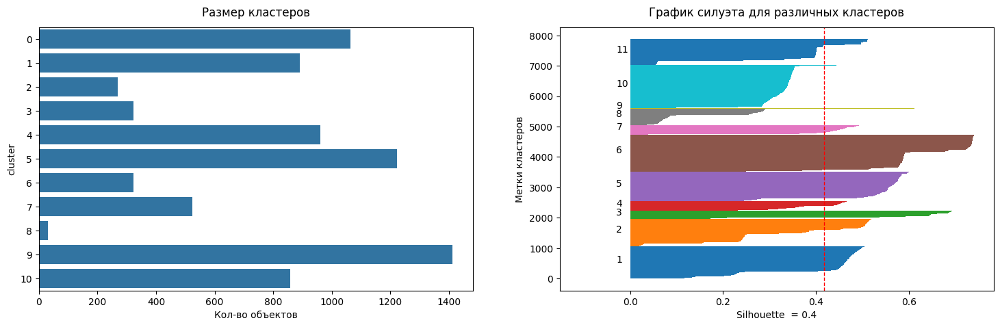

12 clusters
----------------------------------------------------------------------------------------------------


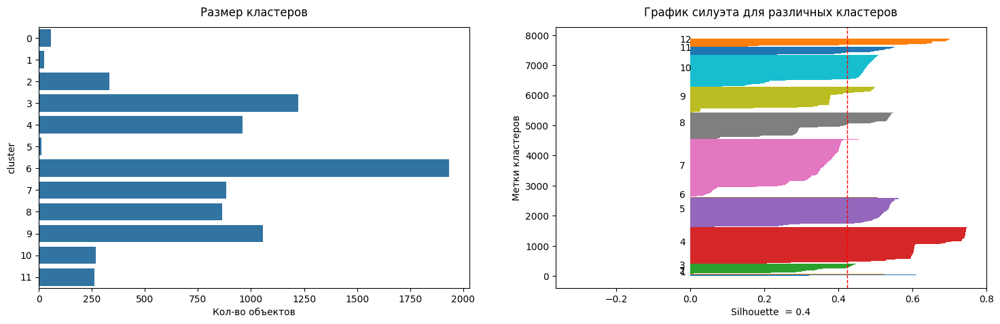

13 clusters
----------------------------------------------------------------------------------------------------


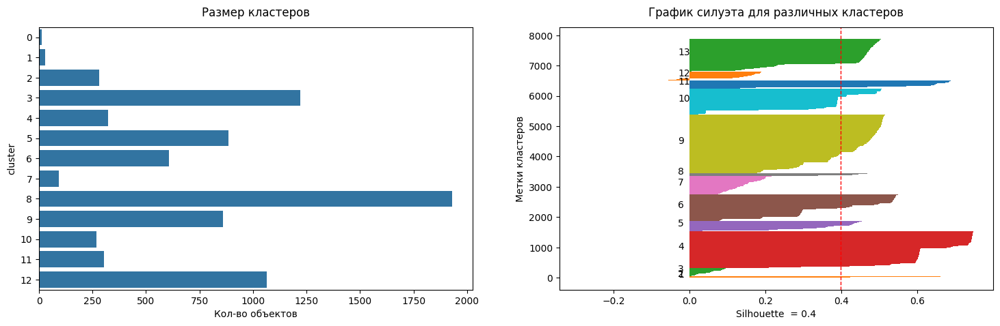

14 clusters
----------------------------------------------------------------------------------------------------


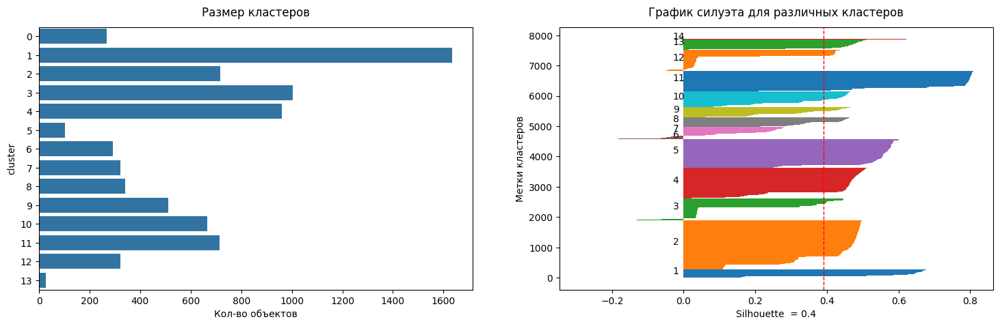

15 clusters
----------------------------------------------------------------------------------------------------


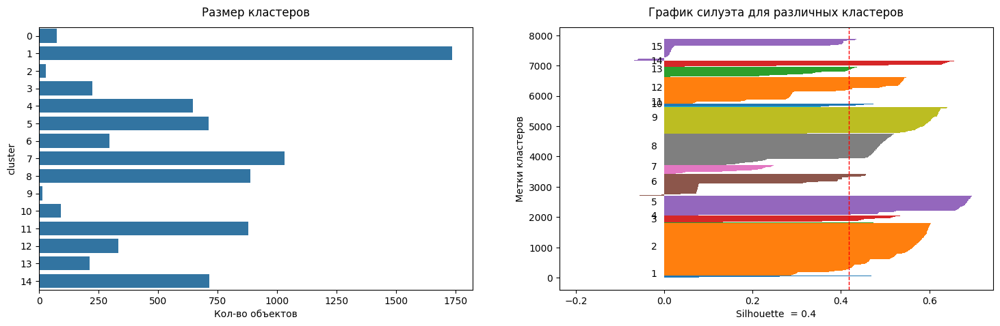

16 clusters
----------------------------------------------------------------------------------------------------


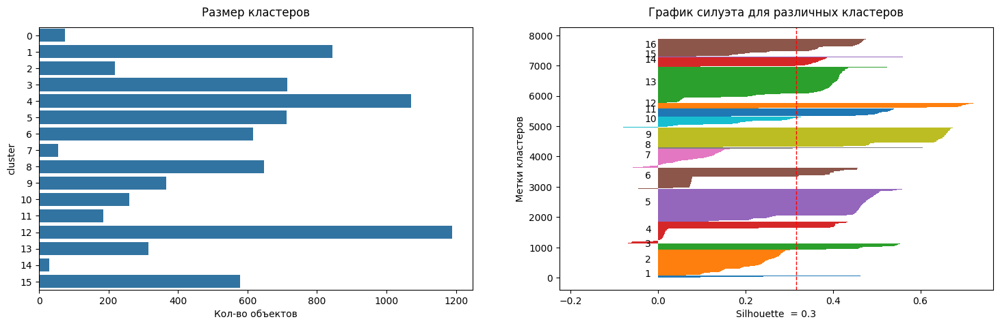

17 clusters
----------------------------------------------------------------------------------------------------


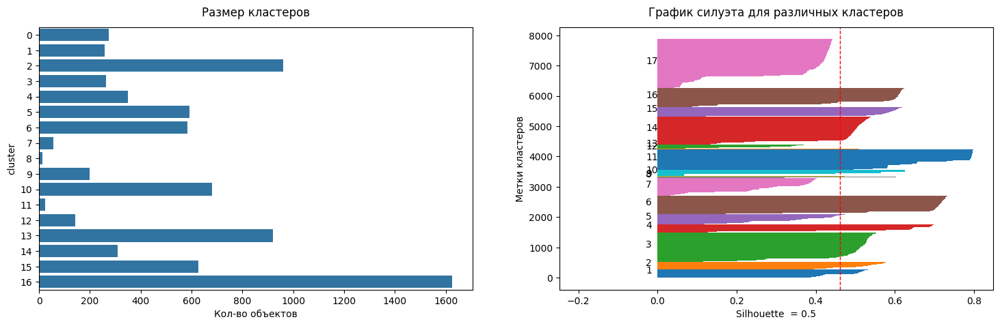

18 clusters
----------------------------------------------------------------------------------------------------


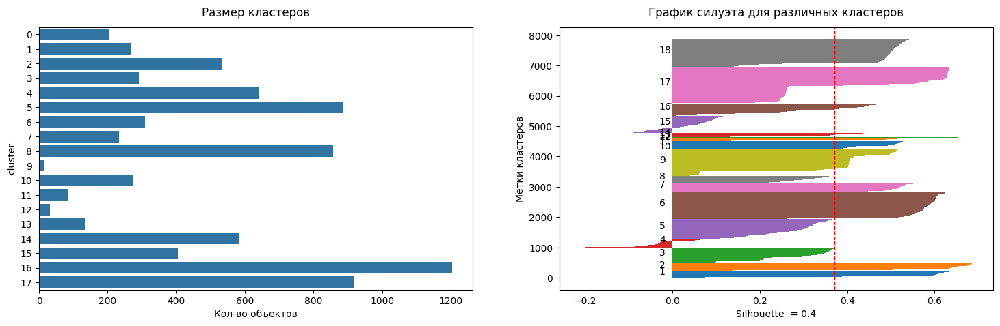

19 clusters
----------------------------------------------------------------------------------------------------


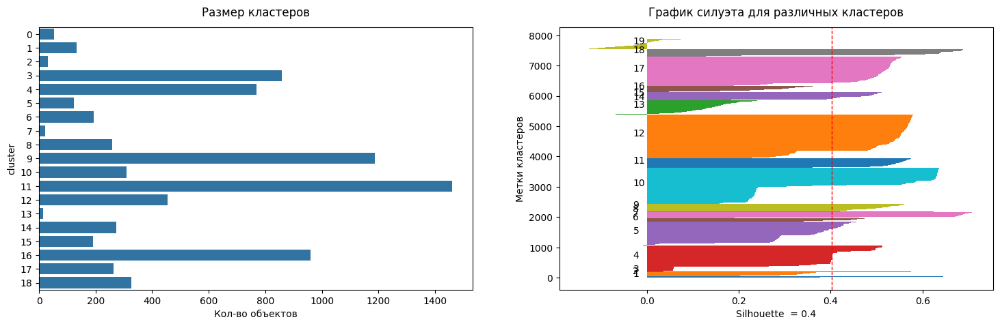

20 clusters
----------------------------------------------------------------------------------------------------


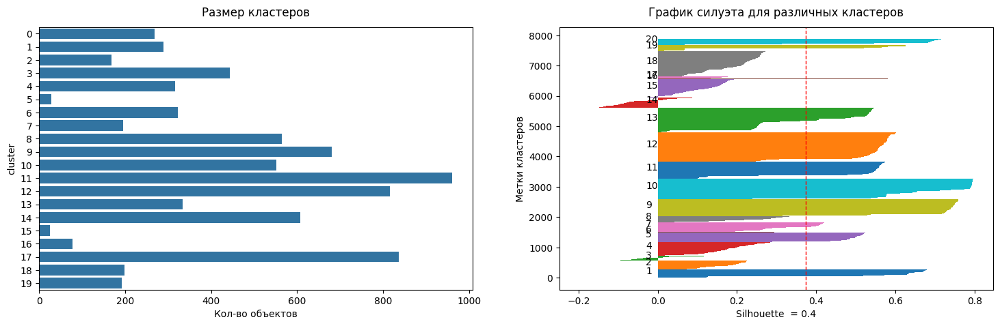

21 clusters
----------------------------------------------------------------------------------------------------


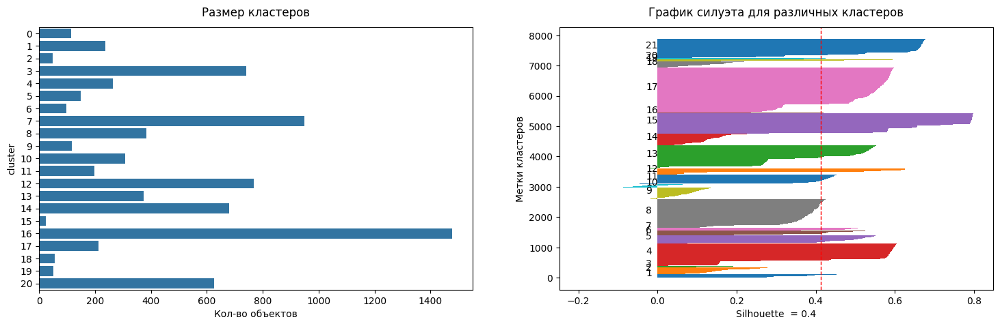

22 clusters
----------------------------------------------------------------------------------------------------


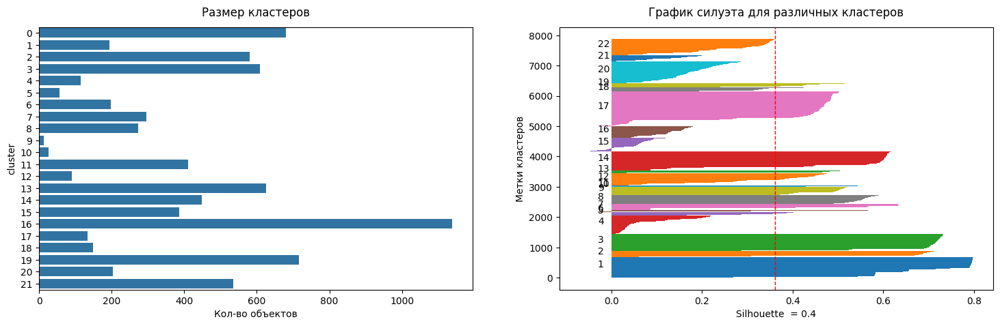

23 clusters
----------------------------------------------------------------------------------------------------


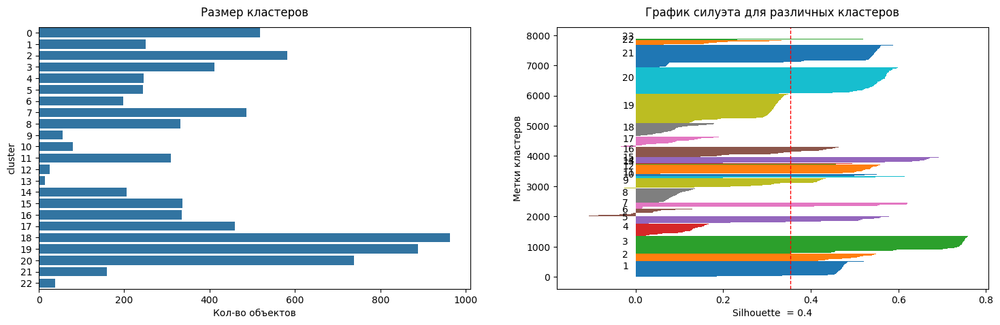

24 clusters
----------------------------------------------------------------------------------------------------


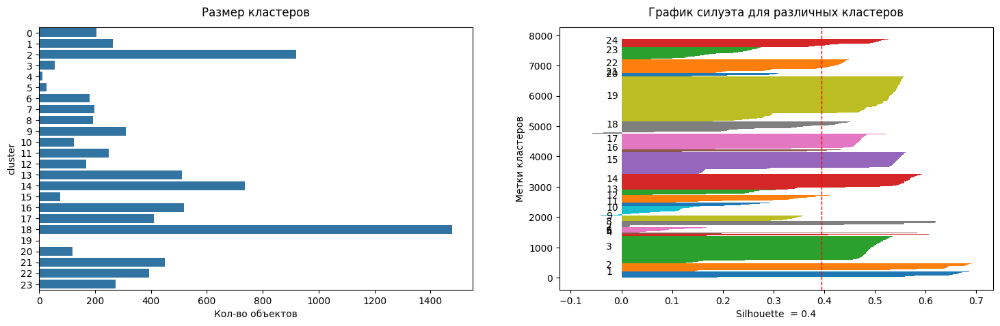

25 clusters
----------------------------------------------------------------------------------------------------


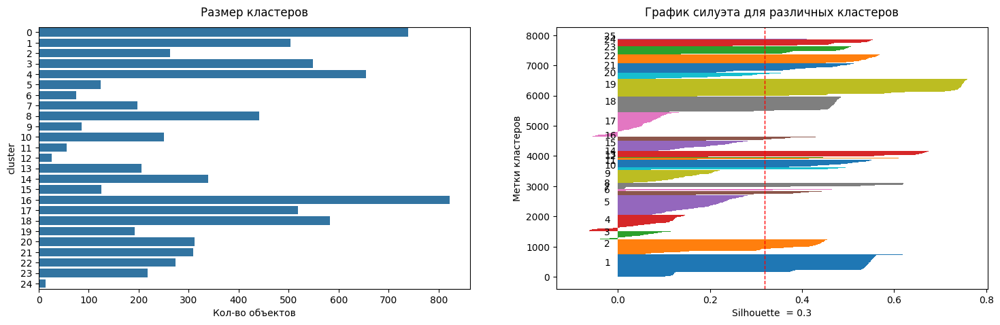

26 clusters
----------------------------------------------------------------------------------------------------


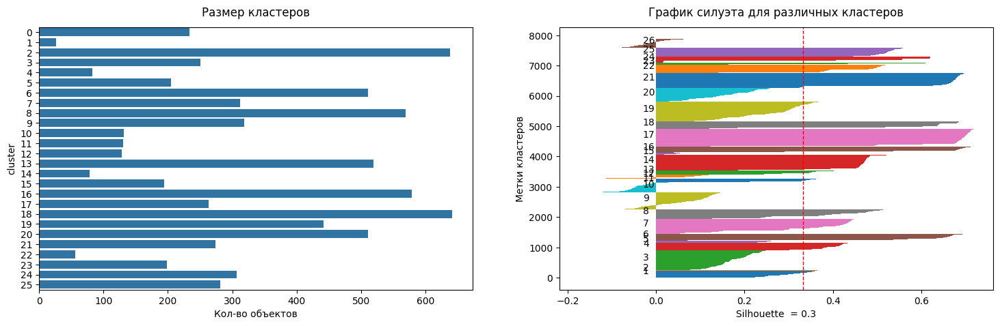

27 clusters
----------------------------------------------------------------------------------------------------


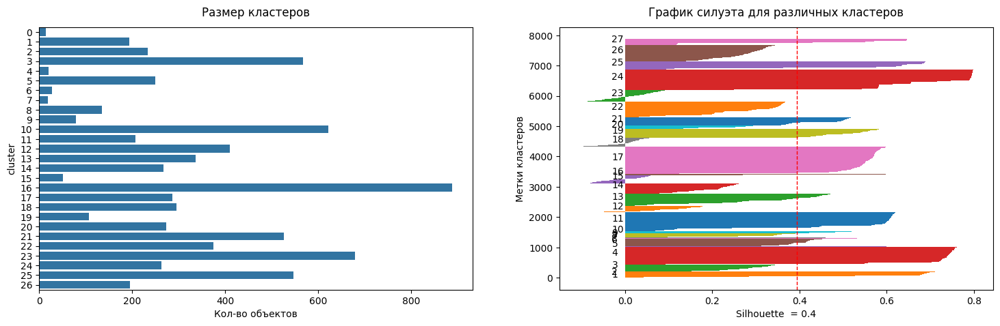

28 clusters
----------------------------------------------------------------------------------------------------


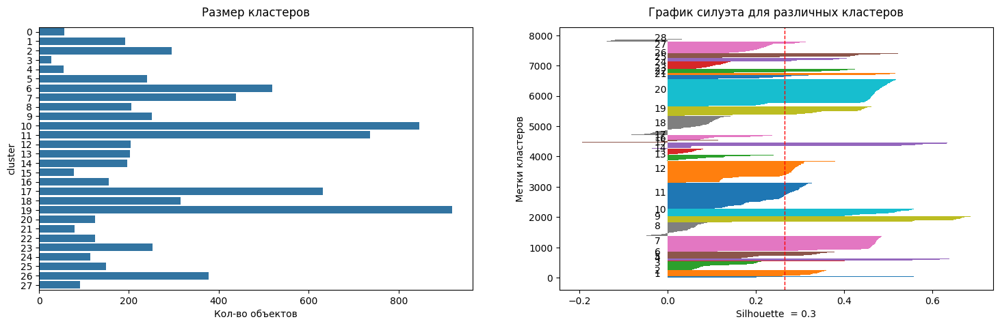

29 clusters
----------------------------------------------------------------------------------------------------


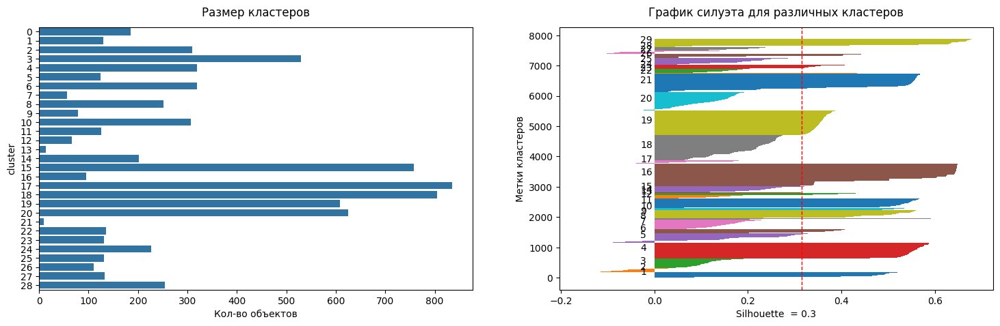

30 clusters
----------------------------------------------------------------------------------------------------


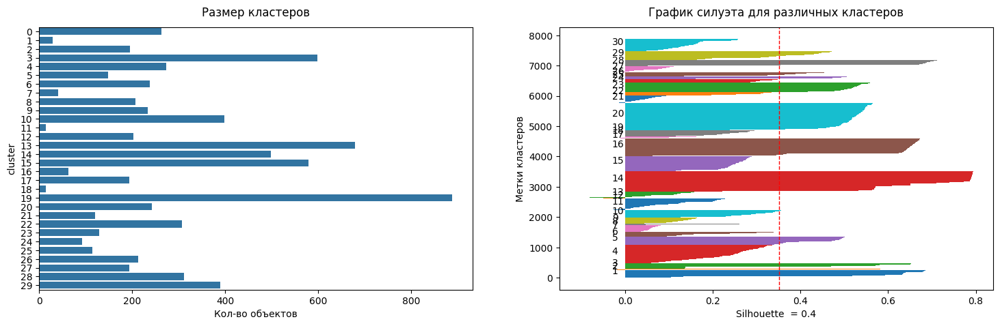

31 clusters
----------------------------------------------------------------------------------------------------


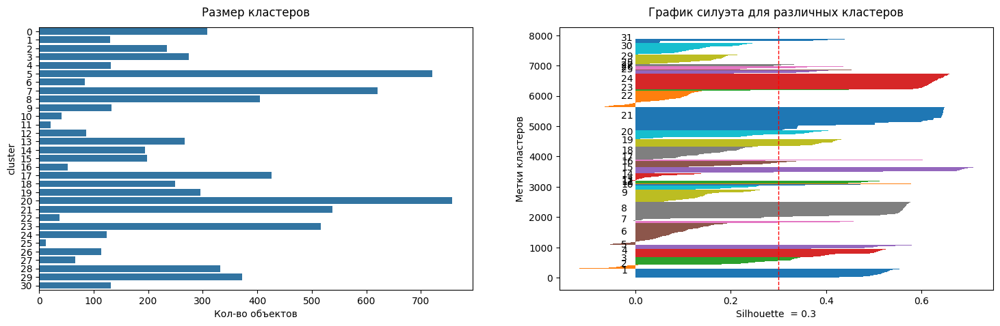

32 clusters
----------------------------------------------------------------------------------------------------


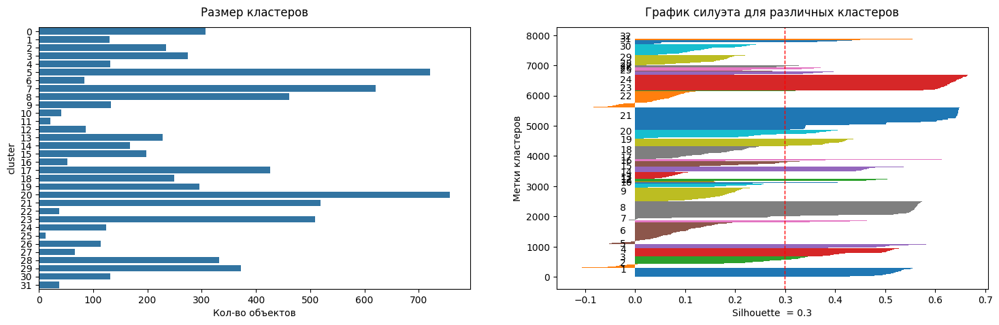

33 clusters
----------------------------------------------------------------------------------------------------


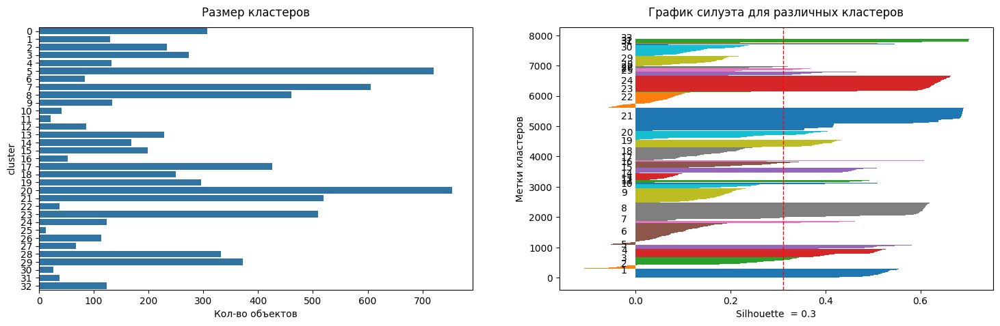

34 clusters
----------------------------------------------------------------------------------------------------


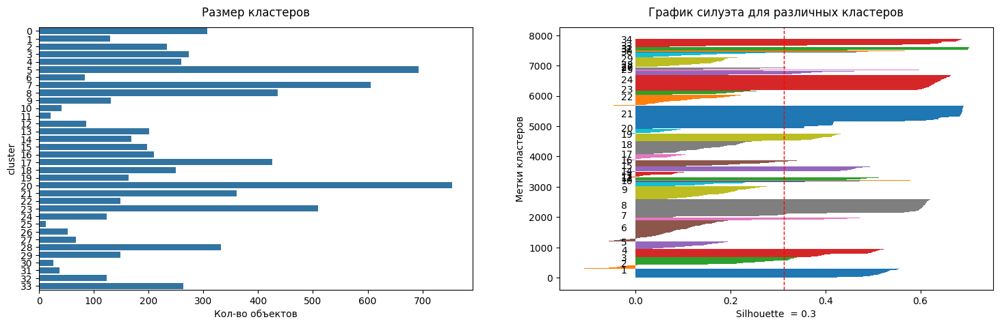

35 clusters
----------------------------------------------------------------------------------------------------


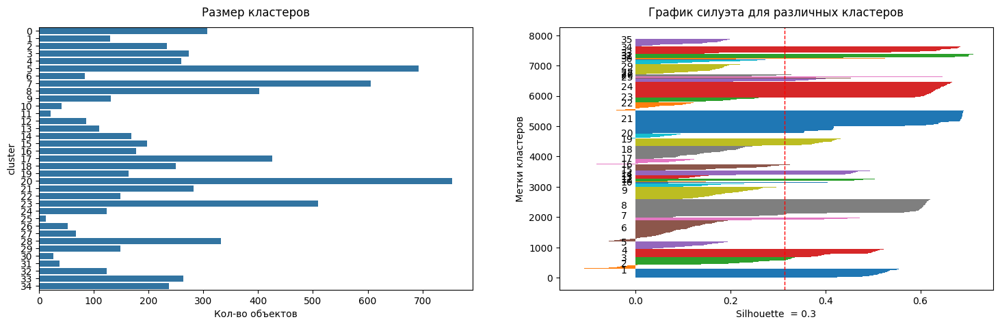

36 clusters
----------------------------------------------------------------------------------------------------


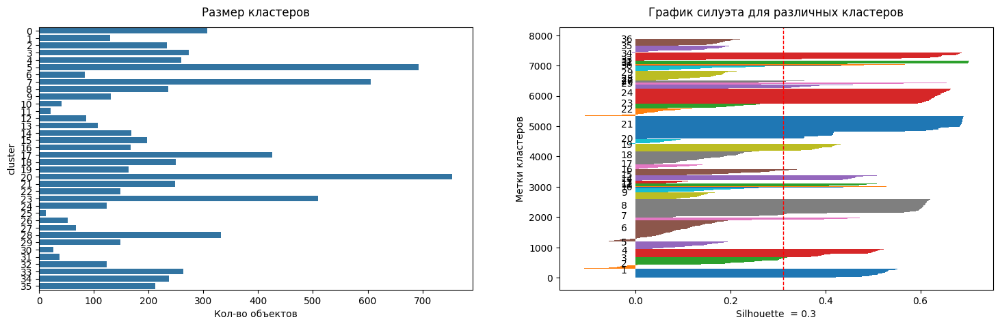

37 clusters
----------------------------------------------------------------------------------------------------


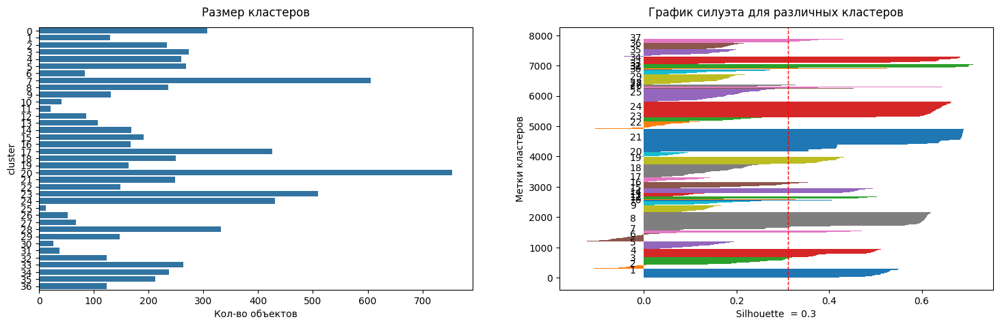

38 clusters
----------------------------------------------------------------------------------------------------


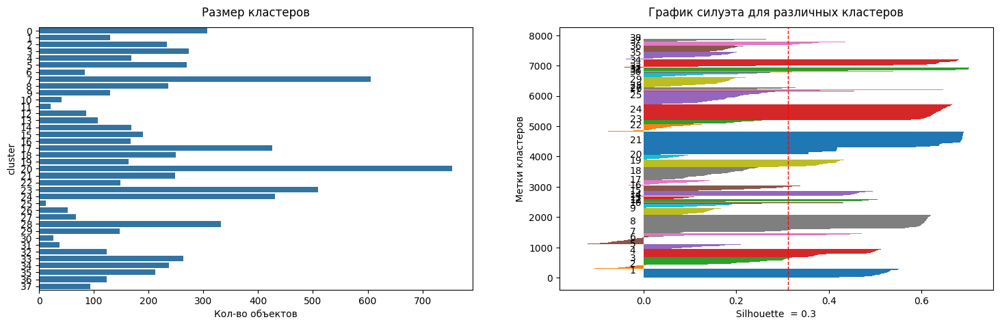

39 clusters
----------------------------------------------------------------------------------------------------


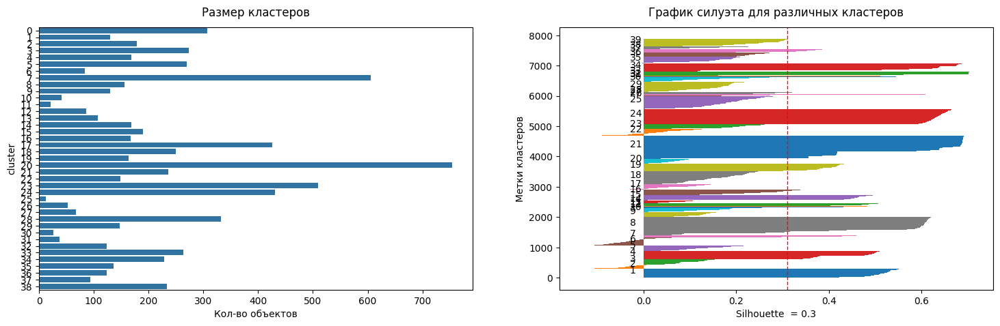

40 clusters
----------------------------------------------------------------------------------------------------


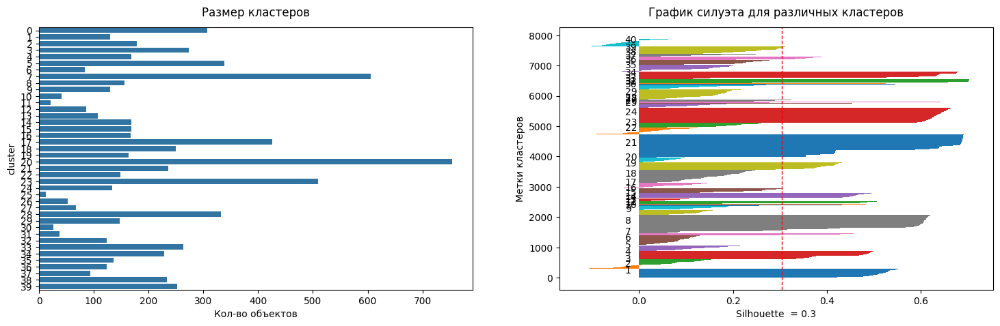

41 clusters
----------------------------------------------------------------------------------------------------


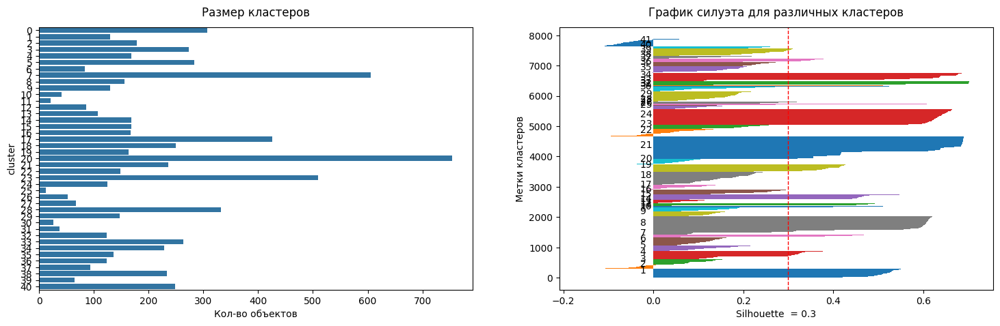

42 clusters
----------------------------------------------------------------------------------------------------


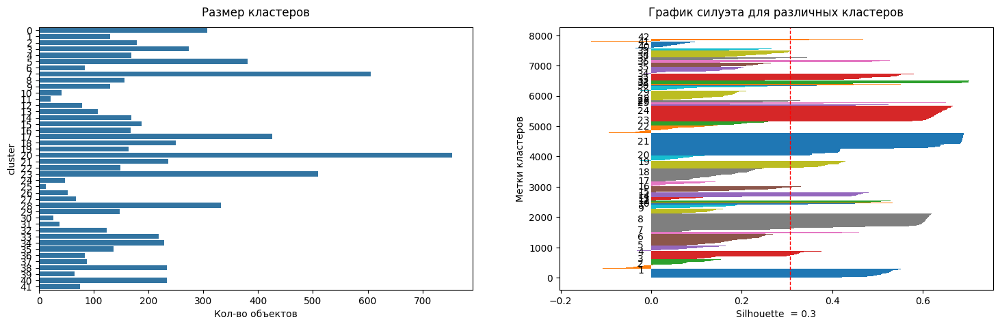

43 clusters
----------------------------------------------------------------------------------------------------


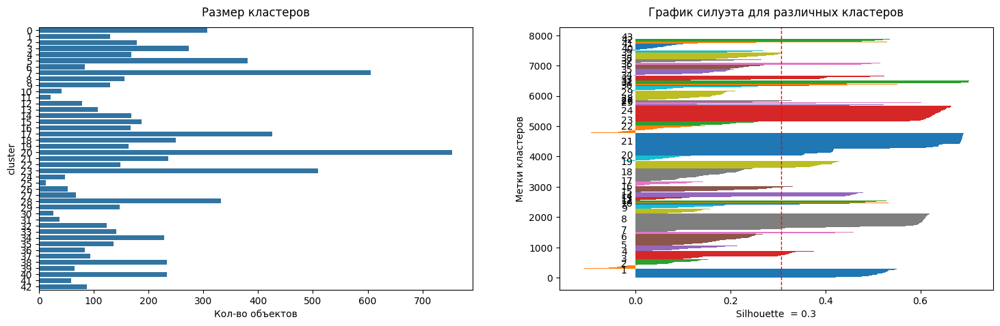

44 clusters
----------------------------------------------------------------------------------------------------


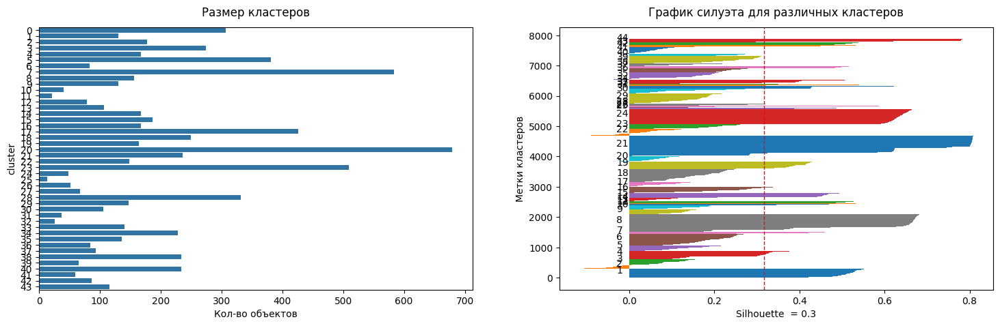

45 clusters
----------------------------------------------------------------------------------------------------


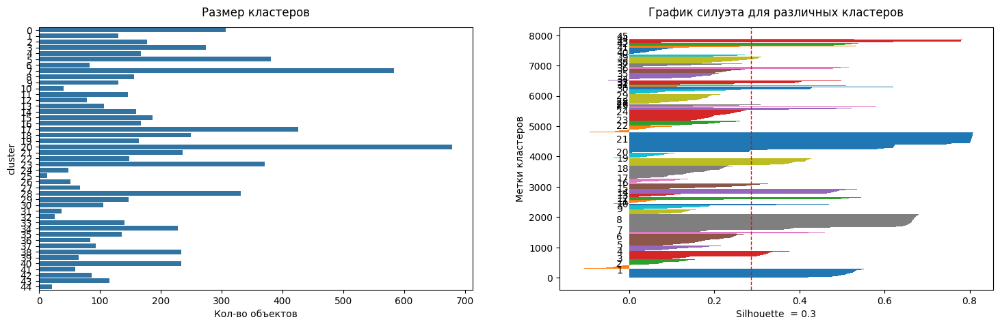

46 clusters
----------------------------------------------------------------------------------------------------


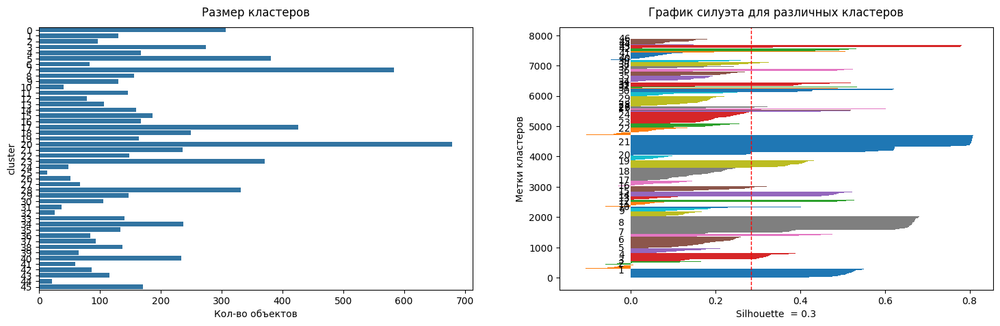

47 clusters
----------------------------------------------------------------------------------------------------


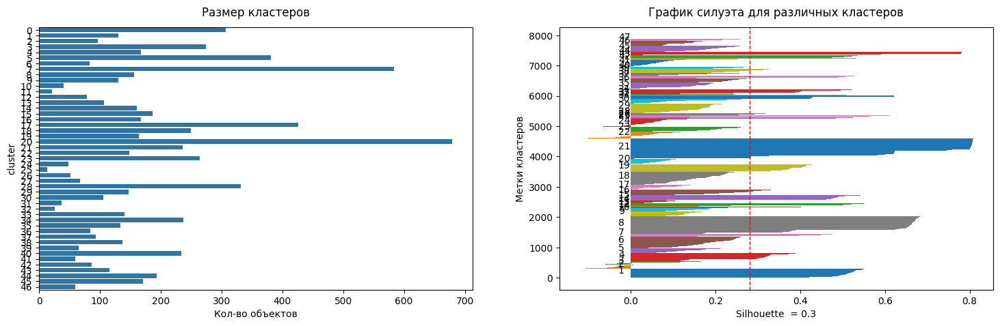

48 clusters
----------------------------------------------------------------------------------------------------


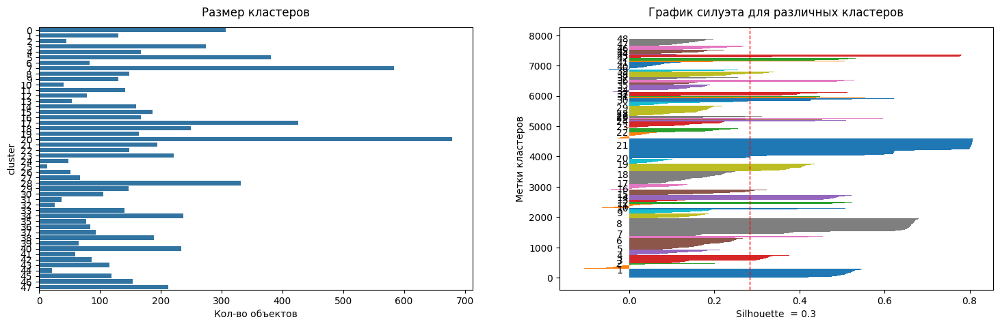

49 clusters
----------------------------------------------------------------------------------------------------


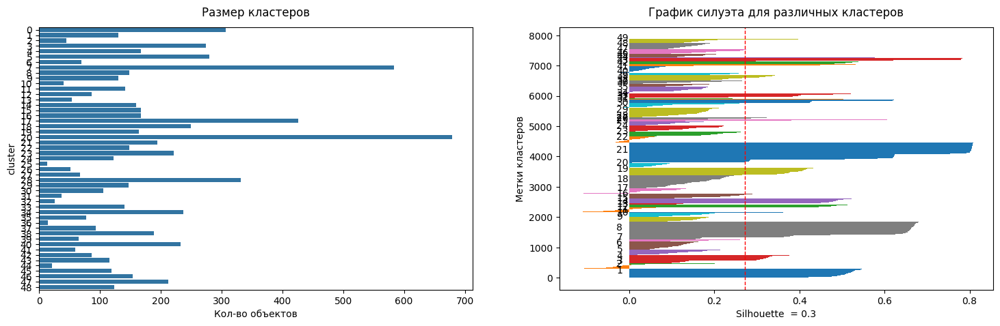

50 clusters
----------------------------------------------------------------------------------------------------


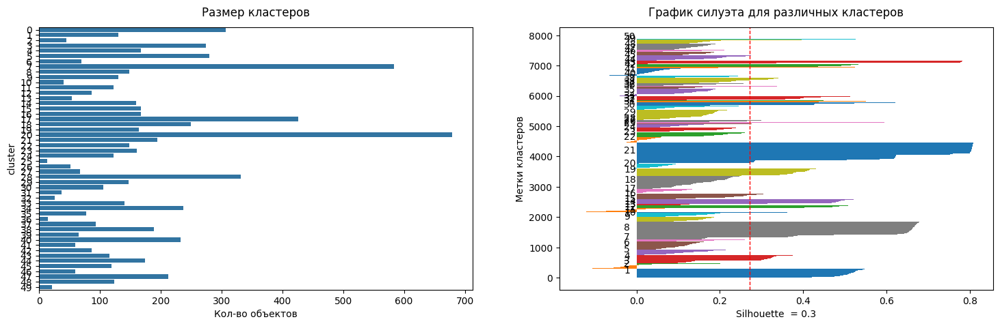

51 clusters
----------------------------------------------------------------------------------------------------


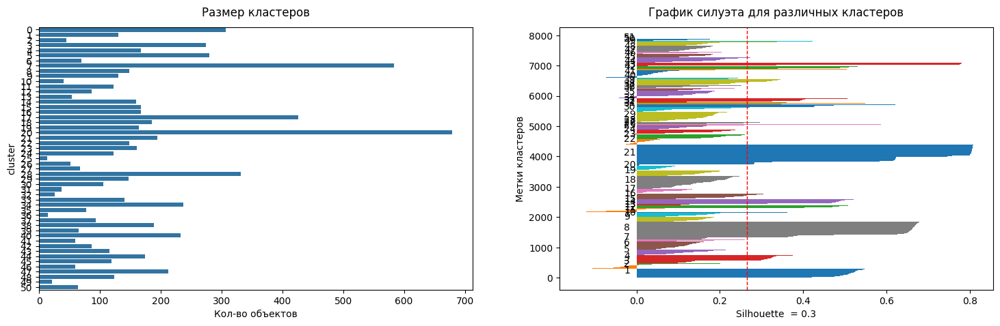

52 clusters
----------------------------------------------------------------------------------------------------


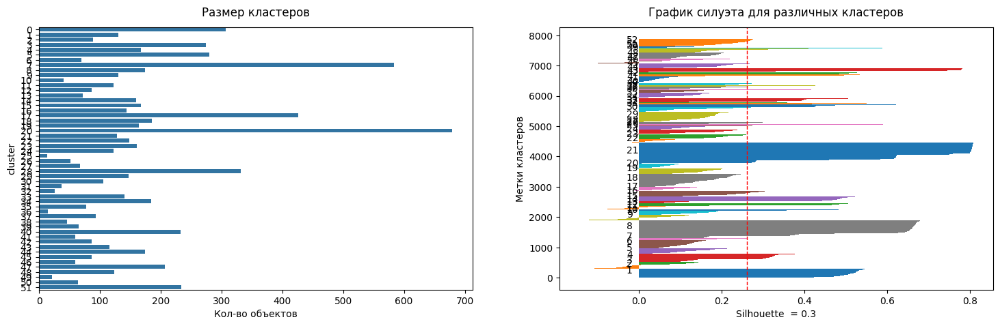

53 clusters
----------------------------------------------------------------------------------------------------


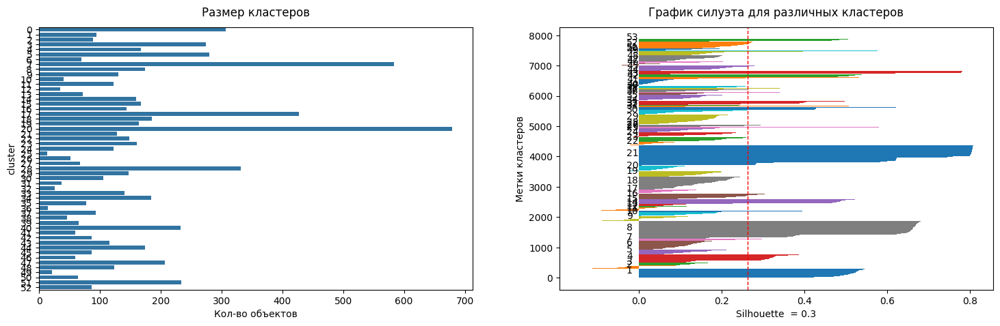

54 clusters
----------------------------------------------------------------------------------------------------


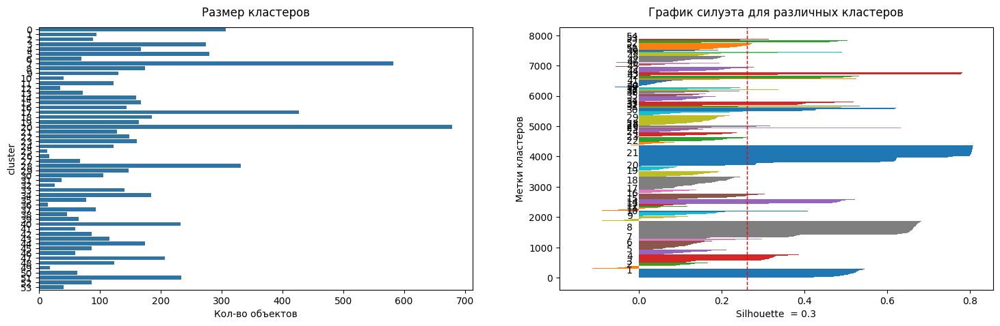

55 clusters
----------------------------------------------------------------------------------------------------


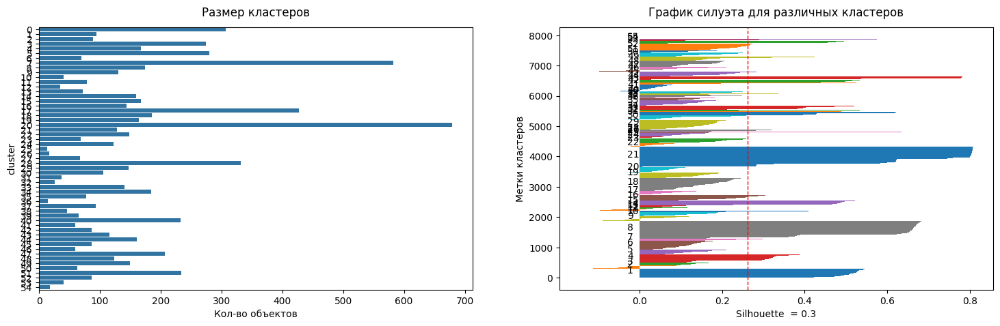

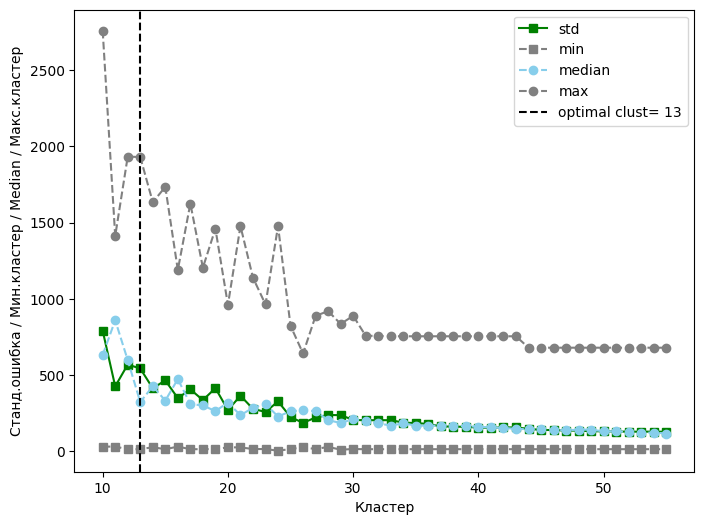

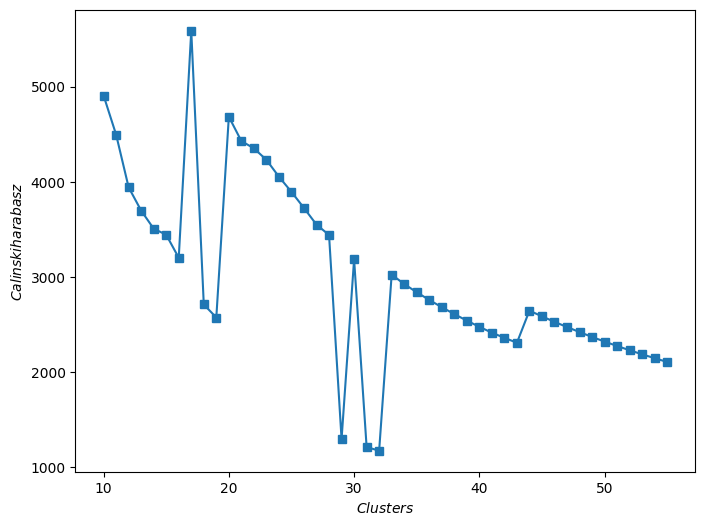

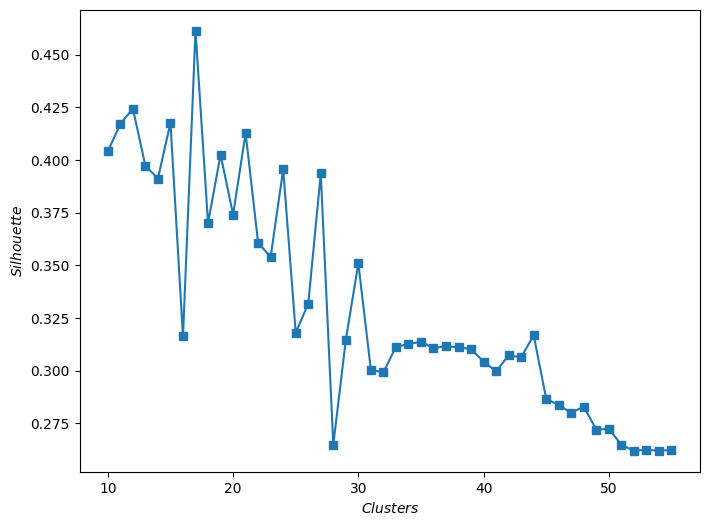

In [139]:
# подберем оптимальное количество кластеров
clust_faiss_tf = clustering_analysis(data=df_tfidf_labels,
                                           data_scale=df_scaled_tf,
                                           embedding=X_embedding_umap_tf,
                                           model=faiss.IndexFlatL2,
                                           kwargs=params_cluster['IndexFlatL2'],
                                           min_size=10,
                                           max_size=55,
                                           type_train=None)

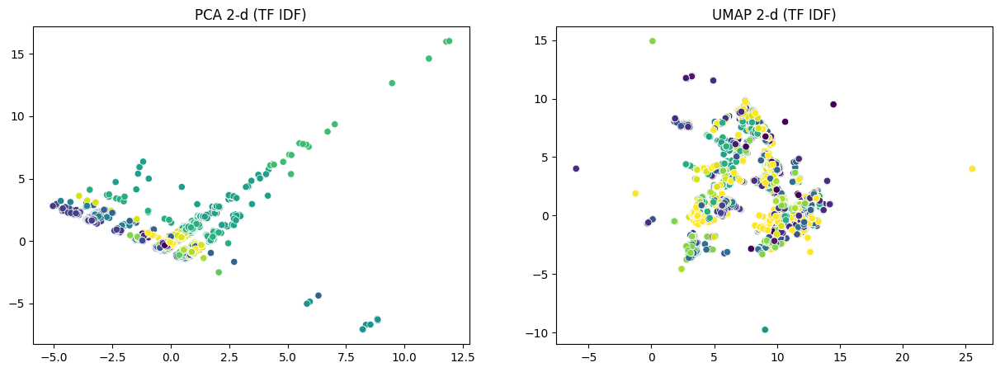

In [140]:
# посмотрим распределение кластеров на графике
clusters_visual(clusters=clust_faiss_tf[17], 
                X_embedding_pca=X_embedding_pca_tf,
                X_embedding_umap=X_embedding_umap_tf, 
                name='TF IDF')

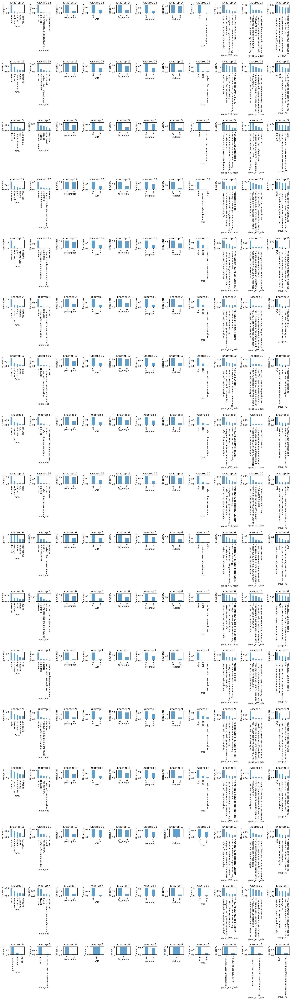

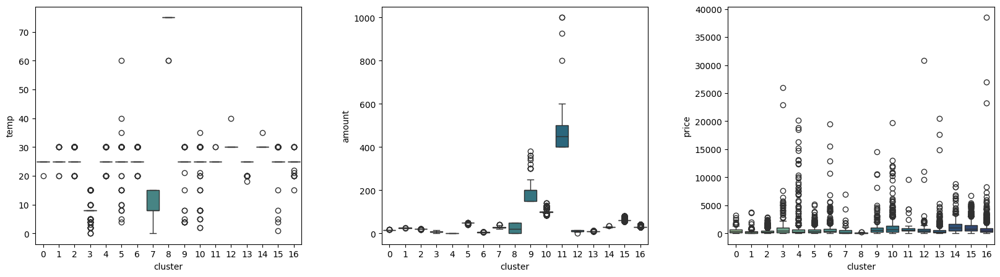

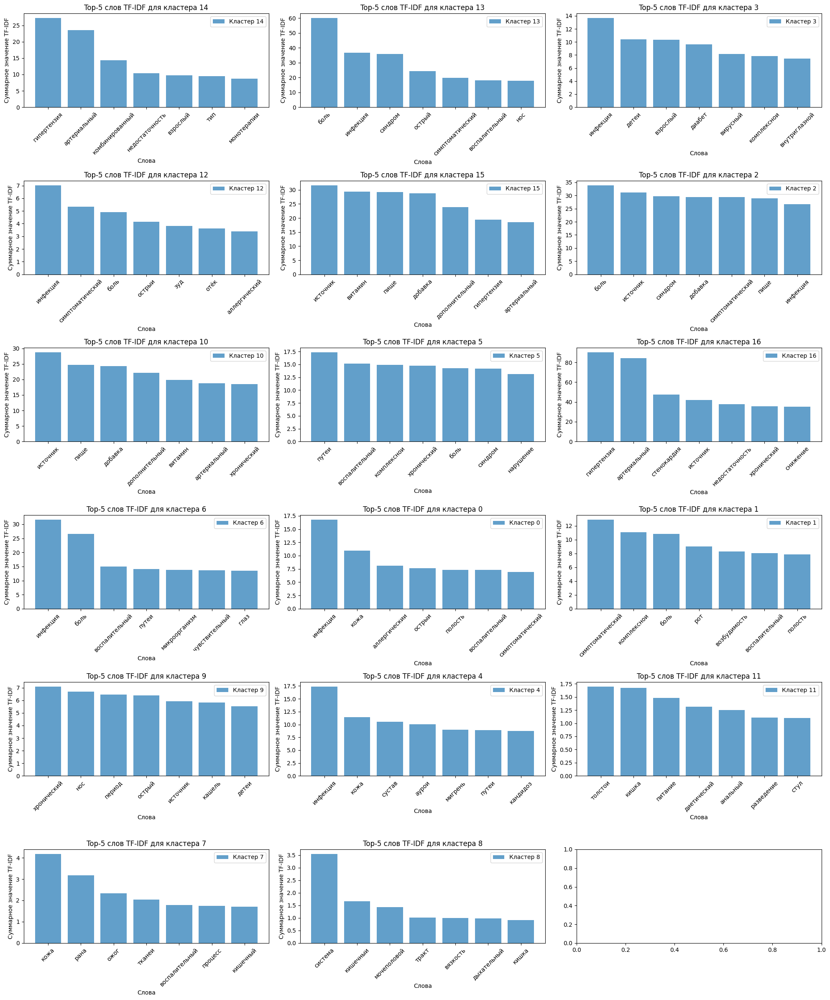

In [141]:
# оценим кластеры
plot_object_features(df, clust_faiss_tf[17], obj_and_bin_cols)
plot_num_features(df, clust_faiss_tf[17], num_cols)
plot_text_features(df_tfidf_labels, clust_faiss_tf[17], tfidf_cols)

**Описание**


- **0 кластер** -  ЛП для приема внутрь и наружно, чаще без рецепта, дерматологические. Группа "Помощь коже"

- **1 кластер** - жидкие и твердые ЛП для приема внутрь и наружно для лечения горла. Группа "Помощь горлу"

- **2 кластер** - средства для приема внутрь (таблетки и раст сборы), чаще без рецепта, отечественные, подходят детям, цена до 5000. Группа "Решение до 5000"

- **3 кластер** - инъекционные и наружные ЛП, чаще рецептурные, отечественного производтсва, подходят детям и взрослым, для лецения инфекций. Группа "Против инфекций"

- **4 кластер** - внутренние средства разных форм, чаще без рецепта, для борьбы с инфекцией. Группа "Системные инфекции"

- **5 кластер** - сресдтва для приема внутрь и наружно (таблетки и раст сырье), чаще без рецепта, отечественные, подходят детям. Группа "Помощь организму" 

- **6 кластер** - ЛП, чаще по рецепту, для приема внутрь и парентерально. Группа "Для органов чувств"

- **7 кластер** - ЛП для наружного применения (мази чаще), отечественные, без рецепта, подходят детям, для лечения заболеваний кожи. Группа "Лечение кожных заболеваний"

- **8 кластер** - препараты растительного происхождения отечественного производства для взрослых и детей. Группа "Растительное производство"

- **9 кластер** - жидкие лекарства для приема внутрь, чаще без рецепта, пододят детям, при кашле. Группа "При кашле"

- **10 кластер** - средства для приема внутрь, по рецепту и без, отеч и ин производства, подходит детям, витамины и добавки для помощи сердцу. Группа "Помощь сердцу"

- **11 кластер** - лекарства и БАД, чаще без рецепта, подходят детям и беременным (в большем случае), для кишечника. Группа "Для помощи кишечнику" 

- **12 кластер** - ЛП для приема внутрь, по рецепту и без, чаще ин производства, подходят детям, при аллергии. Группа "При аллергии"

- **13 кластер** - ЛП для приема внутрь, по рецепту и без, для лечения боли. Группа "При боли"

- **14 кластер** - рецептурные ЛП для серднечно-сосудистой системы, чаще ин производства. Группа "Лечение сердечных болезней"

- **15 кластер** - средства для приема внутрь, по рецепту и без, подходят детям, витамины. Группа "Витамины"

- **16 кластер** - ЛП (чаще рецептурные) и БАД, применяемые при сердечных заболеваниях. Группа "ЛП и БАД на страже вашего сердца"

### BERT

#### С числовыми данными

10 clusters
----------------------------------------------------------------------------------------------------


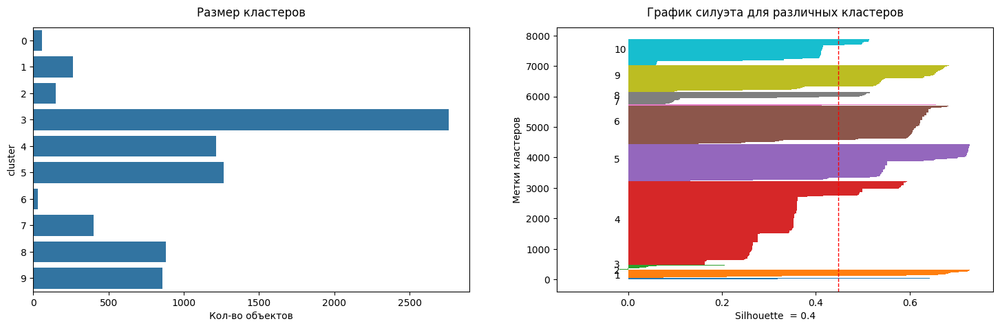

11 clusters
----------------------------------------------------------------------------------------------------


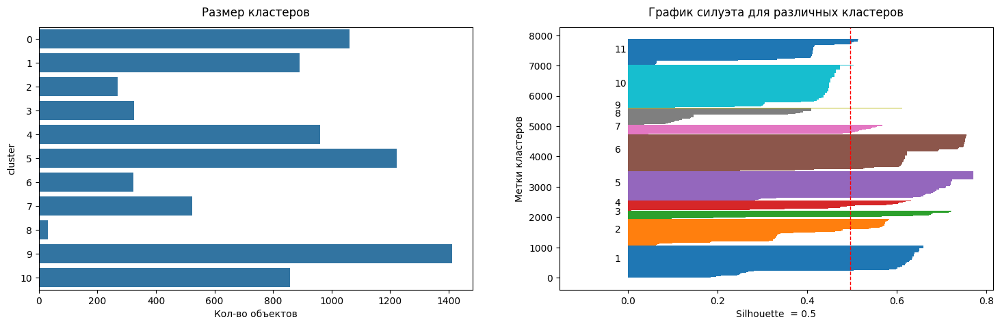

12 clusters
----------------------------------------------------------------------------------------------------


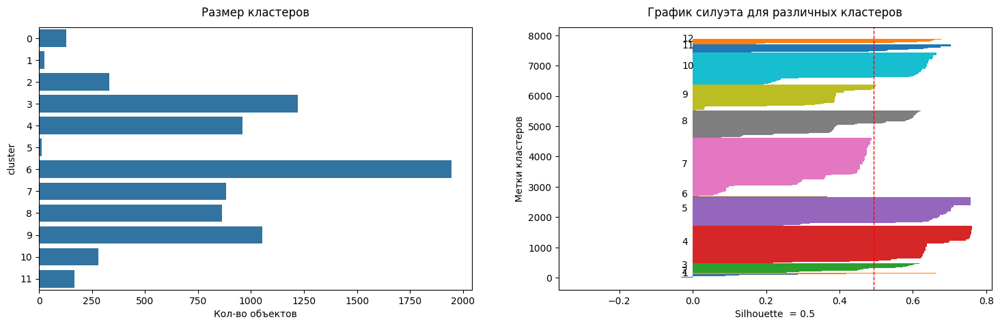

13 clusters
----------------------------------------------------------------------------------------------------


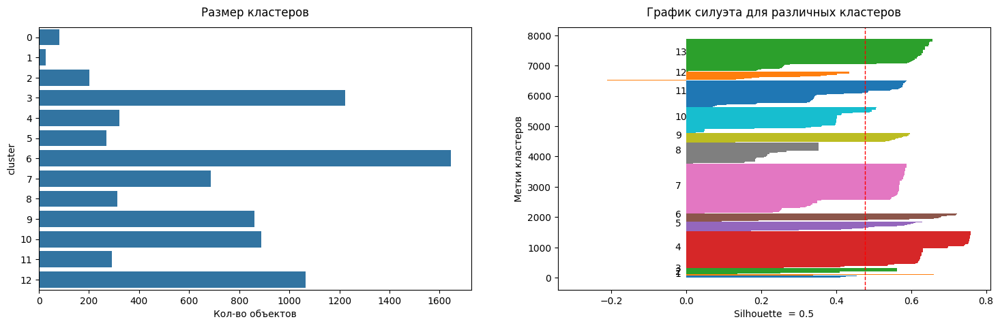

14 clusters
----------------------------------------------------------------------------------------------------


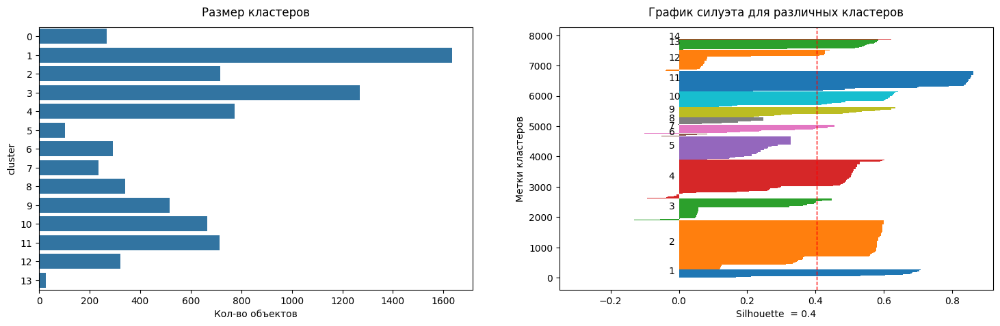

15 clusters
----------------------------------------------------------------------------------------------------


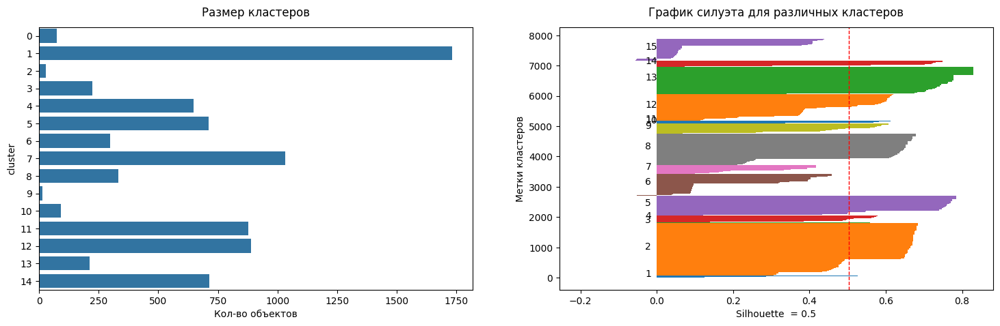

16 clusters
----------------------------------------------------------------------------------------------------


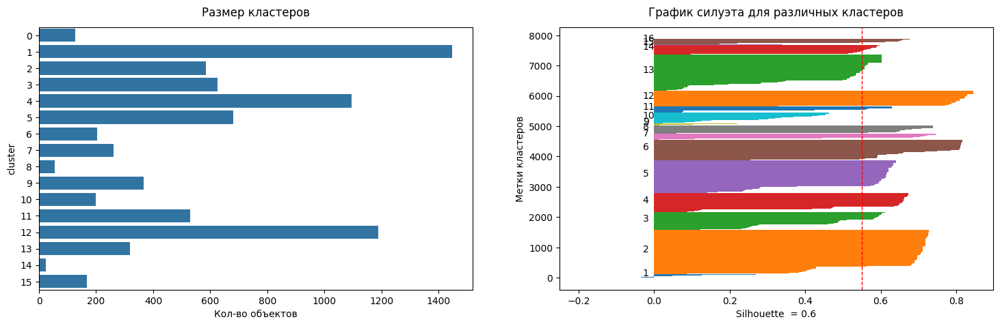

17 clusters
----------------------------------------------------------------------------------------------------


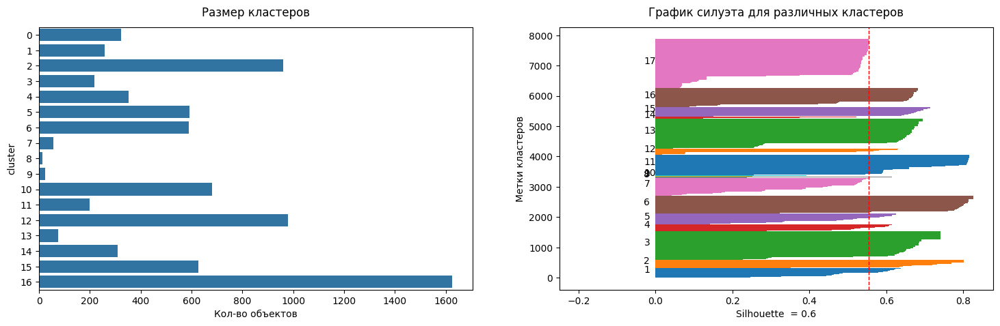

18 clusters
----------------------------------------------------------------------------------------------------


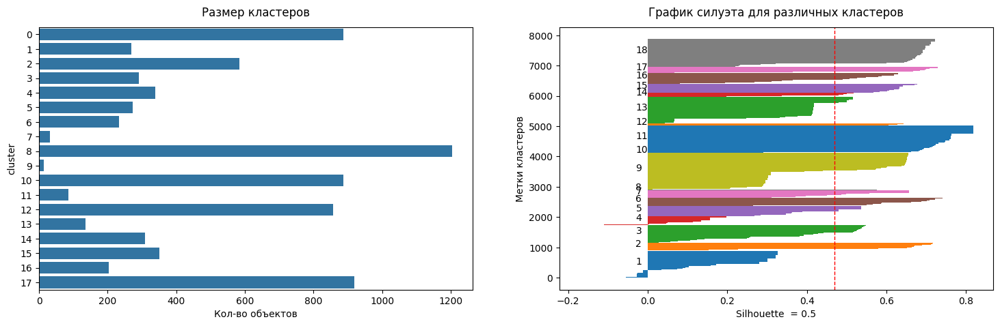

19 clusters
----------------------------------------------------------------------------------------------------


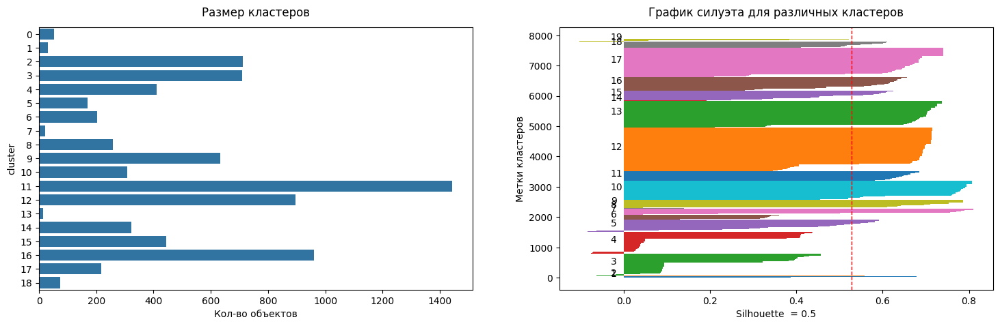

20 clusters
----------------------------------------------------------------------------------------------------


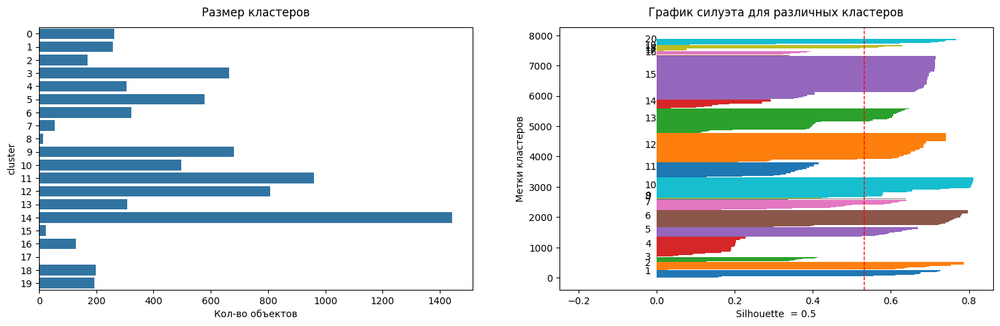

21 clusters
----------------------------------------------------------------------------------------------------


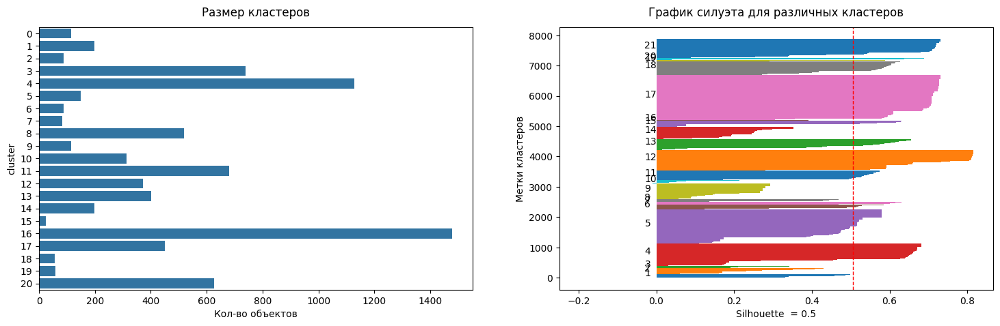

22 clusters
----------------------------------------------------------------------------------------------------


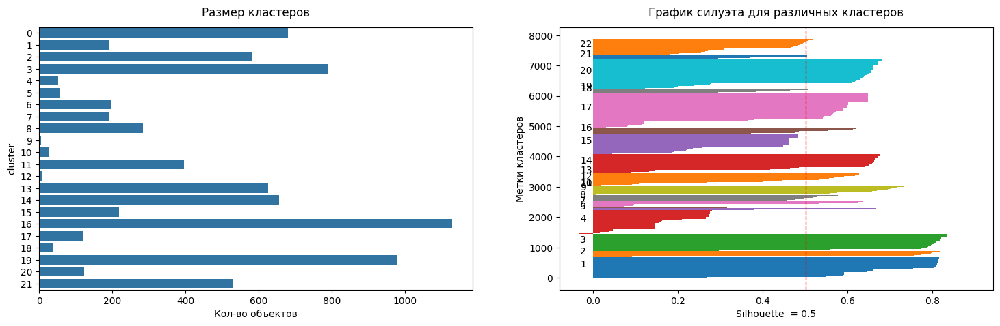

23 clusters
----------------------------------------------------------------------------------------------------


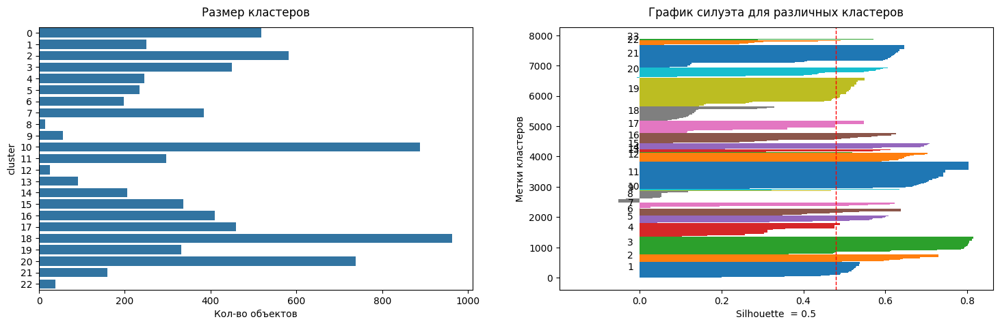

24 clusters
----------------------------------------------------------------------------------------------------


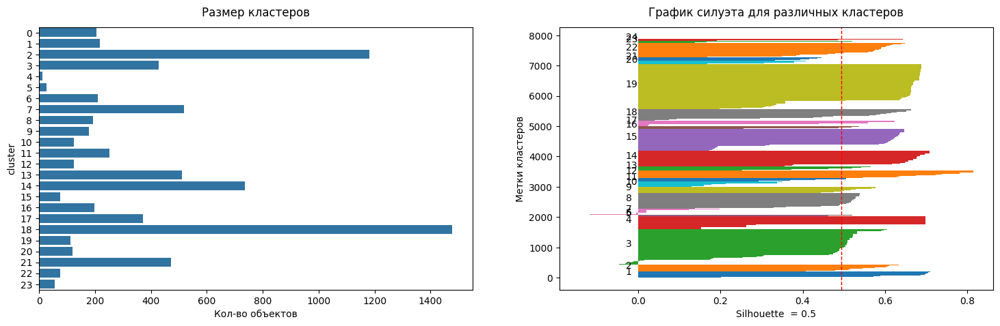

25 clusters
----------------------------------------------------------------------------------------------------


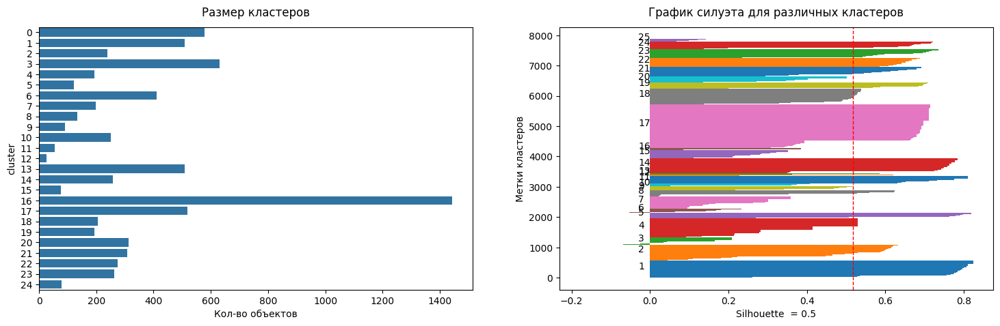

26 clusters
----------------------------------------------------------------------------------------------------


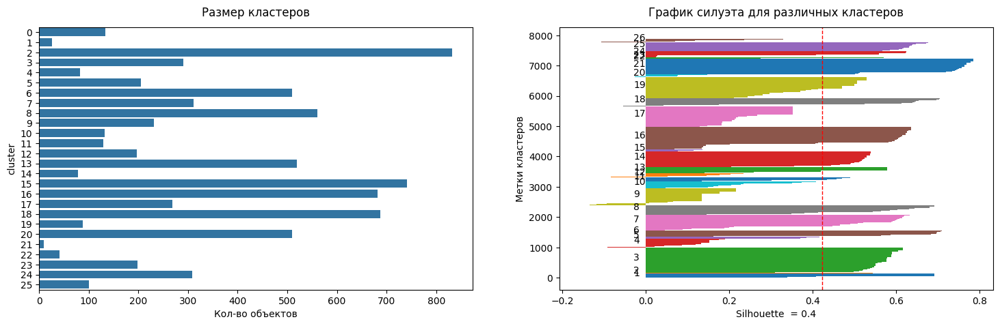

27 clusters
----------------------------------------------------------------------------------------------------


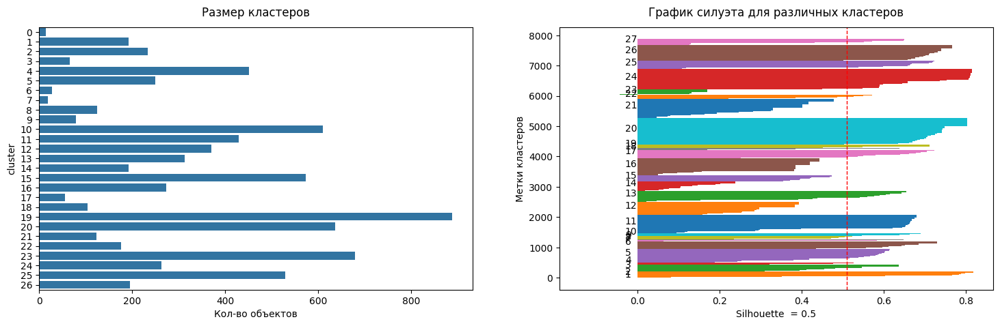

28 clusters
----------------------------------------------------------------------------------------------------


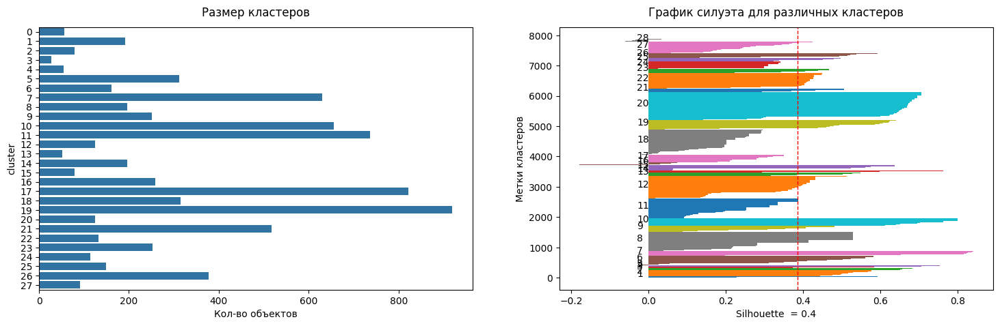

29 clusters
----------------------------------------------------------------------------------------------------


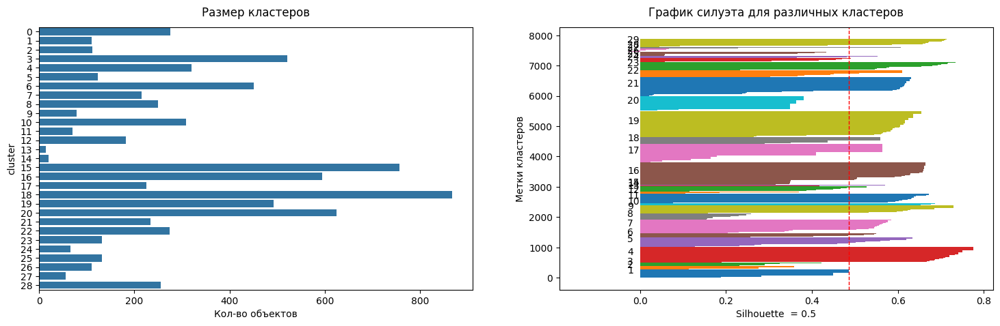

30 clusters
----------------------------------------------------------------------------------------------------


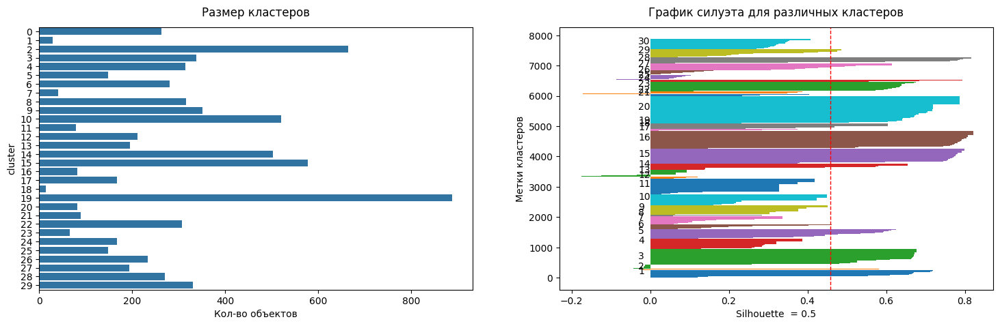

31 clusters
----------------------------------------------------------------------------------------------------


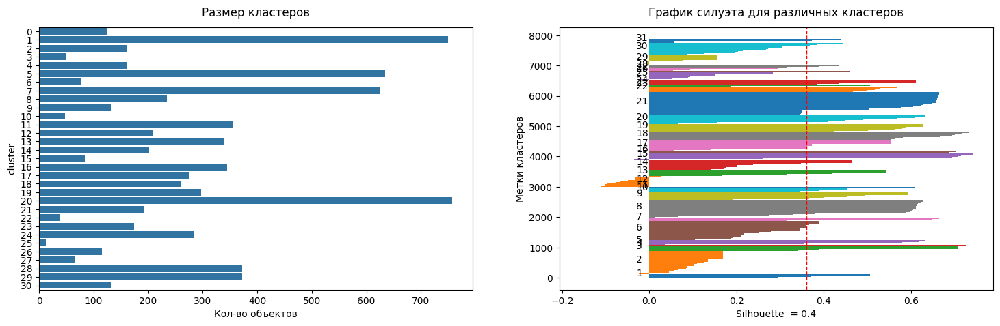

32 clusters
----------------------------------------------------------------------------------------------------


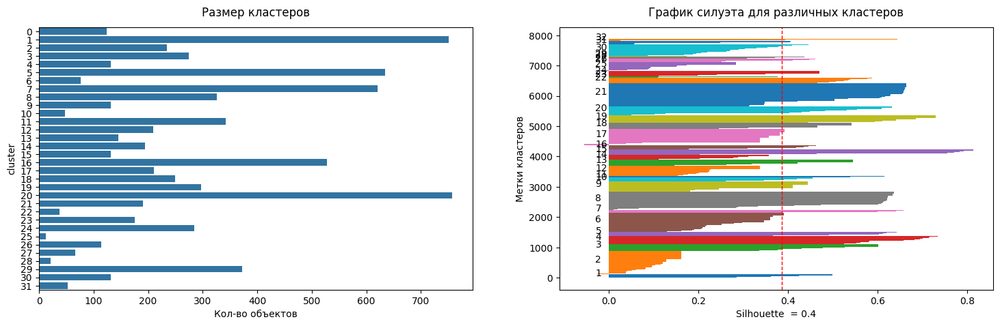

33 clusters
----------------------------------------------------------------------------------------------------


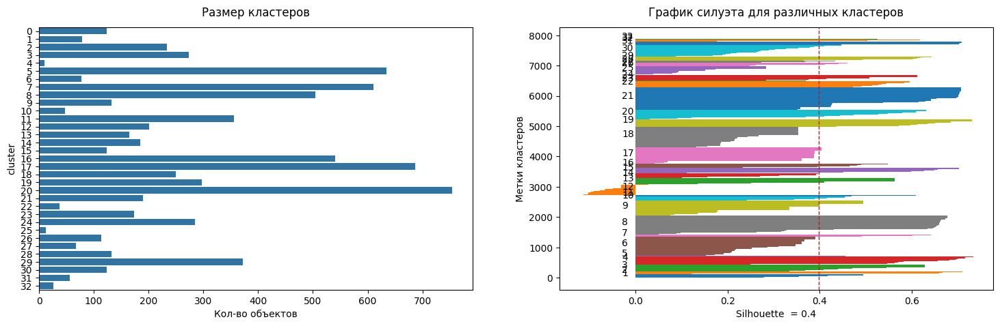

34 clusters
----------------------------------------------------------------------------------------------------


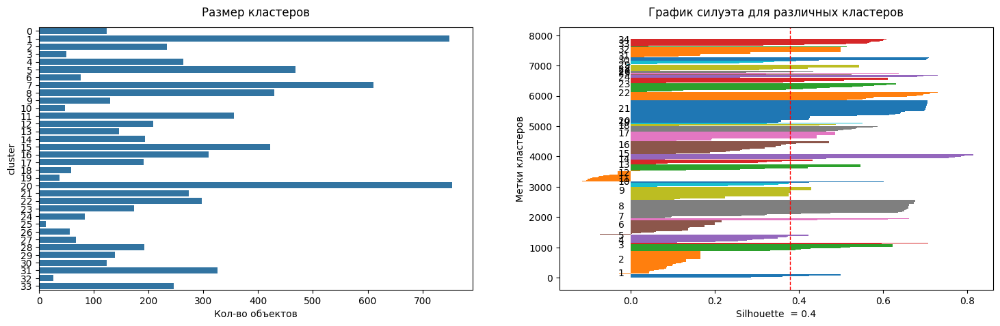

35 clusters
----------------------------------------------------------------------------------------------------


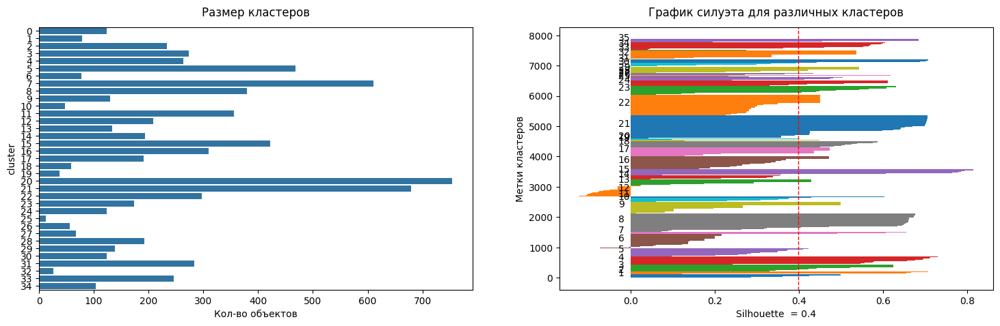

36 clusters
----------------------------------------------------------------------------------------------------


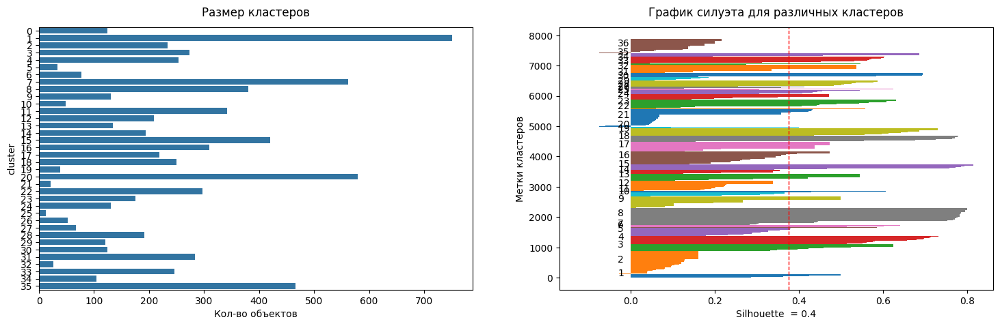

37 clusters
----------------------------------------------------------------------------------------------------


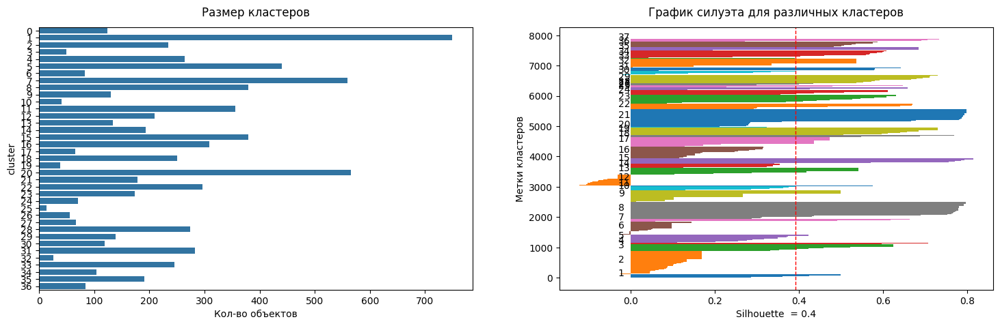

38 clusters
----------------------------------------------------------------------------------------------------


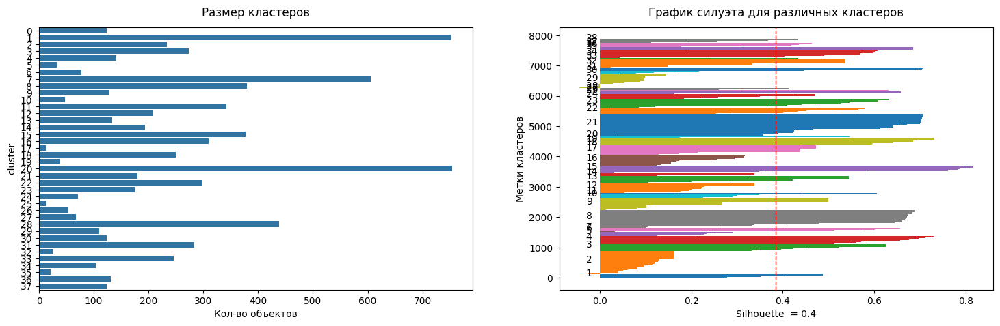

39 clusters
----------------------------------------------------------------------------------------------------


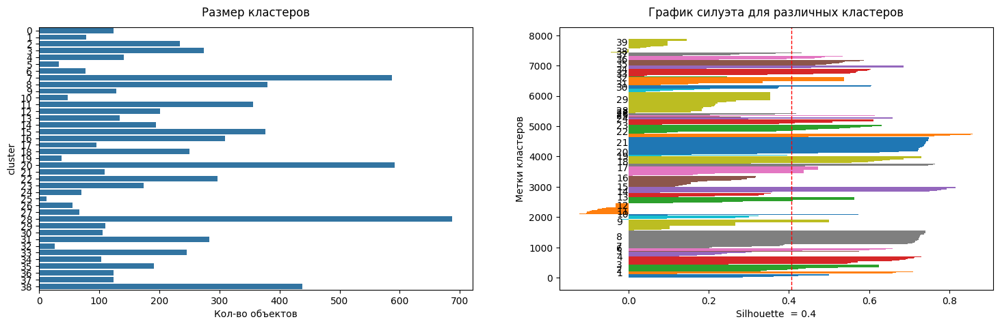

40 clusters
----------------------------------------------------------------------------------------------------


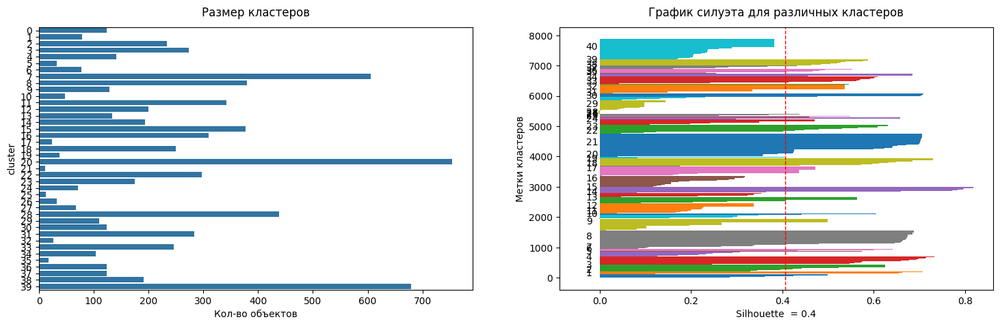

41 clusters
----------------------------------------------------------------------------------------------------


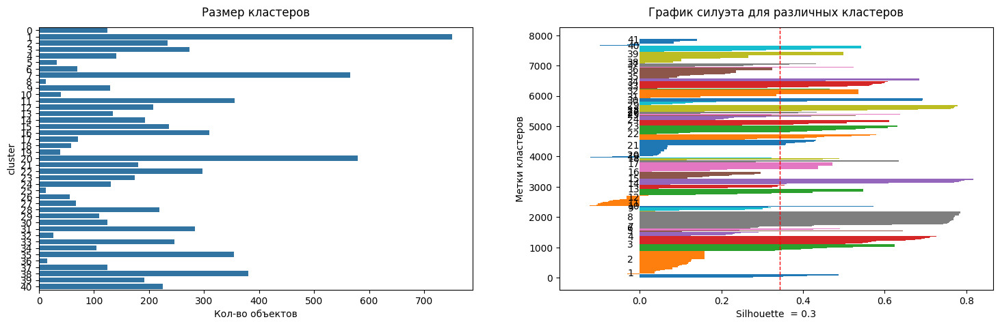

42 clusters
----------------------------------------------------------------------------------------------------


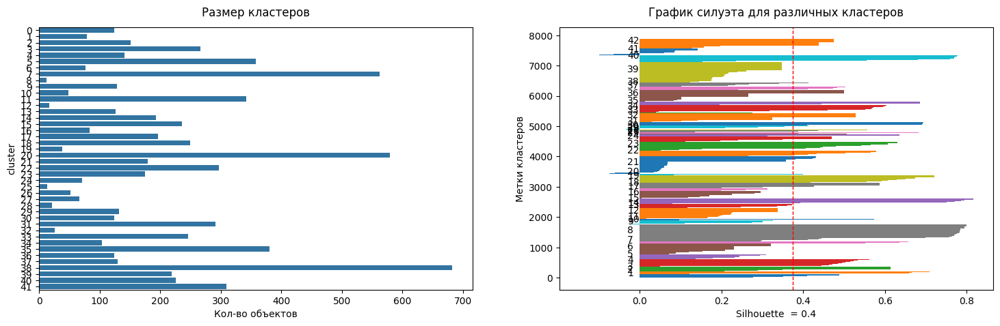

43 clusters
----------------------------------------------------------------------------------------------------


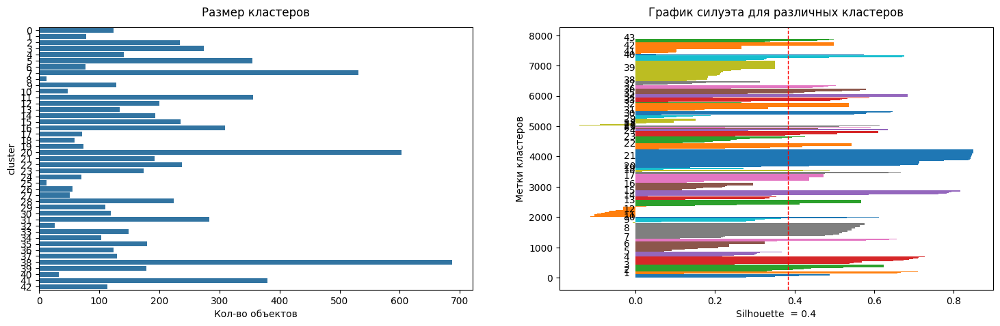

44 clusters
----------------------------------------------------------------------------------------------------


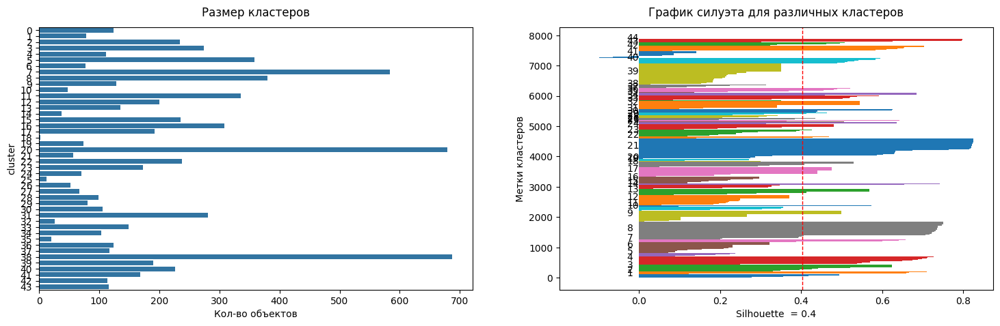

45 clusters
----------------------------------------------------------------------------------------------------


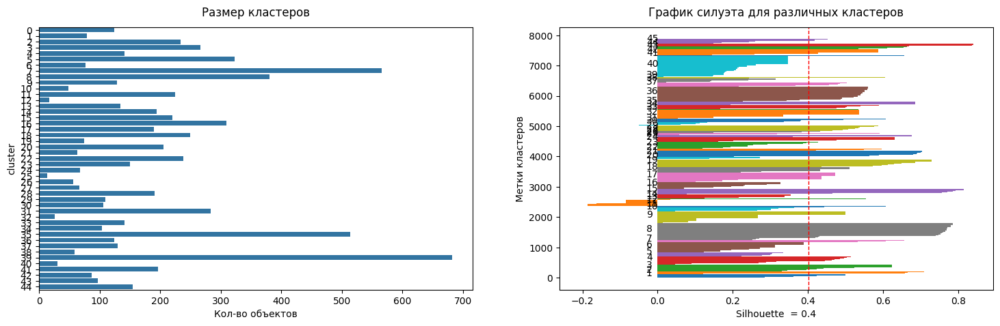

46 clusters
----------------------------------------------------------------------------------------------------


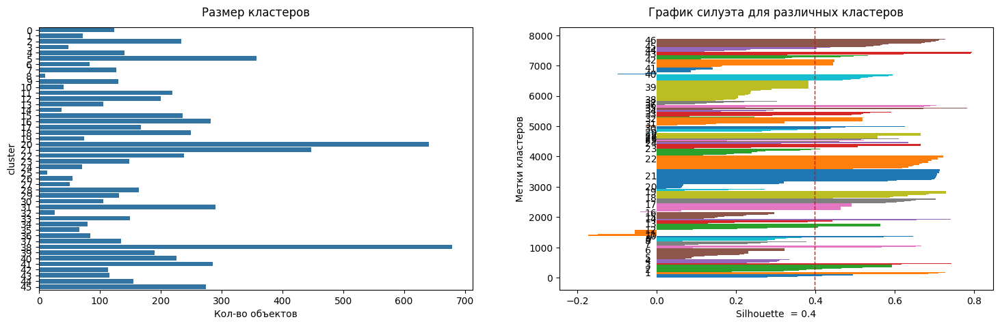

47 clusters
----------------------------------------------------------------------------------------------------


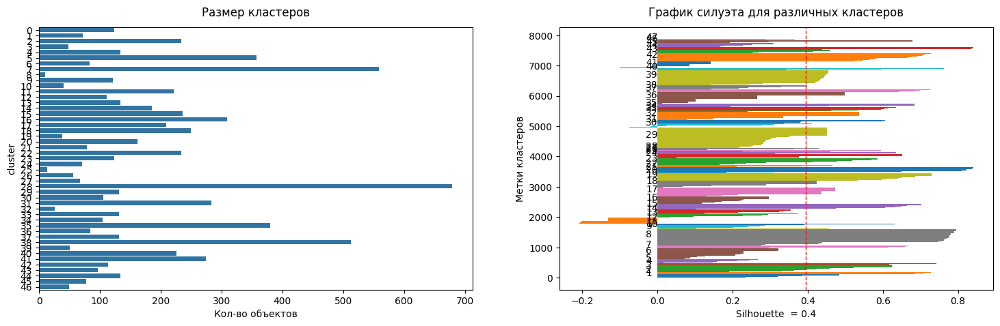

48 clusters
----------------------------------------------------------------------------------------------------


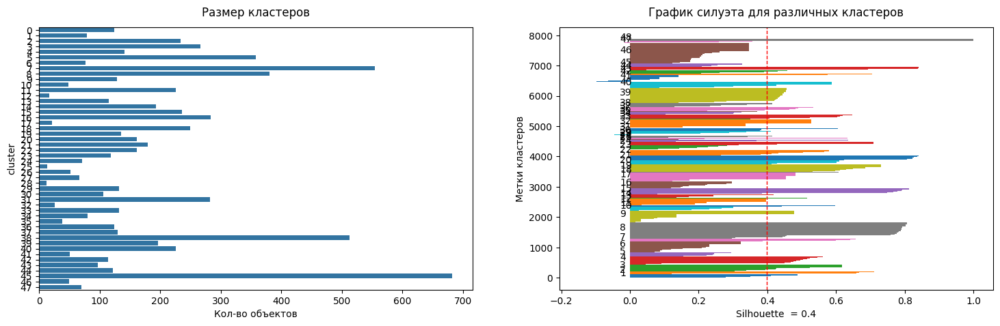

49 clusters
----------------------------------------------------------------------------------------------------


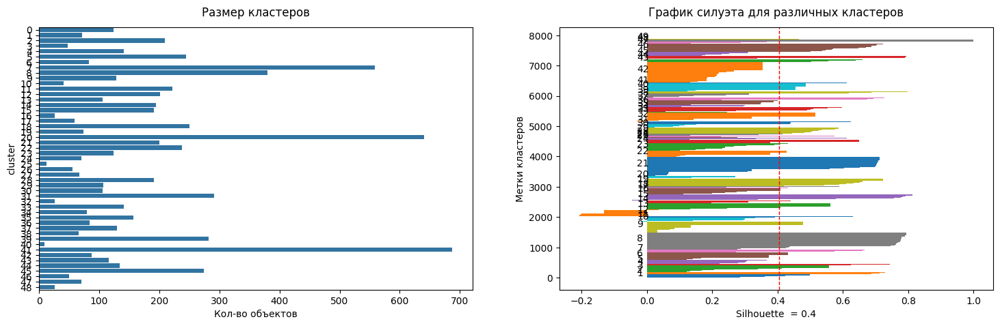

50 clusters
----------------------------------------------------------------------------------------------------


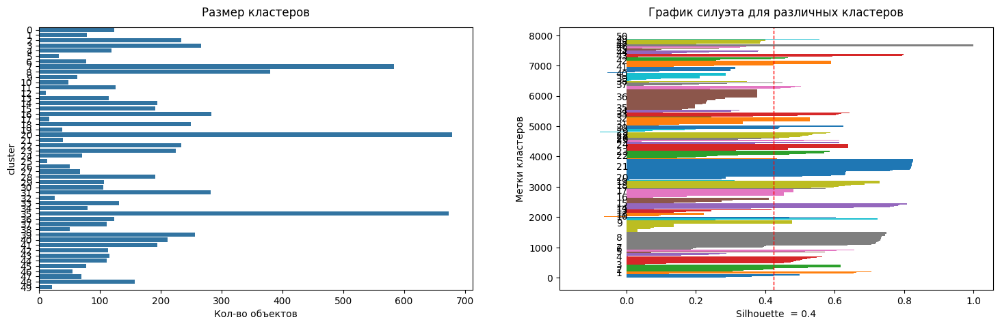

51 clusters
----------------------------------------------------------------------------------------------------


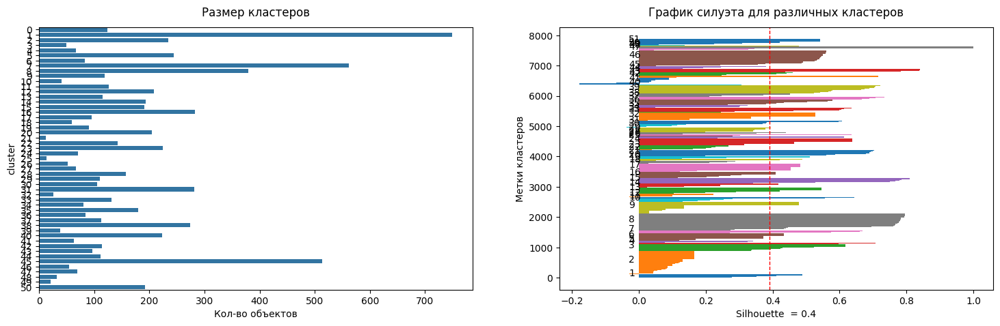

52 clusters
----------------------------------------------------------------------------------------------------


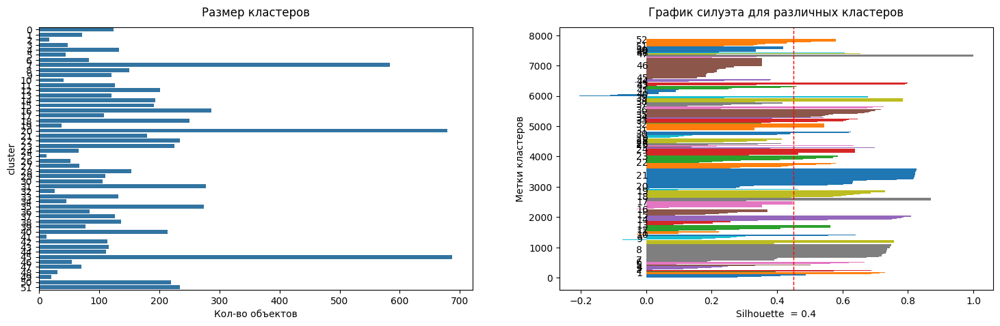

53 clusters
----------------------------------------------------------------------------------------------------


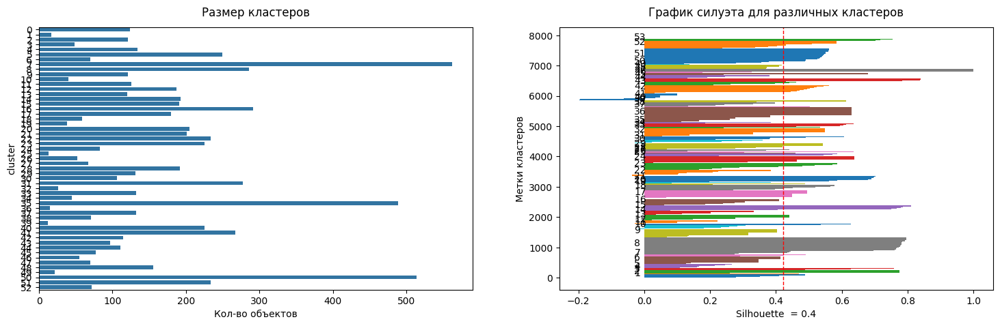

54 clusters
----------------------------------------------------------------------------------------------------


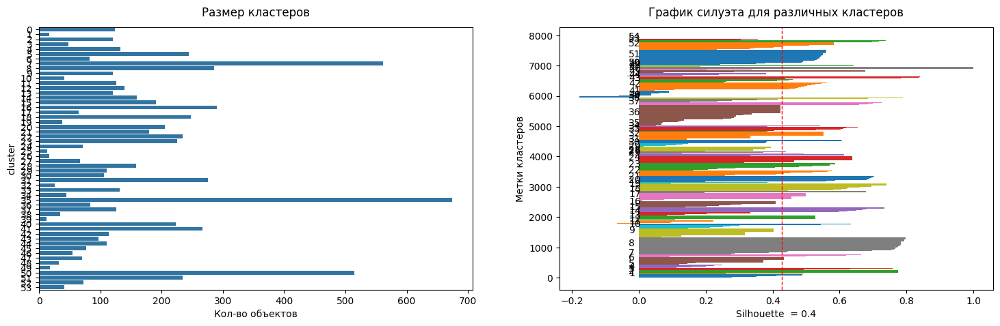

55 clusters
----------------------------------------------------------------------------------------------------


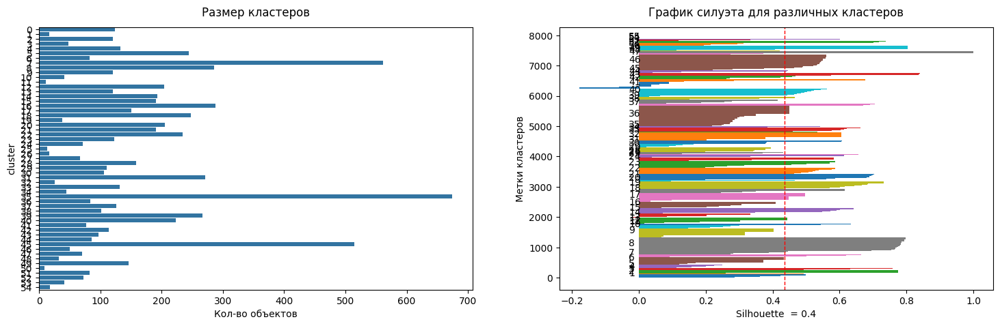

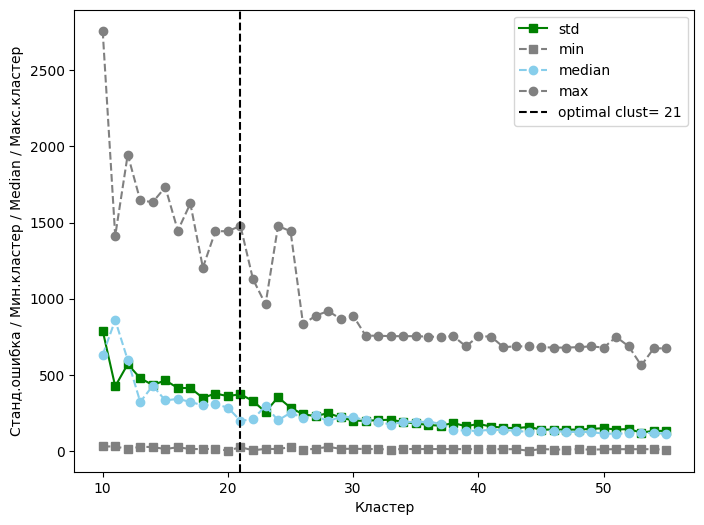

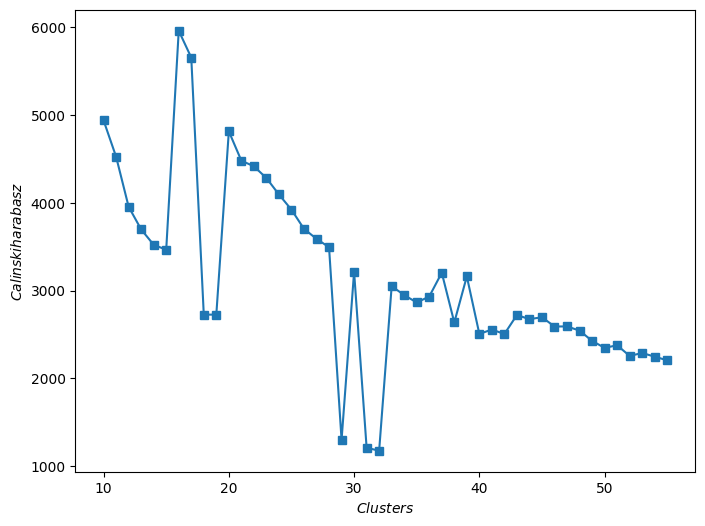

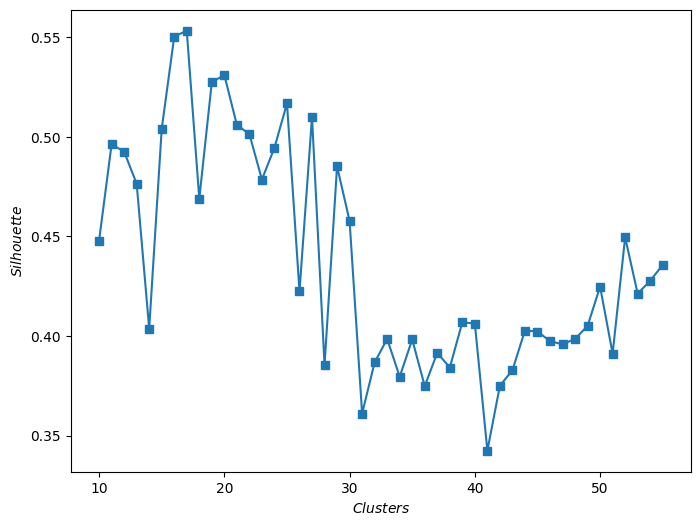

In [142]:
# подберем оптимальное количество кластеров
clust_faiss_bert = clustering_analysis(data=df_bert,
                                       data_scale=df_scaled_bert,
                                       embedding=X_embedding_umap_bert,
                                       model=faiss.IndexFlatL2,
                                       kwargs=params_cluster['IndexFlatL2'],
                                       min_size=10,
                                       max_size=55,
                                       type_train=None)

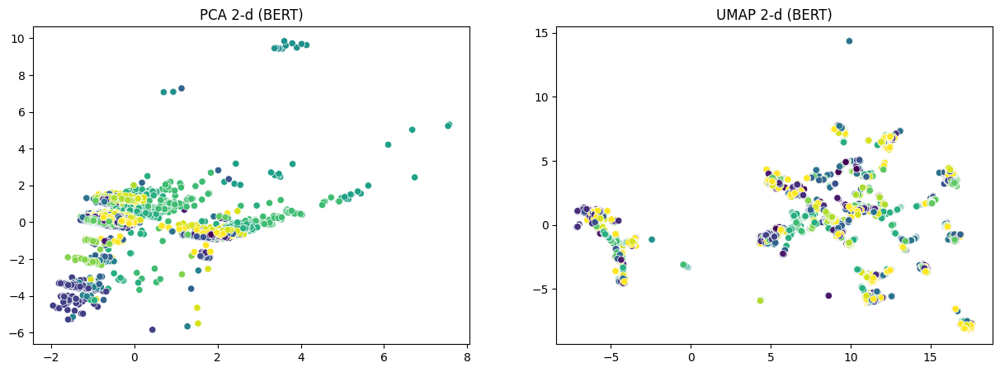

In [150]:
# посмотрим распределение кластеров на графике
clusters_visual(clusters=clust_faiss_bert[17],
                X_embedding_pca=X_embedding_pca_bert,
                X_embedding_umap=X_embedding_umap_bert,
                name='BERT')

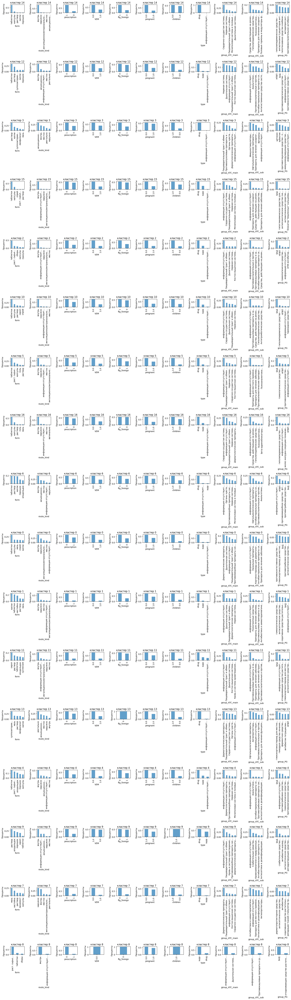

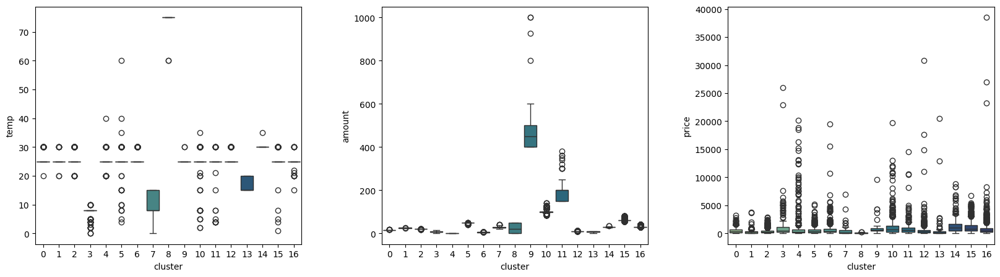

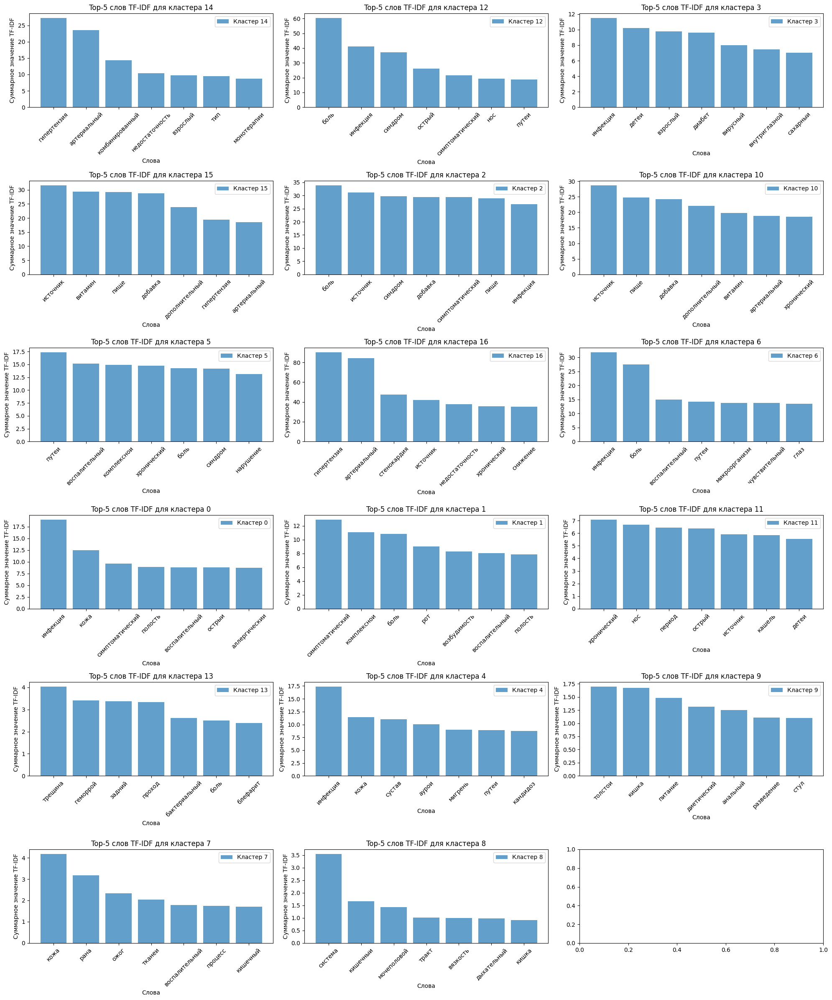

In [151]:
# оценим кластеры
plot_object_features(df, clust_faiss_bert[17], obj_and_bin_cols)
plot_num_features(df, clust_faiss_bert[17], num_cols)
plot_text_features(df_tfidf_labels, clust_faiss_bert[17], tfidf_cols)

**Описание**


- **0 кластер** -  ЛП для приема внутрь и наружно, чаще без рецепта, дерматологические. Группа "Помощь коже"

- **1 кластер** - жидкие и твердые ЛП для приема внутрь и наружно для лечения горла. Группа "Помощь горлу"

- **2 кластер** - средства для приема внутрь (таблетки и раст сборы), чаще без рецепта, отечественные, подходят детям, цена до 5000. Группа "Решение до 5000"

- **3 кластер** - инъекционные и наружные ЛП, чаще рецептурные, отечественного производтсва, подходят детям и взрослым, для лецения инфекций. Группа "Против инфекций"

- **4 кластер** - внутренние и наружные средства разных форм, чаще без рецепта, для лечений инфекций. Группа "Системные инфекции"

- **5 кластер** - сресдтва для приема внутрь и наружно (таблетки и раст сырье), чаще без рецепта, отечественные, подходят детям. Группа "Помощь организму" 

- **6 кластер** - ЛП, чаще по рецепту, для приема внутрь и парентерально. Группа "Для органов чувств"

- **7 кластер** - ЛП для наружного применения (мази чаще), отечественные, без рецепта, подходят детям, для лечения заболеваний кожи. Группа "Лечение кожных заболеваний"

- **8 кластер** - препараты растительного происхождения отечественного производства для взрослых и детей. Группа "Растительное производство"

- **9 кластер** - лекарства и БАД, чаще без рецепта, подходят детям и беременным (в большем случае), для кишечника. Группа "Для помощи кишечнику" 

- **10 кластер** - средства для приема внутрь, по рецепту и без, отеч и ин производства, подходит детям, витамины и добавки для помощи сердцу. Группа "Помощь сердцу"

- **11 кластер** - жидкие лекарства для приема внутрь, чаще без рецепта, пододят детям, при кашле. Группа "При кашле"

- **12 кластер** - ЛП для приема внутрь, по рецепту и без, чаще ин производства, подходят детям, при аллергии. Группа "При аллергии"

- **13 кластер** - ЛП для ректального введения, по рецепту и без, для лечения геморроя. Группа "При геморрое"

- **14 кластер** - рецептурные ЛП для серднечно-сосудистой системы, чаще ин производства. Группа "Лечение сердечных болезней"

- **15 кластер** - средства для приема внутрь, по рецепту и без, подходят детям, витамины. Группа "Витамины"

- **16 кластер** - ЛП (чаще рецептурные) и БАД, применяемые при сердечных заболеваниях. Группа "ЛП и БАД на страже вашего сердца"

#### Без числовых признаков

10 clusters
----------------------------------------------------------------------------------------------------


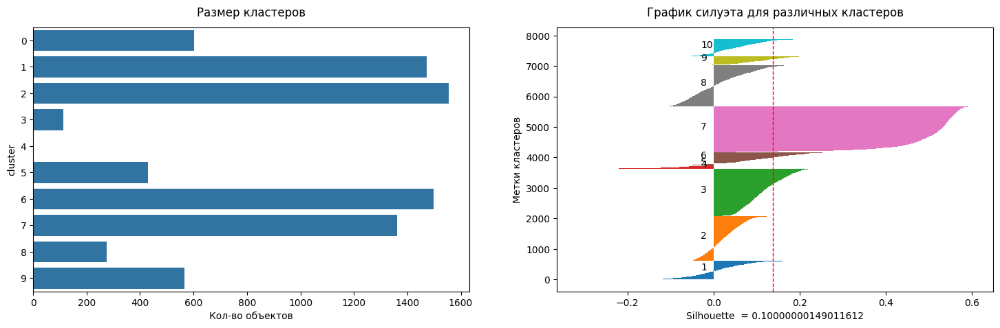

11 clusters
----------------------------------------------------------------------------------------------------


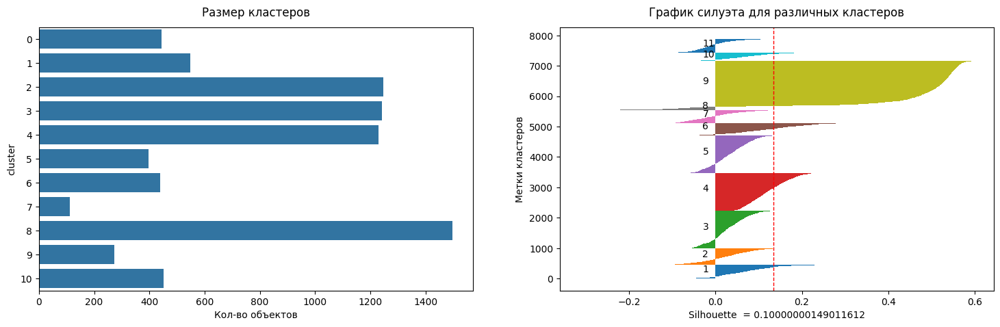

12 clusters
----------------------------------------------------------------------------------------------------


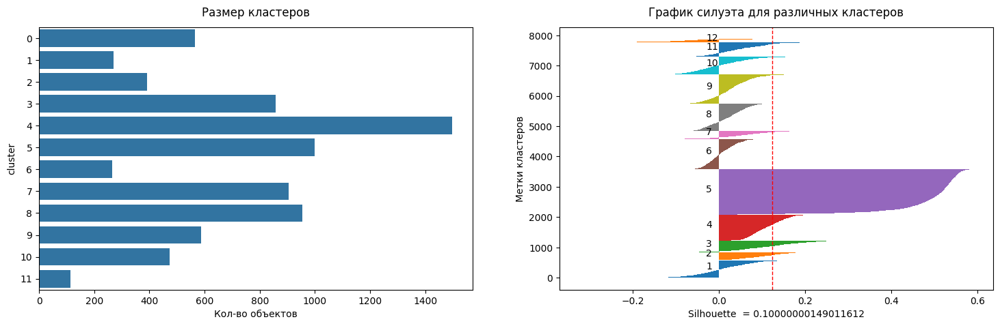

13 clusters
----------------------------------------------------------------------------------------------------


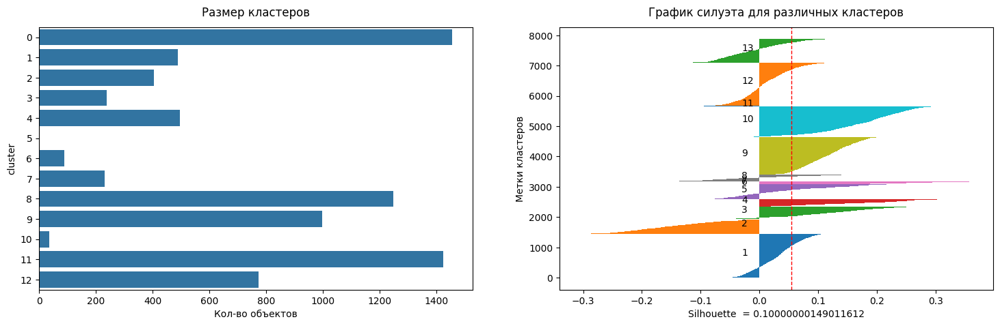

14 clusters
----------------------------------------------------------------------------------------------------


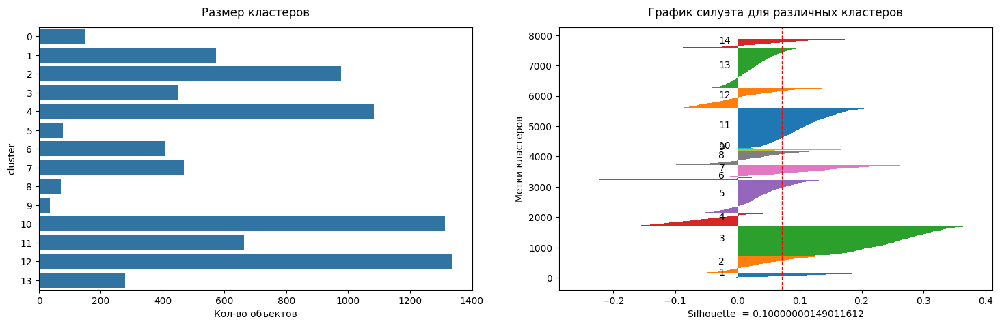

15 clusters
----------------------------------------------------------------------------------------------------


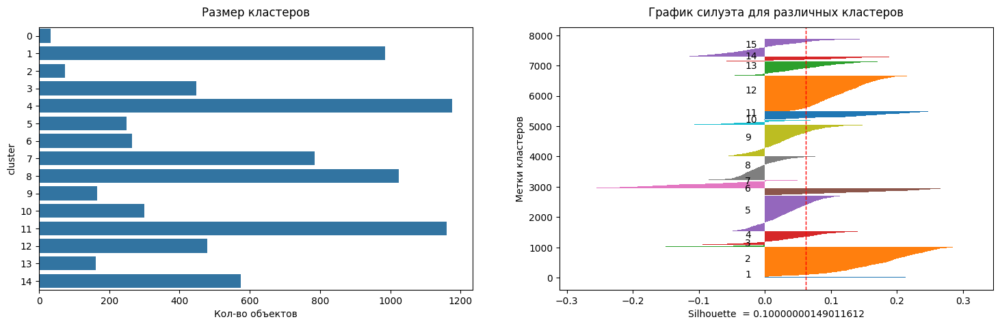

16 clusters
----------------------------------------------------------------------------------------------------


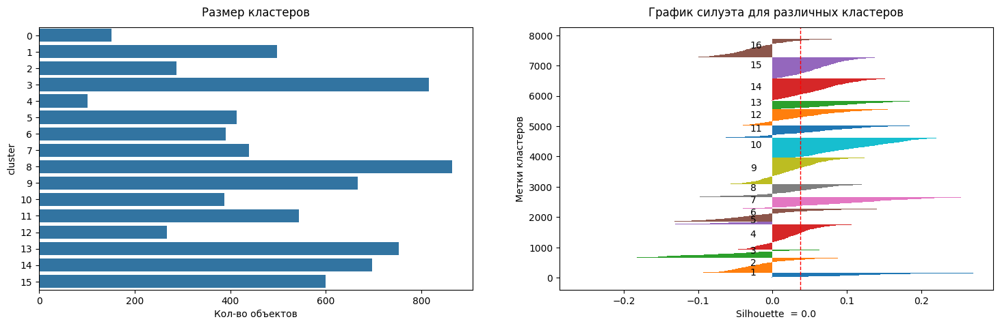

17 clusters
----------------------------------------------------------------------------------------------------


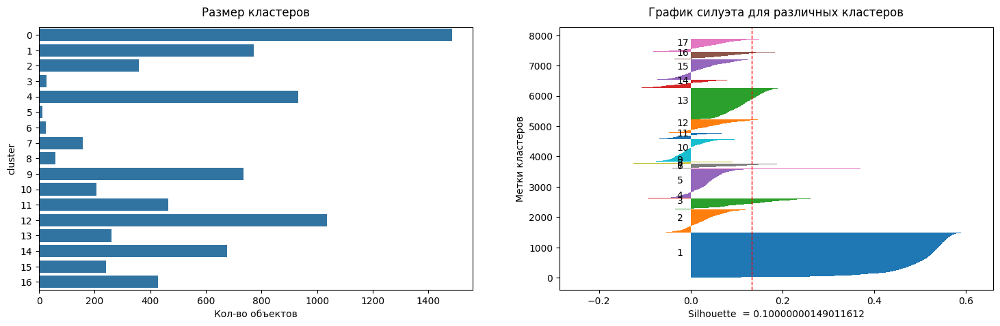

18 clusters
----------------------------------------------------------------------------------------------------


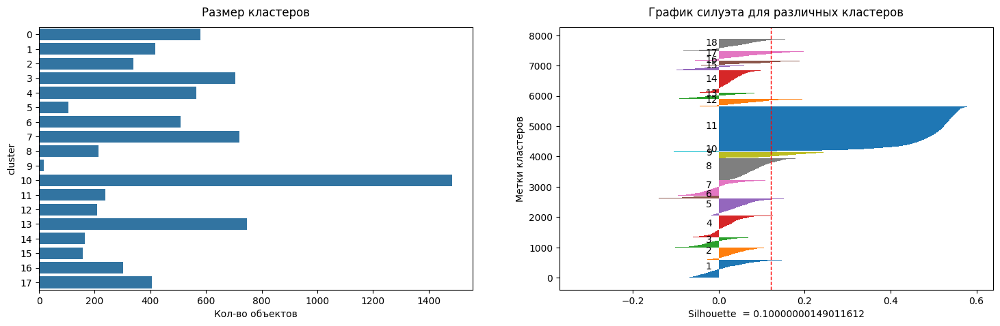

19 clusters
----------------------------------------------------------------------------------------------------


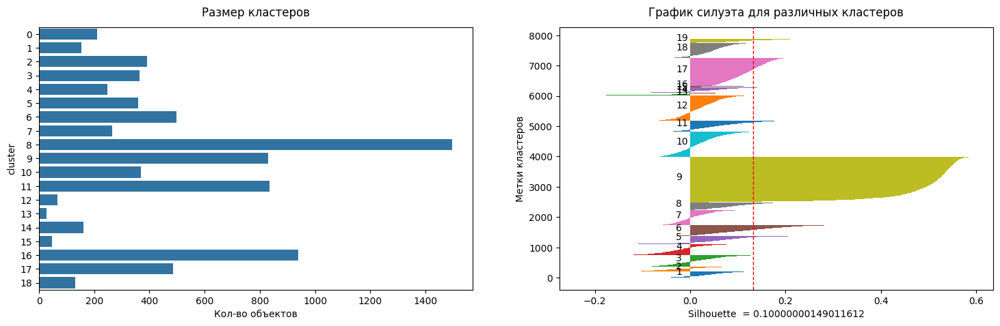

20 clusters
----------------------------------------------------------------------------------------------------


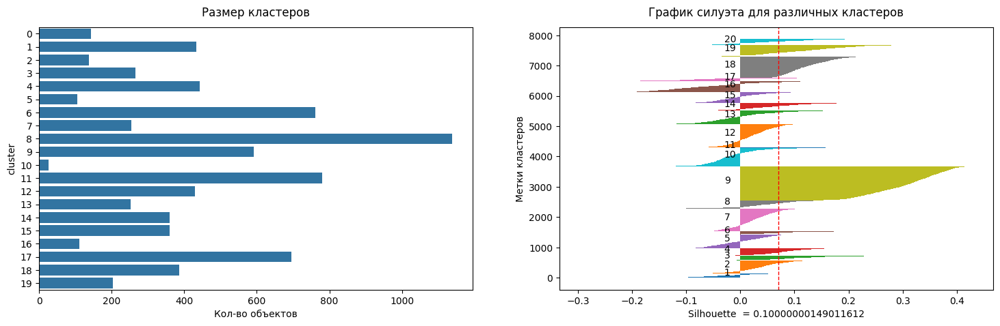

21 clusters
----------------------------------------------------------------------------------------------------


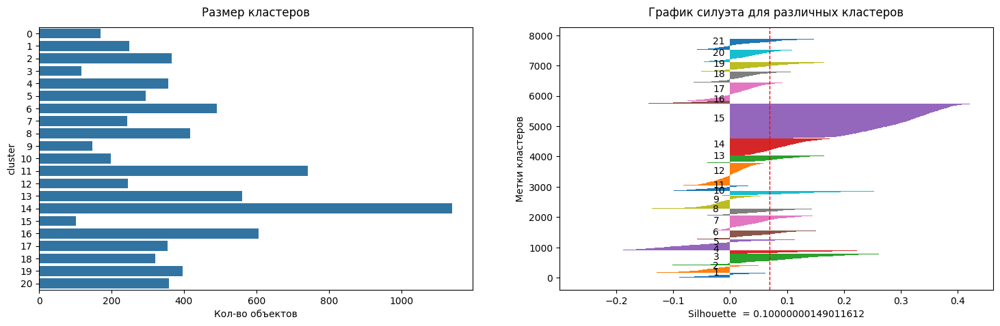

22 clusters
----------------------------------------------------------------------------------------------------


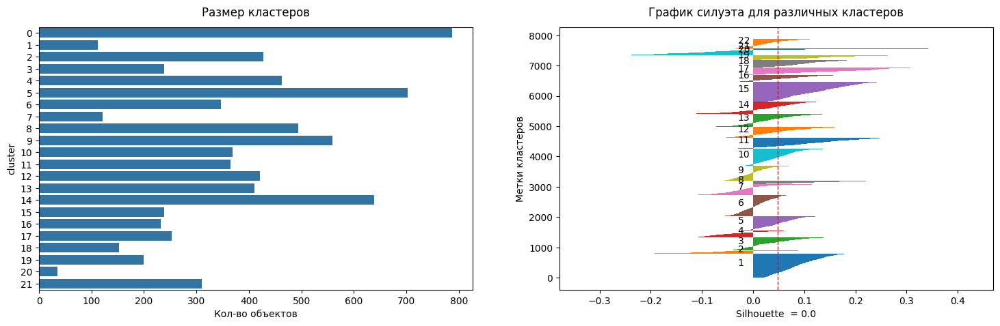

23 clusters
----------------------------------------------------------------------------------------------------


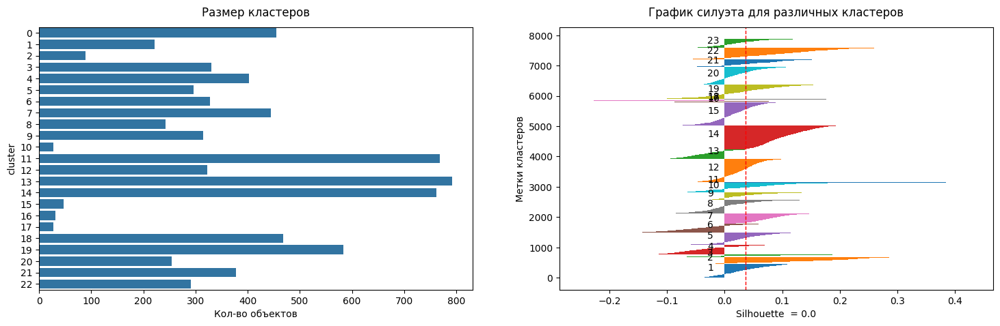

24 clusters
----------------------------------------------------------------------------------------------------


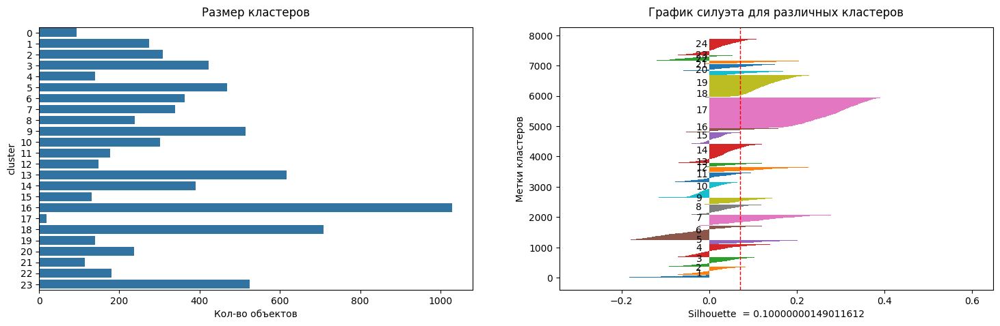

25 clusters
----------------------------------------------------------------------------------------------------


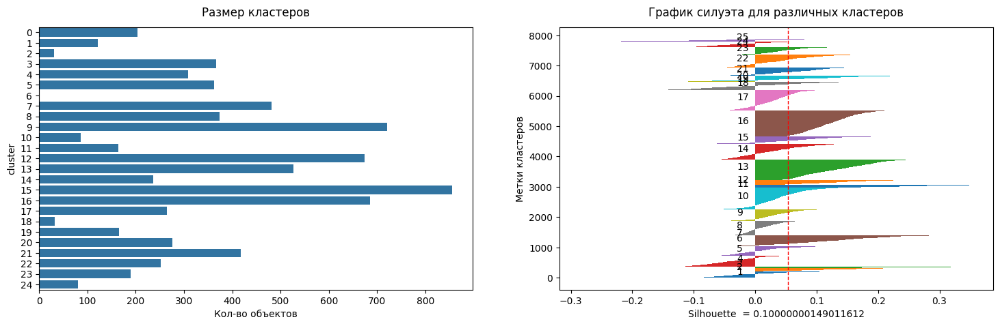

26 clusters
----------------------------------------------------------------------------------------------------


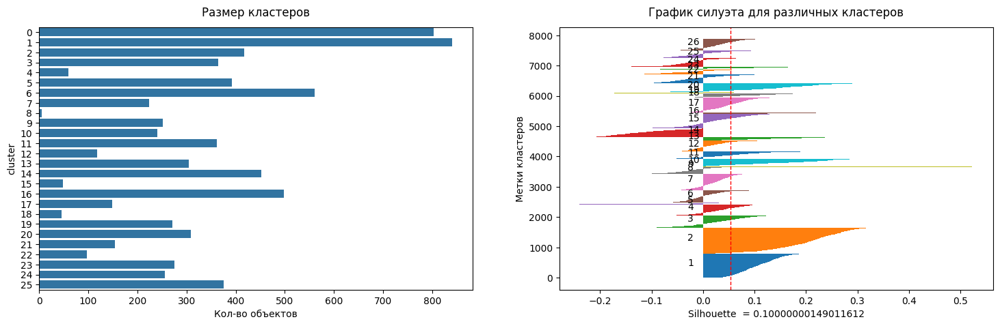

27 clusters
----------------------------------------------------------------------------------------------------


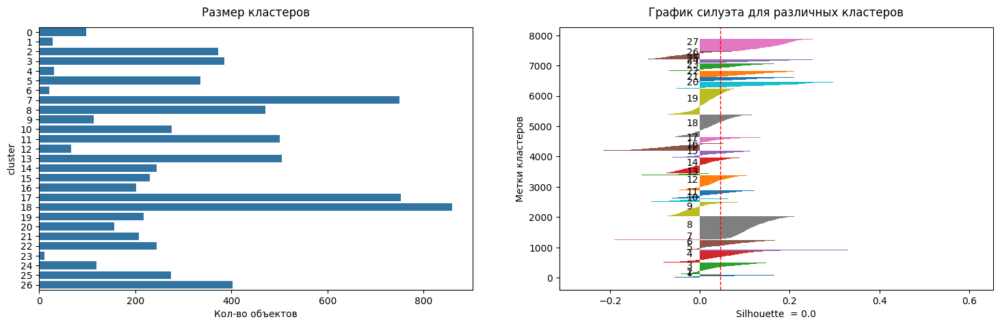

28 clusters
----------------------------------------------------------------------------------------------------


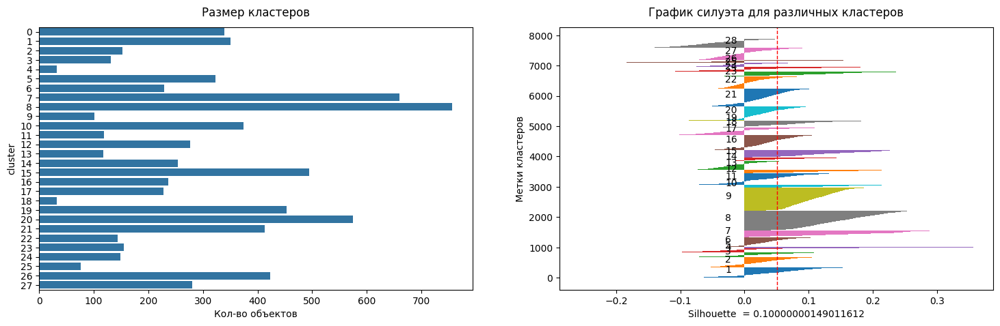

29 clusters
----------------------------------------------------------------------------------------------------


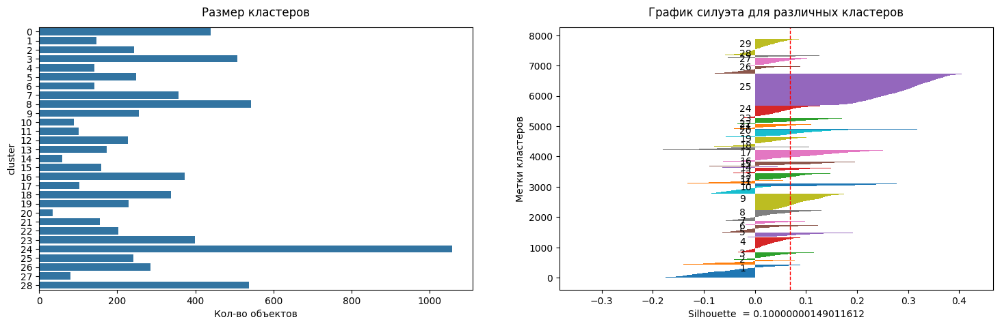

30 clusters
----------------------------------------------------------------------------------------------------


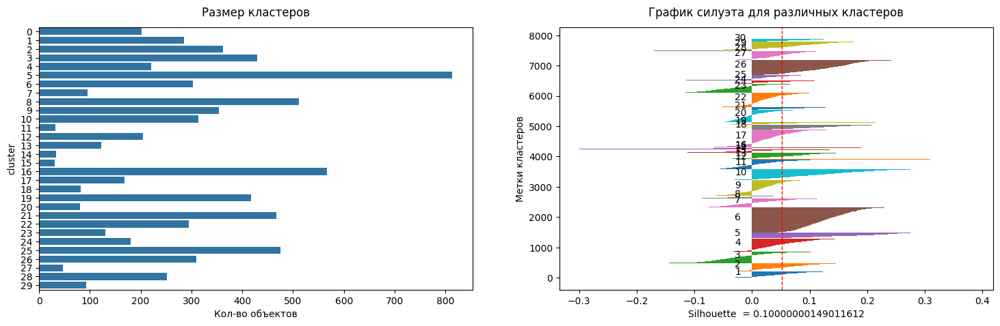

31 clusters
----------------------------------------------------------------------------------------------------


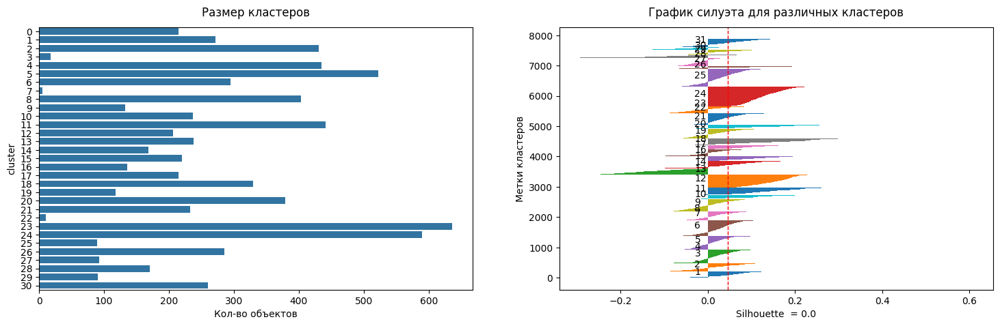

32 clusters
----------------------------------------------------------------------------------------------------


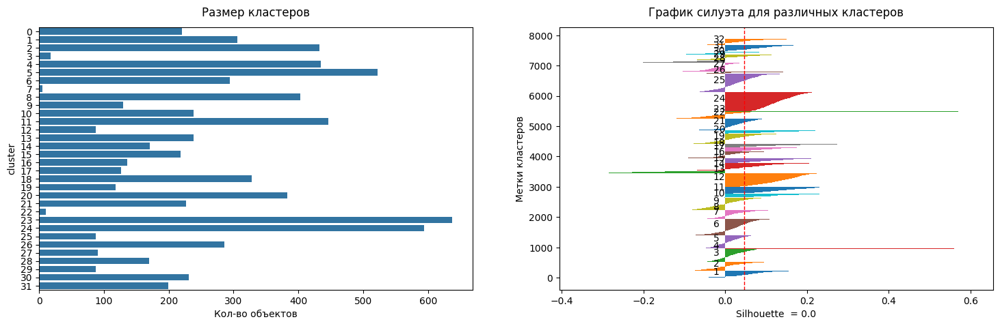

33 clusters
----------------------------------------------------------------------------------------------------


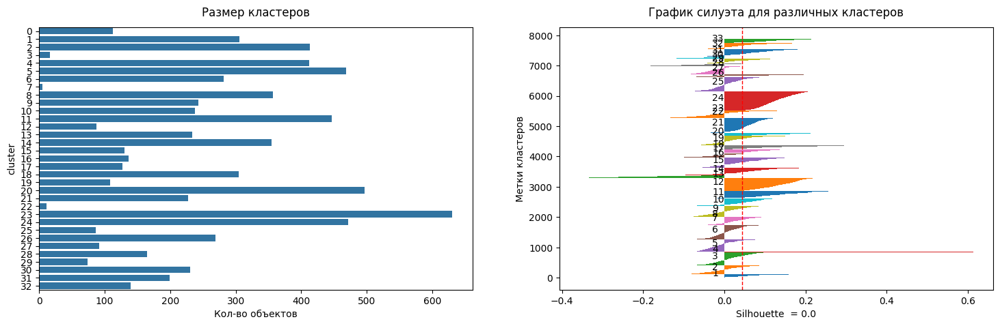

34 clusters
----------------------------------------------------------------------------------------------------


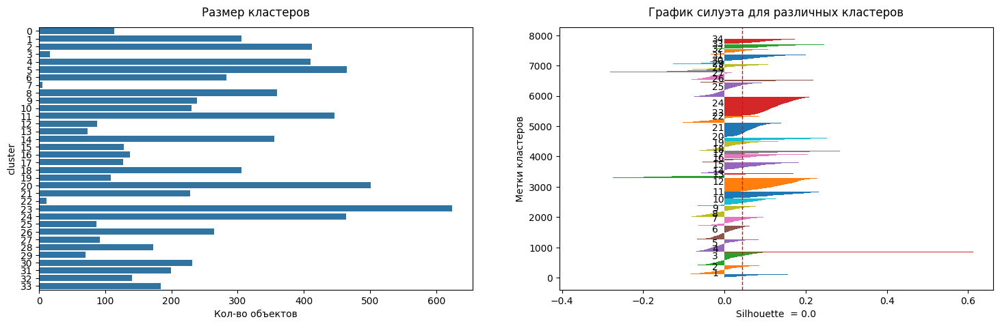

35 clusters
----------------------------------------------------------------------------------------------------


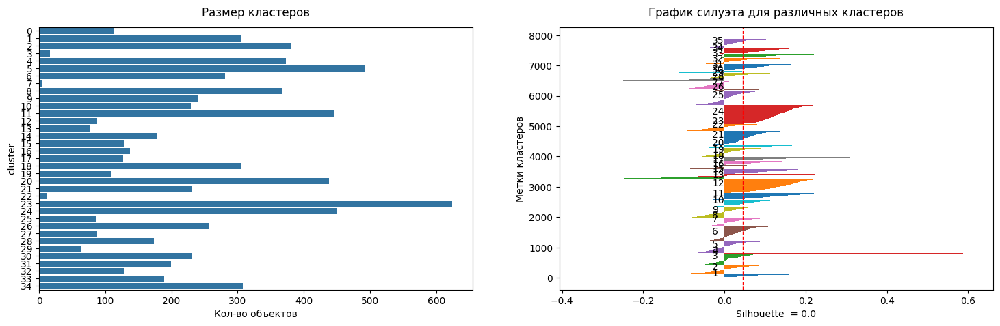

36 clusters
----------------------------------------------------------------------------------------------------


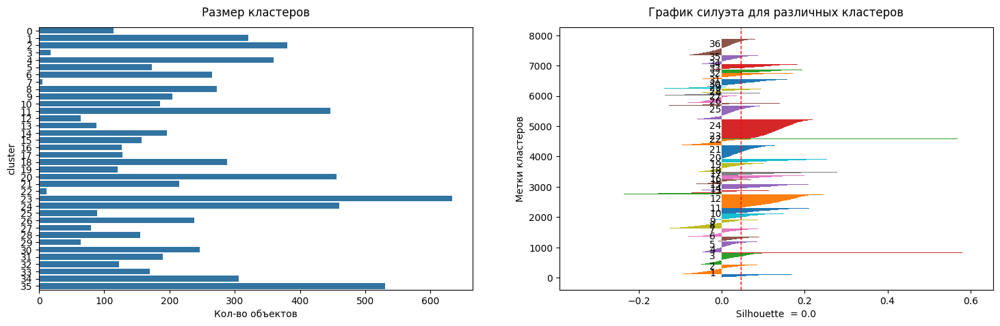

37 clusters
----------------------------------------------------------------------------------------------------


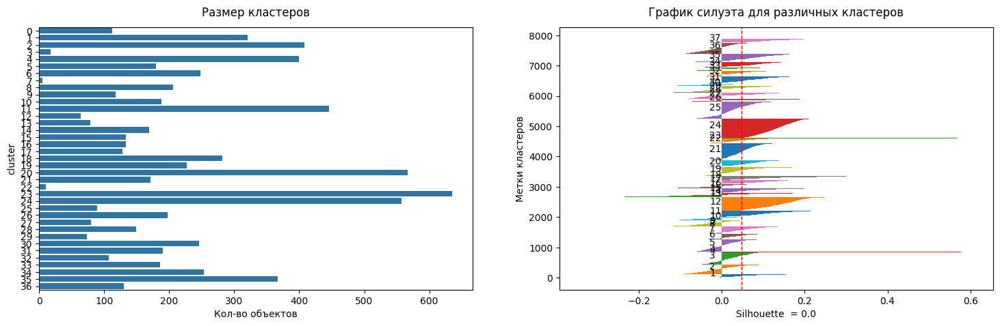

38 clusters
----------------------------------------------------------------------------------------------------


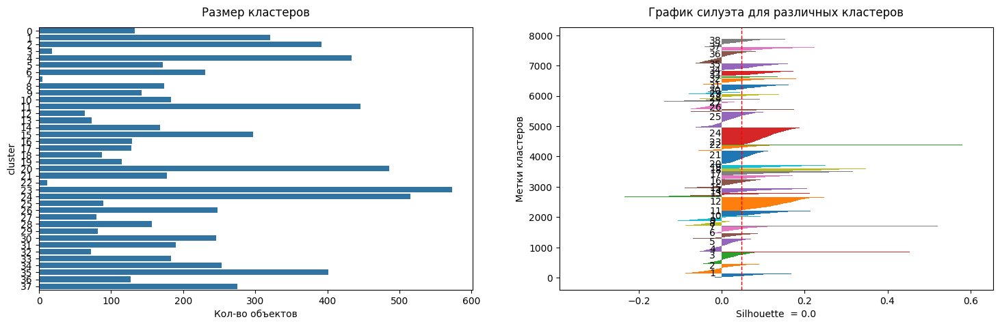

39 clusters
----------------------------------------------------------------------------------------------------


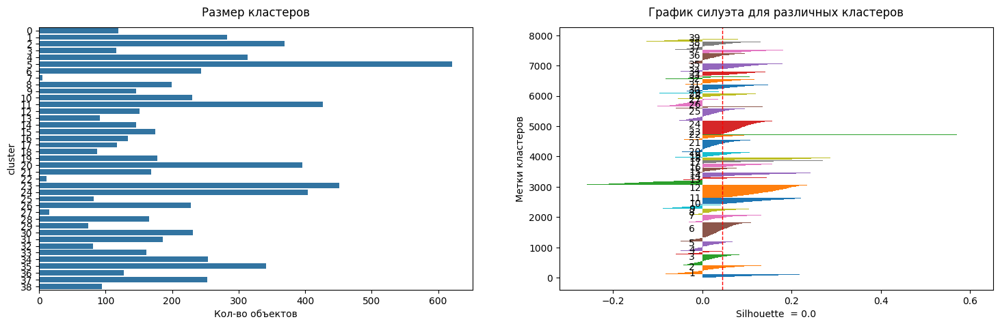

40 clusters
----------------------------------------------------------------------------------------------------


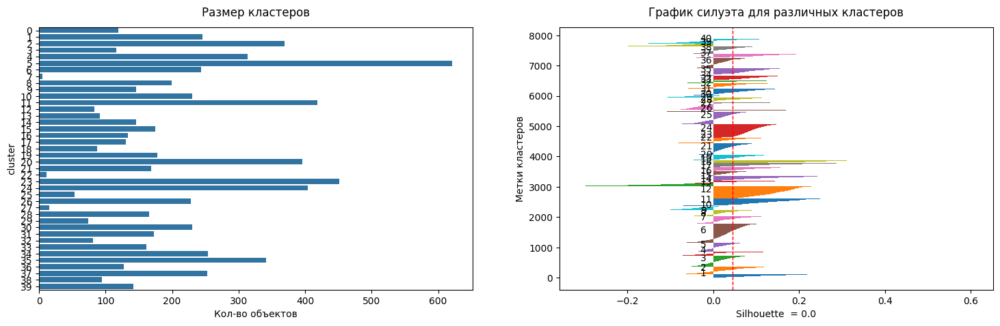

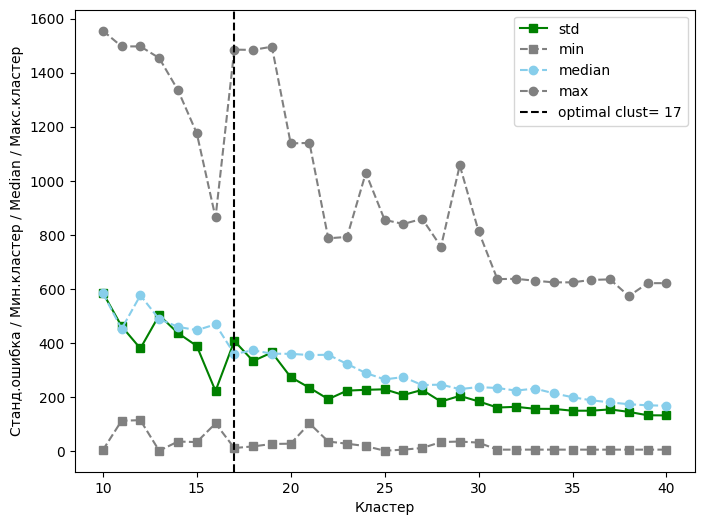

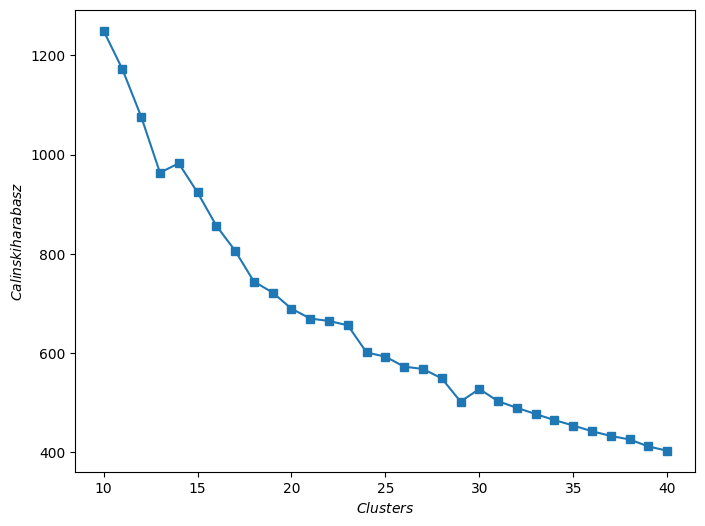

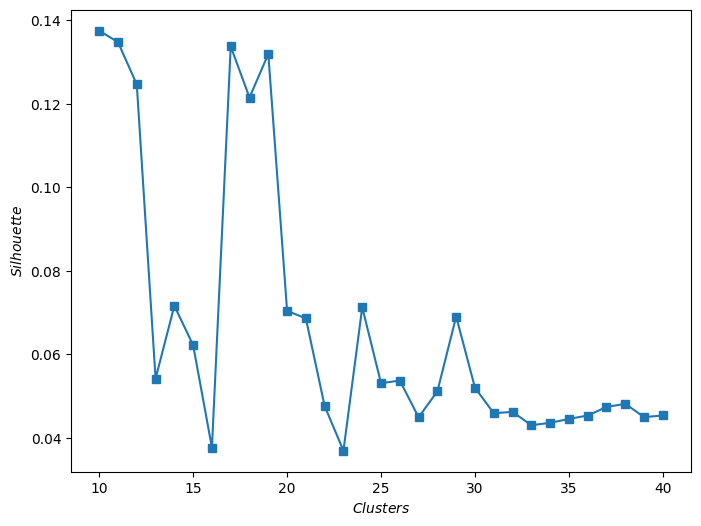

In [145]:
# подберем оптимальное количество кластеров
clust_faiss_bert_text = clustering_analysis(
    data=df_bert_text,
    data_scale=df_bert_text,
    embedding=X_embedding_umap_bert_text,
    model=faiss.IndexFlatL2,
    kwargs=params_cluster['IndexFlatL2'],
    min_size=10,
    max_size=40,
    type_train=None)

*алгоритм плохо выделяет кластеры*

**Выводы:**

- алгоритм Faiss выделяет кластеры на данных TF IDF и Bert с числовыми данными;
- у алгоритма Faiss, обученного на Bert с числовыми данными, лучше показатели (выше значение силуэтного скора, меньше ошибка при разделении кластеров)

# Выводы

- Из всех алгоритмов подошел только Faiss с данными TF IDF и BERT с числовыми данными (второй справился немного лучше)
- Было выбрано разделение на 17 кластеров
- В дальнейшем для улучшения интерпретации возможно разделение на кластеры существующих групп на сайте аптеки для выделения более мелких подгрупп (например, по заболеванию)
- Также возможно ввести разделение при поиске препаратов внутри группы по количеству в упаковке, применению у беременных, детям, ограничить ценовые сегменты (модифицировать сайт)
- Для создания подборки внутри определенной группы возможно использование части датасета (например, подборка для пищеварительной системы может включать в себя лекарства группы АТХ для пищеварительной системы и БАДы; для группы антимикробных препаратов возможно также выделить отдельную подгруппу БАДов, которые применяются в качестве пробиотиков при приеме антибиотиков) 

In [147]:
df_done = df_tfidf_labels.copy()

df_done = df_done.assign(cluster_tf = clust_faiss_tf[17])
df_done = df_done.assign(cluster_bert = clust_faiss_bert[17])
score_tf = silhouette_score(df_done, df_done.cluster_tf)
score_bert = silhouette_score(df_done, df_done.cluster_bert)

In [149]:
print(f'silhouette Faiss TF IDF: {round(score_tf, 3)}')
print(f'silhouette Faiss Bert: {round(score_bert, 3)}')

silhouette Faiss TF IDF: 0.548
silhouette Faiss Bert: 0.551
